In [1]:
import time
import numpy as np

# Constants

In [2]:
sample_rate = 44100
hop_size = 441 * 2
seq_dur = 10
seq_len = int(seq_dur * sample_rate / hop_size)
peak_type = 'gaussian'
width = 4

beatmap_dir = '../beatmaps'
ds_path = './datasets/HN/ds_' + peak_type + '.pkl'
bn_model_path = './models/ASU/dbn02_' + peak_type
hn_model_path = './models/ASU/hn02_' + peak_type

# Audio utils

In [3]:
from abc import abstractmethod

In [4]:
class FeatureModule(object):
    
    def __init__(self, sample_rate, hop_length, num_channels=1, decibels=True):
        self.sample_rate = sample_rate
        self.hop_length = hop_length
        self.num_channels = num_channels
        self.decibels = decibels
        
    def get_expected_frames(self, audio):
         # Simply the number of hops plus one
        num_frames = 1 + len(audio) // self.hop_length
        return num_frames
    
    def get_sample_range(self, num_frames):
         # Calculate the boundaries
        max_samples = num_frames * self.hop_length - 1
        min_samples = max(1, max_samples - self.hop_length + 1)

        # Construct an array ranging between the minimum and maximum number of samples
        sample_range = np.arange(min_samples, max_samples + 1)
        return sample_range
    
    @abstractmethod
    def process_audio(self, audio):
        return NotImplementedError
    
    def to_decibels(self, feats):
        feats = librosa.core.amplitude_to_db(feats, ref=np.max)
        return feats

    def post_proc(self, feats):
        if self.decibels:
            # Convert to decibels (dB)
            feats = self.to_decibels(feats)

            # TODO - make additional variable for 0/1 scaling
            # Assuming range of -80 to 0 dB, scale between 0 and 1
            feats = feats / 80
            feats = feats + 1
        else:
            # TODO - should anything be done here? - would I ever not want decibels?
            pass

        # Add a channel dimension
        feats = np.expand_dims(feats, axis=0)
        return feats
    
    def get_times(self, audio):
        num_frames = self.get_expected_frames(audio)

        frame_idcs = np.arange(num_frames + 1)
        # Obtain the time of the first sample of each frame
        times = librosa.frames_to_time(frames=frame_idcs,
                                       sr=self.sample_rate,
                                       hop_length=self.hop_length)
        return times
    
    def get_sample_rate(self):
        sample_rate = self.sample_rate
        return sample_rate

    def get_hop_length(self):
        hop_length = self.hop_length
        return hop_length

    def get_num_channels(self):
        num_channels = self.num_channels
        return num_channels

    @classmethod
    def features_name(cls):
         return cls.__name__

## patch madmom import error with sed

In [5]:
from madmom.audio.signal import SignalProcessor, FramedSignalProcessor
from madmom.audio.stft import ShortTimeFourierTransformProcessor
from madmom.audio.spectrogram import (
    FilteredSpectrogramProcessor, LogarithmicSpectrogramProcessor,
    SpectrogramDifferenceProcessor)
from madmom.processors import ParallelProcessor, SequentialProcessor

In [6]:
class LOG_SPECT(FeatureModule):
    def __init__(self, num_channels=1, sample_rate=22050, win_length=2048, hop_size=512, n_bands=[12], mode='online'):
        sig = SignalProcessor(num_channels=num_channels, win_length=win_length, sample_rate=sample_rate)
        self.sample_rate = sample_rate
        self.hop_length = hop_size
        self.num_channels = num_channels
        multi = ParallelProcessor([])
        frame_sizes = [win_length]  
        num_bands = n_bands  
        for frame_size, num_bands in zip(frame_sizes, num_bands):
            if mode == 'online' or mode == 'offline':
                frames = FramedSignalProcessor(frame_size=frame_size, hop_size=hop_size) 
            else:   # for real-time and streaming modes 
                frames = FramedSignalProcessor(frame_size=frame_size, hop_size=hop_size, num_frames=4) 
            stft = ShortTimeFourierTransformProcessor()  # caching FFT window
            filt = FilteredSpectrogramProcessor(
                num_bands=num_bands, fmin=30, fmax=17000, norm_filters=True)
            spec = LogarithmicSpectrogramProcessor(mul=1, add=1)
            diff = SpectrogramDifferenceProcessor(
                diff_ratio=0.5, positive_diffs=True, stack_diffs=np.hstack)
            # process each frame size with spec and diff sequentially
            multi.append(SequentialProcessor((frames, stft, filt, spec, diff)))
        # stack the features and processes everything sequentially
        self.pipe = SequentialProcessor((sig, multi, np.hstack))

    def process_audio(self, audio):
        feats = self.pipe(audio)
        return feats.T

# Beatmap utils

In [7]:
import re
import os
import torch
import math
import scipy.io.wavfile as wav
import subprocess

In [8]:
class Beatmap():    
    
    def __init__(self, beatmap_dir, beatmap, proc, sample_rate=22050, tmp='./wav/', 
                 peak_type='gaussian', hop_size=512, width=4):
        self.beatmap = beatmap
        self.beatmap_dir = beatmap_dir
        self.sample_rate = sample_rate
        self.proc = proc
        self.tmp = tmp
        self.wavf = None
        self.audiof = None
        self.rate = int(sample_rate / hop_size)
        self.w = width
    
        self.timestamp = []
        self.beat_len = []
        self.hitobjects = []
        self.frames = None
        self.beats = None
        self.m = None
        self.hitstream = None
        self.hits = None
        
        peaks = {
            'gaussian': self.create_gaussian_peak, 
            'linear': self.create_linear_peak, 
            'parabolic': self.create_parabolic_peak
        }
        self.create_peak = peaks[peak_type]
        
    def parse_audiof(self):
        with open(os.path.join(self.beatmap_dir, self.beatmap)) as f:
            for l in f:
                if re.match(r'AudioFilename.*', l):
                    self.audiof = re.search('AudioFilename:\s*(.*)', l).group(1)
        
        if not os.path.exists(self.audiof):
            for f in os.listdir(self.beatmap_dir):
                if re.match(self.audiof, f, flags=re.IGNORECASE):
                    self.audiof = f
        
    def get_audiof(self):
        if self.audiof is None:
            self.parse_audiof()
        return self.audiof
        
    def parse_ids(self):
        f = open(os.path.join(self.beatmap_dir, self.beatmap))
        for l in f:
            if re.match(r'BeatmapID.*',  l):
                self.BeatmapID = re.search('BeatmapID:\s*(\d+).*', l).group(1)
            if re.match(r'BeatmapSetID.*', l):
                self.BeatmapSetID = re.search('BeatmapSetID:\s*(\d+).*', l).group(1)
        if 'BeatmapSetID' not in locals():
            self.BeatmapSetID = self.beatmap_dir.split('/')[-1].split(' ')[0]
        if 'BeatmapID' not in locals():
            self.BeatmapID = self.beatmap_dir.split('/')[-1].split(' ')[0]
        f.close()
            
    def parse_wav(self):
        self.parse_ids();
        self.wavf = str(self.BeatmapSetID) + '-' + str(self.BeatmapID) + '.wav'
        
    def create_wav(self):
        self.parse_wav()
        mp3 = os.path.join(self.beatmap_dir, self.get_audiof())
        wav = os.path.join(self.tmp, self.wavf)
        subprocess.call(['ffmpeg', '-hide_banner', '-loglevel', 'error', '-y', 
                         '-i', mp3, '-ar', str(self.sample_rate), wav])
        
    def get_wav(self):
        if self.wavf is None:
            self.parse_wav()
            if not os.path.exists(os.path.join(self.tmp, self.wavf)):
                self.create_wav()
        return self.wavf

    def parse_timings(self):
        rate, audio_data = wav.read(os.path.join(self.tmp, self.get_wav()))
        audio_len = np.shape(audio_data)[0]
        self.beat_len = []
        self.timestamp = []
        
        with open(os.path.join(self.beatmap_dir, self.beatmap)) as f:
            for l in f:
                if re.match(r'BeatDivisor.*', l):
                    self.BeatDivisor = re.search('BeatDivisor:\s*(\d+).*', l).group(1)
                    self.BeatDivisor = int(self.BeatDivisor)
                    break
        f = open(os.path.join(self.beatmap_dir, self.beatmap))
        for l in f:
            if re.match(r'\[TimingPoints\]', l):
                break
        for l in f:
            if l == "\n":
                break
            a = l.split(',')
            if float(a[1]) < 0:
                continue
            self.beat_len.append(float(a[1]))
            self.timestamp.append(float(a[0])) 
        self.timestamp.append(int(audio_len / rate * 1000))
        f.close()
        
    def parse_hitobjects(self):
        self.hitobjects = []
        with open(os.path.join(self.beatmap_dir, self.beatmap)) as f:
            for l in f:
                if re.match(r'ApproachRate.*', l):
                    AR = float(l.split(':')[1])
                    if AR < 5.0:
                        preempt = 1200 + 600 * (5 - AR) / 5
                        fadein = 800 + 400 * (5 - AR) / 5
                    else:
                        preempt = 1200 - 750 * (AR - 5) / 5
                        fadein = 800 - 500 * (AR - 5) / 5
                    self.preempt = preempt - fadein*0.1
                    break
        with open(os.path.join(self.beatmap_dir, self.beatmap)) as f:
            for l in f:
                if re.match(r'SliderMultiplier.*', l):
                    self.sliderMultiplier = float(l.split(':')[1])
                    break
        f = open(os.path.join(self.beatmap_dir, self.beatmap))
        for l in f:
            if re.match(r'\[HitObjects\]', l):
                break
        for l in f:
            self.hitobjects.append(l.split(','))
        f.close()
        
    def parse_beatmap(self):
        self.parse_timings()
        self.parse_hitobjects()
    
    def process_audio(self):
        feats = self.proc.process_audio(os.path.join(self.beatmap_dir, self.get_audiof()))
        feats = torch.tensor(feats)
        self.frames = torch.transpose(feats, 0, 1)
        
    def create_gaussian_peak(self, y, i):
        alen = len(y)
        w = self.w/2/2
        
        def func(x):
            return math.exp(-j**2/w**2)
        
        j = 0 
        while i+j > 0 and abs(j) <= w*2:
            f = func(j)
            y[i+j] = max(y[i+j], f, 0)
            j -= 1
        j = 0
        while i+j < alen and abs(j) <= w*2:
            f = func(j)
            y[i+j] = max(y[i+j], f, 0)
            j += 1
            
    def create_parabolic_peak(self, y, i):
        alen = len(y)
        limit = self.w*2
        w = self.w

        def func(x):
            return -(1/w**2 * x**2) + 1

        j = 0        
        while i+j > 0 and abs(j) <= limit:
            f = func(j)
            y[i+j] = max(y[i+j], f, 0)
            j -= 1
        j = 0
        while i+j < alen and abs(j) <= limit:
            f = func(j)
            y[i+j] = max(y[i+j], f, 0)
            j += 1
            
    def create_linear_peak(self, y, i):
        alen = len(y)
        w = self.w/2
        m = 1/w
        limit = w
        
        def func(x):
            return m*x + 1
        
        j=0
        while i+j > 0 and abs(j) <= limit:
            f = func(j)
            y[i+j] = max(y[i+j], f, 0)
            j -= 1
        m = -m
        j = 0
        while i+j < alen and abs(j) <= limit:
            f = func(j)
            y[i+j] = max(y[i+j], f, 0)
            j += 1  
    
    def process_beats(self):
        if len(self.timestamp) == 0:
            self.parse_beatmap()
        self.beats = np.zeros(math.ceil(self.timestamp[-1] * 0.001 * self.rate), dtype=np.float32)
        
        i = self.timestamp[0] * 0.001 * self.rate
        while i > 0:
            x = round(i)
            self.create_peak(self.beats, x)
            i -= self.beat_len[0] * 0.001 * self.rate
        for j in range(len(self.timestamp) - 1):
            i = self.timestamp[j] * 0.001 * self.rate
            while i < (self.timestamp[j+1] * 0.001 * self.rate):
                x = round(i)
                self.create_peak(self.beats, x)
                i += self.beat_len[j] * 0.001 * self.rate
            if i >= self.timestamp[-1] * 0.001 * self.rate:
                break
                
    def process_hitobjects(self):
        global debug
        if len(self.hitobjects) == 0:
            self.parse_beatmap()
        self.hitstream = [None] * math.ceil(self.timestamp[-1] * 0.001 * self.rate)
        
        sr = 1.0/self.rate * 1000
        time = 0.0
        i = 0
        k = 0
        self.hitstream[k] = []
        while i != len(self.hitobjects):
            if float(self.hitobjects[i][2]) < time:
                i += 1
                continue
            j = i
            while j < len(self.hitobjects):
                if float(self.hitobjects[j][2]) > time + self.preempt or float(self.hitobjects[j][2]) < time:
                    break
                hit_type = int(self.hitobjects[j][3]) & 0b0011
                self.hitstream[k].append(hit_type)
                
                if int(hit_type) & 0b0010 != 0:
                    slider_rate = None
                    length = None
                    for i in range(len(self.timestamp)-1, 0-1, -1):
                        if slider_rate != None:
                            if self.beat_len[i] < 0.0:
                                continue
                            length = self.beat_len[i]
                            break
                        if self.timestamp[i] < float(self.hitobjects[j][2]):
                            if self.beat_len[i] > 0.0:
                                slides = 100
                                slider_rate = self.beat_len[i]
                                break
                            else:
                                slides = self.beat_len[i] * -1
                    if length == None:
                        length = self.beat_len[0]
                        slider_rate = 100
                    length = float(length)
                    y = round(float(self.hitobjects[j][7]) * length / (100/slider_rate * self.sliderMultiplier * 100.0) * 0.001 * self.rate)
                    for i in range(int(self.hitobjects[j][6])):
                        self.hitstream[k].append(-1)
                    
                j += 1
            
            time += sr
            debug = self.hitstream
            k += 1
            self.hitstream[k] = []
    
    def process_hits(self):
        if len(self.hitobjects) == 0:
            self.parse_beatmap()
        self.hits = np.zeros(math.ceil(self.timestamp[-1] * 0.001 * self.rate), dtype=np.float32)
        
        for h in self.hitobjects:
            x = round(float(h[2]) * 0.001 * self.rate)
            self.create_peak(self.hits, x)
            
            if int(h[3]) & 2 == 2:
                slider_rate = None
                length = None
                for i in range(len(self.timestamp)-1, 0-1, -1):
                    if slider_rate != None:
                        if self.beat_len[i] < 0.0:
                            continue
                        length = self.beat_len[i]
                        break
                    if self.timestamp[i] < float(h[2]):
                        if self.beat_len[i] > 0.0:
                            slides = 100
                            slider_rate = self.beat_len[i]
                            break
                        else:
                            slides = self.beat_len[i] * -1
                if length == None:
                    length = self.beat_len[0]
                    slider_rate = 100
                length = float(length)
                y = round(float(h[7]) * length / (100/slider_rate * self.sliderMultiplier * 100.0) * 0.001 * self.rate)
                for i in range(0, int(h[6])*y):
                    if x + i > self.hits.shape[0]:
                        break
                    self.create_peak(self.hits, x+i)
                    
    def get_audio(self):
        if self.frames is None:
            self.process_audio()
        return self.frames
    
    def get_hitobjects(self):
        if self.hitstream is None:
            self.process_hitobjects()
        stream = [None] * len(self.hitstream)
        for i in range(len(self.hitstream)):
            if self.hitstream[i] == [] or self.hitstream[i] == None:
                h = np.array([0])
            else:
                h = np.array(self.hitstream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
    
    def get_hits(self):
        if self.hits is None:
            self.process_hits()
        return torch.tensor(self.hits)
    
    def get_beats(self):
        if self.beats is None:
            self.process_beats()
        return torch.tensor(self.beats)
    
    def get_metadata(self):
        if self.BeatDivisor is None:
            self.parse_beatmap()
        return (self.beatmap, self.rate, self.BeatDivisor)
    
    def get_timings(self):
        if len(self.timestamp) == 0:
            self.parse_beatmap()
        return list(zip(self.timestamp, self.beat_len))

# Dataset

In [9]:
import glob
import copy
import gc
import concurrent.futures
import traceback
import torch
from torch.utils.data import Dataset

In [10]:
class Beatmap_Dataset(Dataset):  
    
    def __init__(self, beatmap_dir, proc, seq_dur=10, sample_rate=22050, hop_size=512, width=4, 
                 peak_type='gaussian', threads=4, threading=True):
        self.beatmap_dir = beatmap_dir
        self.proc = proc
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.beatmaps = []
        self.seq_len = int(seq_dur * sample_rate / hop_size)
        self.width = width
        
        if beatmap_dir == None:
            self.a = []
            self.o = []
            self.b = []
            self.h = []
            self.t = []
            self.m = []
            return
        
        j = 0
        for r, dirs, _ in os.walk(beatmap_dir):
            for dir in dirs:
                for root, _, files in os.walk(os.path.join(r, dir)):
                    for f in files:
                        if re.match('.*.osu$', f):
                            self.beatmaps.append(Beatmap(root, f, proc, sample_rate=sample_rate, 
                                                         hop_size=hop_size, width=width, peak_type=peak_type))
                            j += 1
                                            
        self.a = [None] * j
        self.o = [None] * j
        self.b = [None] * j
        self.h = [None] * j
        self.t = [None] * j
        self.m = [None] * j 

        def process(i):
            m = self.beatmaps[i]
            self.beatmaps[i] = None
            try:
                print(str(i) + '/' + str(j-1), m.beatmap)            
                self.a[i] = copy.deepcopy(m.get_audio())
                self.o[i] = copy.deepcopy(m.get_hitobjects())
                self.b[i] = copy.deepcopy(m.get_beats())
                self.h[i] = copy.deepcopy(m.get_hits())
                self.t[i] = copy.deepcopy(m.get_timings())
                self.m[i] = copy.deepcopy(m.get_metadata())
            except Exception as e:
                traceback.print_exc()
                print("pruning:", m.beatmap)     
                self.a[i] = None
                self.o[i] = None
                self.b[i] = None
                self.h[i] = None
                self.t[i] = None
                self.m[i] = None
            del m
            #gc.collect()

        if threading:
            executor = concurrent.futures.ThreadPoolExecutor(threads)
            list(executor.map(process, range(j)))
        else:
            list(map(process, range(j)))
                        
        self.beatmaps = list(filter(None, self.beatmaps))
        self.a = list(filter(lambda x: x != None, self.a))
        self.o = list(filter(lambda x: x != None, self.o))
        self.b = list(filter(lambda x: x != None, self.b))
        self.h = list(filter(lambda x: x != None, self.h))
        self.t = list(filter(None, self.t))
        self.m = list(filter(None, self.m))
        
    def take(self, ds, i, j):
        self.a = ds.a[i:j]
        self.o = ds.o[i:j]
        self.b = ds.b[i:j]
        self.h = ds.h[i:j]
        self.m = ds.m[i:j]
        self.t = ds.t[i:j]
        
    def __len__(self):
        return len(self.a)
    
    def __getitem__(self, i):
        if self.seq_len == 0:
            return None
        j = np.random.randint(0, self.a[i].shape[0] - self.seq_len)
        return self.a[i][j: j+self.seq_len], self.o[i][j: j+self.seq_len], self.b[i][j: j+self.seq_len], self.h[i][j: j+self.seq_len], self.t[i][0], (self.m[i], i, j)
    

# Testing

In [11]:
# debug
log_spect = LOG_SPECT(sample_rate=sample_rate, hop_size=hop_size, n_bands=[24], mode='offline')
ds = Beatmap_Dataset('../ex/beatmaps', log_spect, sample_rate=sample_rate, hop_size=hop_size, width=width, peak_type=peak_type, threading=True)

0/7 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-'s Hard].osu
1/7 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [HOS' Normal].osu
2/7 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [RLC's Insane].osu
3/7 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [deetz' Deception].osu
4/7 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Easy].osu
5/7 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [toybot's Insane].osu
6/7 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Collab Advanced].osu
7/7 LamazeP - Spam Jack (OsuToothbrush) [SPAM].osu


# Process Data

In [12]:
start = time.time()

log_spect = LOG_SPECT(sample_rate=sample_rate, hop_size=hop_size, n_bands=[24], mode='offline')
ds = Beatmap_Dataset(beatmap_dir, log_spect, seq_dur=seq_dur, sample_rate=sample_rate, 
                     hop_size=hop_size, peak_type=peak_type, width=width, threads=16, threading=True)

end = time.time()
print(end - start, 'secs')

0/1511 Chata - Engage (Lasse) [Insane].osu
1/1511 Mimi - Surrealism (feat. ZAT) (-Tatsuo) [no mania].osu
2/1511 sana - kanojo wa tabi ni deru (Firika) [Insane].osu
3/1511 Ishida Youko - To the Promised Sky ~The place that I was~ (caren) [Collabo].osu
4/1511 5/1511StylipS - Prism Sympathy(Asterisk Remix) (iMage--) [Kaleid Liner].osu
 Cranky - Chandelier - King (Mao) [Gero's Insane].osu
6/1511 senya - Akatsuki no Suiheisen ni (Satellite) [Zweib's Insane].osu
7/1511 Tadokoro Azusa - 1HOPE SNIPER (Sotarks) [NiNo's Insane].osu
8/15119/1511 fripSide - future gazer (TV Size) (alacat) [Insane].osu
10/1511 Yazawa Nico (CV.Tokui Sora) - Nicopuri Joshidou (yf_bmp) [z1085684963's Insane].osu
 cYsmix - bells! (Gero) [normal!].osu
11/1511 Hamburgaga - Watame Internet Connection Race (CE6A) [Insane].osu
12/1511 xi - Parousia -LAST JUDGMENT- (Zapy) [Retribution].osu
13/1511 Shiena Nishizawa - Meaning (Taeyang) [xChippy's Insane].osu
14/1511 namirin - Hitokoto no Kyori (sahuang) [Linadeft's Insane].osu

Traceback (most recent call last):
  File "/tmp/ipykernel_31940/2904171237.py", line 44, in process
    self.a[i] = copy.deepcopy(m.get_audio())
  File "/tmp/ipykernel_31940/554882180.py", line 308, in get_audio
    self.process_audio()
  File "/tmp/ipykernel_31940/554882180.py", line 137, in process_audio
    feats = self.proc.process_audio(os.path.join(self.beatmap_dir, self.get_audiof()))
  File "/tmp/ipykernel_31940/680612967.py", line 27, in process_audio
    feats = self.pipe(audio)
  File "/home/poi/proj/osuAi/hitNet/.env/lib/python3.10/site-packages/madmom/processors.py", line 120, in __call__
    return self.process(*args, **kwargs)
  File "/home/poi/proj/osuAi/hitNet/.env/lib/python3.10/site-packages/madmom/processors.py", line 424, in process
    data = _process((processor, data, kwargs))
  File "/home/poi/proj/osuAi/hitNet/.env/lib/python3.10/site-packages/madmom/processors.py", line 289, in _process
    return process_tuple[0](*process_tuple[1:-1], **process_tuple[-1])
  F

KeyboardInterrupt: 

In [ ]:
start = time.time()

torch.save(ds, ds_path)

end = time.time()
print(end - start, 'secs')

# Load Dataset

In [11]:
ds = torch.load(ds_path)

# Model

In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as nnF

In [13]:
class BN(nn.Module):
    def __init__(self, dim_in, device):
        super(BN, self).__init__()
        
        self.dim_in = dim_in
        self.dim_out = 1
        self.dim_hd = 64
        self.num_layers = 2
        self.kernel_size = 5
        self.padding = 2
        self.device = device
        
        # convolution
        K = self.kernel_size
        P = 1
        S = 1
        # pooling
        p = 0
        k = 2
        s = 2
        
        # temporal
        W = dim_in[1]
        W = int(((W - K + 2*P)/S) + 1)
        K = 3
        temporal_dim = int(((W - K + 2*P)/S) + 1)
        self.temporal_dim = temporal_dim
        
        self.conv_out = self.temporal_dim
        
        self.convA1 = nn.Conv2d(1, 1, (3, 5), padding=1)
        self.convA2 = nn.Conv2d(1, 1, (3, 3), padding=1)
        
        self.lstm1 = nn.LSTM(input_size=self.conv_out,
                           hidden_size=self.dim_hd,
                           num_layers=self.num_layers,
                           batch_first=True,
                           bidirectional=True)
        self.linear2 = nn.Linear(self.dim_hd * 2, self.dim_hd)
        self.linear1 = nn.Linear(self.dim_hd, self.dim_out)
        self.softmax = nn.Softmax(dim=0)
        self.hidden = None
        
    def init_hidden(self, batch_size):
        hidden_state = torch.zeros(self.num_layers * 2, batch_size, self.dim_hd).to(self.device)
        cell_state = torch.zeros(self.num_layers * 2, batch_size, self.dim_hd).to(self.device)
        self.hidden = (hidden_state, cell_state)

    def forward(self, x):
        x = x.unsqueeze(1)
        x = self.convA1(x)
        x = nnF.relu(x)
        x = self.convA2(x)
        x = nnF.relu(x)
        x = x.squeeze(1)
        
        #x = nnF.max_pool2d(x, (1,2))
        x, self.hidden = self.lstm1(x, self.hidden)
        x = self.linear2(x)
        x = nnF.relu(x)
        
        x = self.linear1(x)
        #x = self.softmax(x)
        
        return x

In [14]:
class HN(nn.Module):
    def __init__(self, dim_in, device):
        super(HN, self).__init__()
        
        self.dim_in = dim_in
        self.dim_out = 1
        self.device = device
        self.num_layers = 2
        
        # convolution
        K = 5
        P = 1
        S = 1
        # pooling
        p = 0
        k = 2
        s = 2
        
        # temporal
        W = dim_in[1]
        W = int(((W - K + 2*P)/S) + 1)
        K = 3
        temporal_dim = int(((W - K + 2*P)/S) + 1)
        self.temporal_dim = temporal_dim
        
        self.conv_out = self.temporal_dim
        self.lstmX_size = self.conv_out + 64 + 1
        print(self.lstmX_size)
        
        self.convA1 = nn.Conv2d(1, 1, (3, 5), padding=1)
        self.convA2 = nn.Conv2d(1, 1, (3, 3), padding=1)

        self.lstmX1 = nn.LSTM(input_size=self.lstmX_size,
                   hidden_size=self.lstmX_size,
                   num_layers=self.num_layers,
                   batch_first=True,
                   bidirectional=False) 
        self.linearX1 = nn.Linear(self.lstmX_size, 64)
                                  
        #self.linear2 = nn.Linear(int(self.lstmX_size/self.lstm_layers), int(self.lstmX_size/self.lstm_layers/2))
        self.linear1 = nn.Linear(64, self.dim_out)

        
    def init_hidden(self, batch_size):
        h = torch.zeros(self.num_layers, batch_size, self.lstmX_size).to(self.device)
        c = torch.zeros(self.num_layers, batch_size, self.lstmX_size).to(self.device)
        self.hiddenX1 = (h, c)

    def forward(self, a, b, o):
        a = a.unsqueeze(1)
        a = self.convA1(a)
        a = nnF.relu(a)
        a = self.convA2(a)
        a = nnF.relu(a)
        a = a.squeeze(1)
        
        b = b.unsqueeze(2)
        
        x = torch.cat([a, b, o], dim=2)
        
        x, self.hiddenX1 = self.lstmX1(x, self.hiddenX1)
        x = self.linearX1(x)
        x = nnF.relu(x)
        
        #x = self.linear2(x)
        #x = nnF.relu(x)
        x = self.linear1(x)
        
        return x

# Training DBN

In [15]:
import torch
from torch.utils.data import DataLoader
from torchinfo import summary
from qqdm.notebook import qqdm
import matplotlib.pyplot as plt

In [16]:
batch_size = 32
init_trunc = 1

In [17]:
dim_in = (ds.seq_len, ds.a[0].shape[1])
dim_out = 1

In [18]:
device = torch.device('cuda')

In [19]:
epoch_cum = 0
best_loss = 9999
best_acc40 = 0
best_weights = None
val_hist = []
train_hist = []
bn = BN(dim_in=dim_in, device=device)
bn.to(device)

BN(
  (convA1): Conv2d(1, 1, kernel_size=(3, 5), stride=(1, 1), padding=(1, 1))
  (convA2): Conv2d(1, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (lstm1): LSTM(278, 64, num_layers=2, batch_first=True, bidirectional=True)
  (linear2): Linear(in_features=128, out_features=64, bias=True)
  (linear1): Linear(in_features=64, out_features=1, bias=True)
  (softmax): Softmax(dim=0)
)

In [31]:
bn.init_hidden(1)
summary(bn, input_data=[ds.a[0].unsqueeze(0).to(device)], col_width=16,
        col_names=["input_size",
                "output_size",
                "num_params",
                "kernel_size",
                "mult_adds",])

Layer (type:depth-idx)                   Input Shape      Output Shape     Param #          Kernel Shape     Mult-Adds
BN                                       --               --               --               --               --
├─Conv2d: 1-1                            [1, 1, 14206, 280] [1, 1, 14206, 278] 16               [1, 1, 3, 5]     63,188,288
├─Conv2d: 1-2                            [1, 1, 14206, 278] [1, 1, 14206, 278] 10               [1, 1, 3, 3]     39,492,680
├─LSTM: 1-3                              [1, 14206, 278]  [1, 14206, 128]  275,456          --               3,913,127,936
├─Linear: 1-4                            [1, 14206, 128]  [1, 14206, 64]   8,256            [128, 64]        8,256
├─Linear: 1-5                            [1, 14206, 64]   [1, 14206, 1]    65               [64, 1]          65
├─Softmax: 1-6                           --               --               --               --               --
Total params: 283,803
Trainable params: 283,803
Non-trainab

In [32]:
train_ds = Beatmap_Dataset(None, None, seq_dur=seq_dur, sample_rate=sample_rate, 
                     hop_size=hop_size, peak_type=peak_type, width=width)
val_ds = Beatmap_Dataset(None, None, seq_dur=seq_dur, sample_rate=sample_rate, 
                     hop_size=hop_size, peak_type=peak_type, width=width)

train_ds.take(ds, 0, int(len(ds) * 0.8))
val_ds.take(ds, int(len(ds) * 0.8), len(ds))

train_ldr = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
val_ldr = DataLoader(val_ds, batch_size=batch_size, shuffle=False)

In [33]:
criterion = nn.MSELoss()
#criterion = nn.L1Loss(reduction='sum')
optimizer = torch.optim.Adam(bn.parameters(), lr=0.001)

In [34]:
def beatAcc(pred, gt, thresh):
    c = 0
    n = 0
    for i in range(1, gt.shape[0]-2):
        n += 1 if gt[i] == 1.0 else 0
        if pred[i] > pred[i-1] and pred[i] > pred[i+1] and pred[i] >= thresh:
            c += 1 if gt[i] > 0.0 else 0
    if n == 0:
        return 1
    return c / n    

In [35]:
def trainBN():
    global epoch_cum
    global best_loss, best_weights, best_acc40
    global A, O, B, H, P
    global l
    
    for epoch in range(epochs):
        bn.train()
        train_loss = 0
        info = qqdm(train_ldr)
        for a, o, b, h, t, m, in info:
            bn.init_hidden(a.shape[0])
            A, B = a.to(device), b.to(device)

            optimizer.zero_grad()
            P = bn(A)

            for i in range(P.shape[0]):
                l = int(t[1][i] * 0.001 * m[0][1][i] * init_trunc)
                B[i][0:l] = torch.tensor([0] * l)
                P[i][0:l] = torch.tensor([0] * l).unsqueeze(1)

            loss = criterion(P, B.unsqueeze(2))
            loss.backward()
            optimizer.step()
      
            train_loss += loss.item()
            info.set_infos({'loss': f'{loss.item():.4f}'})

        bn.eval()
        torch.no_grad()
        val_loss = 0
        val_acc50 = 0
        val_acc40 = 0
        for a, o, b, h, t, m, in val_ldr:
            bn.init_hidden(a.shape[0])
            A, B = a.to(device), b.to(device)

            P = bn(A)

            for i in range(P.shape[0]):
                l = int(t[1][i] * 0.001 * m[0][1][i] * init_trunc)
                B[i][0:l] = torch.tensor([0] * l)
                P[i][0:l] = torch.tensor([0] * l).unsqueeze(1)

            loss = criterion(P, B.unsqueeze(2))

            acc = 0
            for i in range(P.shape[0]):
                acc += beatAcc(P[i].cpu().detach().numpy(), b[i], 0.5)
            val_acc50 += acc
            acc = 0
            for i in range(P.shape[0]):
                acc += beatAcc(P[i].cpu().detach().numpy(), b[i], 0.4)
                #print(acc)
            val_acc40 += acc

            
            val_loss += loss.item()

        train_loss = train_loss/len(train_ldr)    
        val_loss = val_loss/len(val_ldr)
        val_acc50 = val_acc50/len(val_ldr)/batch_size
        val_acc40 = val_acc40/len(val_ldr)/batch_size
        print(epoch+epoch_cum, 'of', epochs+epoch_cum)
        print("TRAIN LOSS:", train_loss)
        print("VAL LOSS:", val_loss)
        print("VAL_ACC50:", val_acc50)
        print("VAL_ACC40:", val_acc40)
        train_hist.append(float(train_loss))
        val_hist.append(float(val_loss))
        
        plt.rcParams["figure.figsize"] = (20,1)
        for i in range(dim_out):
            plt.plot(P[0,:,i].cpu().detach().numpy())
            plt.plot(b[i])
            plt.show()
        
        plt.rcParams["figure.figsize"] = (10, 5)
        plt.plot(train_hist)
        plt.plot(val_hist)
        plt.show()
        
        if val_loss < best_loss:
            best_acc40 = val_acc40
            best_loss = val_loss
            best_weights = bn.state_dict().copy()
            
    epoch_cum += epochs

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.58it/s  0.0610                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

0 of 64
TRAIN LOSS: 0.060410968131489225
VAL LOSS: 0.06055682566430834
VAL_ACC50: 0.0
VAL_ACC40: 0.0


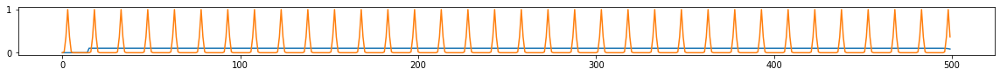

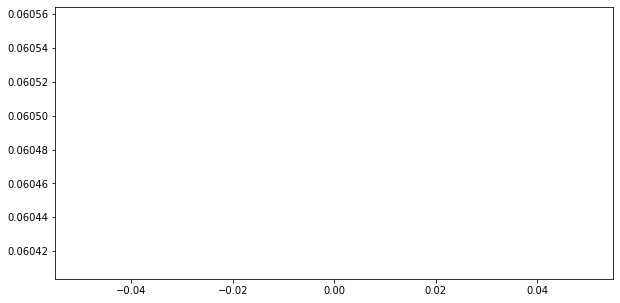

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.77it/s  0.0638                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

1 of 64
TRAIN LOSS: 0.059207794153028064
VAL LOSS: 0.05956387809581227
VAL_ACC50: 0.003472222222222222
VAL_ACC40: 0.003472222222222222


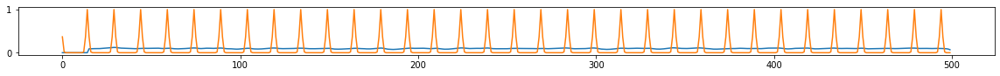

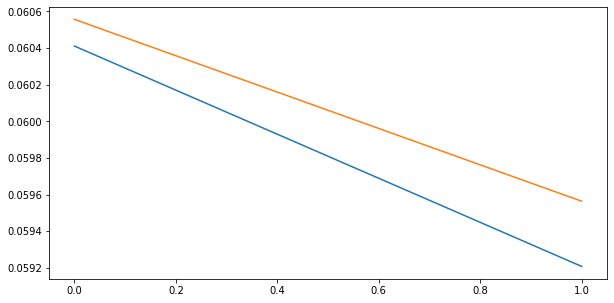

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.64it/s  0.0487                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

2 of 64
TRAIN LOSS: 0.05397287859684891
VAL LOSS: 0.04887723674376806
VAL_ACC50: 0.043989525877421505
VAL_ACC40: 0.2015656058090954


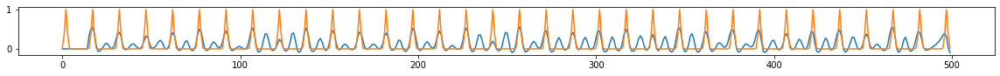

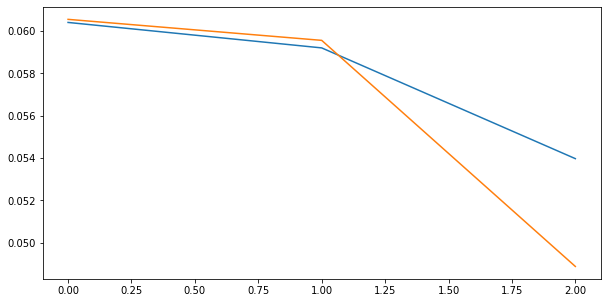

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.55it/s  0.0433                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

3 of 64
TRAIN LOSS: 0.04511240414447255
VAL LOSS: 0.0426621755792035
VAL_ACC50: 0.2415145434828189
VAL_ACC40: 0.43436292317223135


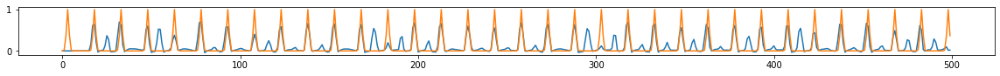

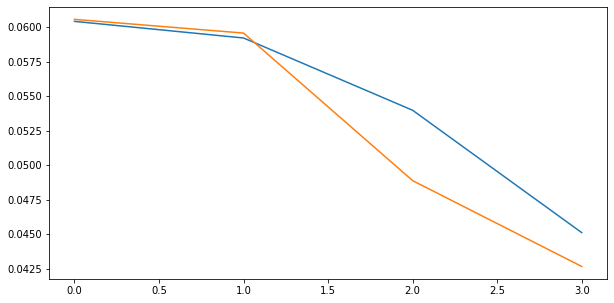

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.64it/s  0.0351                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

4 of 64
TRAIN LOSS: 0.04036910728447967
VAL LOSS: 0.03876886682377921
VAL_ACC50: 0.3871389766266717
VAL_ACC40: 0.5483543819501343


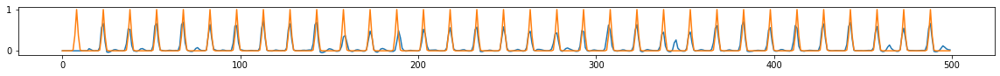

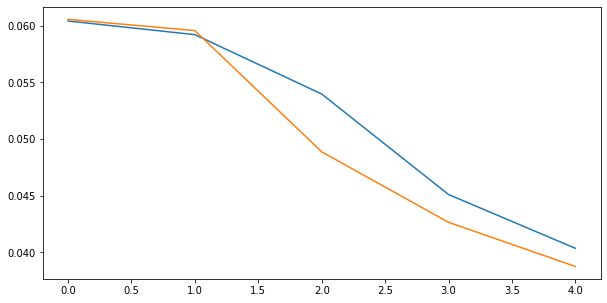

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.57it/s  0.0393                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

5 of 64
TRAIN LOSS: 0.03745702209158076
VAL LOSS: 0.03673068516784244
VAL_ACC50: 0.4796120821616375
VAL_ACC40: 0.6082875721280863


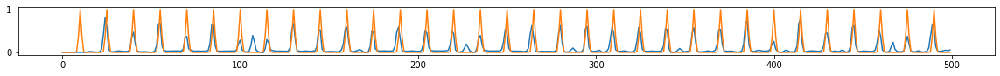

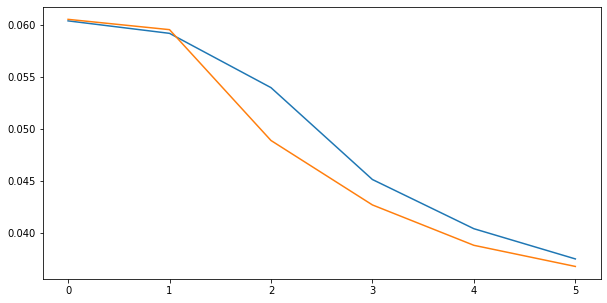

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.47it/s  0.0380                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

6 of 64
TRAIN LOSS: 0.039057339903795056
VAL LOSS: 0.04011329429017173
VAL_ACC50: 0.3479367219277479
VAL_ACC40: 0.5027197511063733


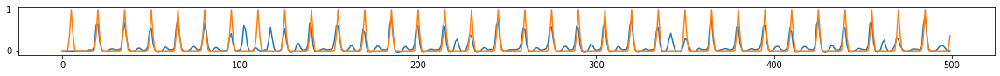

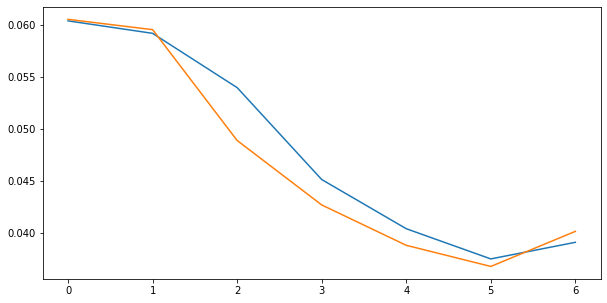

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.50it/s  0.0362                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

7 of 64
TRAIN LOSS: 0.03905768568317095
VAL LOSS: 0.0397100874947177
VAL_ACC50: 0.43002974503066155
VAL_ACC40: 0.5503797095552626


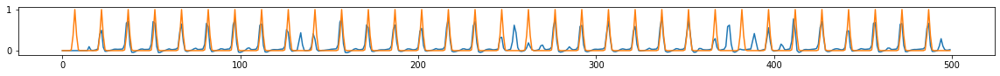

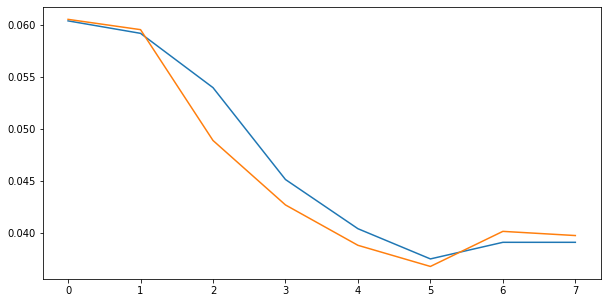

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.57it/s  0.0458                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

8 of 64
TRAIN LOSS: 0.03784450811023513
VAL LOSS: 0.039119223753611244
VAL_ACC50: 0.5174073540254053
VAL_ACC40: 0.6267161849990974


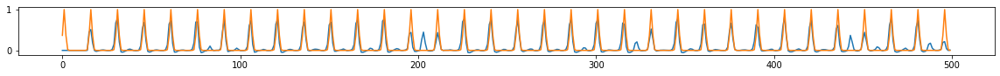

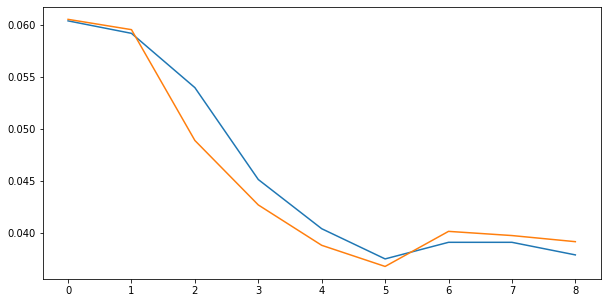

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.50it/s  0.0371                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

9 of 64
TRAIN LOSS: 0.036704841897719435
VAL LOSS: 0.03935631074839168
VAL_ACC50: 0.32437534437135107
VAL_ACC40: 0.505281603412181


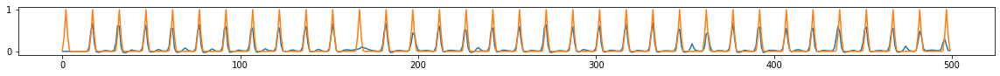

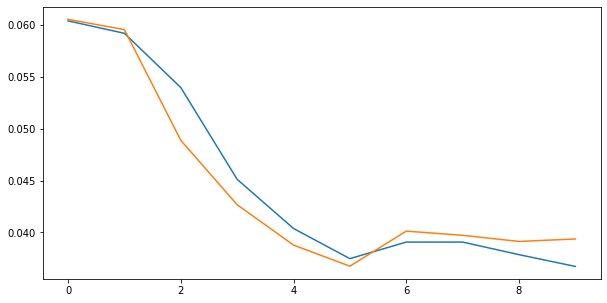

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.53it/s  0.0443                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

10 of 64
TRAIN LOSS: 0.04088018793198797
VAL LOSS: 0.04335133565796746
VAL_ACC50: 0.20831084656302146
VAL_ACC40: 0.4227623233731129


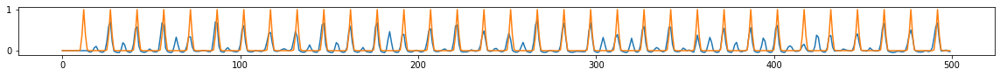

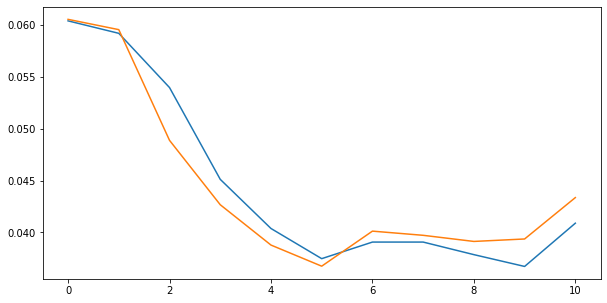

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.51it/s  0.0378                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

11 of 64
TRAIN LOSS: 0.041686266453729734
VAL LOSS: 0.042024162494473986
VAL_ACC50: 0.28962462659068644
VAL_ACC40: 0.4899137773808968


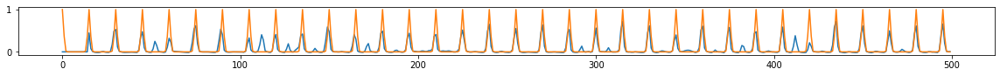

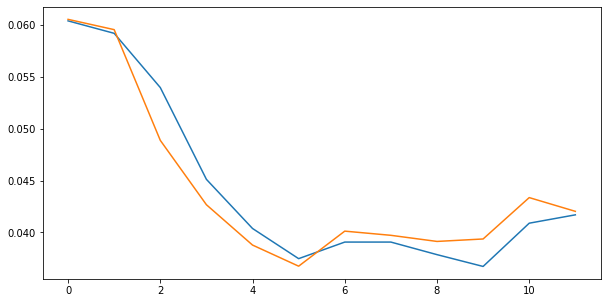

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.52it/s  0.0325                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

12 of 64
TRAIN LOSS: 0.0392551776021719
VAL LOSS: 0.0380791247718864
VAL_ACC50: 0.48681505599841896
VAL_ACC40: 0.6287306639531983


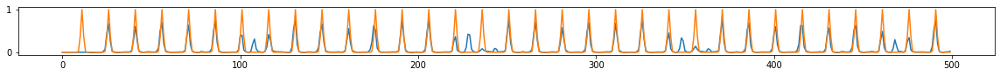

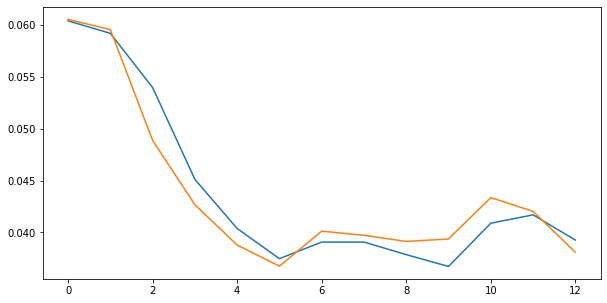

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.54it/s  0.0389                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

13 of 64
TRAIN LOSS: 0.036437362173779145
VAL LOSS: 0.036752832846509084
VAL_ACC50: 0.5364928487427716
VAL_ACC40: 0.6424628614443519


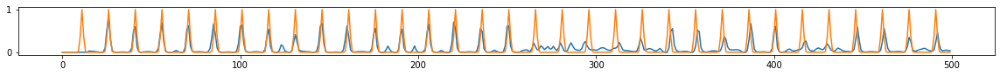

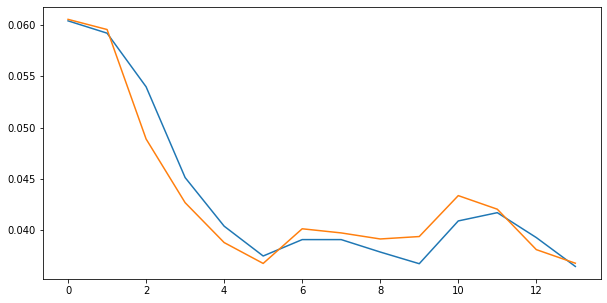

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.51it/s  0.0382                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

14 of 64
TRAIN LOSS: 0.035354767460376024
VAL LOSS: 0.03557026613917616
VAL_ACC50: 0.5441693097083807
VAL_ACC40: 0.6401847409926928


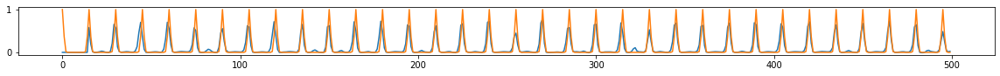

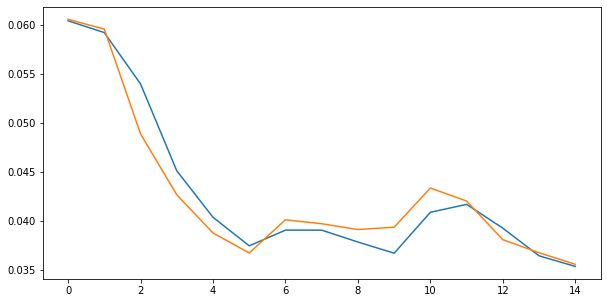

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.51it/s  0.0369                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

15 of 64
TRAIN LOSS: 0.03482352279954486
VAL LOSS: 0.034484220668673515
VAL_ACC50: 0.5814913374165194
VAL_ACC40: 0.6662135386309127


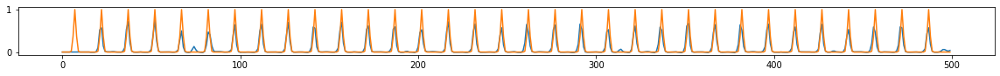

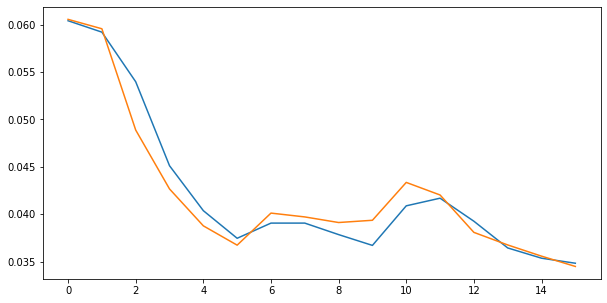

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.48it/s  0.0358                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

16 of 64
TRAIN LOSS: 0.033411623910069466
VAL LOSS: 0.03583517173926035
VAL_ACC50: 0.47844810995026577
VAL_ACC40: 0.6020068386991447


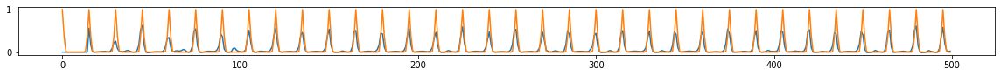

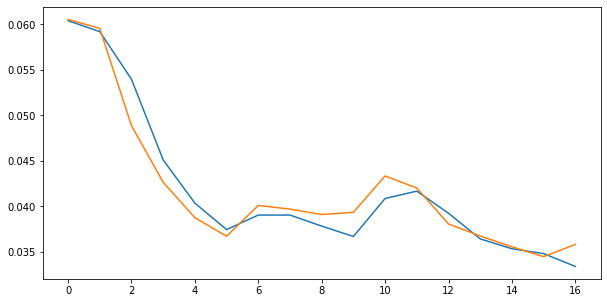

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.50it/s  0.0330                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

17 of 64
TRAIN LOSS: 0.03450522499365939
VAL LOSS: 0.03366064383751816
VAL_ACC50: 0.6053498630261429
VAL_ACC40: 0.6869745786408417


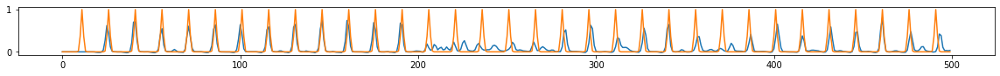

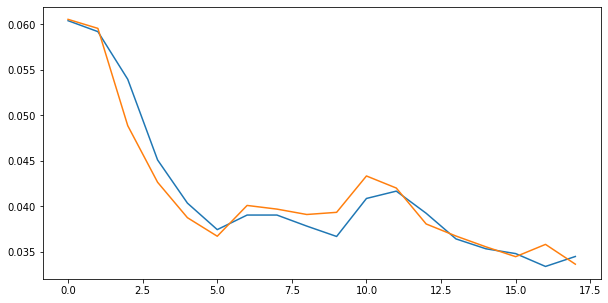

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.46it/s  0.0394                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

18 of 64
TRAIN LOSS: 0.03377425686145822
VAL LOSS: 0.0328924504833089
VAL_ACC50: 0.6119805730705354
VAL_ACC40: 0.7041926904061425


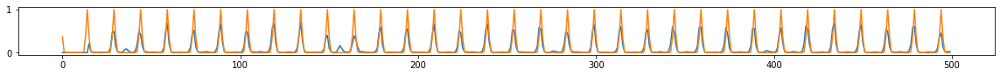

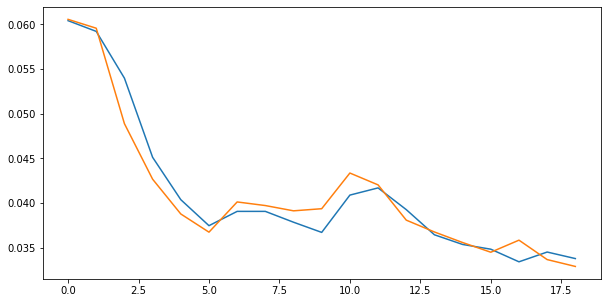

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.48it/s  0.0371                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

19 of 64
TRAIN LOSS: 0.03477454320010212
VAL LOSS: 0.034368846565485
VAL_ACC50: 0.5396374301067346
VAL_ACC40: 0.6475347873723227


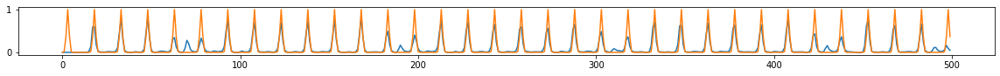

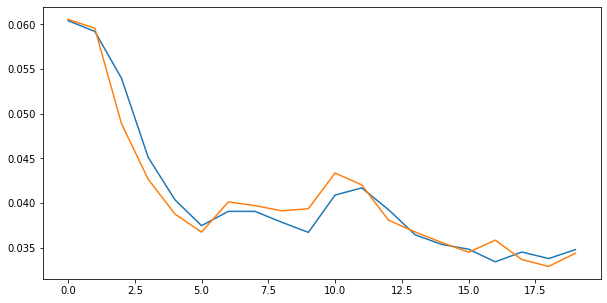

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.49it/s  0.0253                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

20 of 64
TRAIN LOSS: 0.033364439797070294
VAL LOSS: 0.03701006269289388
VAL_ACC50: 0.537609657033743
VAL_ACC40: 0.6249332071004121


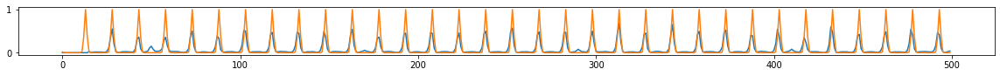

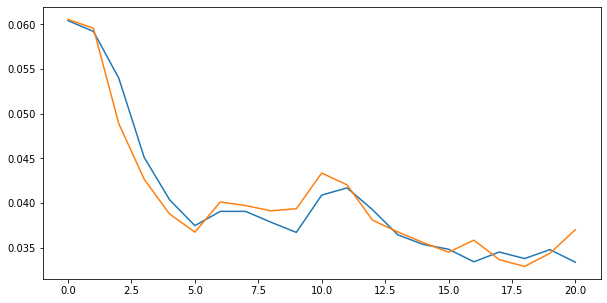

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.53it/s  0.0299                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

21 of 64
TRAIN LOSS: 0.0324939322243962
VAL LOSS: 0.034344824444916516
VAL_ACC50: 0.5801024694007463
VAL_ACC40: 0.6716474719531433


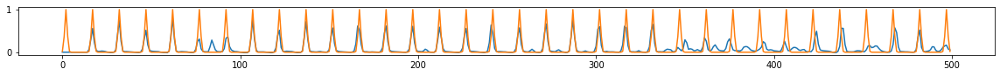

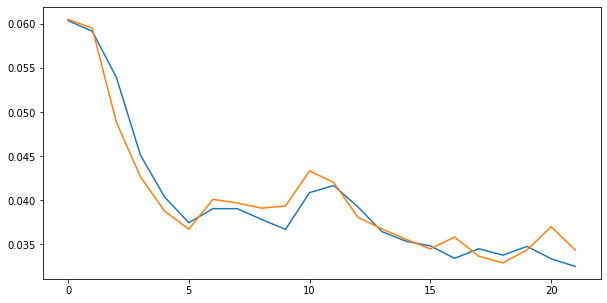

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.54it/s  0.0248                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

22 of 64
TRAIN LOSS: 0.032075746398833066
VAL LOSS: 0.030501787240306538
VAL_ACC50: 0.6592988607036856
VAL_ACC40: 0.7301813392201885


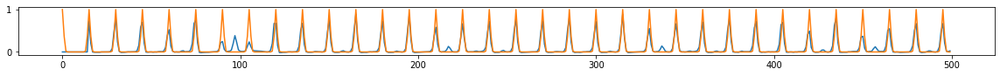

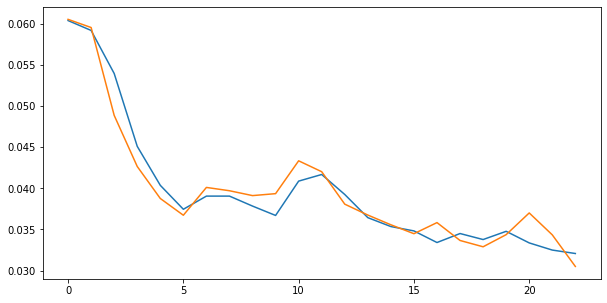

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.48it/s  0.0335                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

23 of 64
TRAIN LOSS: 0.03400330198928714
VAL LOSS: 0.033941329974267215
VAL_ACC50: 0.5813917843404246
VAL_ACC40: 0.6669133226141016


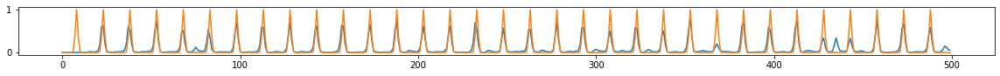

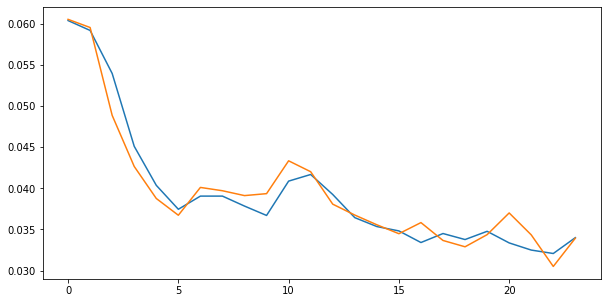

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.51it/s  0.0363                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

24 of 64
TRAIN LOSS: 0.03288320255362325
VAL LOSS: 0.032730653054184385
VAL_ACC50: 0.6366658476750717
VAL_ACC40: 0.7097969495743276


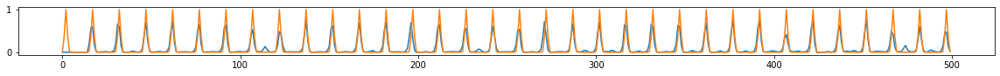

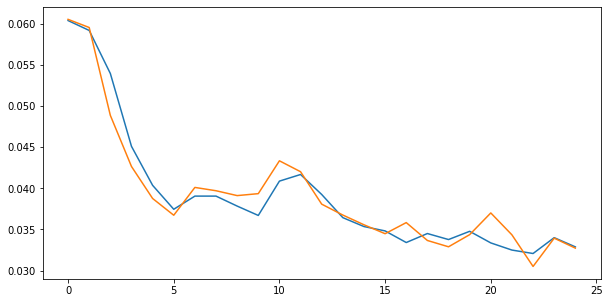

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.45it/s  0.0348                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

25 of 64
TRAIN LOSS: 0.032104033355911575
VAL LOSS: 0.034705414126316704
VAL_ACC50: 0.5851251273566449
VAL_ACC40: 0.6614758987814798


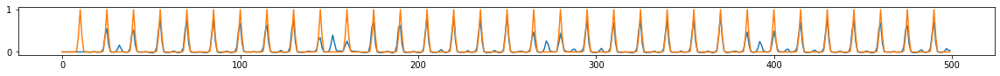

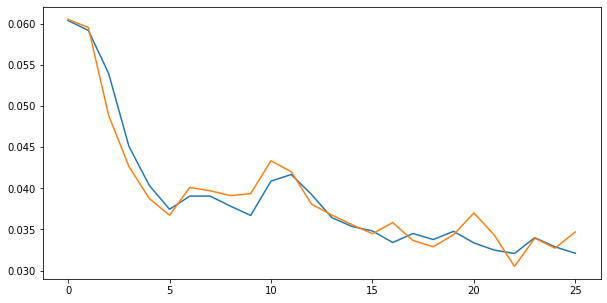

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.55it/s  0.0343                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

26 of 64
TRAIN LOSS: 0.03288227469763822
VAL LOSS: 0.032661283388733864
VAL_ACC50: 0.6491369736248797
VAL_ACC40: 0.7130167033222738


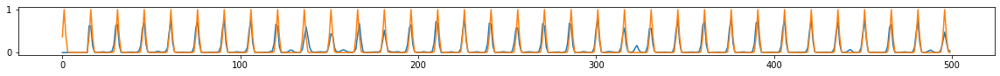

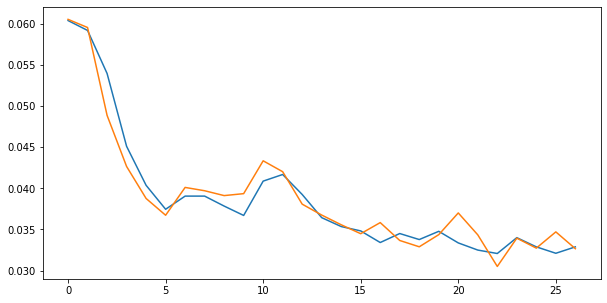

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.46it/s  0.0486                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

27 of 64
TRAIN LOSS: 0.04625352637635337
VAL LOSS: 0.050101334849993386
VAL_ACC50: 0.10936093316580182
VAL_ACC40: 0.2269906457480736


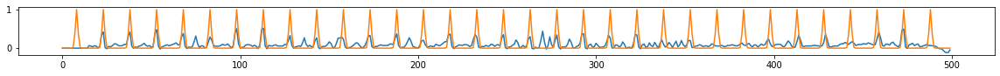

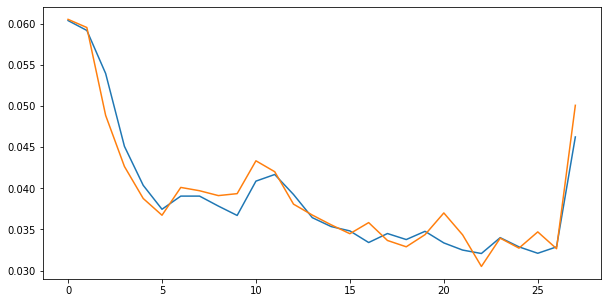

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.47it/s  0.0499                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

28 of 64
TRAIN LOSS: 0.04695519111636612
VAL LOSS: 0.044510066509246826
VAL_ACC50: 0.2756814675939017
VAL_ACC40: 0.5116307641915339


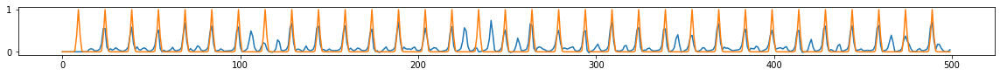

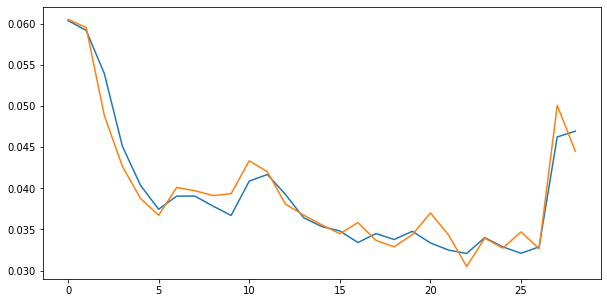

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.44it/s  0.0434                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

29 of 64
TRAIN LOSS: 0.04090669544206725
VAL LOSS: 0.04032557043764326
VAL_ACC50: 0.3298761095270768
VAL_ACC40: 0.5115746710718805


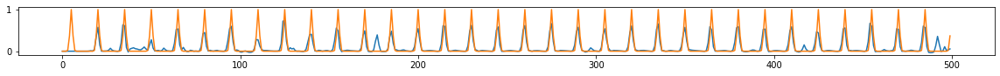

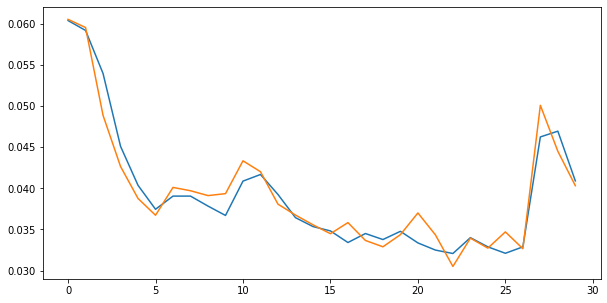

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.60it/s  0.0389                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

30 of 64
TRAIN LOSS: 0.03781049595110946
VAL LOSS: 0.03881844050354428
VAL_ACC50: 0.3991094019516639
VAL_ACC40: 0.5366747942256214


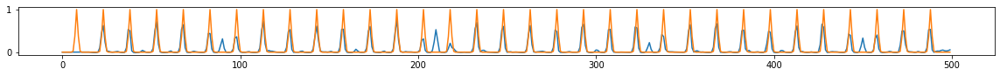

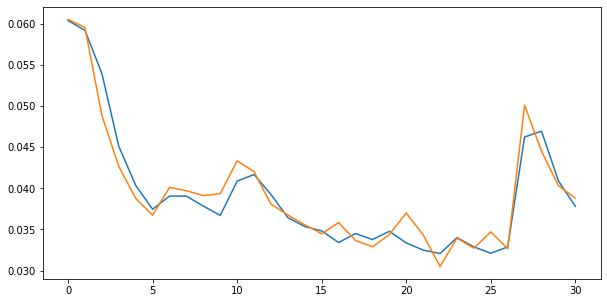

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.48it/s  0.0410                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

31 of 64
TRAIN LOSS: 0.03768289741128683
VAL LOSS: 0.043626352730724544
VAL_ACC50: 0.3890946103630654
VAL_ACC40: 0.6115231594350731


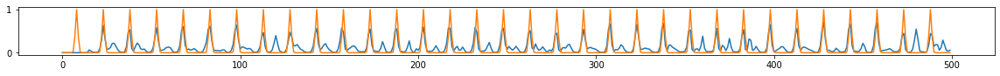

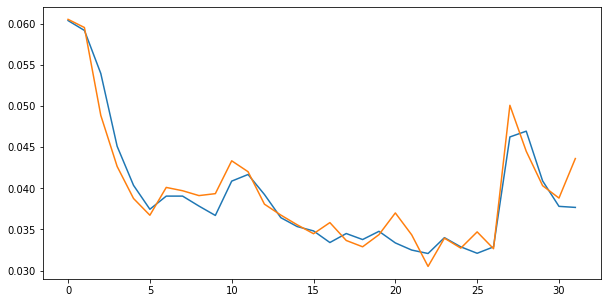

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.29it/s  0.0373                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

32 of 64
TRAIN LOSS: 0.0445568428064386
VAL LOSS: 0.04353325524263912
VAL_ACC50: 0.2820754117592887
VAL_ACC40: 0.45526310563998496


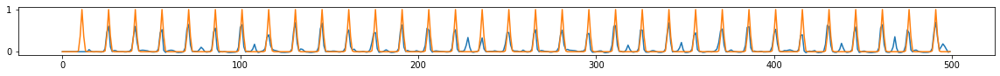

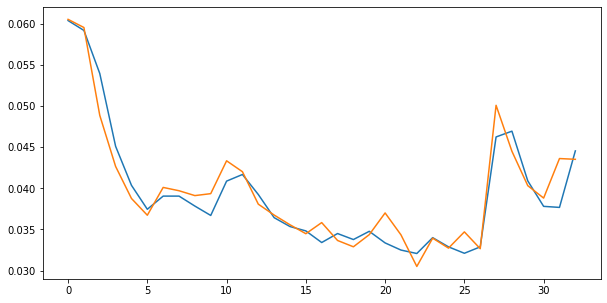

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.36it/s  0.0360                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

33 of 64
TRAIN LOSS: 0.03983380148808161
VAL LOSS: 0.03773697714010874
VAL_ACC50: 0.5162329198197719
VAL_ACC40: 0.6331898181515467


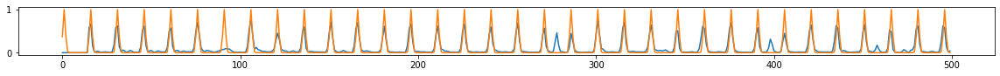

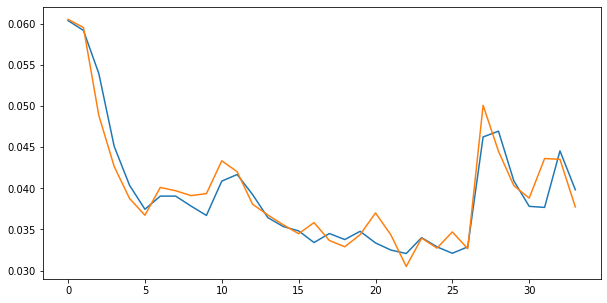

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.44it/s  0.0334                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

34 of 64
TRAIN LOSS: 0.037871785565382905
VAL LOSS: 0.03788449573847982
VAL_ACC50: 0.45371809851601785
VAL_ACC40: 0.5611772275512659


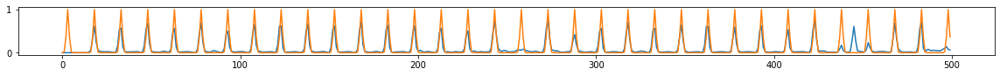

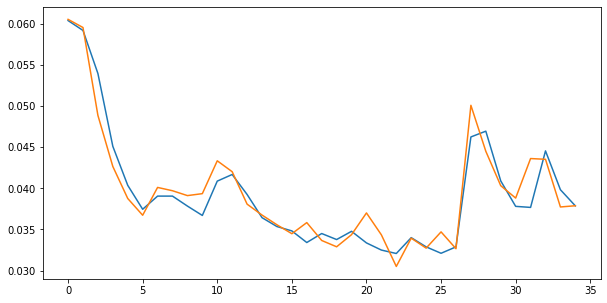

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.50it/s  0.0363                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

35 of 64
TRAIN LOSS: 0.03659559124045902
VAL LOSS: 0.03769847916232215
VAL_ACC50: 0.4311022491015948
VAL_ACC40: 0.5689087183190245


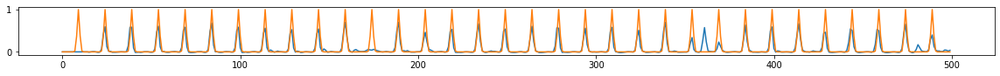

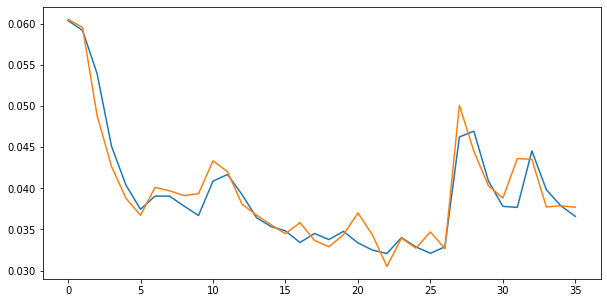

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.44it/s  0.0318                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

36 of 64
TRAIN LOSS: 0.03600690829464131
VAL LOSS: 0.037452150136232376
VAL_ACC50: 0.5269524146611425
VAL_ACC40: 0.6241928998489761


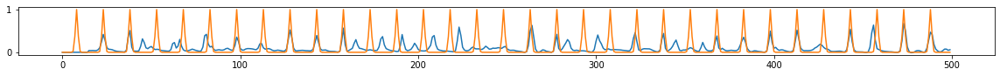

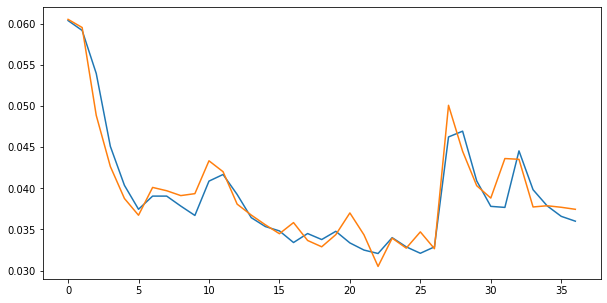

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.46it/s  0.0360                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

37 of 64
TRAIN LOSS: 0.03585267537790868
VAL LOSS: 0.03541642510228687
VAL_ACC50: 0.5651626178476659
VAL_ACC40: 0.6596733272640118


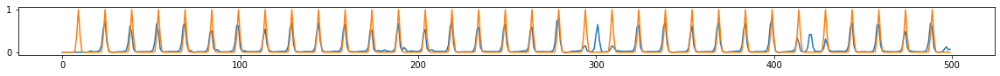

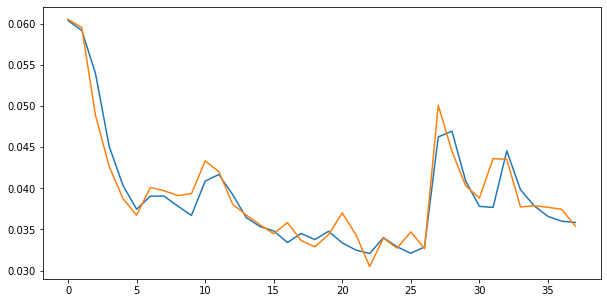

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.44it/s  0.0387                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

38 of 64
TRAIN LOSS: 0.034714423689163394
VAL LOSS: 0.03506031818687916
VAL_ACC50: 0.5675079179125143
VAL_ACC40: 0.6695768487592264


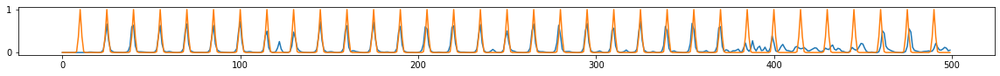

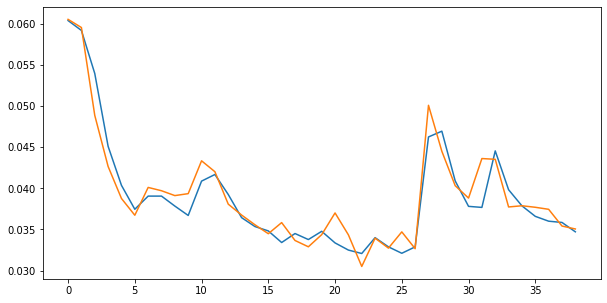

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.47it/s  0.0421                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

39 of 64
TRAIN LOSS: 0.033637452818867236
VAL LOSS: 0.0348357574807273
VAL_ACC50: 0.6542043057425491
VAL_ACC40: 0.7252037119558028


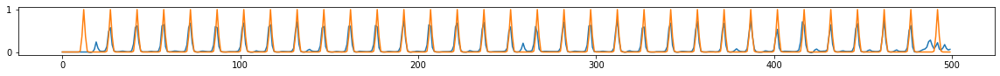

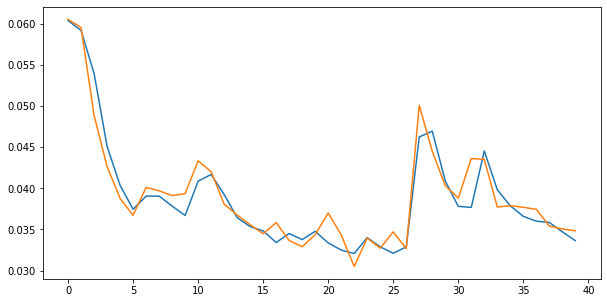

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.42it/s  0.0332                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

40 of 64
TRAIN LOSS: 0.03370241463805238
VAL LOSS: 0.03532252088189125
VAL_ACC50: 0.47396166817526936
VAL_ACC40: 0.6135445299444174


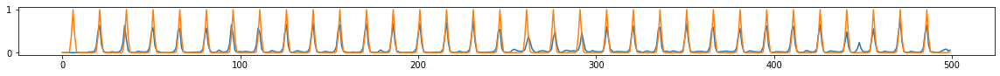

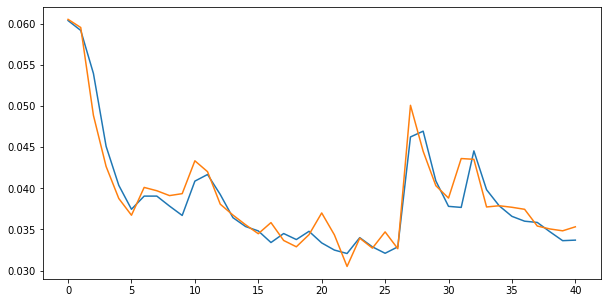

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.30it/s  0.0366                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

41 of 64
TRAIN LOSS: 0.03730080111159219
VAL LOSS: 0.03902260917756292
VAL_ACC50: 0.5748003178911228
VAL_ACC40: 0.6808889288055094


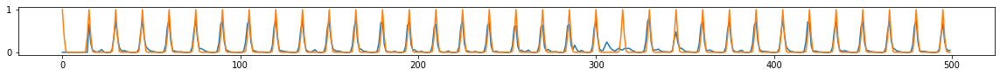

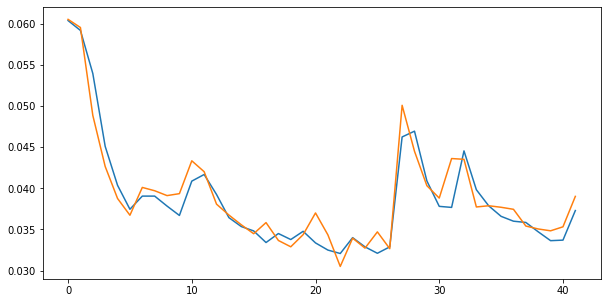

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.37it/s  0.0406                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

42 of 64
TRAIN LOSS: 0.03628763975575566
VAL LOSS: 0.03749784785840246
VAL_ACC50: 0.5315431751077211
VAL_ACC40: 0.6355426301184747


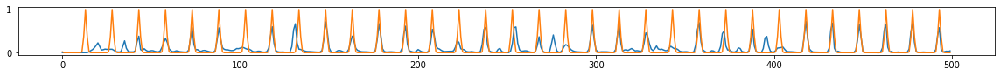

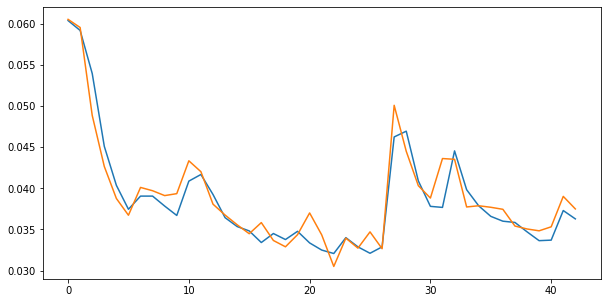

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.38it/s  0.0329                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

43 of 64
TRAIN LOSS: 0.034228515138642654
VAL LOSS: 0.033475147353278265
VAL_ACC50: 0.5924586240993235
VAL_ACC40: 0.6781028556429894


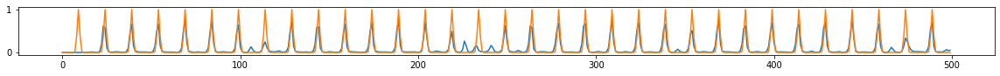

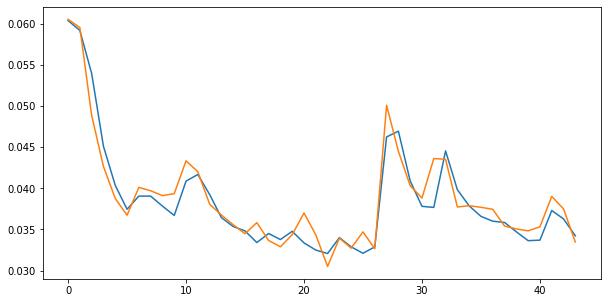

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.39it/s  0.0425                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

44 of 64
TRAIN LOSS: 0.033673483309232526
VAL LOSS: 0.032940601309140526
VAL_ACC50: 0.6107103509623728
VAL_ACC40: 0.6997621137981691


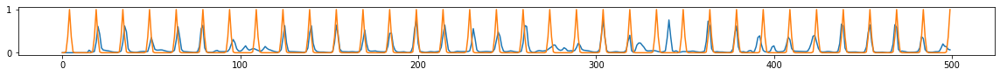

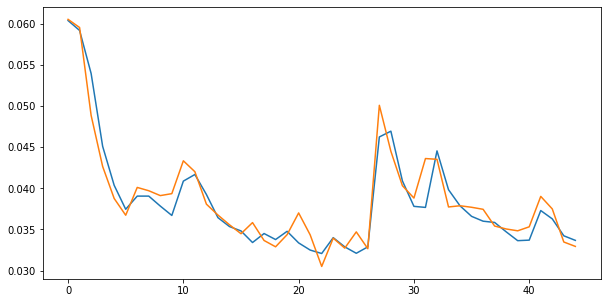

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.38it/s  0.0298                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

45 of 64
TRAIN LOSS: 0.03251672375740276
VAL LOSS: 0.033791998194323644
VAL_ACC50: 0.6117228545389679
VAL_ACC40: 0.6909547254956707


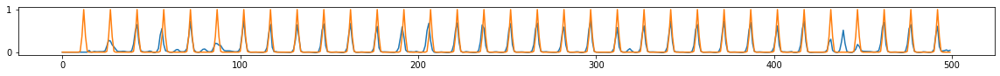

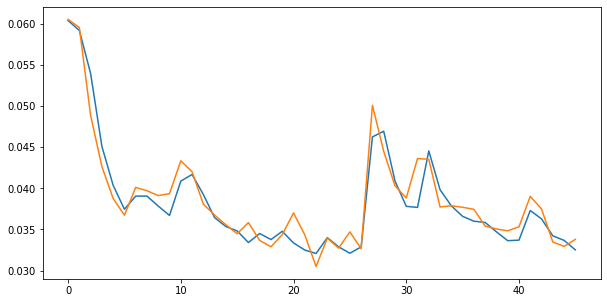

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.45it/s  0.0293                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

46 of 64
TRAIN LOSS: 0.03186023768244518
VAL LOSS: 0.03208482658697499
VAL_ACC50: 0.6811577741143525
VAL_ACC40: 0.7359979396549646


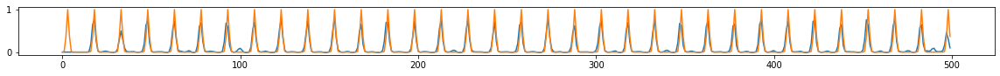

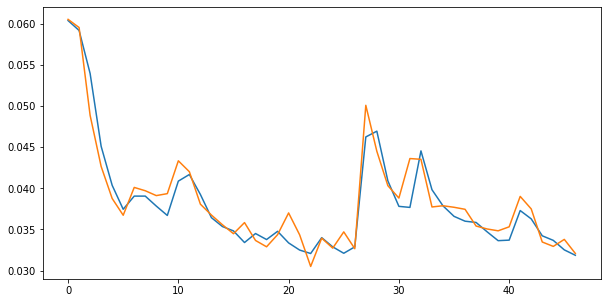

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.36it/s  0.0370                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

47 of 64
TRAIN LOSS: 0.0333242004012896
VAL LOSS: 0.03873607930209902
VAL_ACC50: 0.39667165617801586
VAL_ACC40: 0.5465539123093808


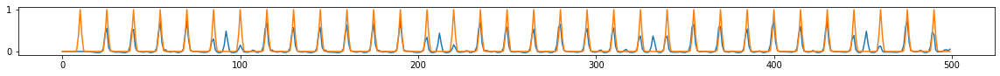

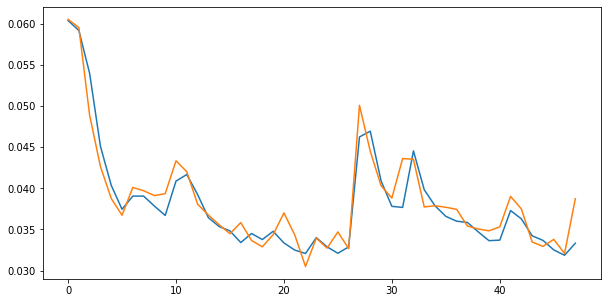

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.39it/s  0.0309                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

48 of 64
TRAIN LOSS: 0.03431519208889869
VAL LOSS: 0.03492966935866409
VAL_ACC50: 0.591977023208895
VAL_ACC40: 0.6753204176136455


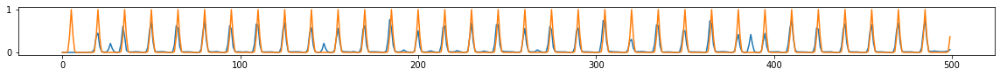

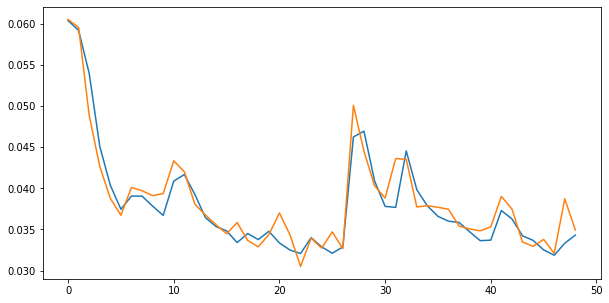

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.49it/s  0.0307                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

49 of 64
TRAIN LOSS: 0.03308088249630398
VAL LOSS: 0.03318500746455458
VAL_ACC50: 0.5325001906438902
VAL_ACC40: 0.6355457207190239


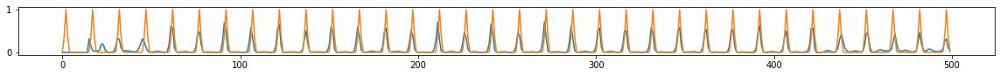

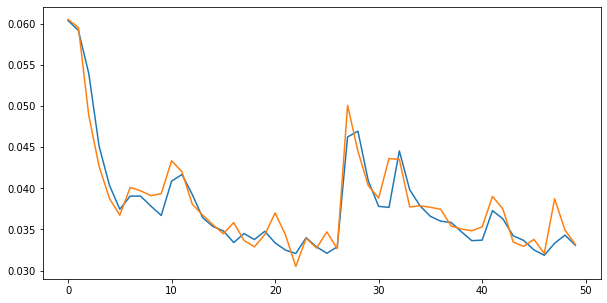

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.45it/s  0.0290                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

50 of 64
TRAIN LOSS: 0.031579759903252125
VAL LOSS: 0.03094391255742974
VAL_ACC50: 0.617118022245053
VAL_ACC40: 0.6982656930306255


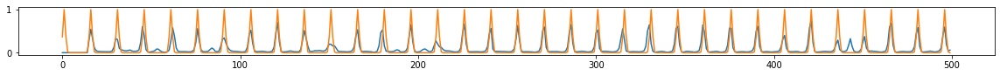

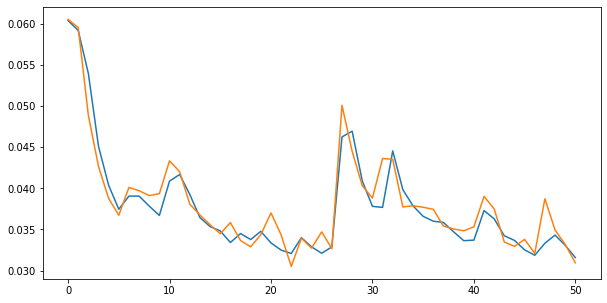

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.37it/s  0.0372                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

51 of 64
TRAIN LOSS: 0.03255806573563152
VAL LOSS: 0.03256431118481689
VAL_ACC50: 0.6655096449084894
VAL_ACC40: 0.7219673672277443


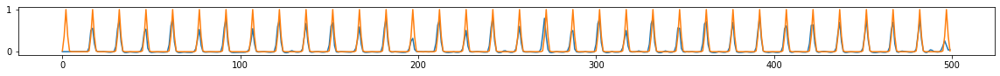

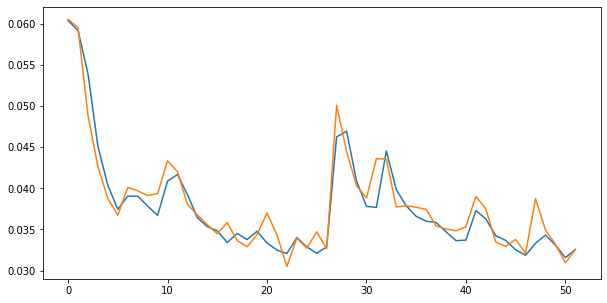

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.35it/s  0.0373                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

52 of 64
TRAIN LOSS: 0.03313065578954087
VAL LOSS: 0.034266300292478666
VAL_ACC50: 0.5770252259843792
VAL_ACC40: 0.6624910463199287


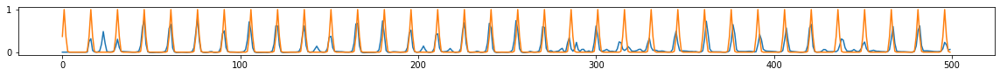

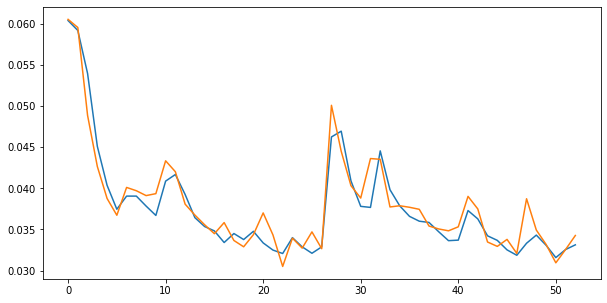

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.45it/s  0.0356                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

53 of 64
TRAIN LOSS: 0.03314660913828346
VAL LOSS: 0.033880911146601043
VAL_ACC50: 0.645240813757923
VAL_ACC40: 0.7241620195193649


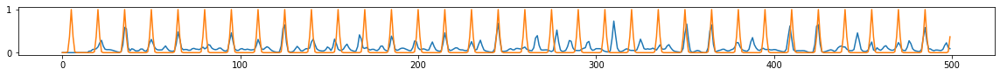

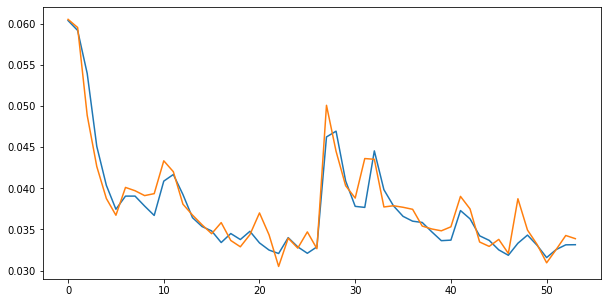

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.36it/s  0.0355                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

54 of 64
TRAIN LOSS: 0.03226591682889395
VAL LOSS: 0.03313418022460408
VAL_ACC50: 0.6002736283045393
VAL_ACC40: 0.6954216609388786


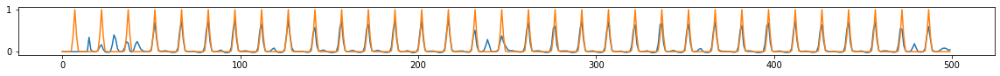

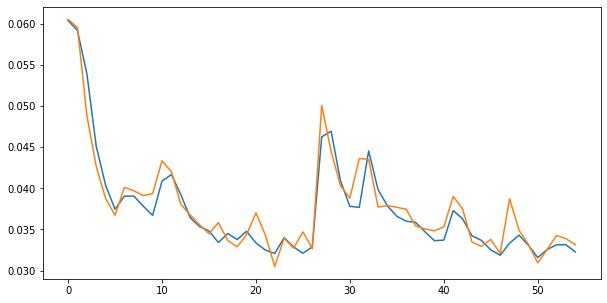

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.35it/s  0.0351                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

55 of 64
TRAIN LOSS: 0.032547427600042686
VAL LOSS: 0.03247968417902788
VAL_ACC50: 0.638307770298109
VAL_ACC40: 0.7115465629399362


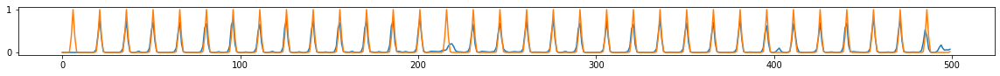

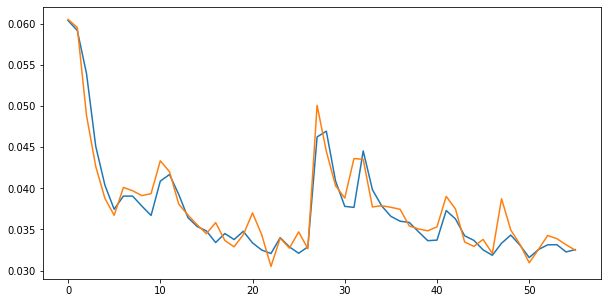

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.37it/s  0.0383                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

56 of 64
TRAIN LOSS: 0.031527862056261964
VAL LOSS: 0.03225756767723295
VAL_ACC50: 0.6541505330180275
VAL_ACC40: 0.7172078975911851


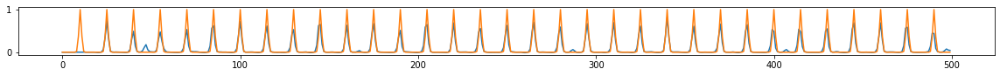

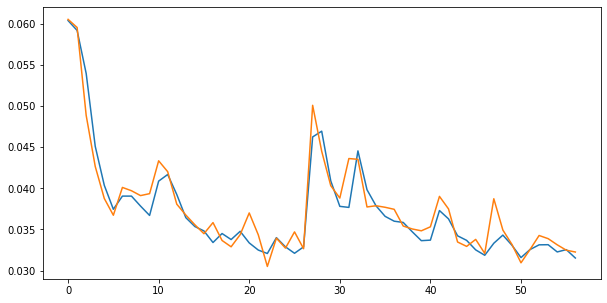

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.36it/s  0.0416                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

57 of 64
TRAIN LOSS: 0.03727097488525841
VAL LOSS: 0.040281732463174395
VAL_ACC50: 0.4588842821567441
VAL_ACC40: 0.5878246035963254


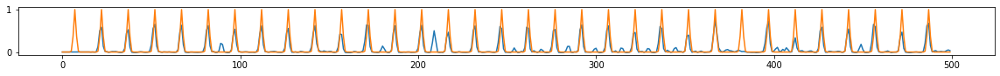

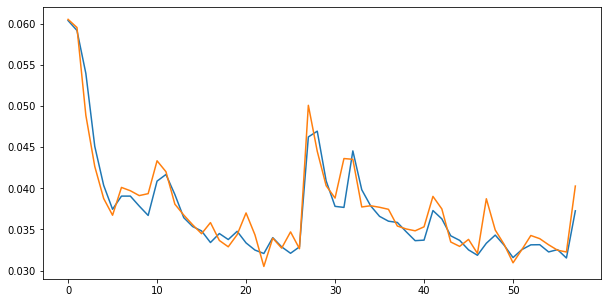

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.40it/s  0.0312                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

58 of 64
TRAIN LOSS: 0.03557364259743028
VAL LOSS: 0.035572598170903
VAL_ACC50: 0.5520292980771535
VAL_ACC40: 0.6499003355726578


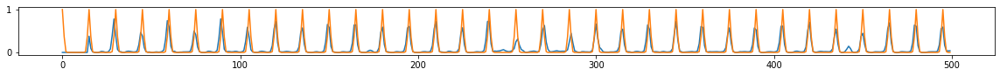

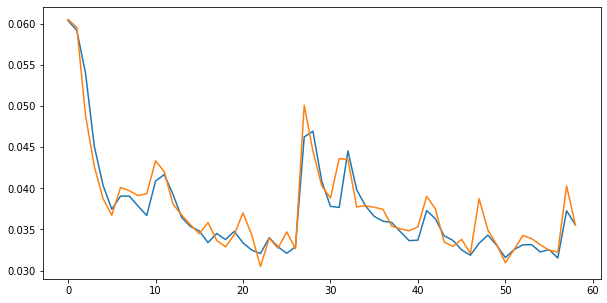

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.38it/s  0.0327                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

59 of 64
TRAIN LOSS: 0.0340850793549584
VAL LOSS: 0.03336437977850437
VAL_ACC50: 0.5709505945671424
VAL_ACC40: 0.6704557525990745


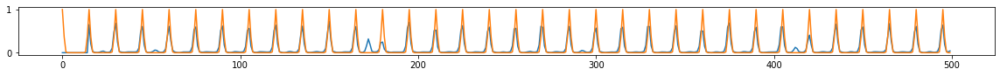

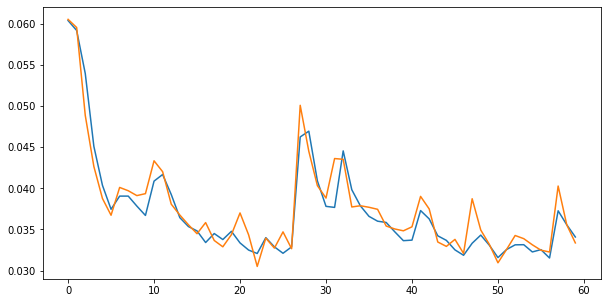

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.37it/s  0.0280                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

60 of 64
TRAIN LOSS: 0.03324322205864721
VAL LOSS: 0.03352540276116795
VAL_ACC50: 0.5829969257057733
VAL_ACC40: 0.671554436215385


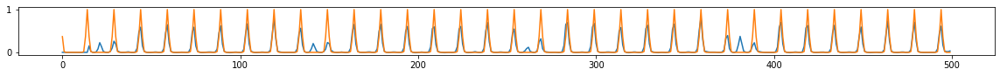

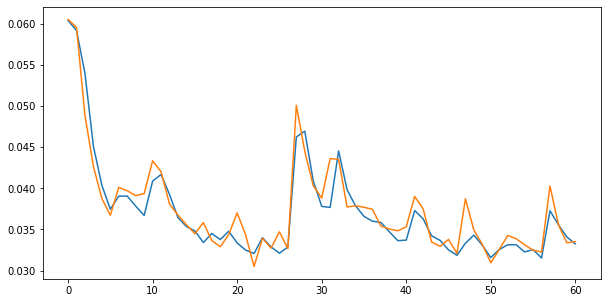

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.45it/s  0.0324                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

61 of 64
TRAIN LOSS: 0.03172659998138746
VAL LOSS: 0.03190223024123245
VAL_ACC50: 0.6284793302405793
VAL_ACC40: 0.713879474066915


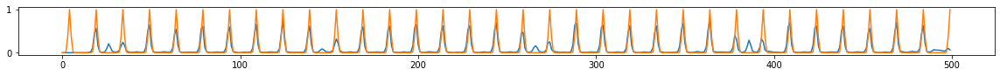

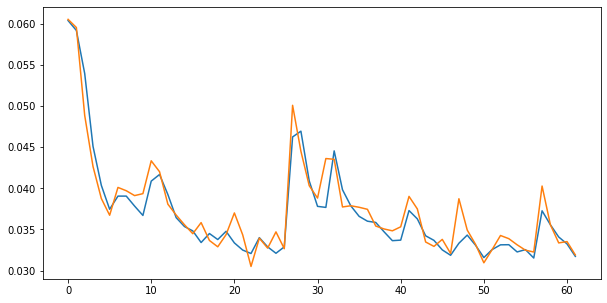

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.47it/s  0.0362                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

62 of 64
TRAIN LOSS: 0.032679145276132554
VAL LOSS: 0.03162825355927149
VAL_ACC50: 0.6275777489095112
VAL_ACC40: 0.7037991787934506


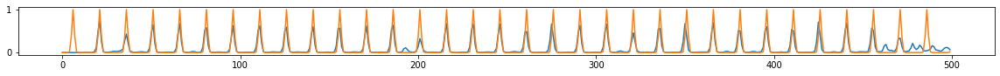

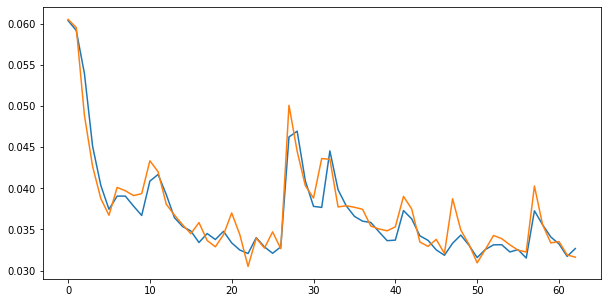

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.46it/s  0.0352                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

63 of 64
TRAIN LOSS: 0.032465670050846204
VAL LOSS: 0.03209485920766989
VAL_ACC50: 0.5836346817007437
VAL_ACC40: 0.6790134358428941


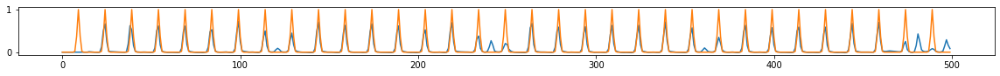

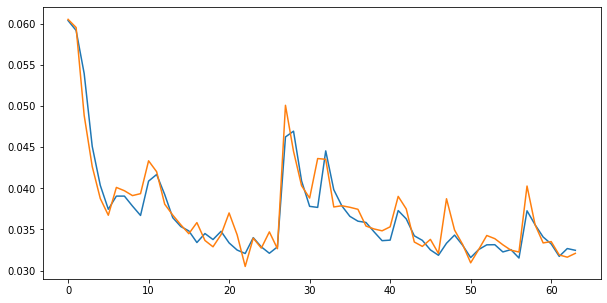

459.70279479026794 secs


In [36]:
start = time.time()

epochs = 64
trainBN()

end = time.time()
print(end - start, 'secs')

In [37]:
print(best_loss)
print(best_acc40)
torch.save(best_weights, bn_model_path + str(epoch_cum) + '.pt')

0.030501787240306538
0.7301813392201885


In [38]:
best_loss = 9999

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.41it/s  0.0296                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

64 of 128
TRAIN LOSS: 0.032887872929374375
VAL LOSS: 0.03637334663006994
VAL_ACC50: 0.4904581906802282
VAL_ACC40: 0.587024409256395


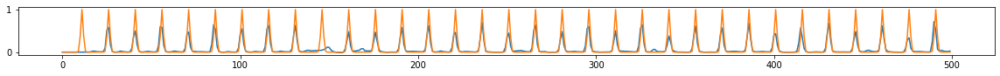

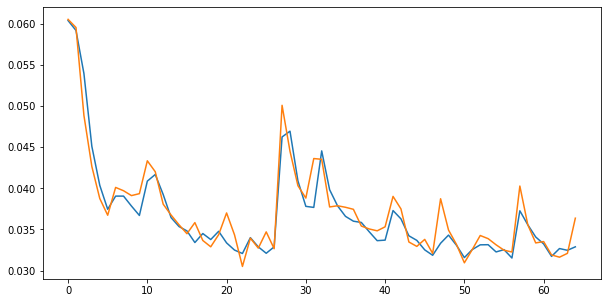

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.55it/s  0.0368                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

65 of 128
TRAIN LOSS: 0.04065064237349563
VAL LOSS: 0.03689119302564197
VAL_ACC50: 0.5079508701272065
VAL_ACC40: 0.6423123231692479


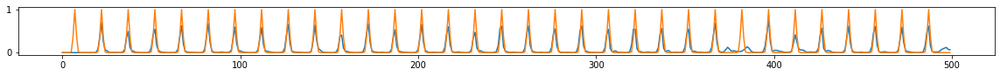

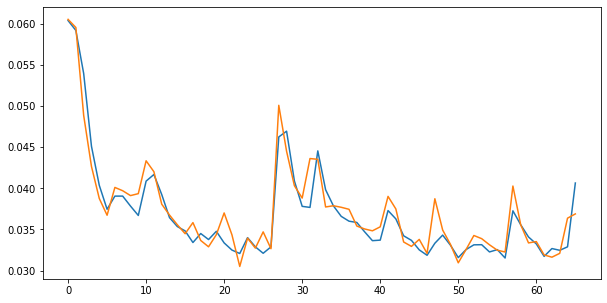

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.44it/s  0.0301                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

66 of 128
TRAIN LOSS: 0.0338451083128651
VAL LOSS: 0.03166270649267568
VAL_ACC50: 0.6013185064046973
VAL_ACC40: 0.7012442404299143


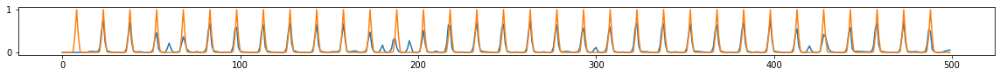

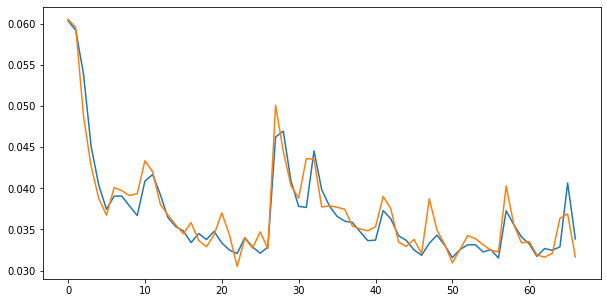

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.57it/s  0.0258                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

67 of 128
TRAIN LOSS: 0.03261474147439003
VAL LOSS: 0.03180330122510592
VAL_ACC50: 0.6452191001785669
VAL_ACC40: 0.7280326416321329


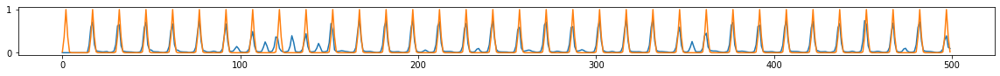

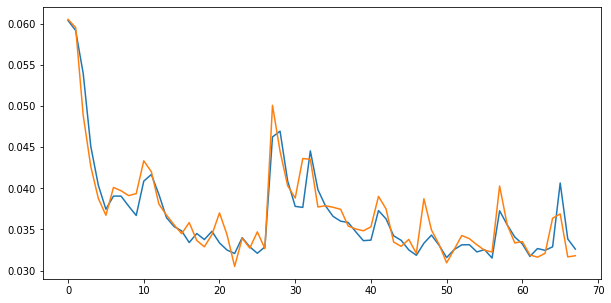

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.45it/s  0.0338                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

68 of 128
TRAIN LOSS: 0.036603426612499684
VAL LOSS: 0.03570237403942479
VAL_ACC50: 0.5567560171342464
VAL_ACC40: 0.6569082377797768


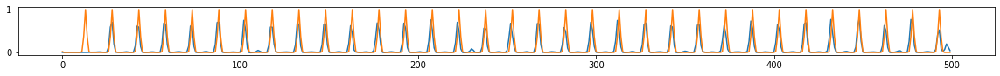

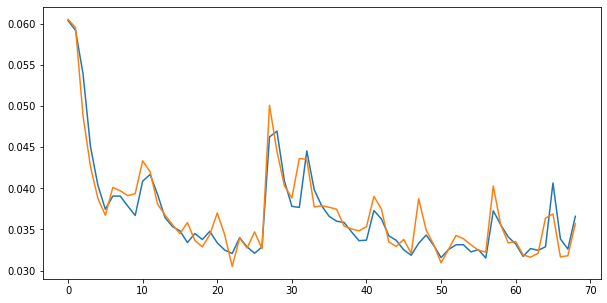

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.44it/s  0.0289                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

69 of 128
TRAIN LOSS: 0.034260999514824815
VAL LOSS: 0.03392690854767958
VAL_ACC50: 0.633957911177254
VAL_ACC40: 0.7066759986419826


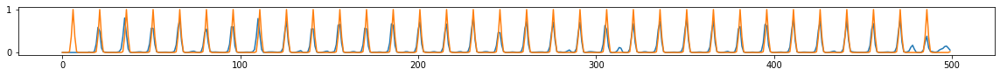

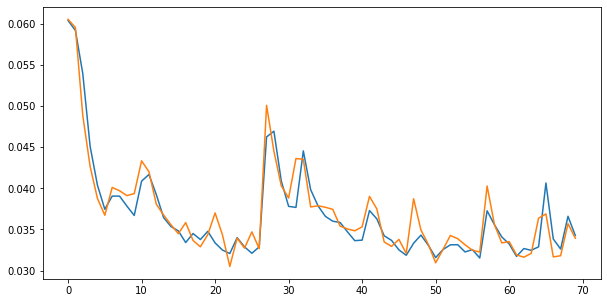

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.63it/s  0.0252                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

70 of 128
TRAIN LOSS: 0.03300932194623682
VAL LOSS: 0.0340942262361447
VAL_ACC50: 0.5911400361250636
VAL_ACC40: 0.679996911051809


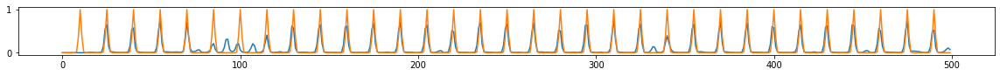

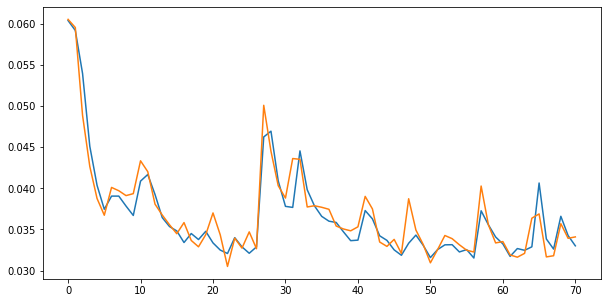

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.49it/s  0.0359                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

71 of 128
TRAIN LOSS: 0.0320658880389399
VAL LOSS: 0.032834831004341446
VAL_ACC50: 0.5670538469688491
VAL_ACC40: 0.662017215096964


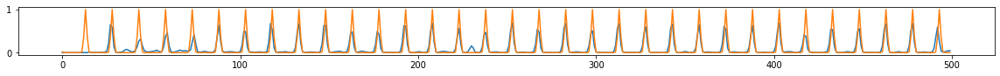

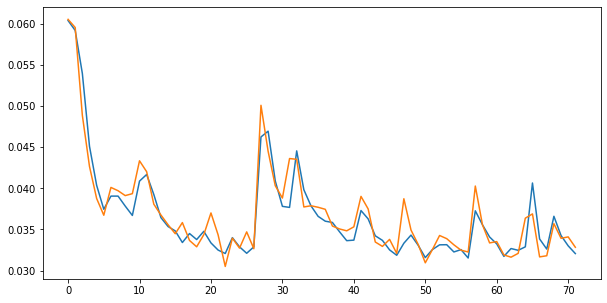

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.56it/s  0.0305                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

72 of 128
TRAIN LOSS: 0.03138795510555307
VAL LOSS: 0.033281205428971186
VAL_ACC50: 0.6294475329291986
VAL_ACC40: 0.6892240495761505


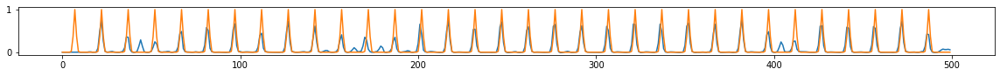

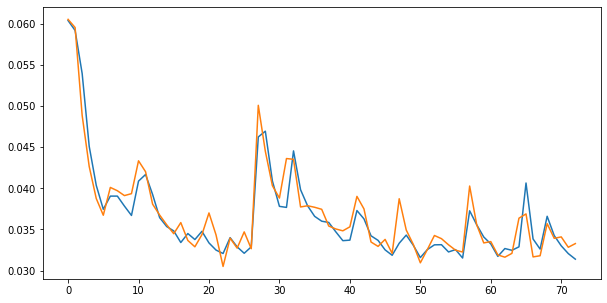

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.65it/s  0.0268                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

73 of 128
TRAIN LOSS: 0.03386613540351391
VAL LOSS: 0.03325648854176203
VAL_ACC50: 0.5473816337512489
VAL_ACC40: 0.6406451925083722


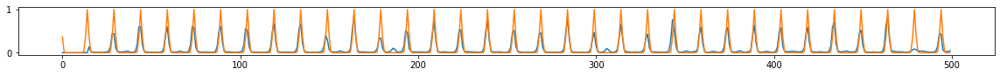

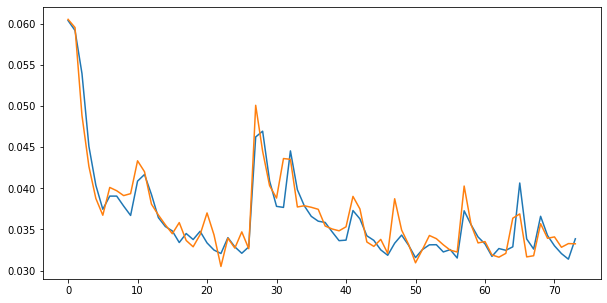

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.40it/s  0.0332                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

74 of 128
TRAIN LOSS: 0.031626873494436346
VAL LOSS: 0.031817338118950524
VAL_ACC50: 0.573087524051468
VAL_ACC40: 0.6697319883311317


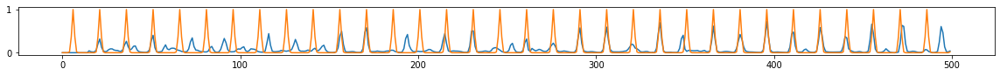

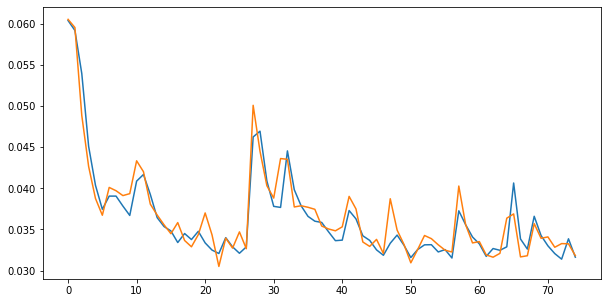

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.49it/s  0.0405                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

75 of 128
TRAIN LOSS: 0.037951253509769835
VAL LOSS: 0.04663965312971009
VAL_ACC50: 0.13553943103852317
VAL_ACC40: 0.3149574626875239


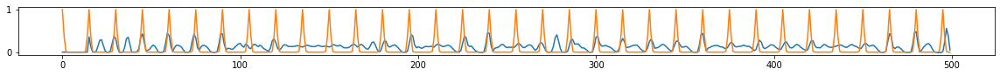

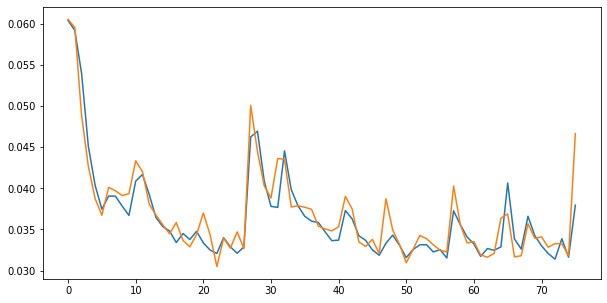

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.49it/s  0.0441                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

76 of 128
TRAIN LOSS: 0.043367214811344944
VAL LOSS: 0.04493326238460011
VAL_ACC50: 0.1560129905440497
VAL_ACC40: 0.3608650238032778


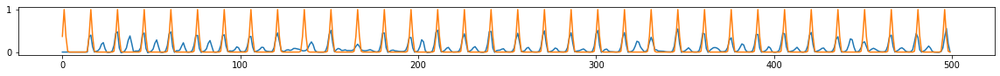

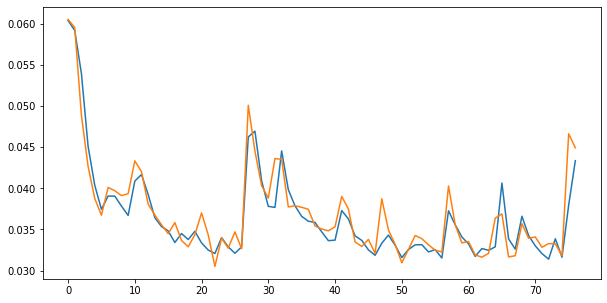

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.48it/s  0.0404                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

77 of 128
TRAIN LOSS: 0.04206186139749156
VAL LOSS: 0.04030514508485794
VAL_ACC50: 0.3433954116716885
VAL_ACC40: 0.4934625130600907


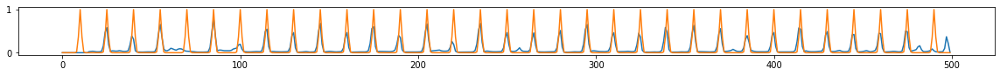

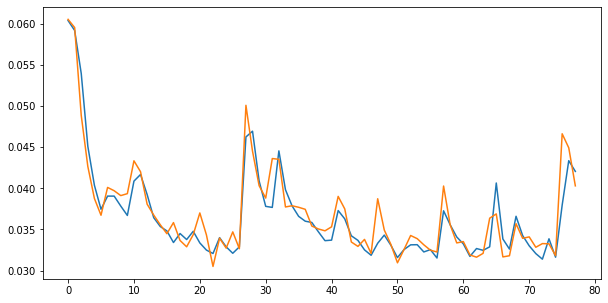

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.36it/s  0.0405                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

78 of 128
TRAIN LOSS: 0.04004815800322427
VAL LOSS: 0.041904949065711766
VAL_ACC50: 0.24851335712821815
VAL_ACC40: 0.409087630201452


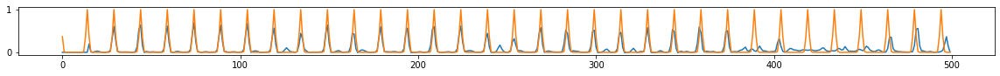

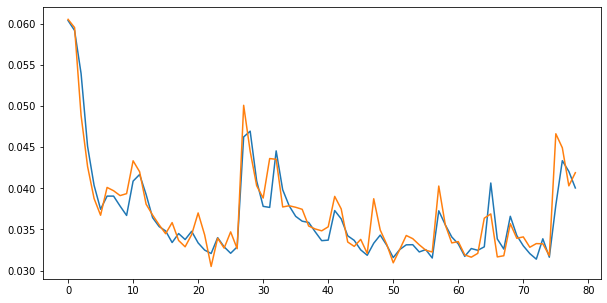

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.48it/s  0.0360                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

79 of 128
TRAIN LOSS: 0.037669343770378165
VAL LOSS: 0.03771276813414362
VAL_ACC50: 0.5209765904333117
VAL_ACC40: 0.6226240366611807


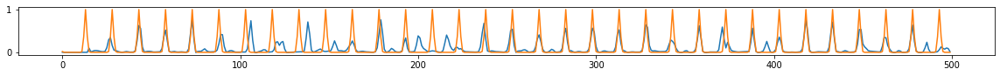

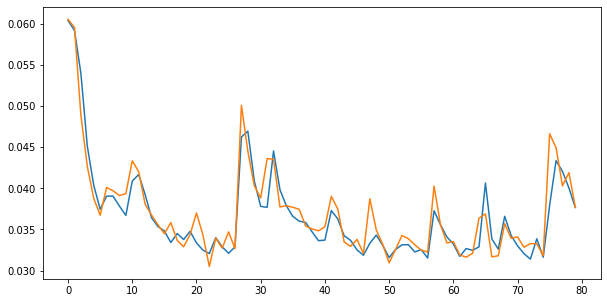

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.50it/s  0.0281                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

80 of 128
TRAIN LOSS: 0.036579191063841186
VAL LOSS: 0.03683587246470981
VAL_ACC50: 0.47444503742863603
VAL_ACC40: 0.5965856726130521


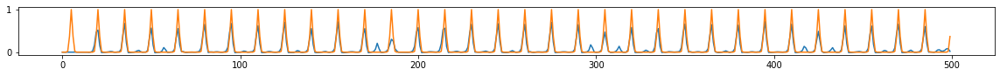

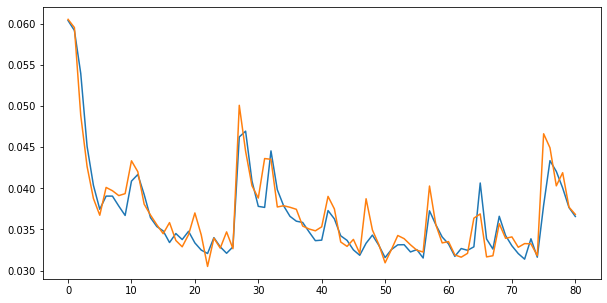

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.52it/s  0.0353                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

81 of 128
TRAIN LOSS: 0.03603729729851087
VAL LOSS: 0.036483346588081784
VAL_ACC50: 0.5261555318330321
VAL_ACC40: 0.6405956487640122


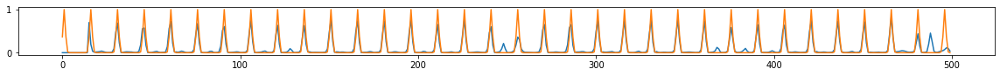

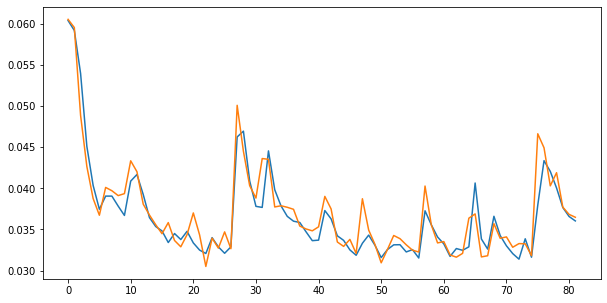

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.43it/s  0.0294                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

82 of 128
TRAIN LOSS: 0.03724326136418515
VAL LOSS: 0.037995116578208074
VAL_ACC50: 0.45738646731468247
VAL_ACC40: 0.5722117568070255


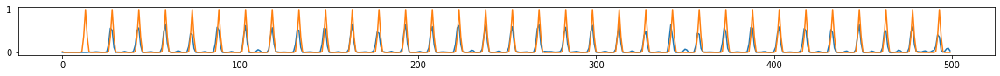

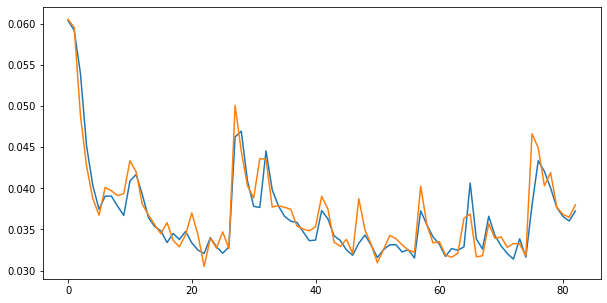

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.39it/s  0.0441                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

83 of 128
TRAIN LOSS: 0.035701047629117966
VAL LOSS: 0.03574144985112879
VAL_ACC50: 0.5664577989289366
VAL_ACC40: 0.6518346872345389


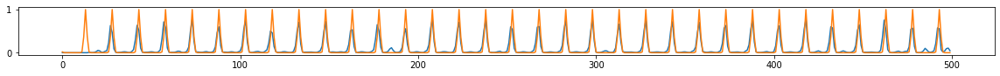

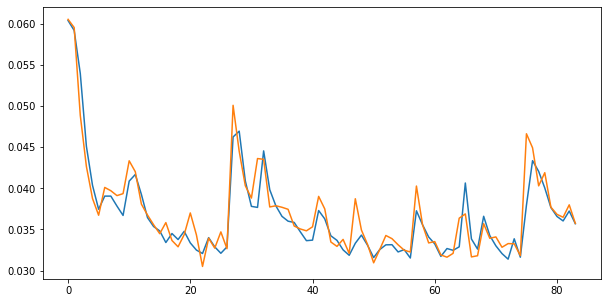

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.43it/s  0.0448                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

84 of 128
TRAIN LOSS: 0.037201847622378006
VAL LOSS: 0.03772017939223184
VAL_ACC50: 0.4680322277728186
VAL_ACC40: 0.5990498170108721


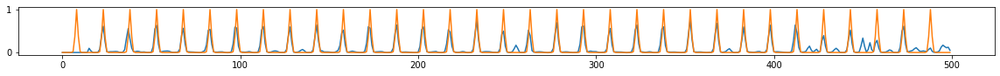

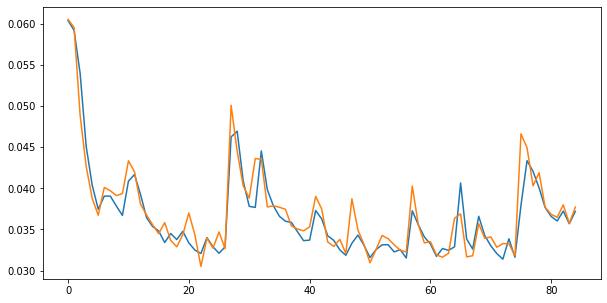

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.55it/s  0.0331                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

85 of 128
TRAIN LOSS: 0.037066779358105525
VAL LOSS: 0.036117884847852916
VAL_ACC50: 0.5438143033957328
VAL_ACC40: 0.6477610184325338


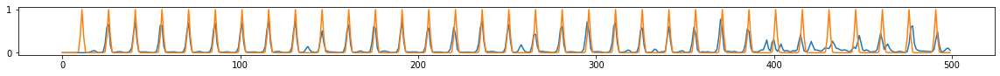

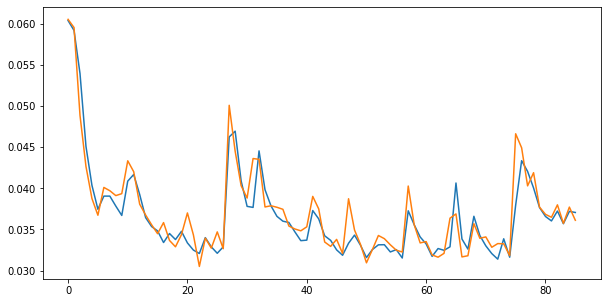

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.52it/s  0.0343                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

86 of 128
TRAIN LOSS: 0.03533378698759609
VAL LOSS: 0.035573167726397514
VAL_ACC50: 0.5832001397688942
VAL_ACC40: 0.6792409542358773


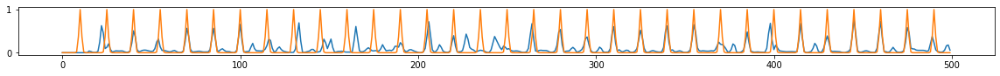

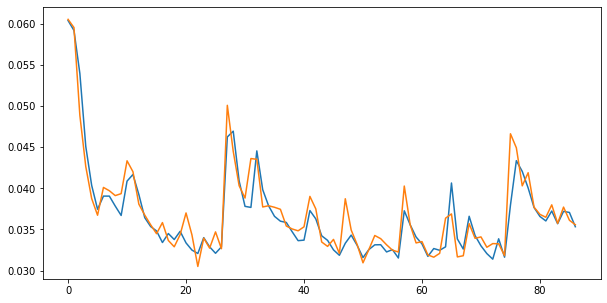

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.43it/s  0.0360                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

87 of 128
TRAIN LOSS: 0.03501158611228069
VAL LOSS: 0.03519128428565131
VAL_ACC50: 0.5884248548992979
VAL_ACC40: 0.6719421356661194


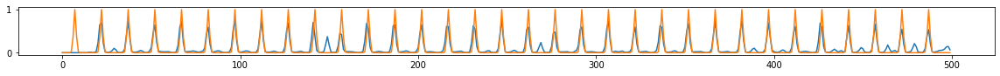

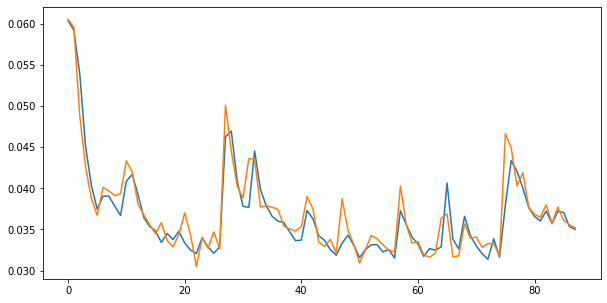

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.46it/s  0.0329                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

88 of 128
TRAIN LOSS: 0.03502121241763234
VAL LOSS: 0.035926600711213216
VAL_ACC50: 0.5677630390951305
VAL_ACC40: 0.6504611418316031


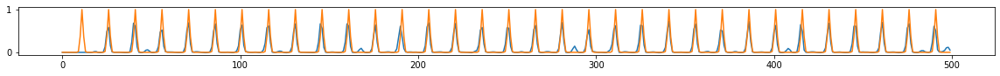

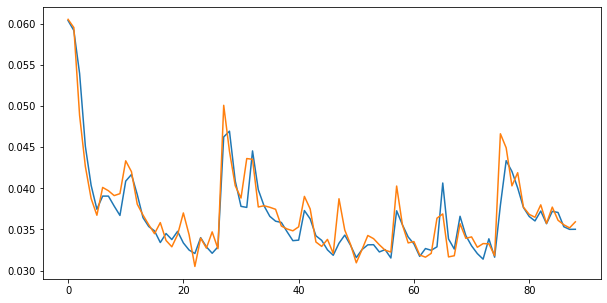

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.49it/s  0.0326                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

89 of 128
TRAIN LOSS: 0.03426532317987747
VAL LOSS: 0.03639553818437788
VAL_ACC50: 0.5698384572454602
VAL_ACC40: 0.671182810886783


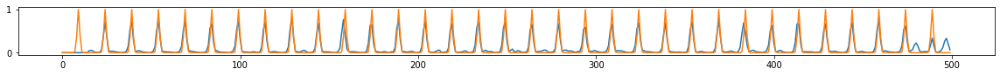

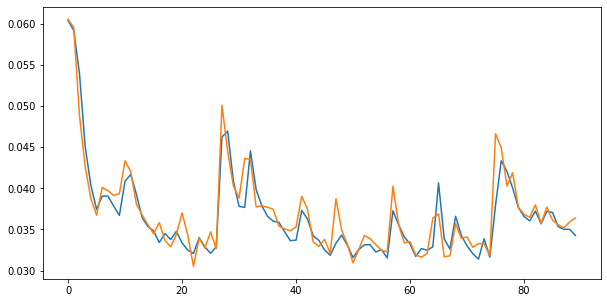

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.49it/s  0.0263                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

90 of 128
TRAIN LOSS: 0.03527315680144562
VAL LOSS: 0.035880765981144376
VAL_ACC50: 0.5621541338372855
VAL_ACC40: 0.6511117821991723


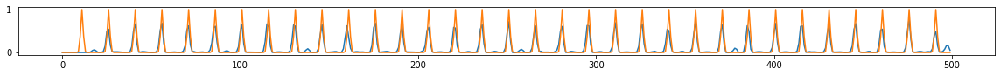

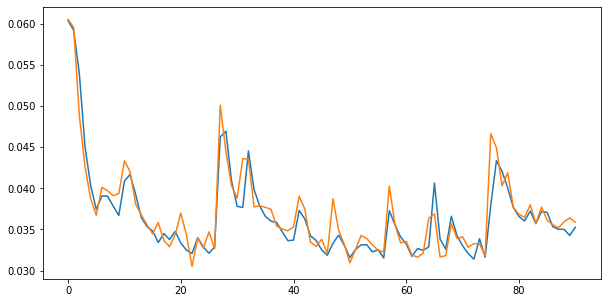

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.39it/s  0.0306                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

91 of 128
TRAIN LOSS: 0.03611544918061958
VAL LOSS: 0.033525215461850166
VAL_ACC50: 0.569480783889656
VAL_ACC40: 0.6655812405763921


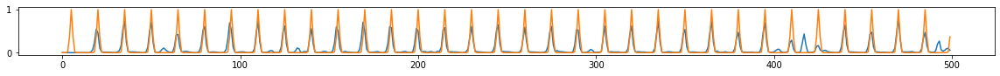

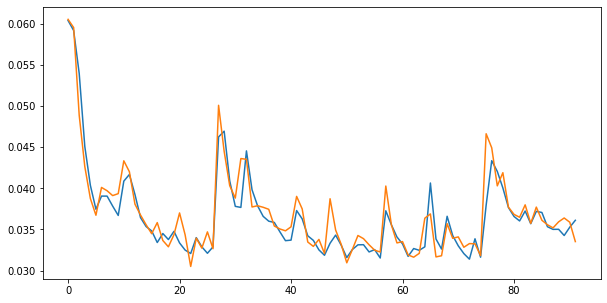

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.39it/s  0.0367                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

92 of 128
TRAIN LOSS: 0.0339949698601332
VAL LOSS: 0.033743358527620636
VAL_ACC50: 0.5609596185352603
VAL_ACC40: 0.6676231759143771


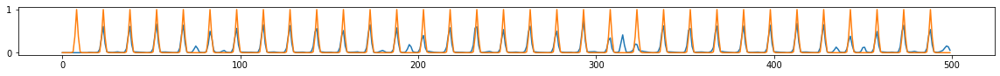

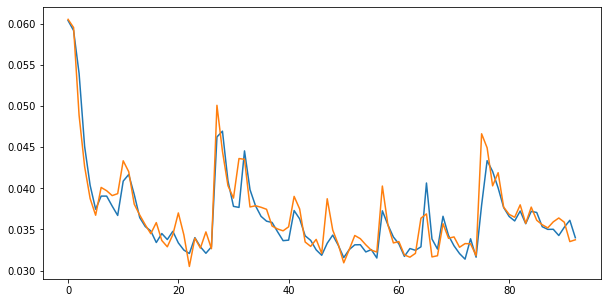

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.50it/s  0.0331                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

93 of 128
TRAIN LOSS: 0.0342871630564332
VAL LOSS: 0.03419848076171345
VAL_ACC50: 0.5912992363987202
VAL_ACC40: 0.6850369307246792


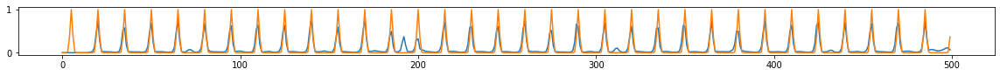

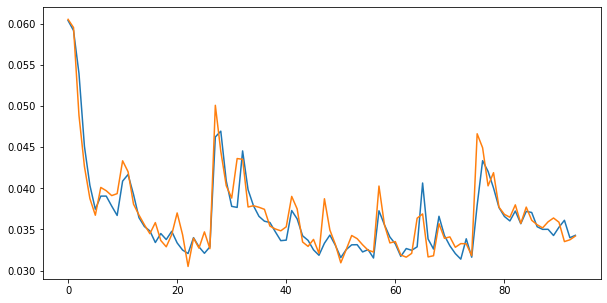

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.48it/s  0.0314                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

94 of 128
TRAIN LOSS: 0.033180036685532995
VAL LOSS: 0.03435871149930689
VAL_ACC50: 0.5748423411425664
VAL_ACC40: 0.6556107146125189


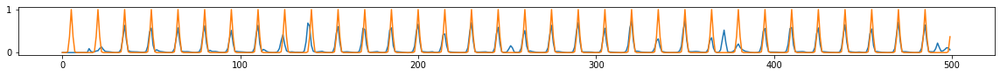

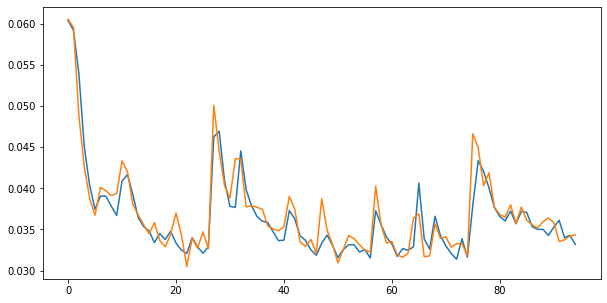

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.47it/s  0.0311                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

95 of 128
TRAIN LOSS: 0.033933310200356774
VAL LOSS: 0.03401118806666798
VAL_ACC50: 0.5869844745627943
VAL_ACC40: 0.6670043761458361


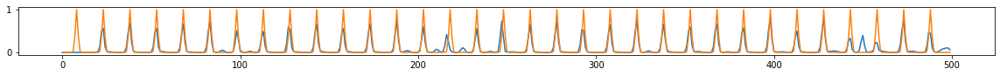

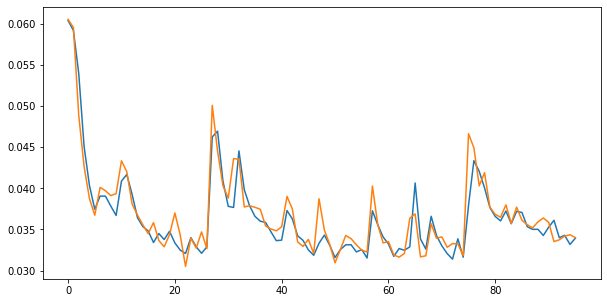

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.37it/s  0.0362                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

96 of 128
TRAIN LOSS: 0.03406521936671601
VAL LOSS: 0.03298040914038817
VAL_ACC50: 0.6218503782482351
VAL_ACC40: 0.7112945929063622


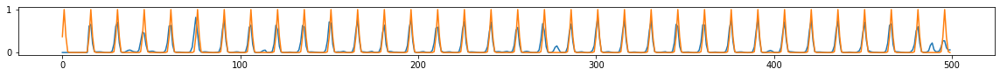

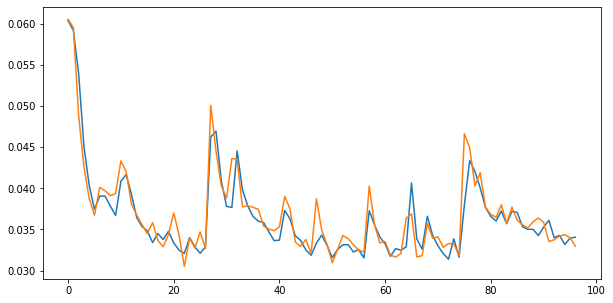

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.42it/s  0.0349                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

97 of 128
TRAIN LOSS: 0.033673019924511514
VAL LOSS: 0.03501268227895101
VAL_ACC50: 0.5294009272847209
VAL_ACC40: 0.6545413486784738


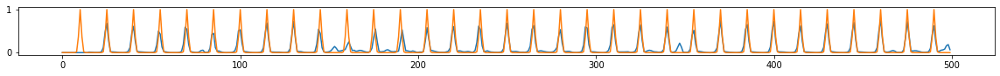

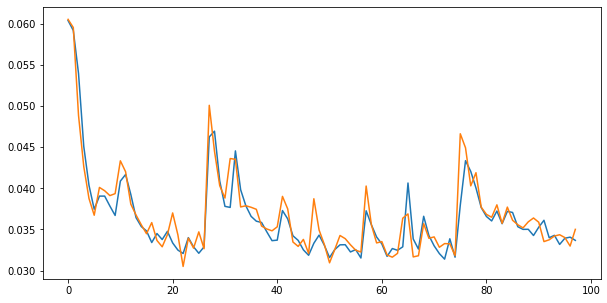

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.46it/s  0.0283                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

98 of 128
TRAIN LOSS: 0.033885382012360625
VAL LOSS: 0.033388769874970116
VAL_ACC50: 0.5981360914283756
VAL_ACC40: 0.6812717923090659


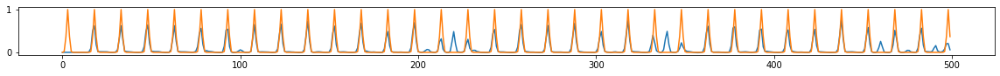

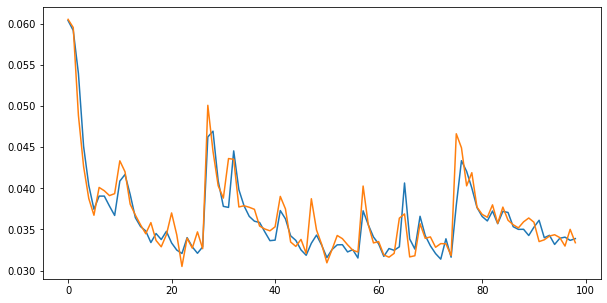

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.46it/s  0.0361                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

99 of 128
TRAIN LOSS: 0.03274320003887018
VAL LOSS: 0.03953425296478801
VAL_ACC50: 0.48186268665872856
VAL_ACC40: 0.5700176768094961


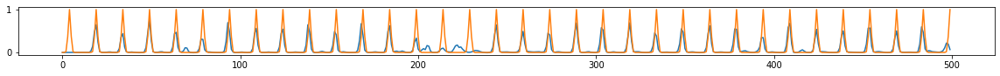

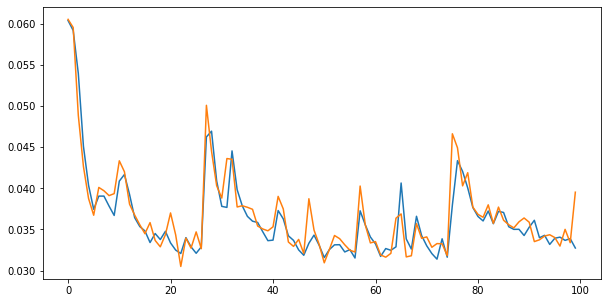

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.46it/s  0.0353                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

100 of 128
TRAIN LOSS: 0.034778899875366025
VAL LOSS: 0.03466850581268469
VAL_ACC50: 0.5537413949390975
VAL_ACC40: 0.6573502360189463


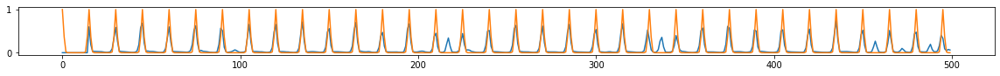

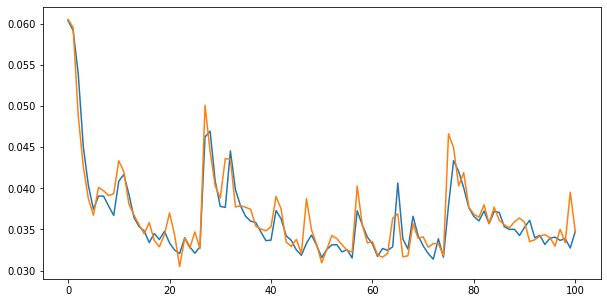

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.44it/s  0.0291                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

101 of 128
TRAIN LOSS: 0.032703737469597
VAL LOSS: 0.034790817027290664
VAL_ACC50: 0.585464920385983
VAL_ACC40: 0.6689110133228905


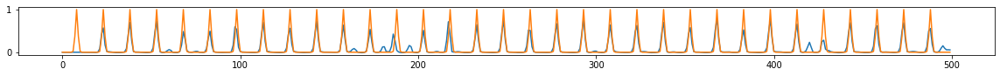

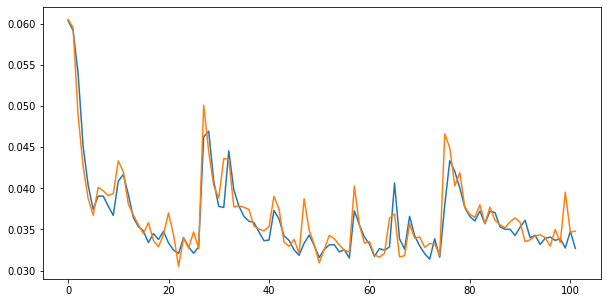

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.48it/s  0.0282                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

102 of 128
TRAIN LOSS: 0.03269459415848056
VAL LOSS: 0.03215365753405624
VAL_ACC50: 0.6066954682807801
VAL_ACC40: 0.6984087352983072


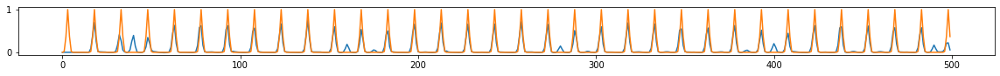

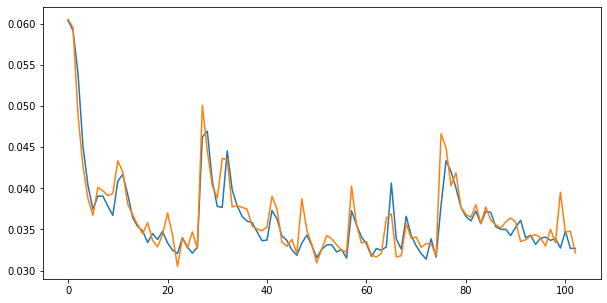

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.42it/s  0.0352                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

103 of 128
TRAIN LOSS: 0.03313552852099141
VAL LOSS: 0.032904060971405774
VAL_ACC50: 0.6284660324109718
VAL_ACC40: 0.7038020923938846


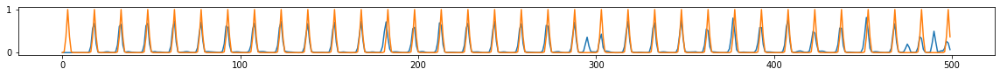

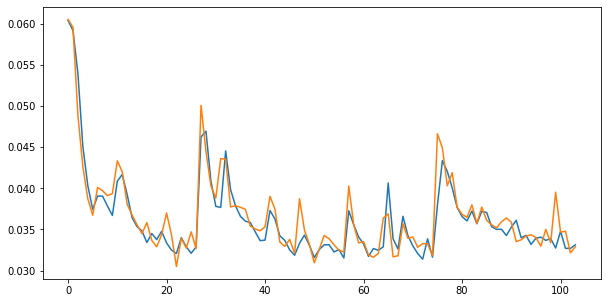

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.50it/s  0.0320                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

104 of 128
TRAIN LOSS: 0.03252900583255622
VAL LOSS: 0.03219324929846658
VAL_ACC50: 0.6381224552707445
VAL_ACC40: 0.720708234844553


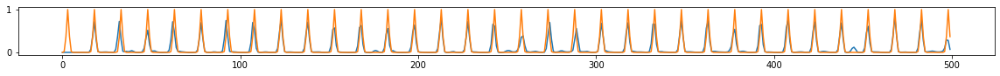

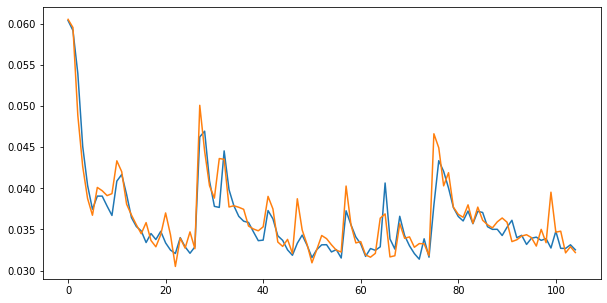

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.39it/s  0.0312                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

105 of 128
TRAIN LOSS: 0.03243768825713131
VAL LOSS: 0.03314544591638777
VAL_ACC50: 0.6082110025820459
VAL_ACC40: 0.6897599957473806


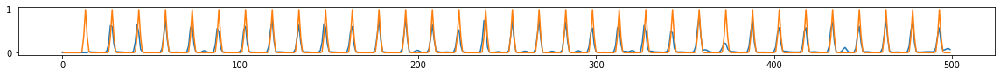

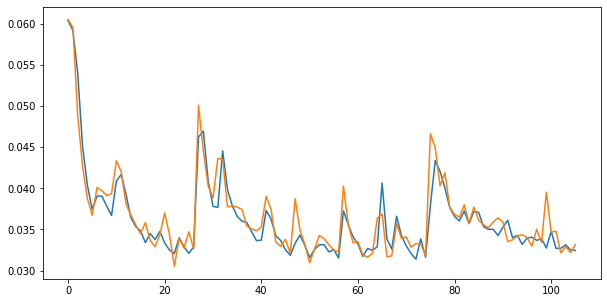

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.34it/s  0.0316                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

106 of 128
TRAIN LOSS: 0.033951381480114326
VAL LOSS: 0.03983358583516545
VAL_ACC50: 0.5482826424878797
VAL_ACC40: 0.6648079860041359


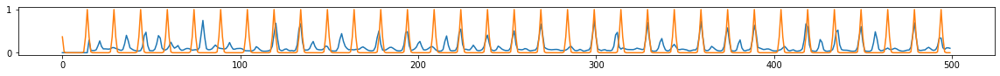

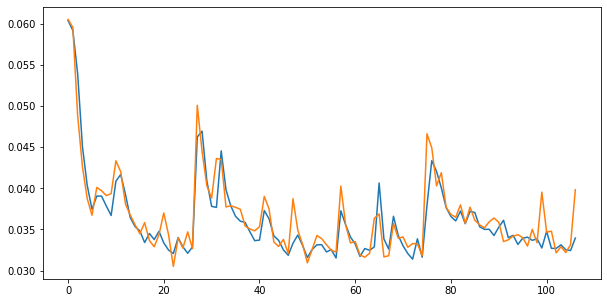

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.38it/s  0.0317                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

107 of 128
TRAIN LOSS: 0.03583075090621909
VAL LOSS: 0.036017588857147426
VAL_ACC50: 0.4994572824444984
VAL_ACC40: 0.5983815167429131


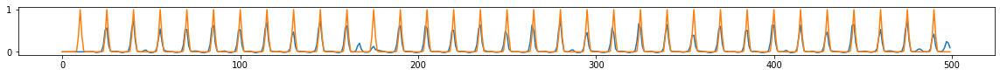

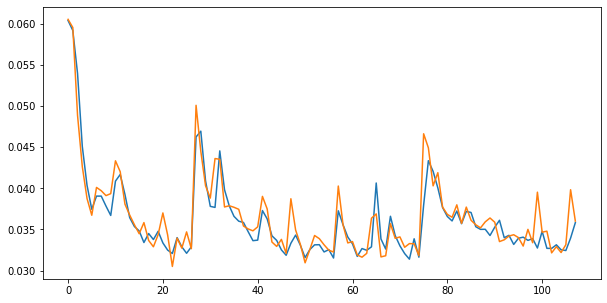

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.43it/s  0.0256                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

108 of 128
TRAIN LOSS: 0.032612626958224505
VAL LOSS: 0.032748845923278064
VAL_ACC50: 0.626193728033749
VAL_ACC40: 0.6991759975150887


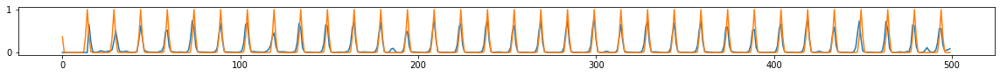

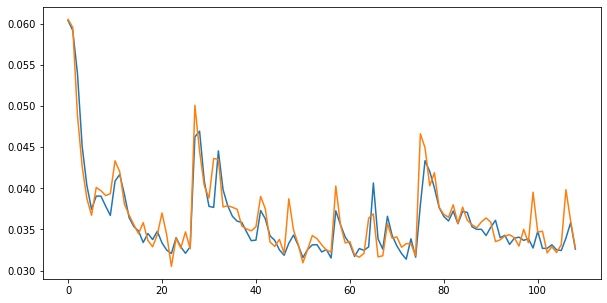

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.41it/s  0.0285                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

109 of 128
TRAIN LOSS: 0.033837305588854685
VAL LOSS: 0.03341578423149056
VAL_ACC50: 0.605878874325083
VAL_ACC40: 0.695570325733896


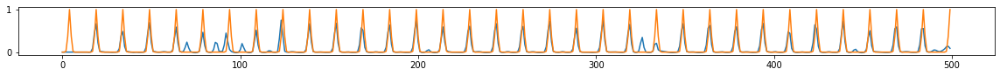

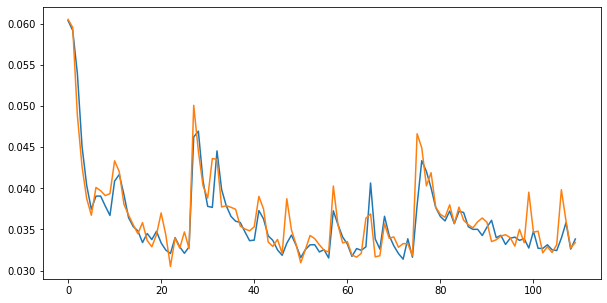

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.50it/s  0.0438                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

110 of 128
TRAIN LOSS: 0.032182429865416556
VAL LOSS: 0.03359587656127082
VAL_ACC50: 0.5813335020250171
VAL_ACC40: 0.6747749575906168


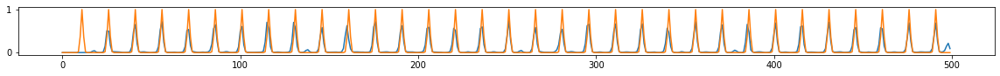

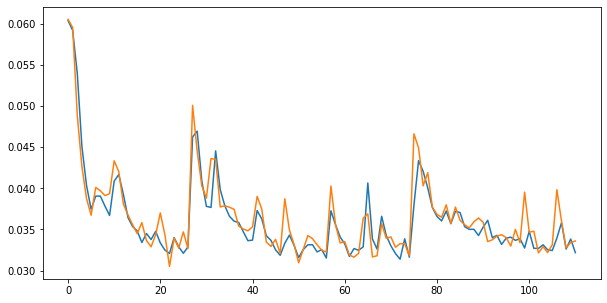

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.49it/s  0.0370                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

111 of 128
TRAIN LOSS: 0.03272043577291899
VAL LOSS: 0.03374800872471598
VAL_ACC50: 0.59166779809377
VAL_ACC40: 0.6685214088091629


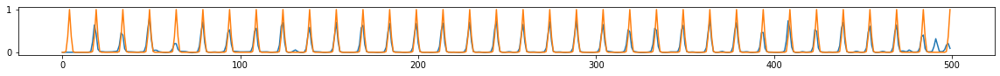

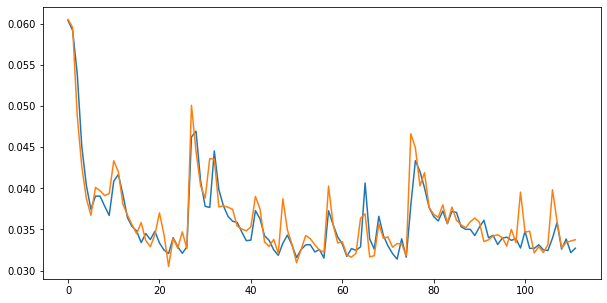

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.45it/s  0.0350                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

112 of 128
TRAIN LOSS: 0.03163457372122341
VAL LOSS: 0.03341264629529582
VAL_ACC50: 0.5860862371574268
VAL_ACC40: 0.6822841014699706


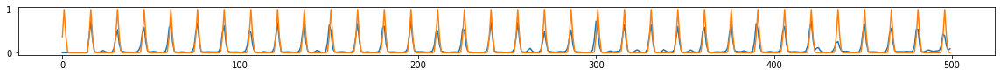

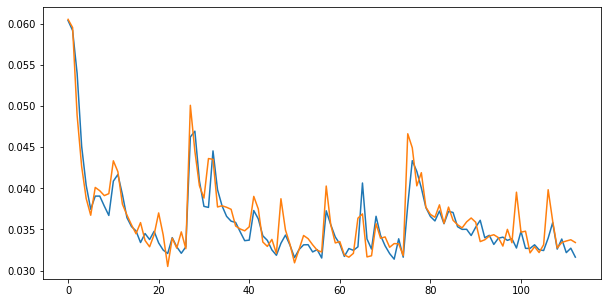

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.45it/s  0.0303                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

113 of 128
TRAIN LOSS: 0.03143265543298589
VAL LOSS: 0.03193430747422907
VAL_ACC50: 0.6313610536992177
VAL_ACC40: 0.712417614876737


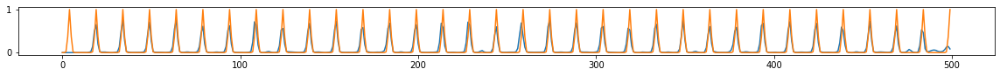

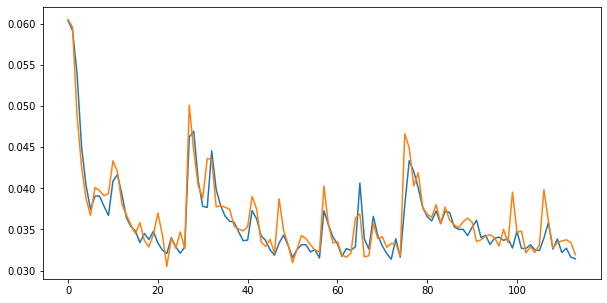

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.38it/s  0.0343                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

114 of 128
TRAIN LOSS: 0.03238087763181991
VAL LOSS: 0.032691405051284365
VAL_ACC50: 0.6331333751546219
VAL_ACC40: 0.711456810097062


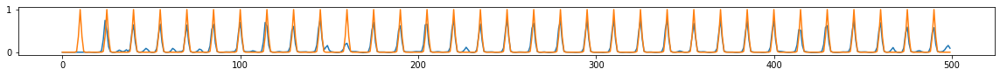

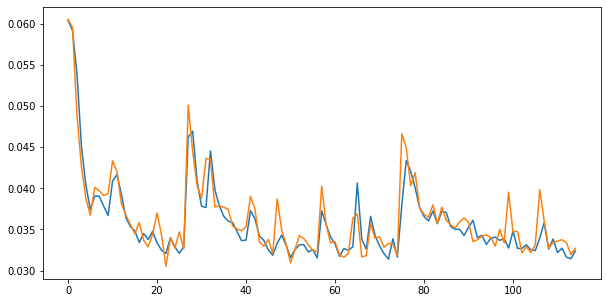

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.40it/s  0.0326                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

115 of 128
TRAIN LOSS: 0.030995067209005356
VAL LOSS: 0.03176902710563607
VAL_ACC50: 0.6546425876181853
VAL_ACC40: 0.734611969866556


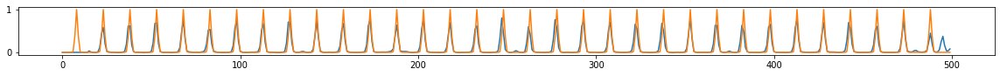

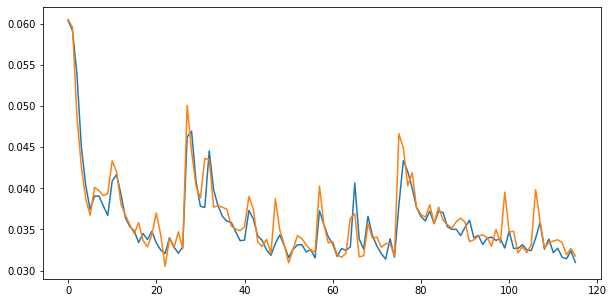

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.48it/s  0.0403                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

116 of 128
TRAIN LOSS: 0.0333074734856685
VAL LOSS: 0.033027454589804016
VAL_ACC50: 0.6186193817447313
VAL_ACC40: 0.7167427291663508


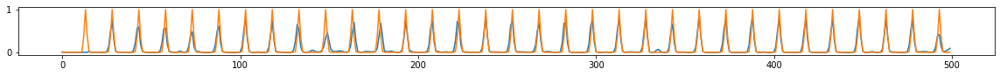

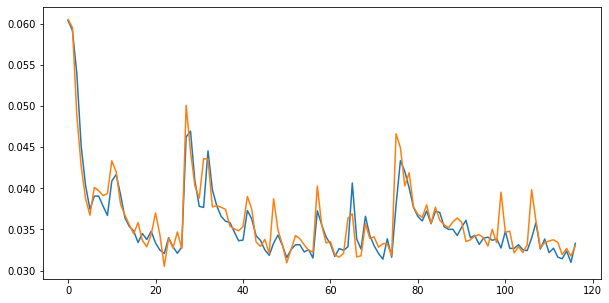

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.38it/s  0.0273                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

117 of 128
TRAIN LOSS: 0.032039672032826476
VAL LOSS: 0.03325820341706276
VAL_ACC50: 0.6474958717500237
VAL_ACC40: 0.7257230451752101


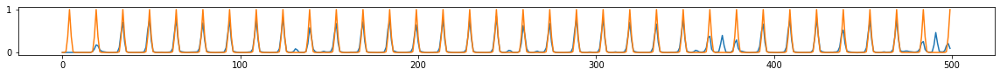

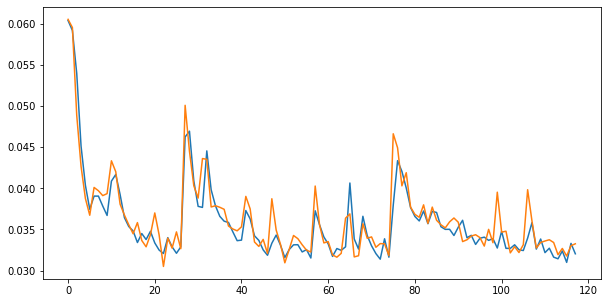

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.42it/s  0.0318                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

118 of 128
TRAIN LOSS: 0.03244398177290956
VAL LOSS: 0.03255297305683295
VAL_ACC50: 0.5864189007627927
VAL_ACC40: 0.6883931158994313


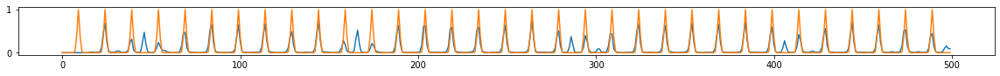

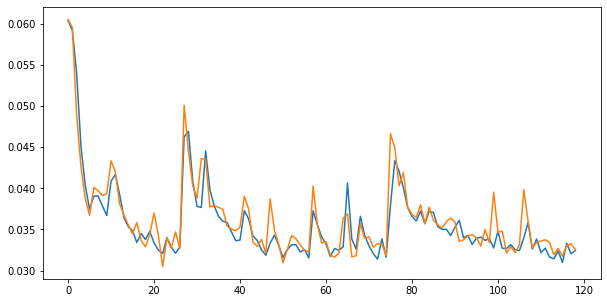

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.43it/s  0.0429                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

119 of 128
TRAIN LOSS: 0.033065010534806386
VAL LOSS: 0.03399669544564353
VAL_ACC50: 0.5619812132945254
VAL_ACC40: 0.6645764996104369


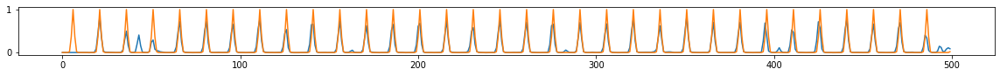

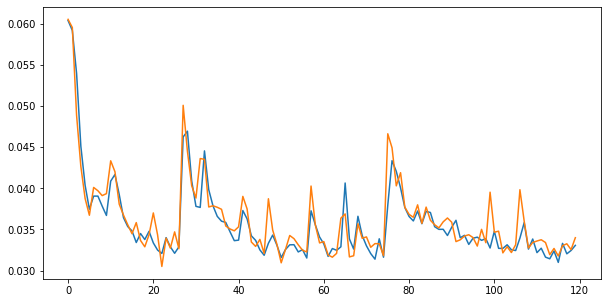

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.43it/s  0.0274                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

120 of 128
TRAIN LOSS: 0.03262798482966092
VAL LOSS: 0.03307016525003645
VAL_ACC50: 0.6022149710705862
VAL_ACC40: 0.6962466609504138


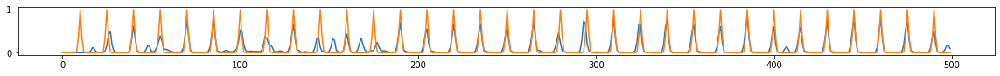

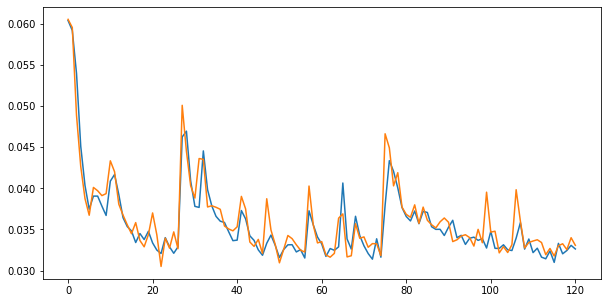

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.48it/s  0.0340                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

121 of 128
TRAIN LOSS: 0.0317713706754148
VAL LOSS: 0.03311024482051531
VAL_ACC50: 0.6200669160001309
VAL_ACC40: 0.6905382399192966


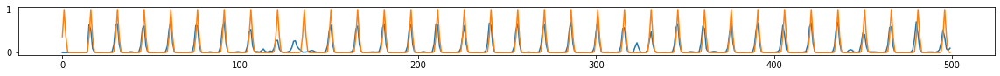

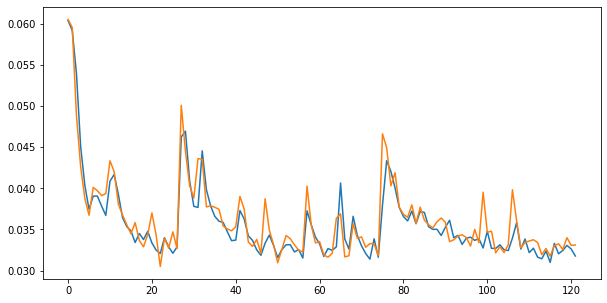

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.53it/s  0.0327                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

122 of 128
TRAIN LOSS: 0.032052359336780176
VAL LOSS: 0.03372709846331014
VAL_ACC50: 0.5706981174690502
VAL_ACC40: 0.6931696398520933


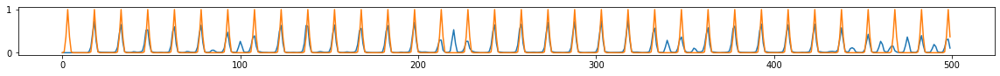

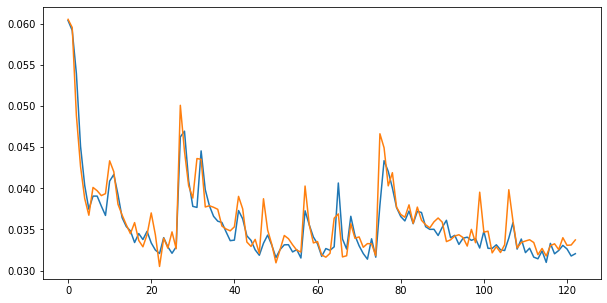

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.49it/s  0.0359                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

123 of 128
TRAIN LOSS: 0.031994173406726785
VAL LOSS: 0.03121968193186654
VAL_ACC50: 0.6386489158639903
VAL_ACC40: 0.7323411327049674


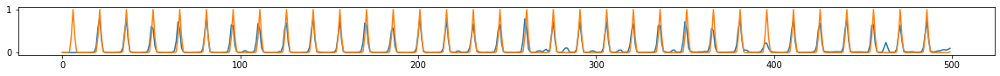

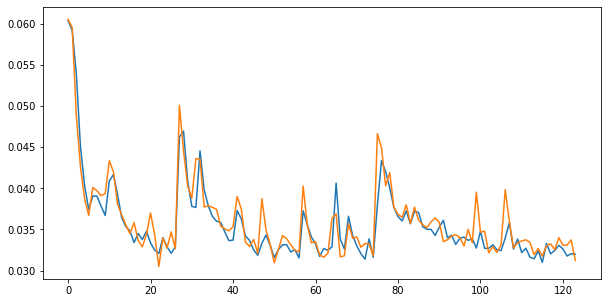

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.51it/s  0.0277                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

124 of 128
TRAIN LOSS: 0.03139954976116618
VAL LOSS: 0.030852002195186086
VAL_ACC50: 0.6042570083226148
VAL_ACC40: 0.6970116345698526


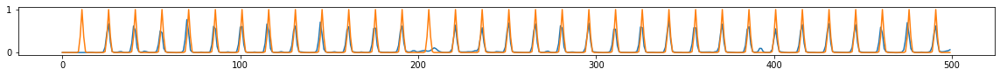

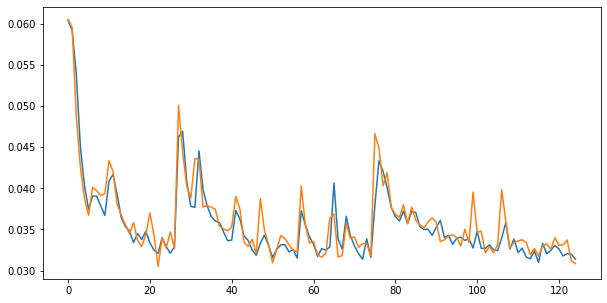

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.51it/s  0.0322                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

125 of 128
TRAIN LOSS: 0.03159914884923233
VAL LOSS: 0.033665240845746465
VAL_ACC50: 0.559852508129372
VAL_ACC40: 0.6777829678838274


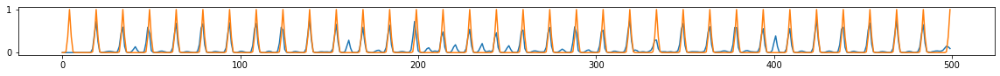

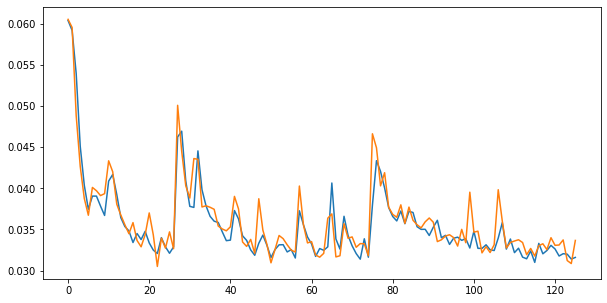

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.53it/s  0.0279                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

126 of 128
TRAIN LOSS: 0.032831525792264275
VAL LOSS: 0.03403572137984964
VAL_ACC50: 0.6074697324947848
VAL_ACC40: 0.6944743331135773


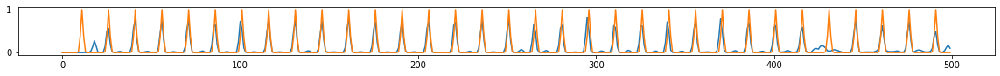

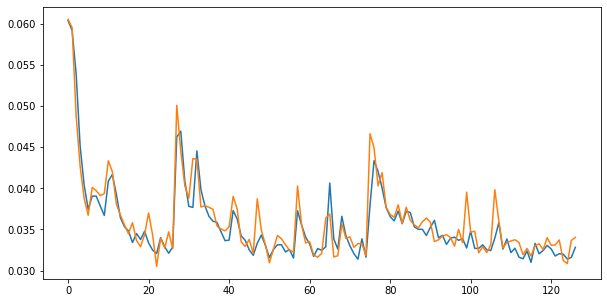

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:04<00:00:00  7.57it/s  0.0298                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

127 of 128
TRAIN LOSS: 0.032619499808384314
VAL LOSS: 0.03457371269663175
VAL_ACC50: 0.5932646607946271
VAL_ACC40: 0.6617266326533922


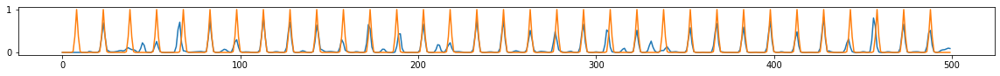

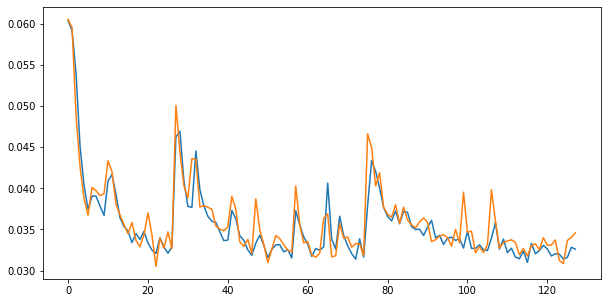

461.6651668548584 secs


In [39]:
start = time.time()

epochs = 64
trainBN()

end = time.time()
print(end - start, 'secs')

In [40]:
print(best_loss)
print(best_acc40)
torch.save(best_weights, bn_model_path + str(epoch_cum) + '.pt')

0.030852002195186086
0.6970116345698526


# Training Hitnet

In [20]:
import torch
from torch.utils.data import DataLoader
from torchinfo import summary
from qqdm.notebook import qqdm
import matplotlib.pyplot as plt

In [21]:
batch_size = 32
init_trunc = 1

In [22]:
dim_in = (seq_len, ds.a[0].shape[1])
dim_out = 1 #ds.y[0].shape[0]

In [23]:
device = torch.device('cuda')

In [24]:
bn.load_state_dict(torch.load(bn_model_path + str(128) + '.pt'))

<All keys matched successfully>

In [25]:
epoch_cum = 0
best_loss = 9999
best_weights = None
val_hist = []
train_hist = []
hn = HN(dim_in=dim_in, device=device)
hn.to(device)

343


HN(
  (convA1): Conv2d(1, 1, kernel_size=(3, 5), stride=(1, 1), padding=(1, 1))
  (convA2): Conv2d(1, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (lstmX1): LSTM(343, 343, num_layers=2, batch_first=True)
  (linearX1): Linear(in_features=343, out_features=64, bias=True)
  (linear1): Linear(in_features=64, out_features=1, bias=True)
)

In [69]:
hn.init_hidden(1)
summary(hn, input_data=[ds.a[0].unsqueeze(0).to(device), ds.b[0].unsqueeze(0).to(device), ds.o[0].unsqueeze(0).to(device)], col_width=16,
        col_names=["input_size",
                "output_size",
                "num_params",
                "kernel_size",
                "mult_adds",])

Layer (type:depth-idx)                   Input Shape      Output Shape     Param #          Kernel Shape     Mult-Adds
HN                                       --               --               --               --               --
├─Conv2d: 1-1                            [1, 1, 14206, 280] [1, 1, 14206, 278] 16               [1, 1, 3, 5]     63,188,288
├─Conv2d: 1-2                            [1, 1, 14206, 278] [1, 1, 14206, 278] 10               [1, 1, 3, 3]     39,492,680
├─LSTM: 1-3                              [1, 14206, 343]  [1, 14206, 343]  1,887,872        --               26,819,109,632
├─Linear: 1-4                            [1, 14206, 343]  [1, 14206, 64]   22,016           [343, 64]        22,016
├─Linear: 1-5                            [1, 14206, 64]   [1, 14206, 1]    65               [64, 1]          65
Total params: 1,909,979
Trainable params: 1,909,979
Non-trainable params: 0
Total mult-adds (G): 26.92
Input size (MB): 19.60
Forward/backward pass size (MB): 109.56
Par

In [70]:
train_ds = Beatmap_Dataset(None, None, seq_dur=seq_dur, sample_rate=sample_rate, 
                     hop_size=hop_size, peak_type=peak_type, width=width)
val_ds = Beatmap_Dataset(None, None, seq_dur=seq_dur, sample_rate=sample_rate, 
                     hop_size=hop_size, peak_type=peak_type, width=width)

train_ds.take(ds, 0, int(len(ds) * 0.8))
val_ds.take(ds, int(len(ds) * 0.8), len(ds))

train_ldr = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
val_ldr = DataLoader(val_ds, batch_size=batch_size, shuffle=False)

In [71]:
criterion = nn.MSELoss()
#criterion = nn.L1Loss()
optimizer = torch.optim.Adam(hn.parameters(), lr=0.001)

In [72]:
def hit_percentage(pred, gt, thresh):
    c = 0
    n = 0
    for i in range(1, gt.shape[0]-2):
        n += 1 if gt[i] == 1.0 else 0
        if pred[i] >= thresh:
            if gt[i] == 1 and (gt[i-1] != 1 or gt[i+1] != 1):
                if pred[i] > pred[i-1] and pred[i] > pred[i+1]:
                    c += 1
            elif gt[i] == 1:
                c += 1
    if n == 0:
        return 1
    return c / n

In [75]:
def trainHN(threading=False, threads=4, acc_report=False):
    global epoch_cum
    global best_weights, best_loss
    global A, O, H, BP, P
    global l

    executor = concurrent.futures.ThreadPoolExecutor(threads)
    
    bn.eval()
    for epoch in range(epochs):
        hn.train()
        train_loss = 0
        info = qqdm(train_ldr)
        for a, o, b, h, t, m, in info:
            hn.init_hidden(a.shape[0])
            bn.init_hidden(a.shape[0])
            A, O, H = a.to(device), o.to(device), h.to(device)
            with torch.no_grad():
                BP = bn(A.detach())
                BP = BP.squeeze(2)

            optimizer.zero_grad()
            HP = hn(A, BP, O)

            for i in range(HP.shape[0]):
                l = int(t[1][i] * 0.001 * m[0][1][i] * init_trunc)
                H[i][0:l] = torch.tensor([0] * l)
                HP[i][0:l] = torch.tensor([0] * l).unsqueeze(1)


            loss = criterion(HP[:,:,0:dim_out], H.unsqueeze(2))
            loss.backward()
            optimizer.step()
      
            train_loss += loss.item()
            info.set_infos({'loss': f'{loss.item():.4f}'})

        hn.eval()
        torch.no_grad()
        val_loss = 0
        val_acc05 = 0
        val_acc04 = 0
        for a, o, b, h, t, m, in val_ldr:
            hn.init_hidden(a.shape[0])
            bn.init_hidden(a.shape[0])
            A, O, H = a.to(device), o.to(device), h.to(device)
            BP = bn(A)
            BP = BP.squeeze(2)

            HP = hn(A, BP, O)

            for i in range(HP.shape[0]):
                l = int(t[1][i] * 0.001 * m[0][1][i] * init_trunc)
                H[i][0:l] = torch.tensor([0] * l)
                HP[i][0:l] = torch.tensor([0] * l).unsqueeze(1)

            loss = criterion(HP[:,:,0:dim_out], H.unsqueeze(2))

            if threading:
                mapfn = executor.map
            else:
                mapfn = map
            
            if acc_report:
                cum = mapfn(hit_percentage, HP.cpu().detach().numpy(), h, [0.5] * P.shape[0])
                val_acc05 = sum(cum)
                cum = mapfn(hit_percentage, HP.cpu().detach().numpy(), h, [0.4] * P.shape[0])
                val_acc04 = sum(cum)            
            
            val_loss += loss.item()

        train_loss = train_loss/len(train_ldr)    
        val_loss = val_loss/len(val_ldr)
        print(epoch+epoch_cum, 'of', epochs+epoch_cum)
        print("TRAIN LOSS:", train_loss)
        print("VAL LOSS:", val_loss)
        train_hist.append(float(train_loss))
        val_hist.append(float(val_loss))
        
        if acc_report:
            val_acc05 = val_acc05/len(val_ldr)/batch_size
            val_acc04 = val_acc04/len(val_ldr)/batch_size
            print("VAL_ACC05:", val_acc05)
            print("VAL_ACC04:", val_acc04)
        
        plt.rcParams["figure.figsize"] = (20,2)
        for i in range(dim_out):
            plt.plot(HP[0,:,i].cpu().detach().numpy())
            plt.plot(BP[i].cpu().detach().numpy())
            plt.plot(h[i])
            plt.show()
        
        plt.rcParams["figure.figsize"] = (10, 5)
        plt.plot(train_hist)
        plt.plot(val_hist)
        plt.show()

        if val_loss < best_loss:
            best_loss = val_loss
            best_weights = hn.state_dict().copy()
            
    epoch_cum += epochs

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.96it/s  0.1969                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

0 of 64
TRAIN LOSS: 0.19977815532022053
VAL LOSS: 0.1914743334054947


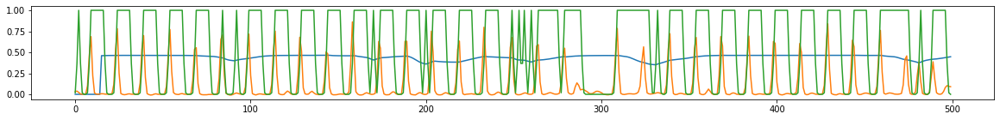

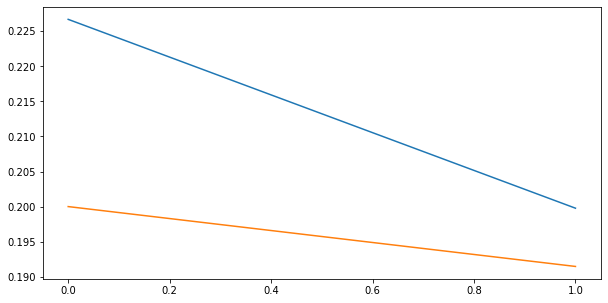

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  5.00it/s  0.1740                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

1 of 64
TRAIN LOSS: 0.16823018135295975
VAL LOSS: 0.15268584920300377


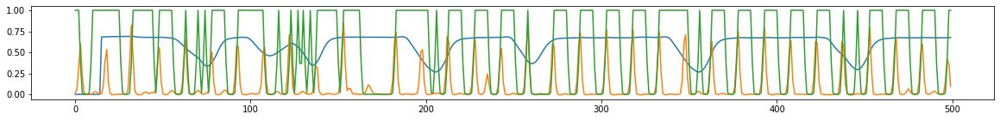

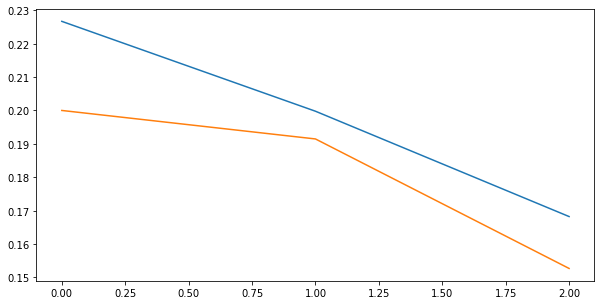

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.99it/s  0.1187                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

2 of 64
TRAIN LOSS: 0.1409204544292556
VAL LOSS: 0.13614044255680507


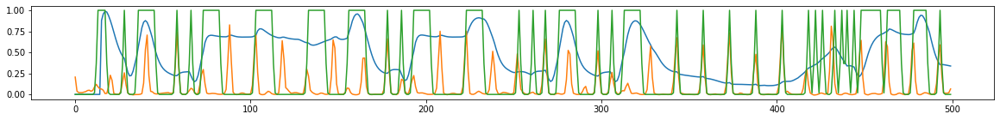

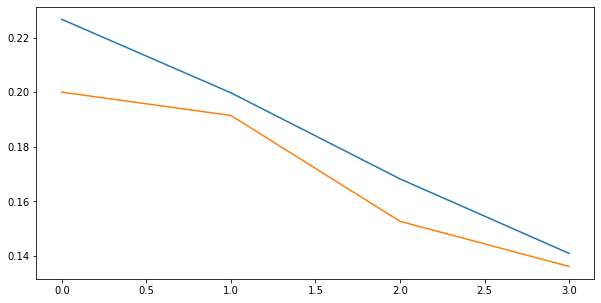

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.96it/s  0.0947                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

3 of 64
TRAIN LOSS: 0.1268516733414597
VAL LOSS: 0.1225827866130405


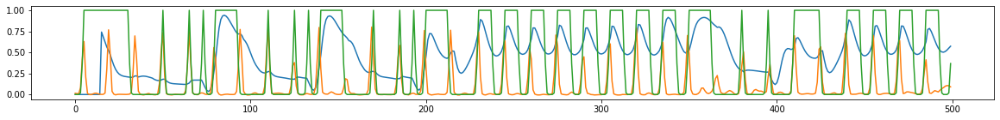

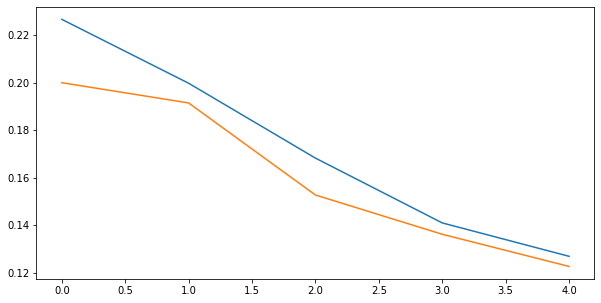

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.95it/s  0.1257                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

4 of 64
TRAIN LOSS: 0.11808687593373987
VAL LOSS: 0.11588136355082194


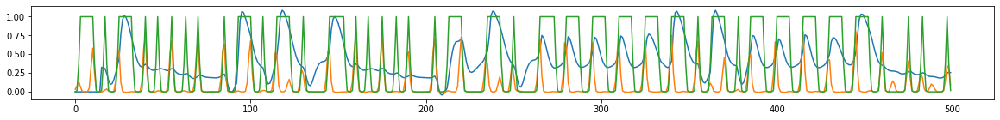

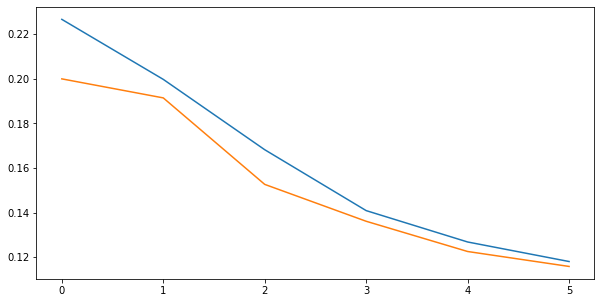

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.95it/s  0.1193                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

5 of 64
TRAIN LOSS: 0.11241629388597277
VAL LOSS: 0.1094958128200637


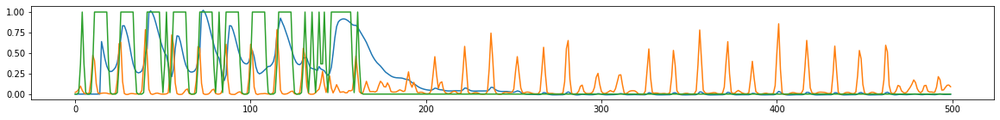

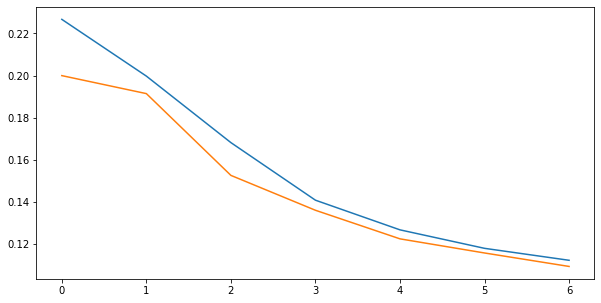

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.94it/s  0.1084                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

6 of 64
TRAIN LOSS: 0.10701317526400089
VAL LOSS: 0.10451691680484348


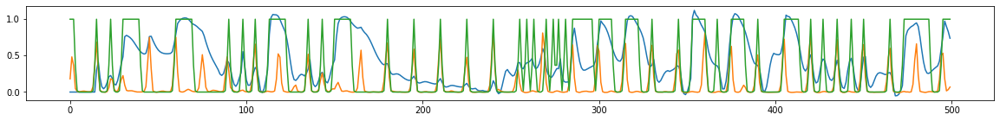

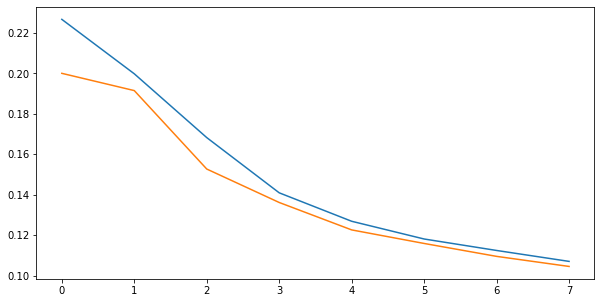

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.93it/s  0.0700                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

7 of 64
TRAIN LOSS: 0.0971473730686638
VAL LOSS: 0.09826581676801045


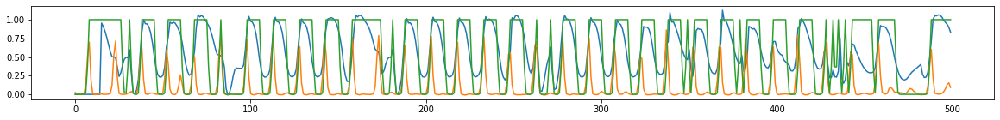

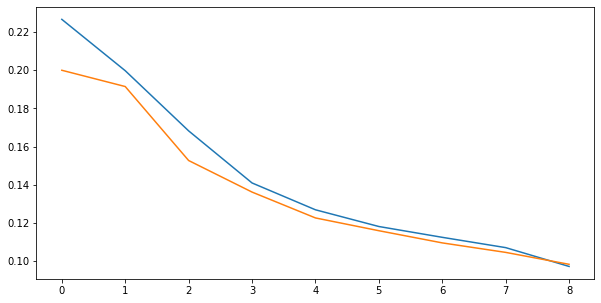

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.91it/s  0.0775                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

8 of 64
TRAIN LOSS: 0.09396090461975998
VAL LOSS: 0.09239844977855682


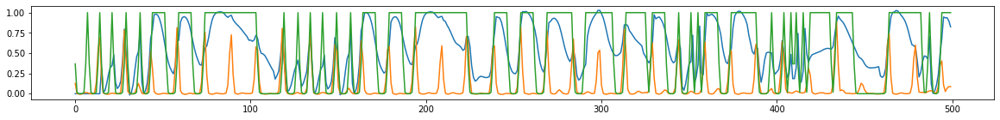

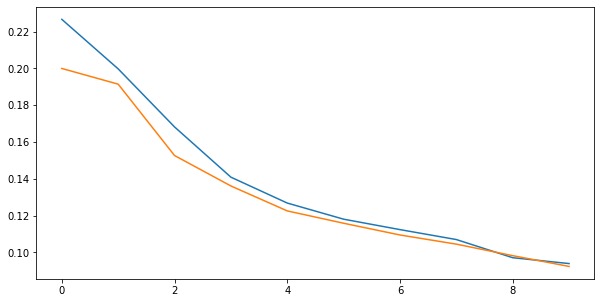

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.94it/s  0.0895                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

9 of 64
TRAIN LOSS: 0.08882125156621139
VAL LOSS: 0.09206817961401409


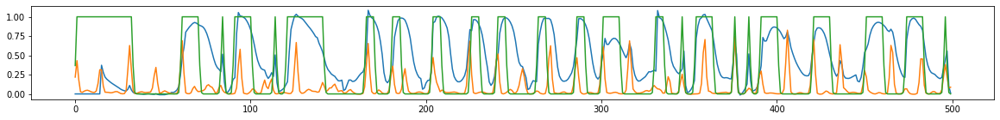

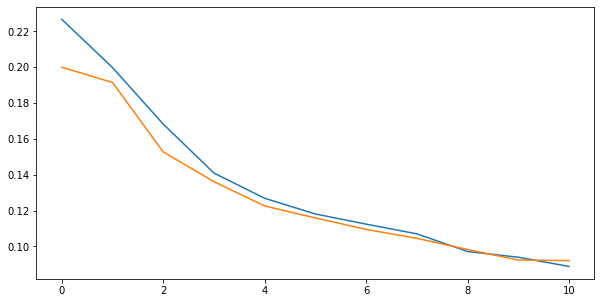

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.93it/s  0.0744                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

10 of 64
TRAIN LOSS: 0.08603889246781667
VAL LOSS: 0.08581605388058557


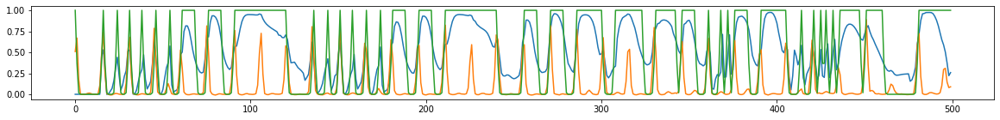

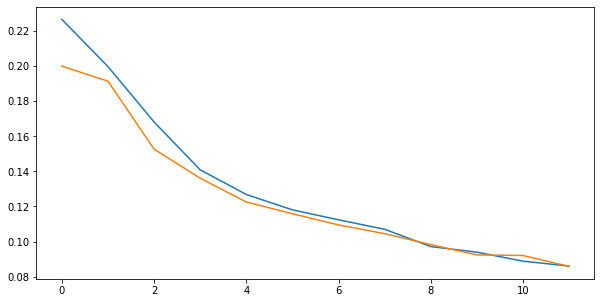

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.93it/s  0.0867                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

11 of 64
TRAIN LOSS: 0.08383808388478226
VAL LOSS: 0.08477390888664457


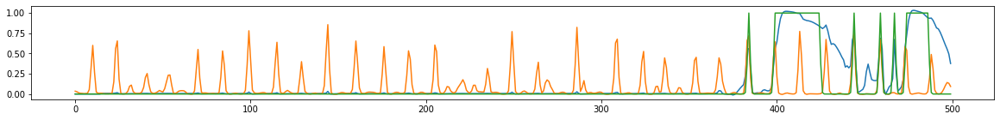

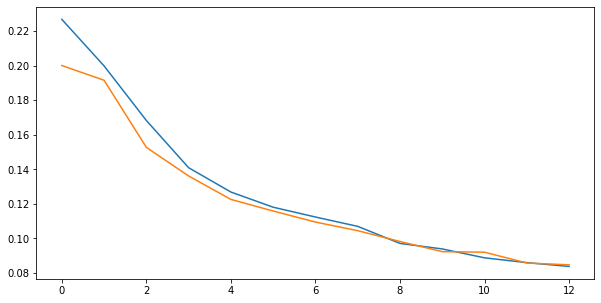

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.93it/s  0.0912                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

12 of 64
TRAIN LOSS: 0.08371361220876376
VAL LOSS: 0.0867917537689209


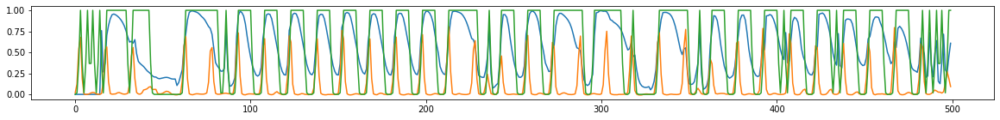

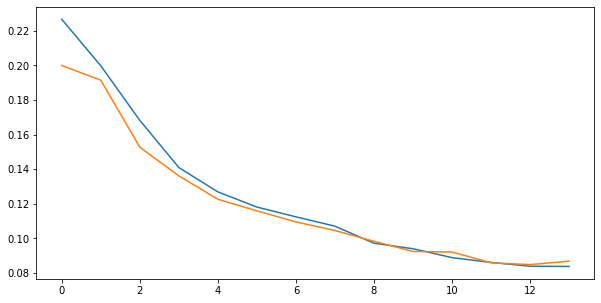

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.92it/s  0.0734                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

13 of 64
TRAIN LOSS: 0.07867769638283385
VAL LOSS: 0.08329744305875567


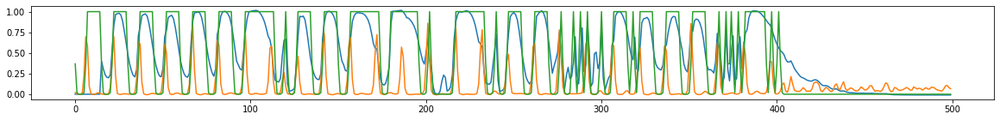

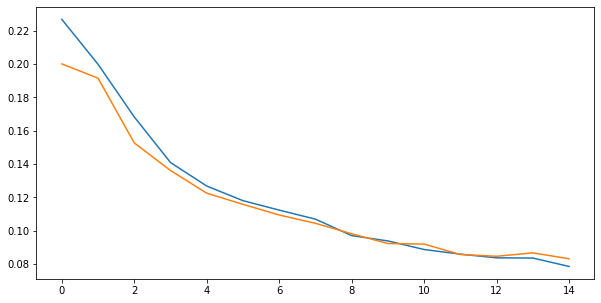

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.92it/s  0.0633                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

14 of 64
TRAIN LOSS: 0.08016936149862078
VAL LOSS: 0.08259912000762092


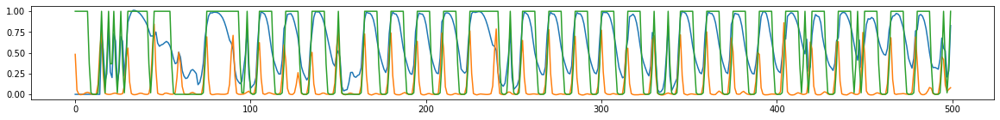

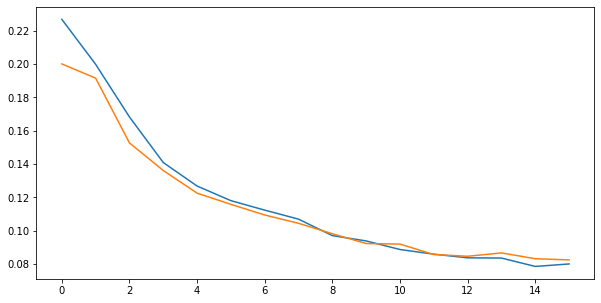

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.92it/s  0.0933                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

15 of 64
TRAIN LOSS: 0.0773525968607929
VAL LOSS: 0.07970671107371648


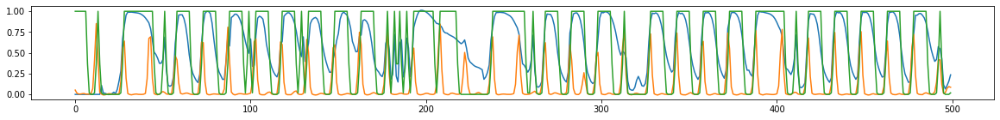

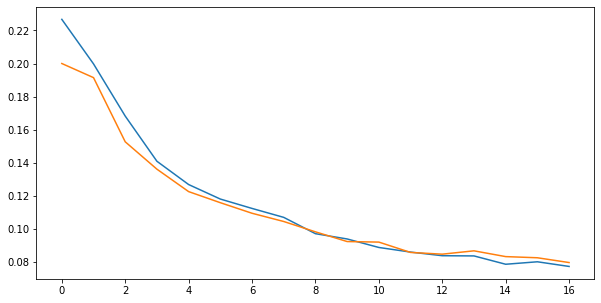

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.91it/s  0.0772                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

16 of 64
TRAIN LOSS: 0.0767271818800105
VAL LOSS: 0.07573516087399589


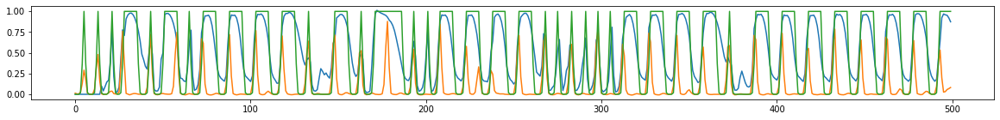

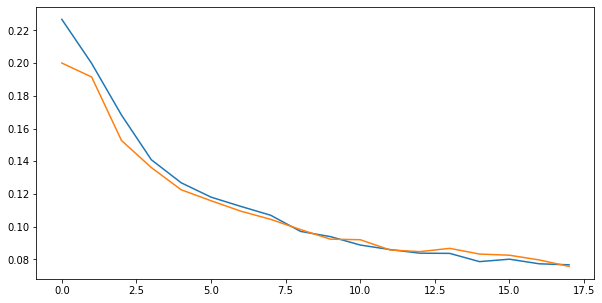

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0624                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

17 of 64
TRAIN LOSS: 0.0755316141164965
VAL LOSS: 0.07816311634249157


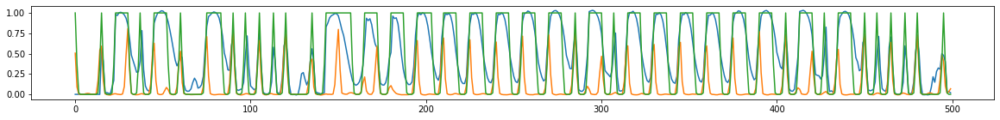

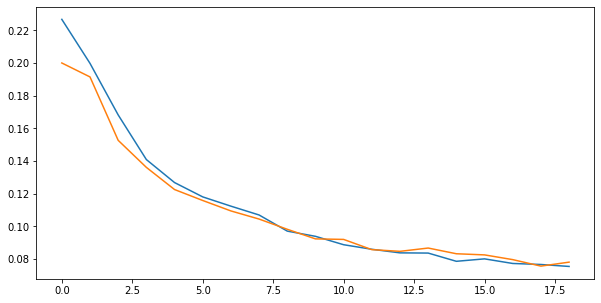

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.91it/s  0.0729                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

18 of 64
TRAIN LOSS: 0.07510578249477678
VAL LOSS: 0.07823308971193102


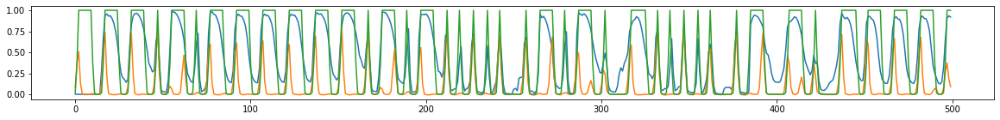

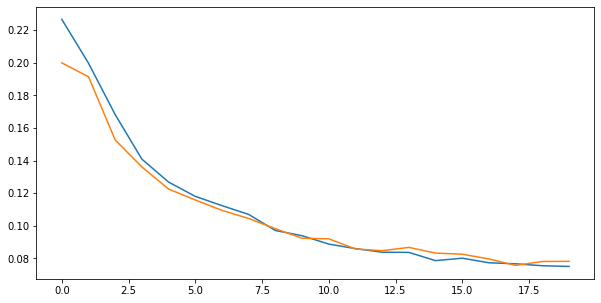

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0731                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

19 of 64
TRAIN LOSS: 0.07270464518417914
VAL LOSS: 0.07374407185448541


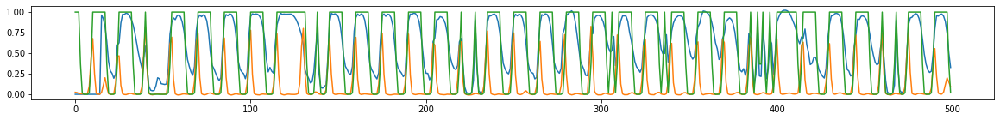

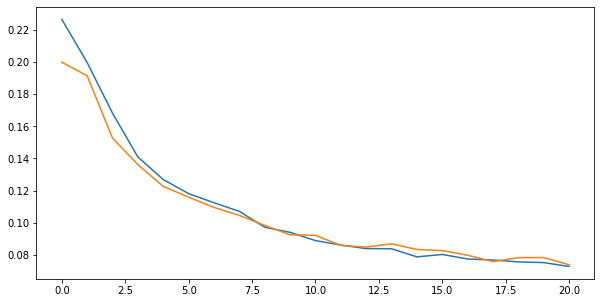

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0743                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

20 of 64
TRAIN LOSS: 0.07056592839459579
VAL LOSS: 0.0751852434542444


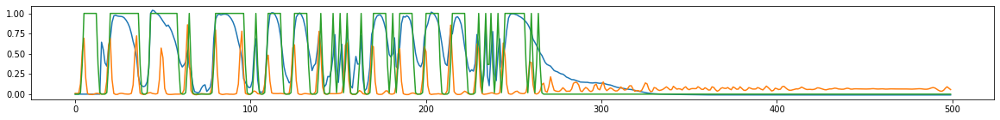

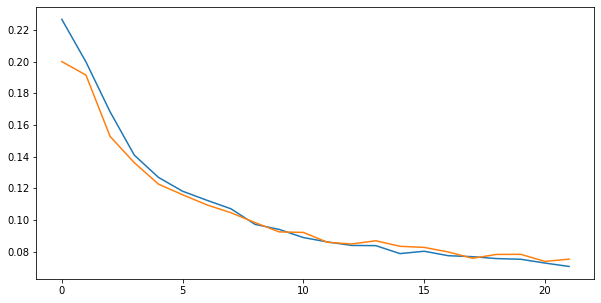

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0571                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

21 of 64
TRAIN LOSS: 0.06971406740032965
VAL LOSS: 0.06899856486254269


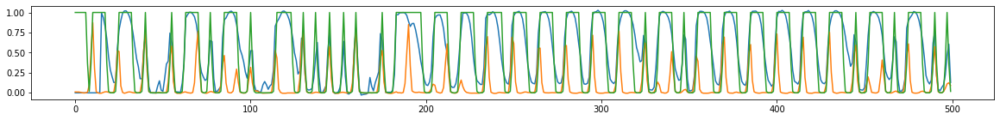

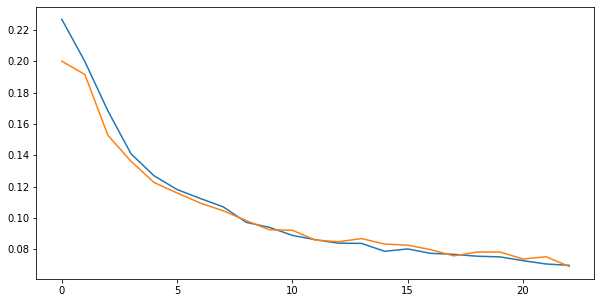

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0638                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

22 of 64
TRAIN LOSS: 0.0700838536851936
VAL LOSS: 0.07559911823934978


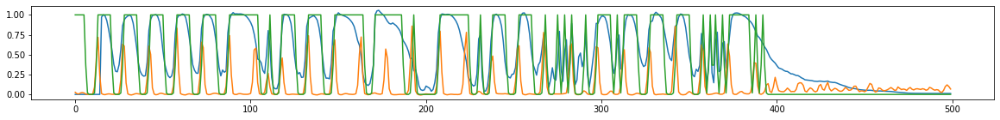

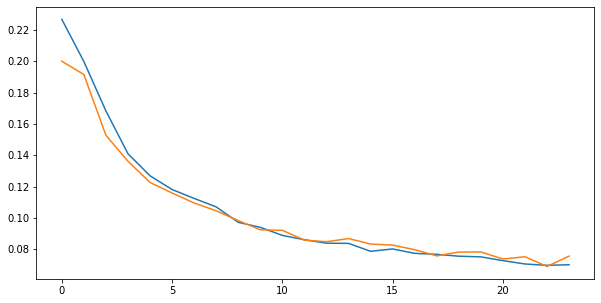

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0567                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

23 of 64
TRAIN LOSS: 0.06918799597769976
VAL LOSS: 0.07712072382370631


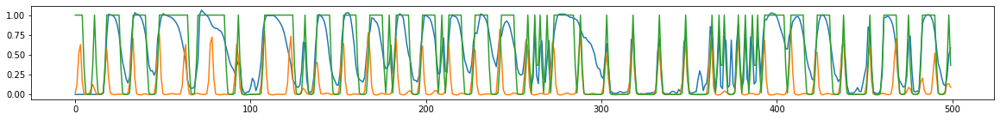

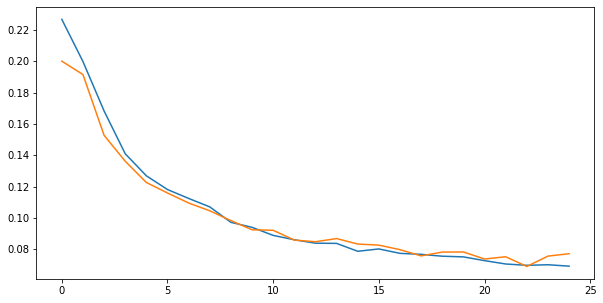

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0825                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

24 of 64
TRAIN LOSS: 0.06941945240315464
VAL LOSS: 0.07514201766914791


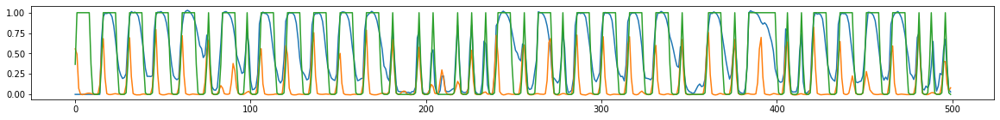

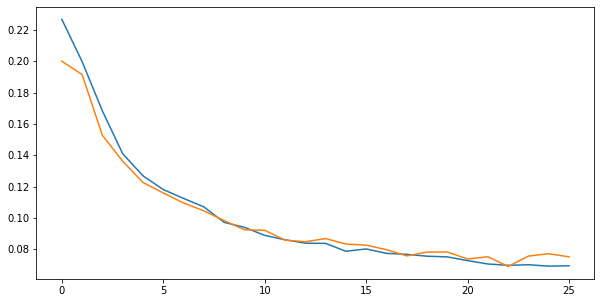

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0524                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

25 of 64
TRAIN LOSS: 0.06633115352855788
VAL LOSS: 0.07229236430592006


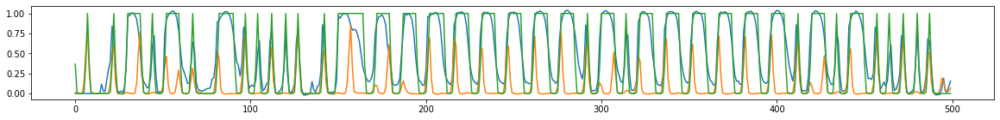

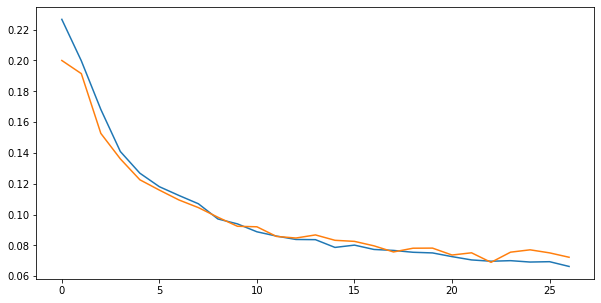

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0755                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

26 of 64
TRAIN LOSS: 0.06845783980356322
VAL LOSS: 0.07005666113562053


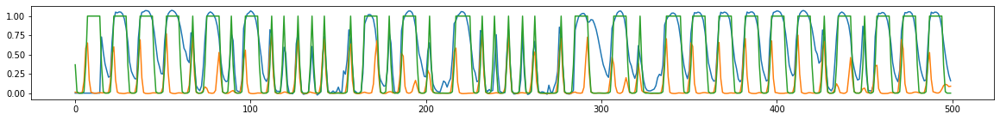

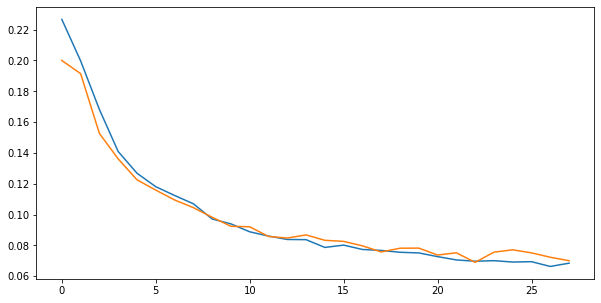

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0707                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

27 of 64
TRAIN LOSS: 0.0700319745681352
VAL LOSS: 0.07007680543594891


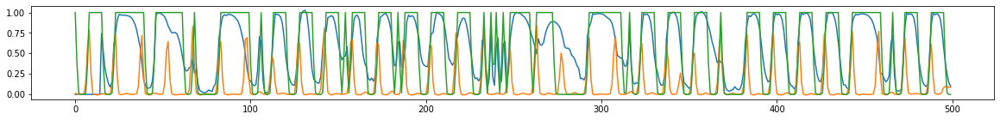

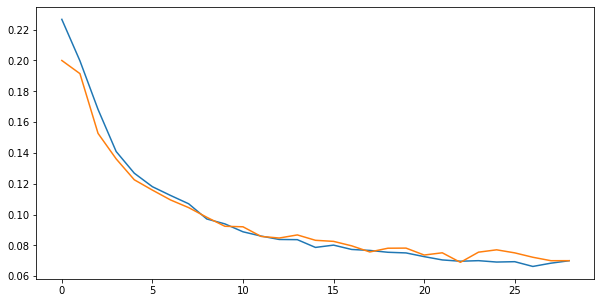

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0644                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

28 of 64
TRAIN LOSS: 0.06640717583811945
VAL LOSS: 0.06951854957474603


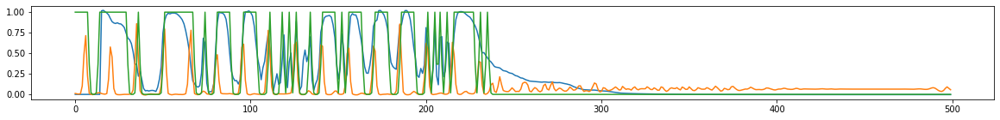

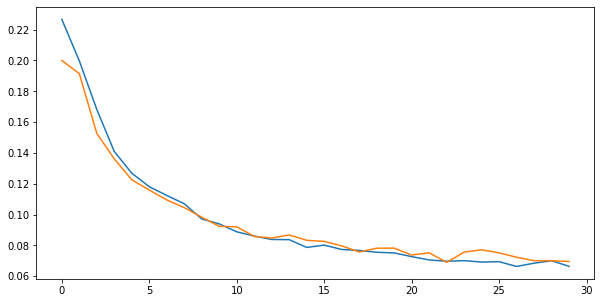

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0680                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

29 of 64
TRAIN LOSS: 0.06478556545658244
VAL LOSS: 0.06962322650684251


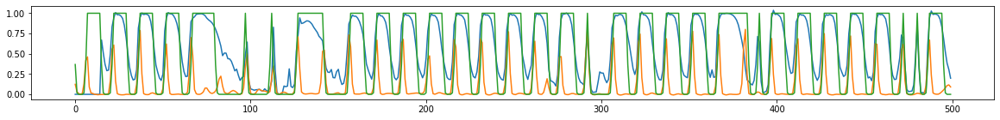

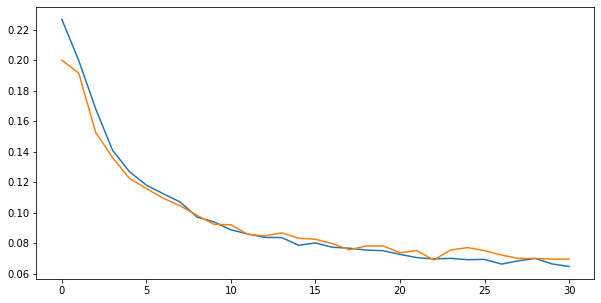

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0764                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

30 of 64
TRAIN LOSS: 0.06565578737192684
VAL LOSS: 0.06769092256824176


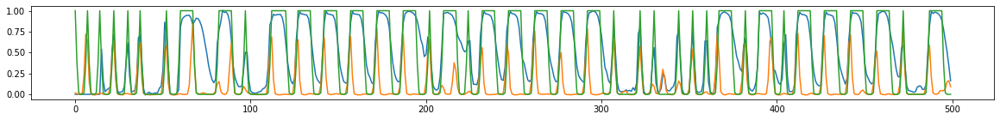

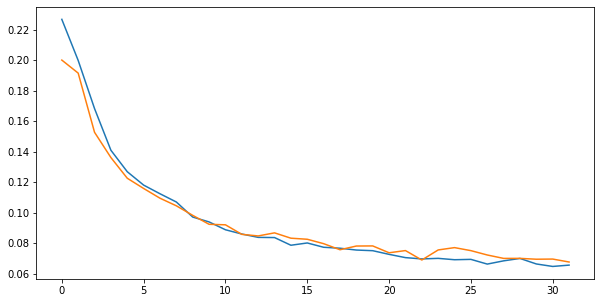

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0697                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

31 of 64
TRAIN LOSS: 0.06557665610065062
VAL LOSS: 0.06731014864312278


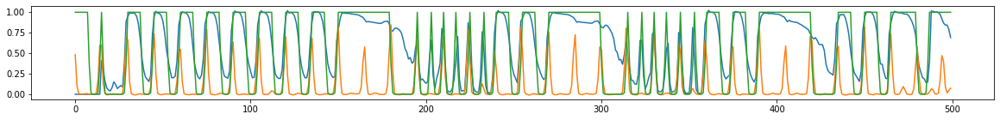

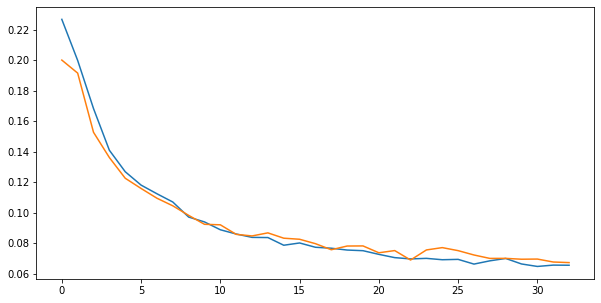

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0635                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

32 of 64
TRAIN LOSS: 0.06645486783236265
VAL LOSS: 0.06888575893309382


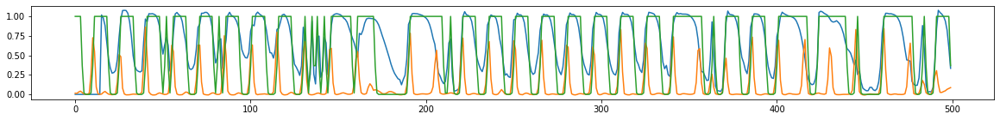

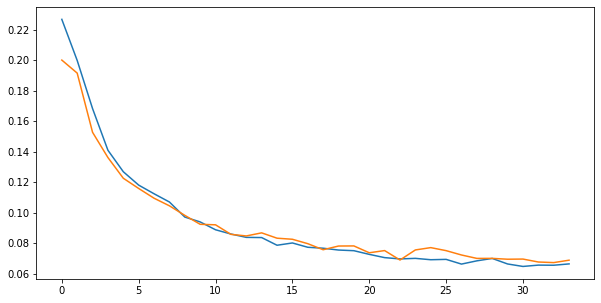

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0689                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

33 of 64
TRAIN LOSS: 0.0663786047241754
VAL LOSS: 0.07288636391361554


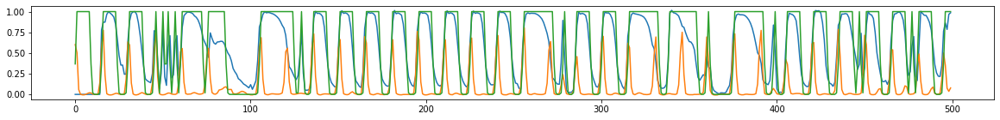

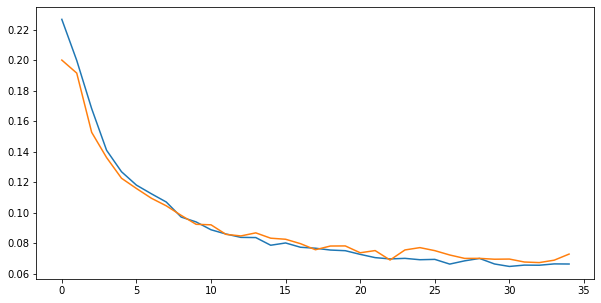

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0679                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

34 of 64
TRAIN LOSS: 0.06572495939003097
VAL LOSS: 0.06869348055786556


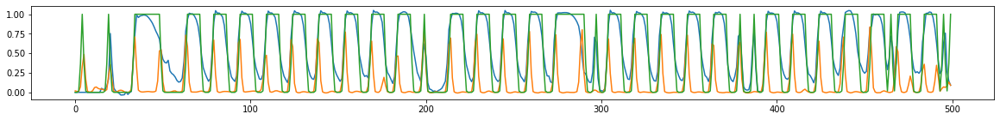

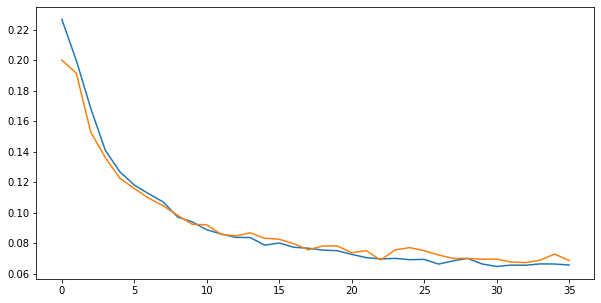

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0606                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

35 of 64
TRAIN LOSS: 0.06378520859612359
VAL LOSS: 0.06766384094953537


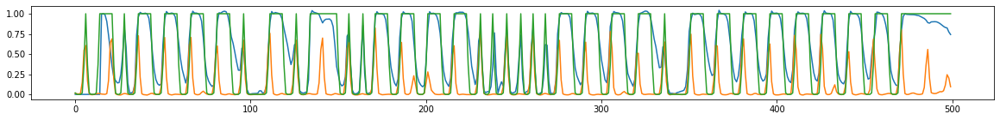

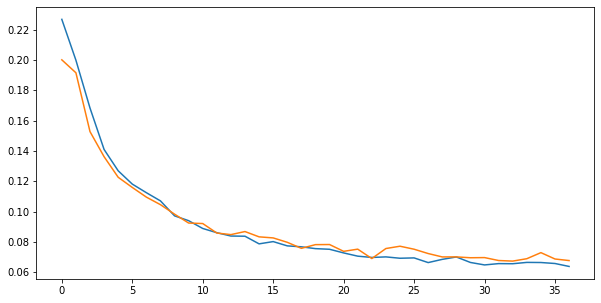

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.92it/s  0.0661                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

36 of 64
TRAIN LOSS: 0.06379241889549626
VAL LOSS: 0.06935479119420052


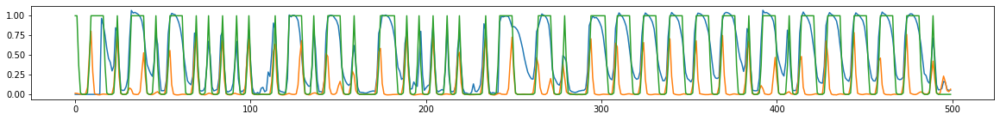

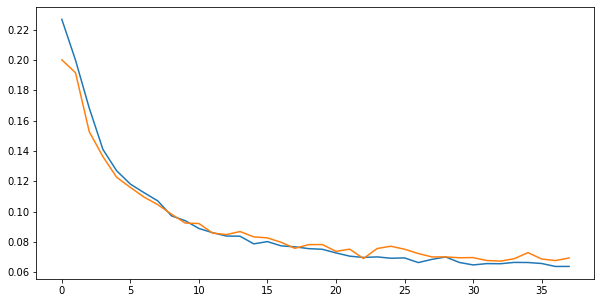

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.91it/s  0.0547                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

37 of 64
TRAIN LOSS: 0.06253044100271331
VAL LOSS: 0.07252251067095333


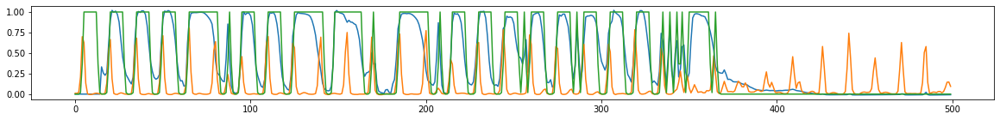

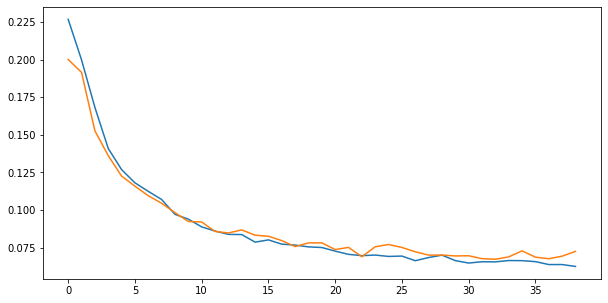

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0665                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

38 of 64
TRAIN LOSS: 0.0619568998614947
VAL LOSS: 0.06472961770163642


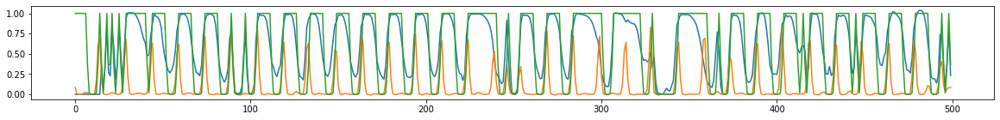

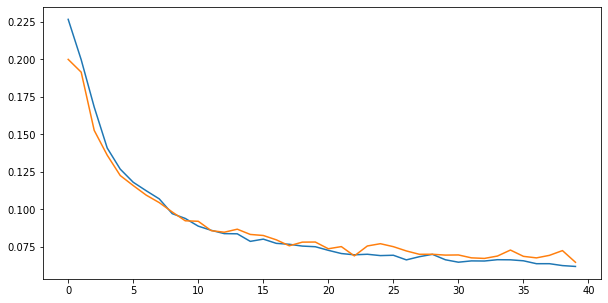

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0517                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

39 of 64
TRAIN LOSS: 0.06180940796103743
VAL LOSS: 0.06632543810539776


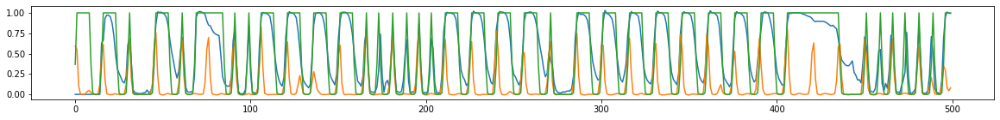

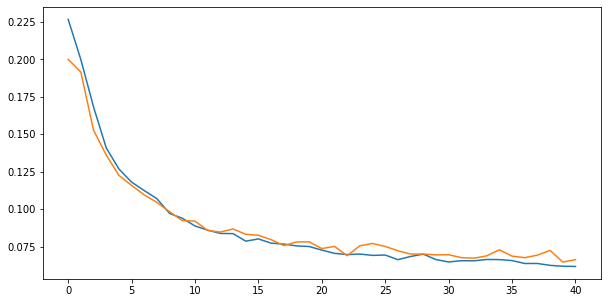

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0647                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

40 of 64
TRAIN LOSS: 0.061964549124240875
VAL LOSS: 0.06968791948424445


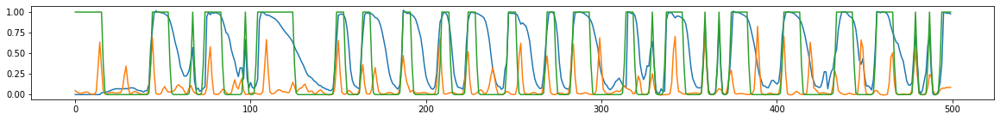

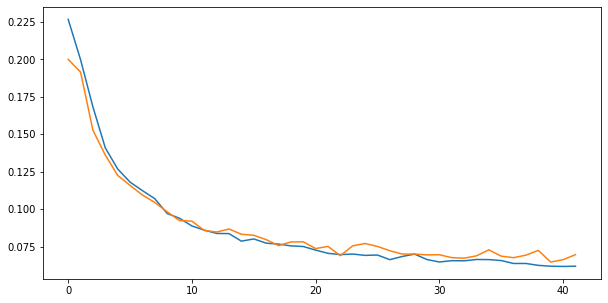

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0518                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

41 of 64
TRAIN LOSS: 0.0612324865327941
VAL LOSS: 0.06645593874984318


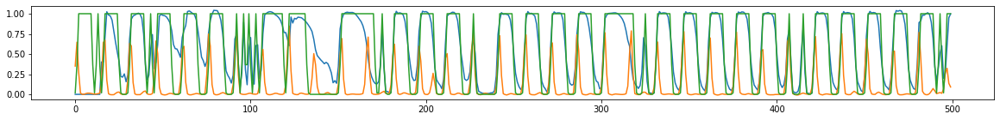

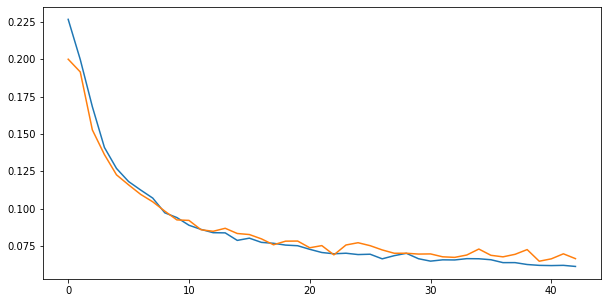

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0649                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

42 of 64
TRAIN LOSS: 0.06334646894699997
VAL LOSS: 0.06918426892823643


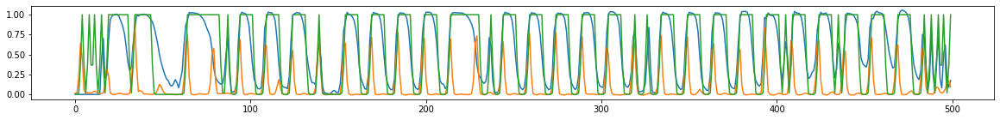

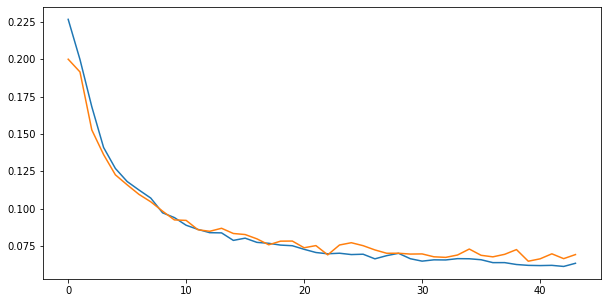

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0531                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

43 of 64
TRAIN LOSS: 0.061737780562705465
VAL LOSS: 0.06644651583499378


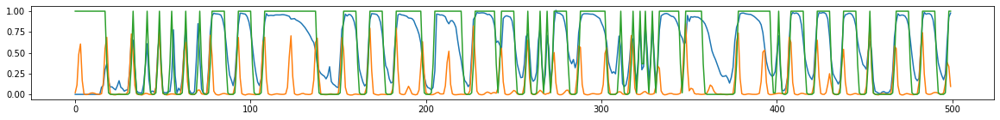

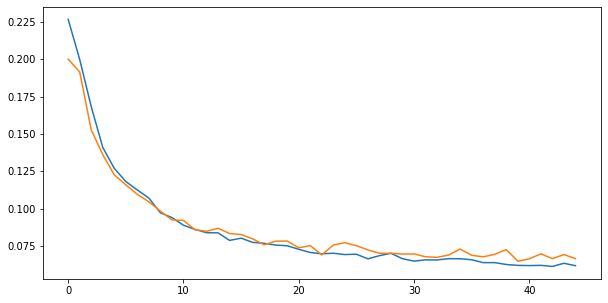

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0565                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

44 of 64
TRAIN LOSS: 0.058764140121638775
VAL LOSS: 0.06571046676900652


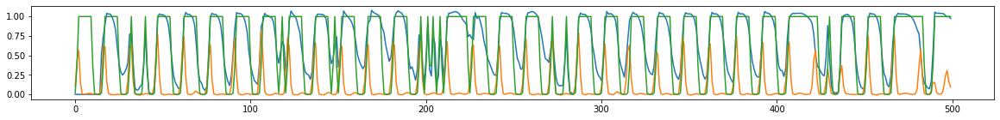

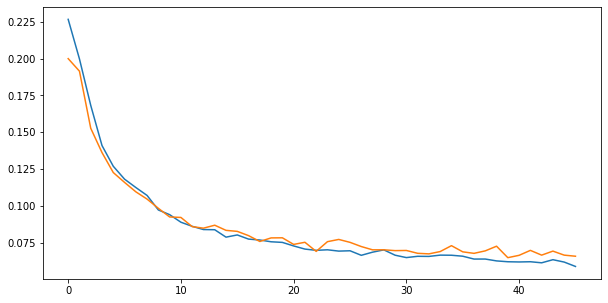

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0584                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

45 of 64
TRAIN LOSS: 0.06062631836781899
VAL LOSS: 0.0665976529320081


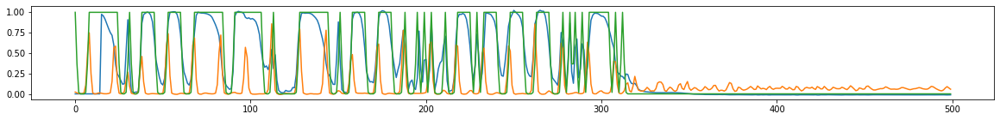

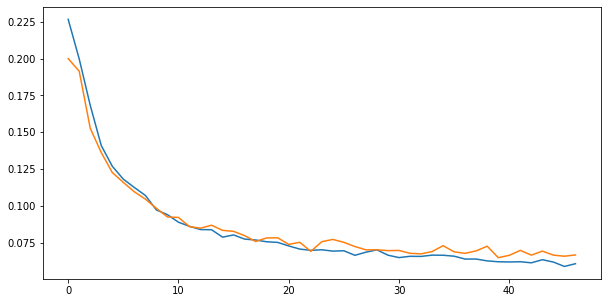

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0612                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

46 of 64
TRAIN LOSS: 0.06343438652240568
VAL LOSS: 0.06526570560203658


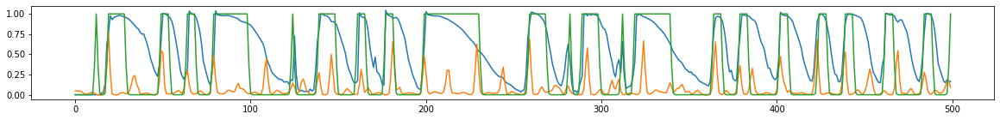

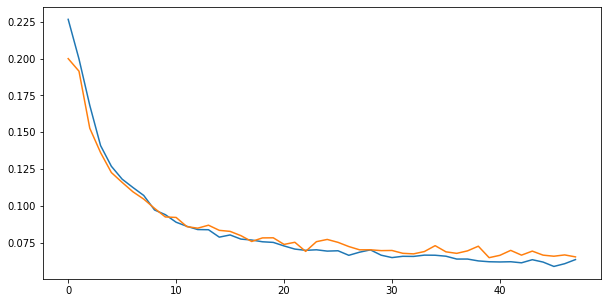

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0463                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

47 of 64
TRAIN LOSS: 0.06104975390351481
VAL LOSS: 0.07091462736328442


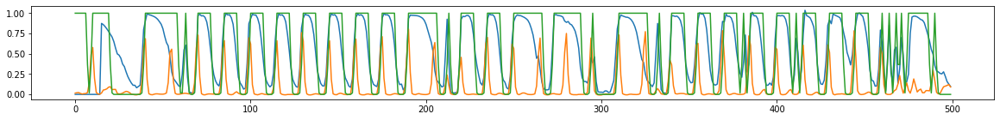

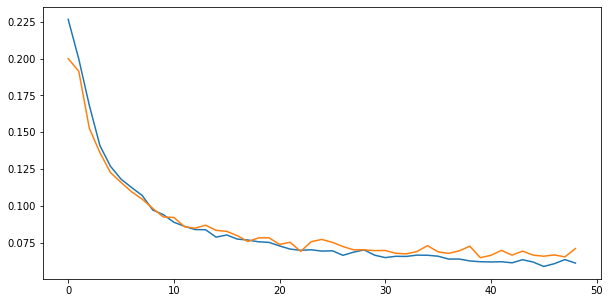

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0659                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

48 of 64
TRAIN LOSS: 0.059645334258675575
VAL LOSS: 0.06591956731345919


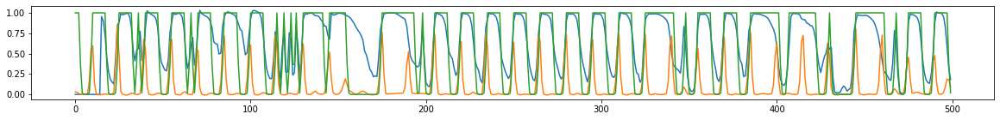

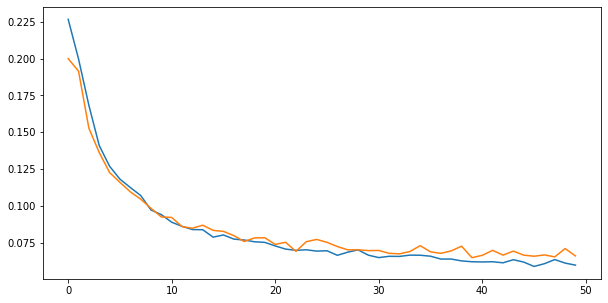

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0555                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

49 of 64
TRAIN LOSS: 0.06262058992352751
VAL LOSS: 0.06595165448056327


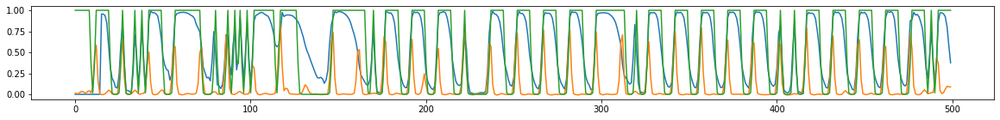

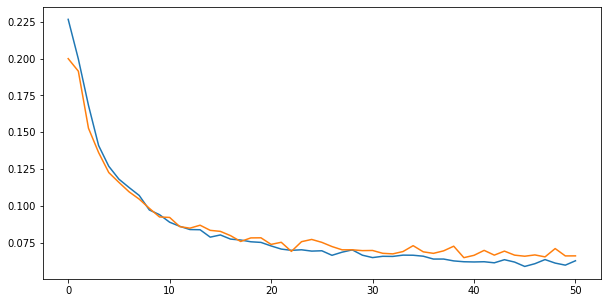

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0703                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

50 of 64
TRAIN LOSS: 0.06003167894151476
VAL LOSS: 0.06557413397563829


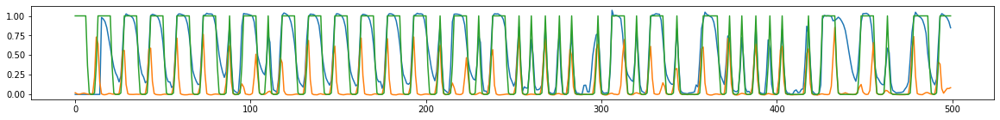

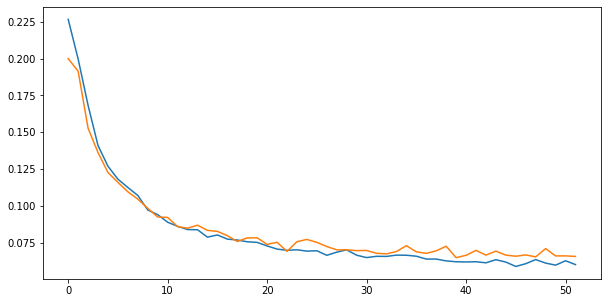

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0627                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

51 of 64
TRAIN LOSS: 0.060325046380360924
VAL LOSS: 0.06978448232014973


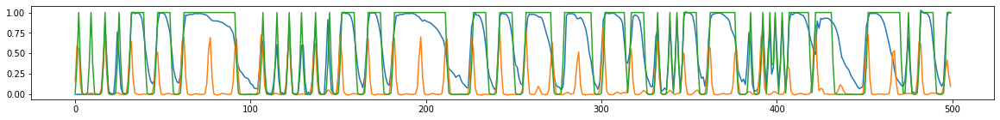

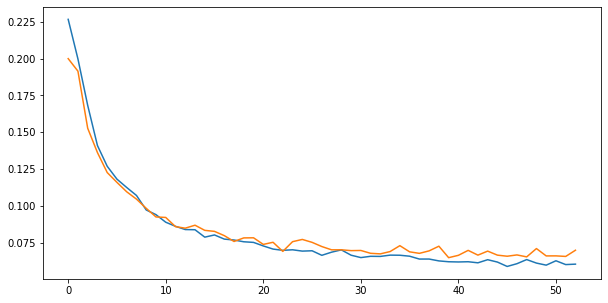

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0429                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

52 of 64
TRAIN LOSS: 0.05712052662339476
VAL LOSS: 0.06500595559676488


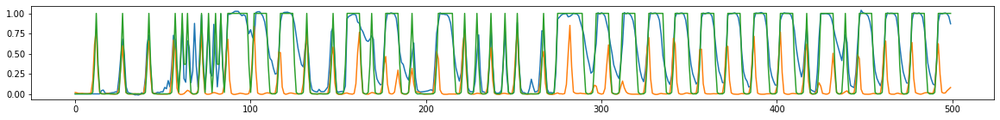

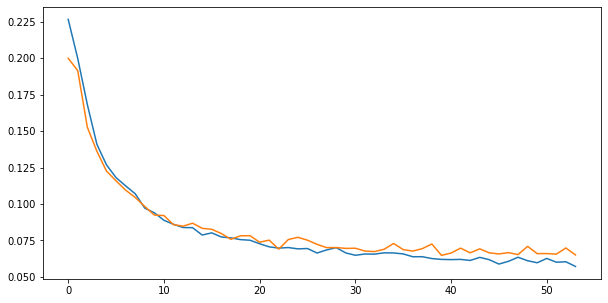

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0656                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

53 of 64
TRAIN LOSS: 0.0583948145310084
VAL LOSS: 0.06300131604075432


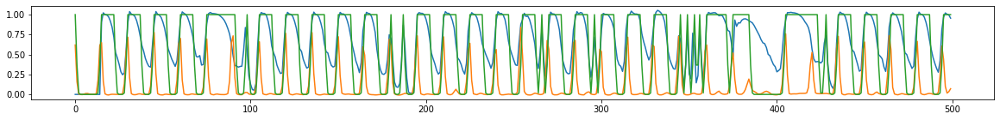

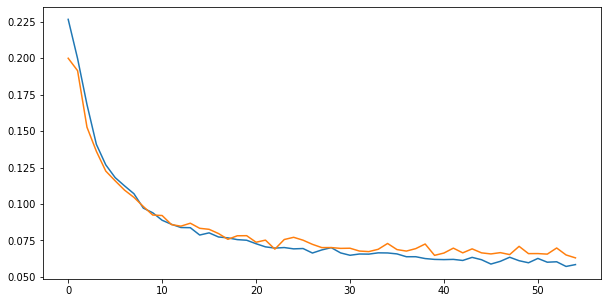

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0639                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

54 of 64
TRAIN LOSS: 0.0591290933597419
VAL LOSS: 0.06640321513017018


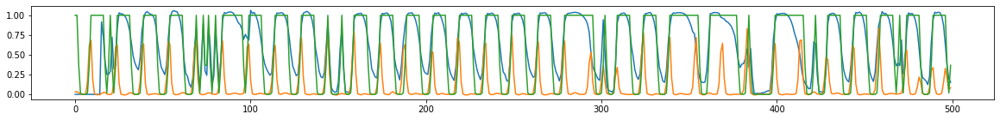

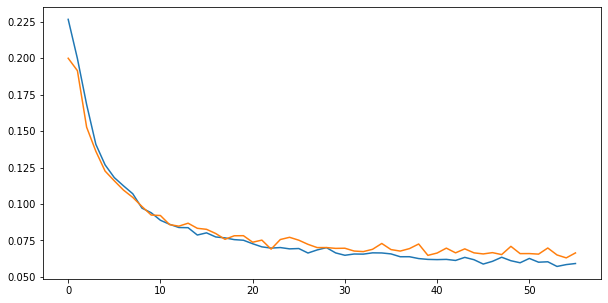

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0651                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

55 of 64
TRAIN LOSS: 0.058143984940316945
VAL LOSS: 0.06506378576159477


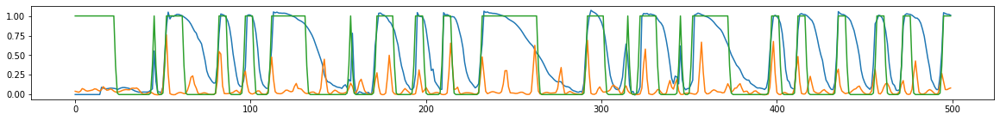

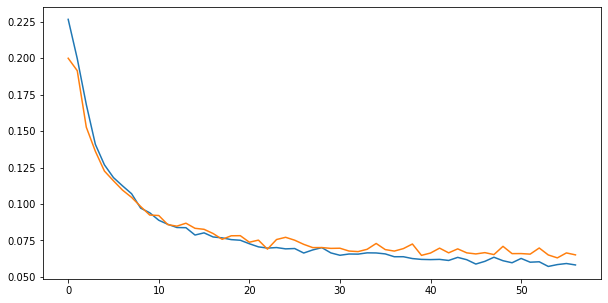

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0515                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

56 of 64
TRAIN LOSS: 0.05830243229866028
VAL LOSS: 0.06191492494609621


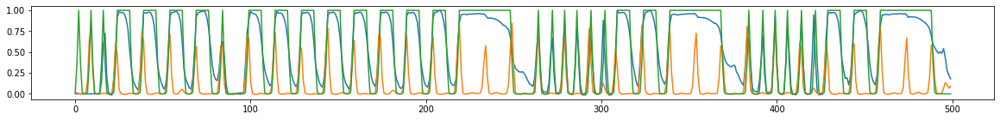

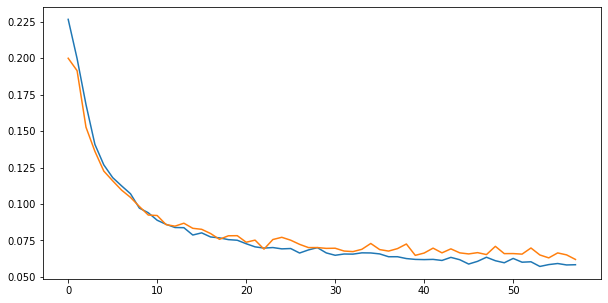

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0676                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

57 of 64
TRAIN LOSS: 0.05651852778262562
VAL LOSS: 0.061253188798824944


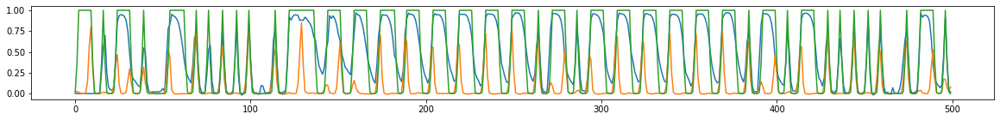

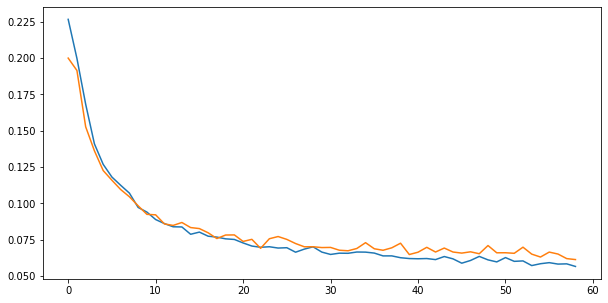

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0644                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

58 of 64
TRAIN LOSS: 0.057404457281033196
VAL LOSS: 0.06458542413181728


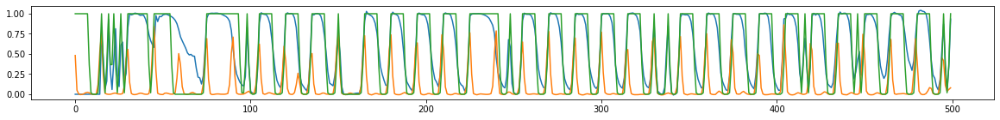

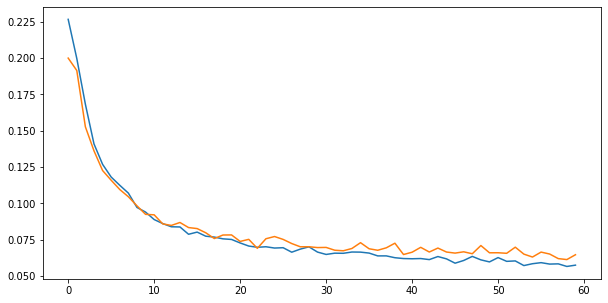

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0624                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

59 of 64
TRAIN LOSS: 0.05737033082793156
VAL LOSS: 0.05954602567685975


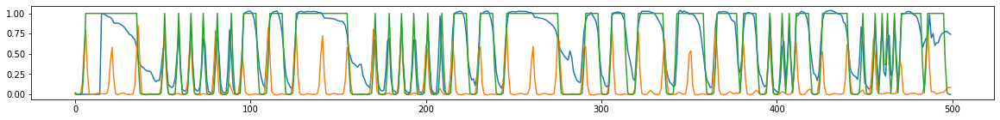

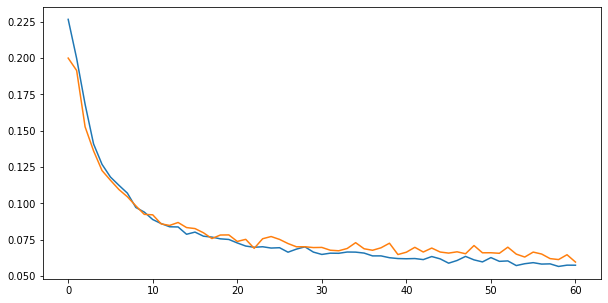

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0534                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

60 of 64
TRAIN LOSS: 0.055438466680546604
VAL LOSS: 0.061856571998861104


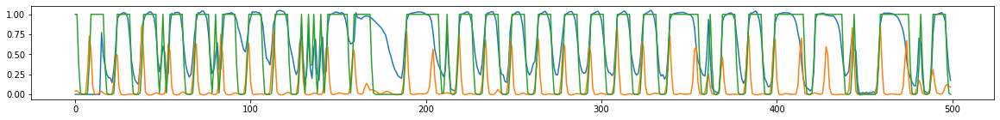

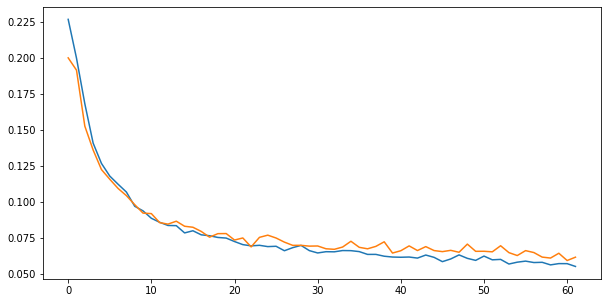

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0795                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

61 of 64
TRAIN LOSS: 0.054514745767745704
VAL LOSS: 0.062358672420183815


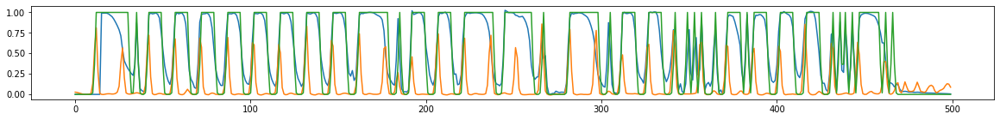

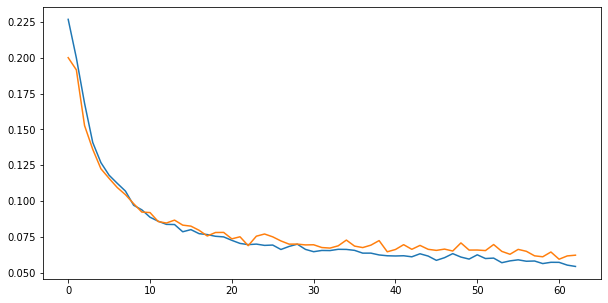

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0549                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

62 of 64
TRAIN LOSS: 0.055687085518406496
VAL LOSS: 0.06362583364049594


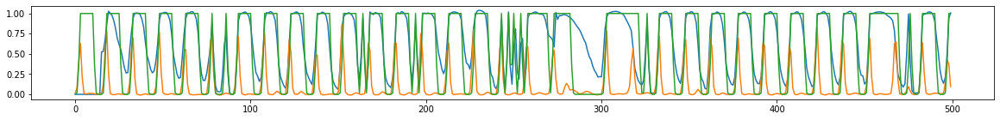

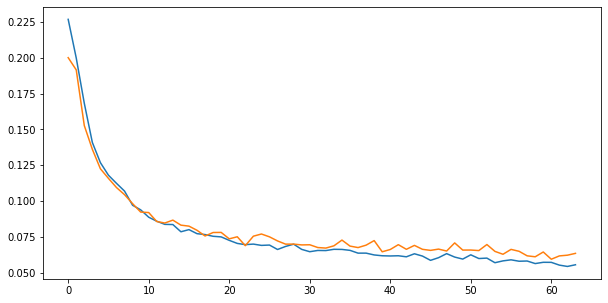

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0589                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

63 of 64
TRAIN LOSS: 0.05693623102787468
VAL LOSS: 0.06223472787274255


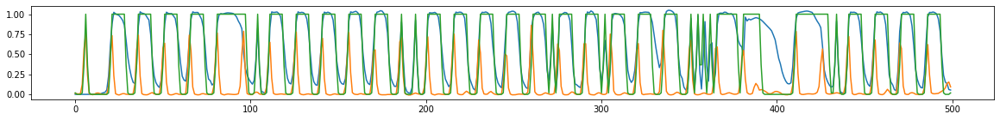

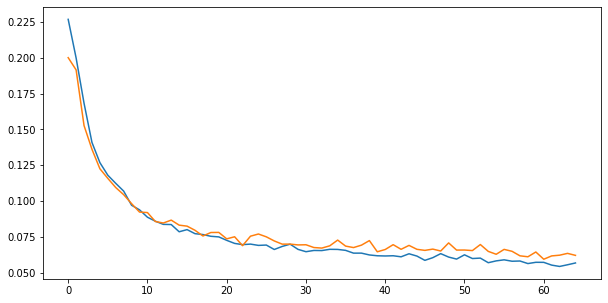

512.6373066902161 secs


In [76]:
start = time.time()

epochs = 64
trainHN()

end = time.time()
print(end - start, 'secs')

In [77]:
print(best_loss)
torch.save(best_weights, hn_model_path + str(epoch_cum) + '.pt')

0.05954602567685975


In [78]:
train_hist = train_hist[10:]
val_hist = val_hist[10:]
best_loss = 9999

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0742                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

64 of 128
TRAIN LOSS: 0.055255235069327883
VAL LOSS: 0.058165219922860466


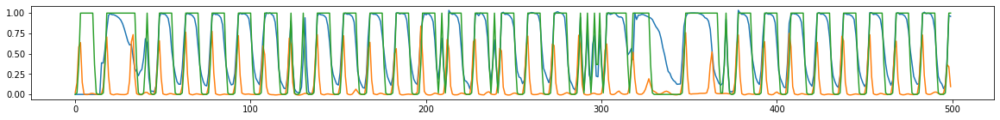

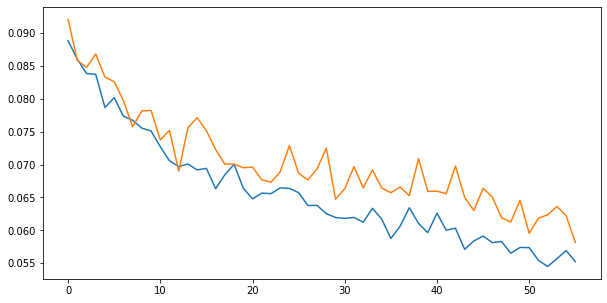

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0429                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

65 of 128
TRAIN LOSS: 0.055033188623686634
VAL LOSS: 0.06199963432219294


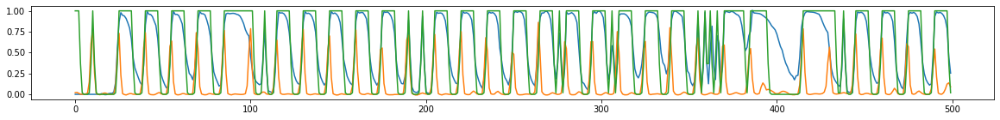

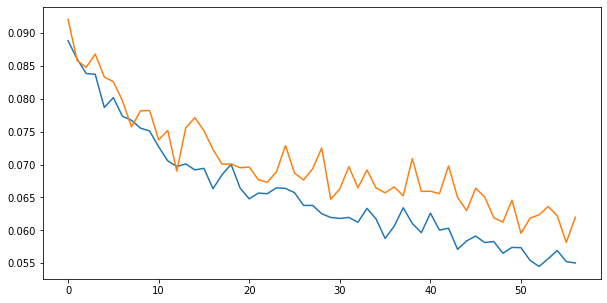

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0589                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

66 of 128
TRAIN LOSS: 0.05612188805308607
VAL LOSS: 0.06123265913791127


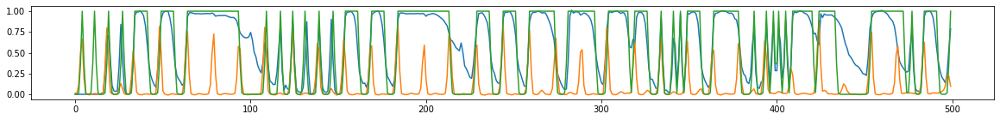

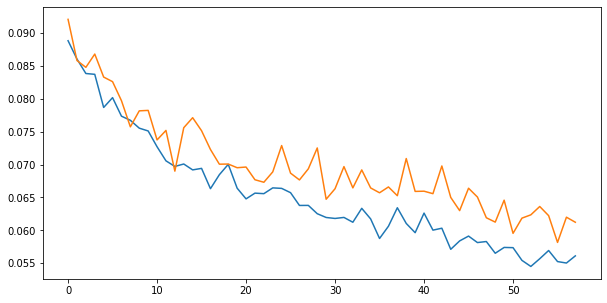

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0537                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

67 of 128
TRAIN LOSS: 0.05403111957841449
VAL LOSS: 0.06072506225771374


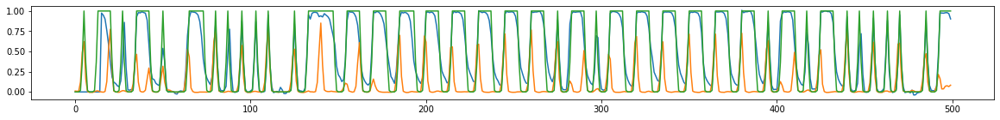

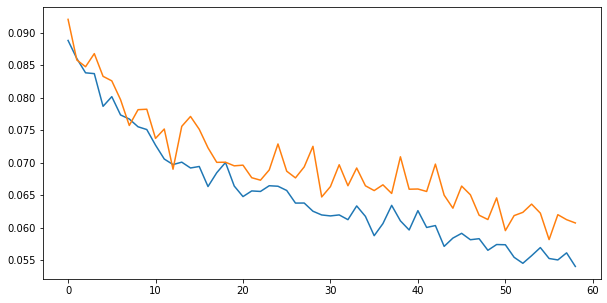

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0470                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

68 of 128
TRAIN LOSS: 0.05333772777683205
VAL LOSS: 0.0617007277905941


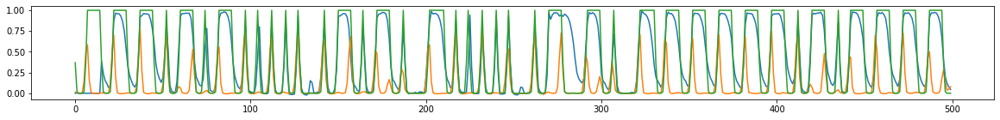

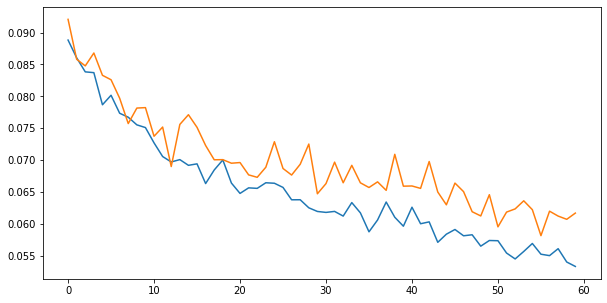

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0646                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

69 of 128
TRAIN LOSS: 0.055208527172605194
VAL LOSS: 0.05794795023070441


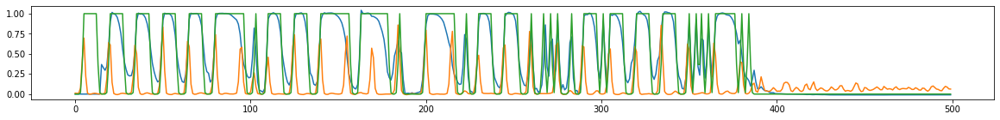

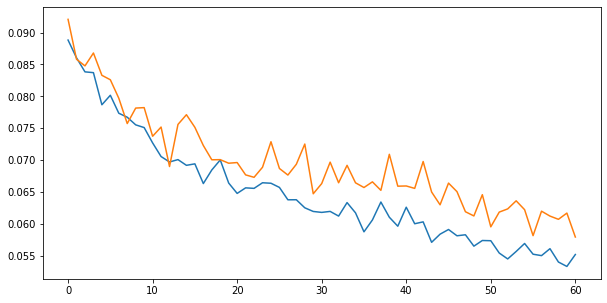

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0606                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

70 of 128
TRAIN LOSS: 0.05353625367085139
VAL LOSS: 0.0560564651257462


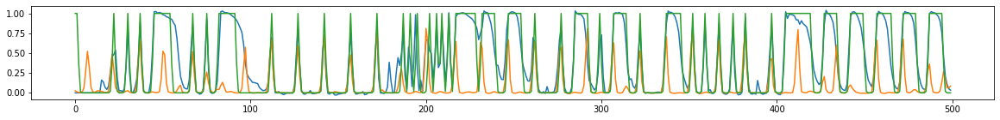

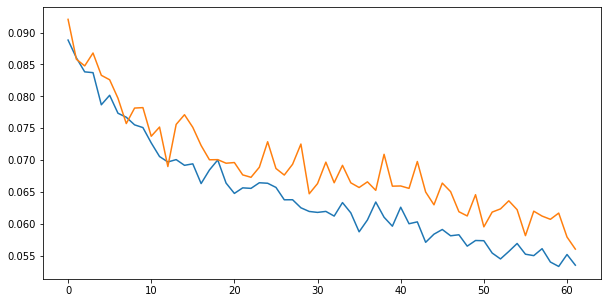

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0674                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

71 of 128
TRAIN LOSS: 0.05556606387512551
VAL LOSS: 0.05599465096990267


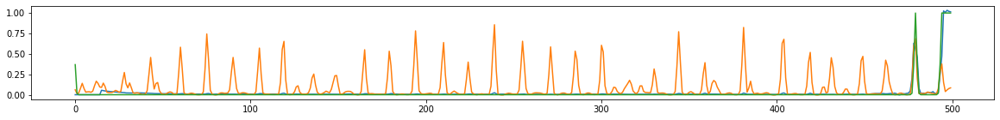

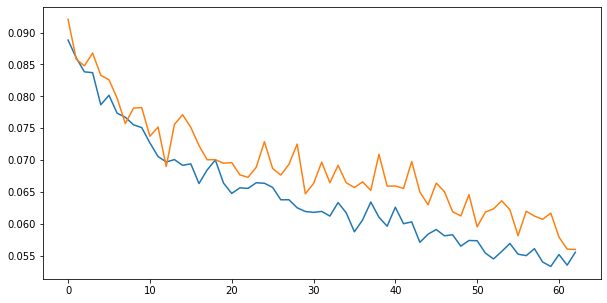

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0697                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

72 of 128
TRAIN LOSS: 0.053966036894255213
VAL LOSS: 0.06441927370097902


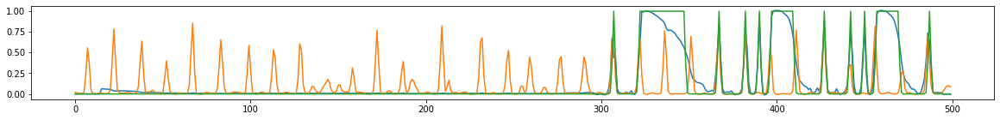

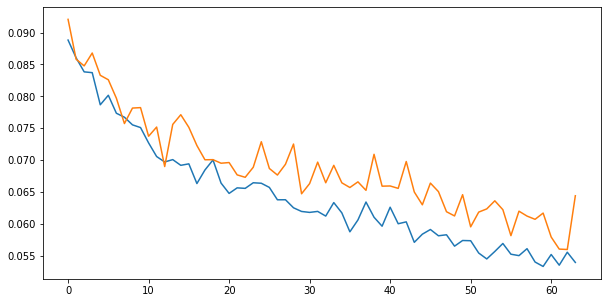

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0419                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

73 of 128
TRAIN LOSS: 0.05706442799419165
VAL LOSS: 0.06165622340308295


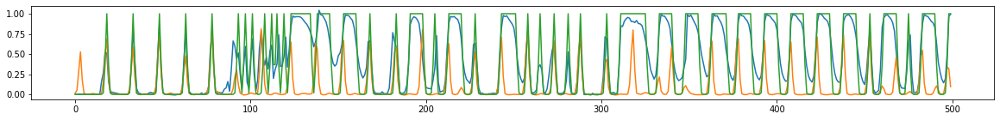

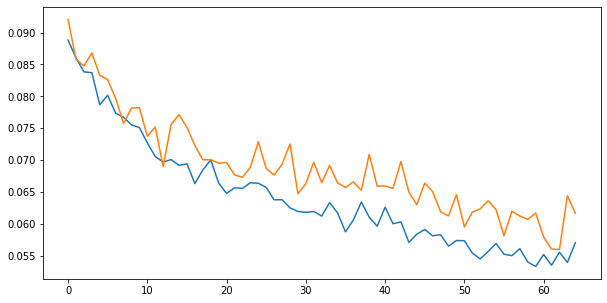

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0595                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

74 of 128
TRAIN LOSS: 0.057194136497047215
VAL LOSS: 0.06415934074256155


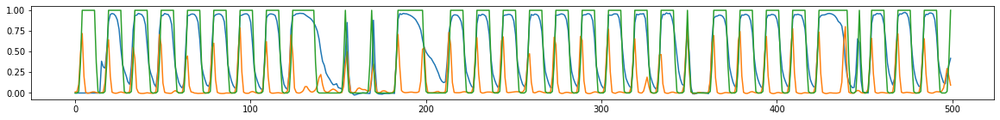

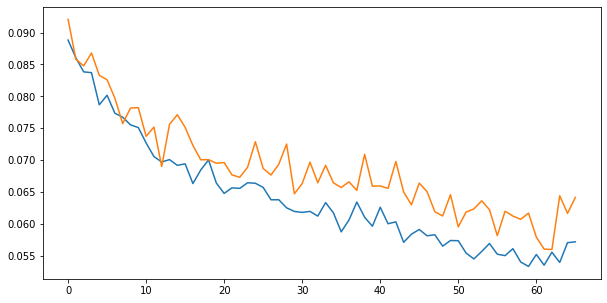

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0559                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

75 of 128
TRAIN LOSS: 0.058051634683377214
VAL LOSS: 0.062284599161810346


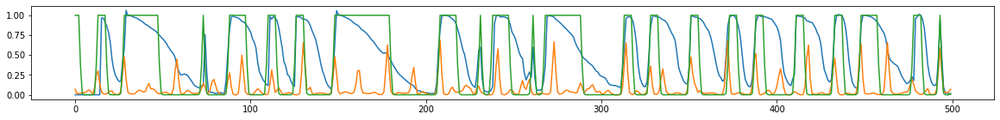

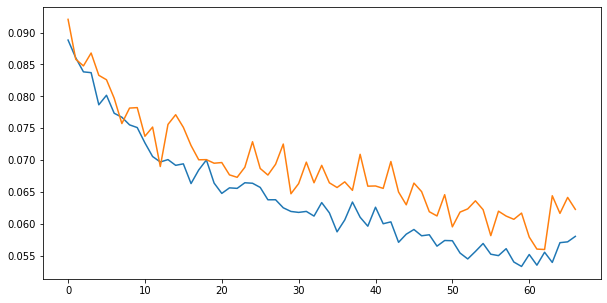

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0637                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

76 of 128
TRAIN LOSS: 0.05657473641137282
VAL LOSS: 0.06374894827604294


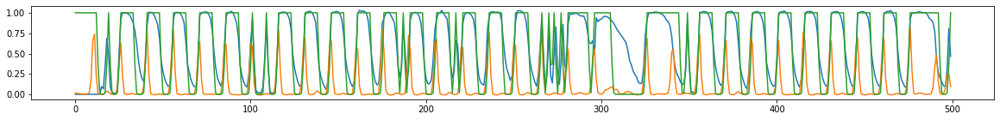

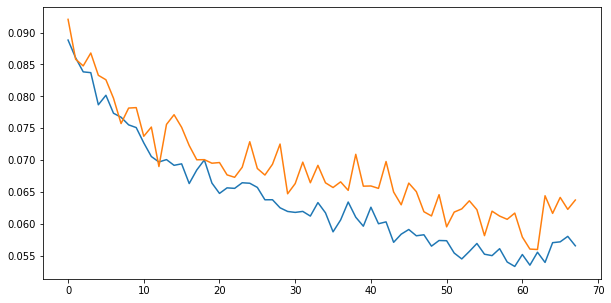

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0638                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

77 of 128
TRAIN LOSS: 0.05435216716594166
VAL LOSS: 0.06323446209232013


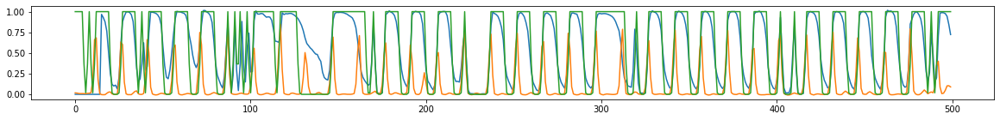

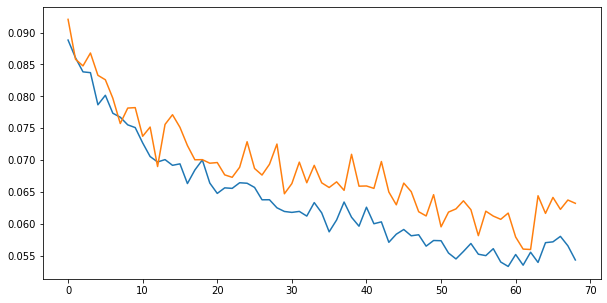

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0534                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

78 of 128
TRAIN LOSS: 0.054780871917804085
VAL LOSS: 0.06652912911441591


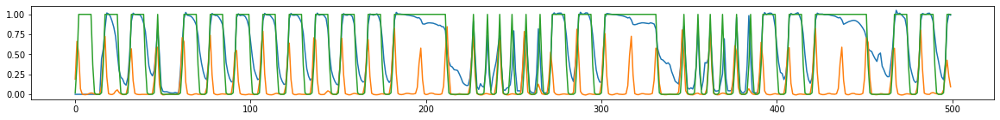

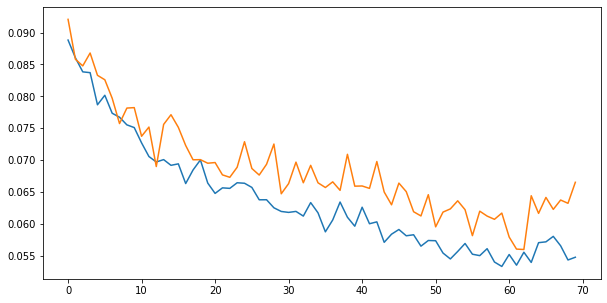

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0572                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

79 of 128
TRAIN LOSS: 0.05490939019040929
VAL LOSS: 0.06384034247861968


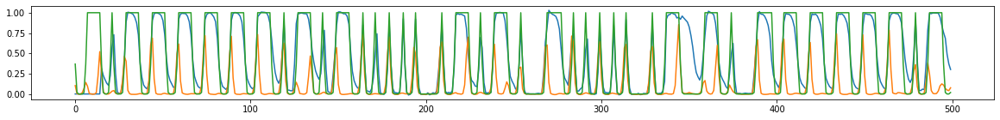

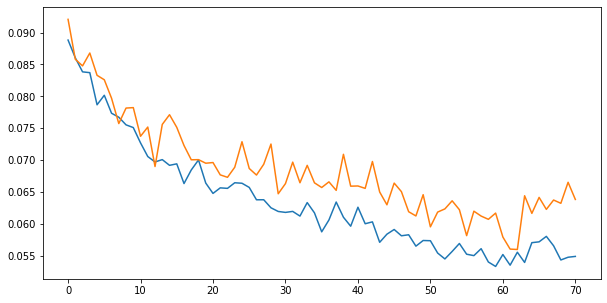

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0486                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

80 of 128
TRAIN LOSS: 0.05332142569952541
VAL LOSS: 0.06435365229845047


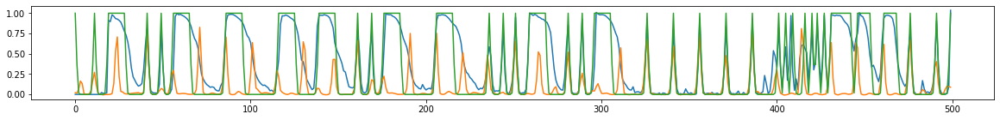

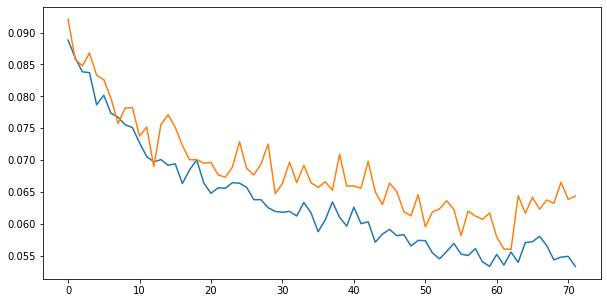

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0510                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

81 of 128
TRAIN LOSS: 0.05183915524846978
VAL LOSS: 0.06026823694507281


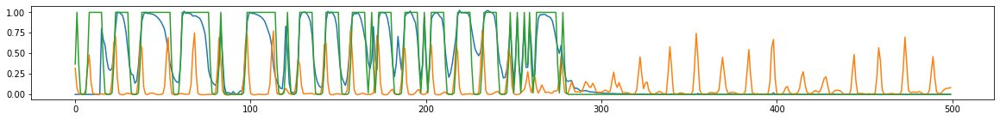

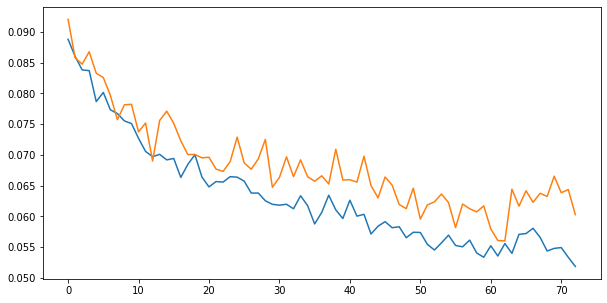

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0563                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

82 of 128
TRAIN LOSS: 0.05283472335173024
VAL LOSS: 0.06007988999287287


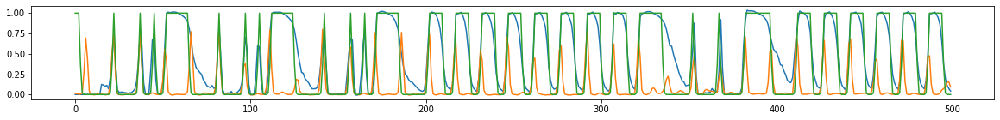

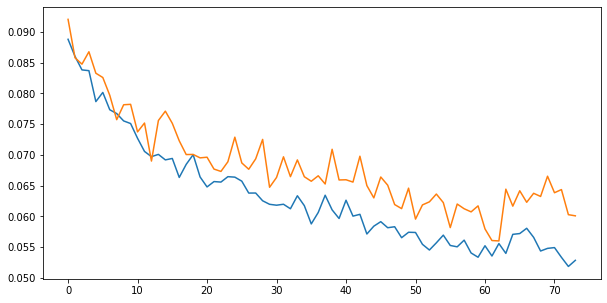

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0454                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

83 of 128
TRAIN LOSS: 0.05455637164413929
VAL LOSS: 0.05775301737917794


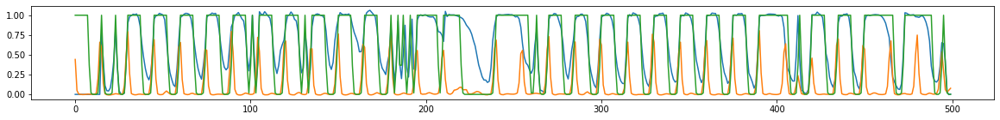

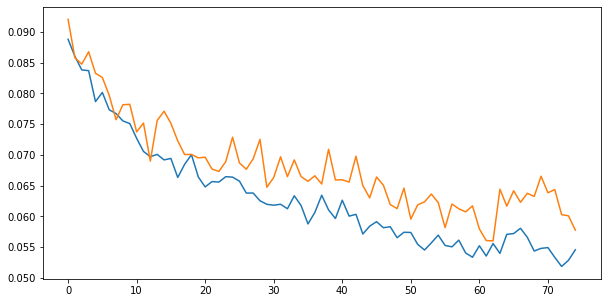

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0424                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

84 of 128
TRAIN LOSS: 0.05189001829259925
VAL LOSS: 0.059513563911120095


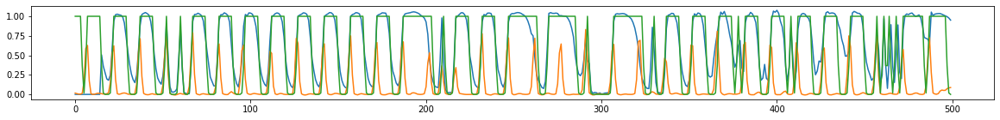

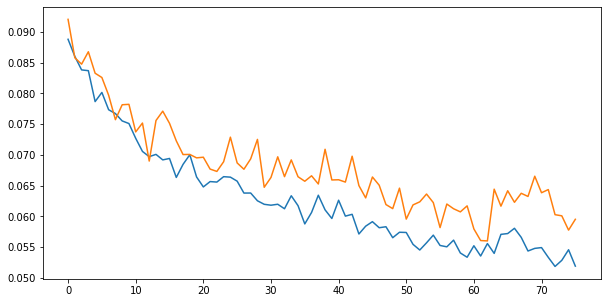

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0456                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

85 of 128
TRAIN LOSS: 0.05243431580149465
VAL LOSS: 0.055527687072753906


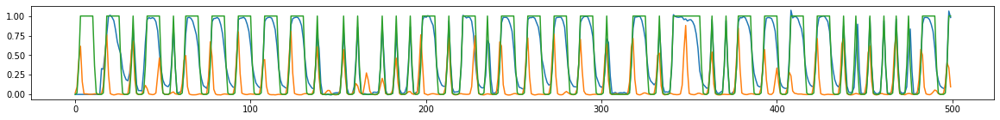

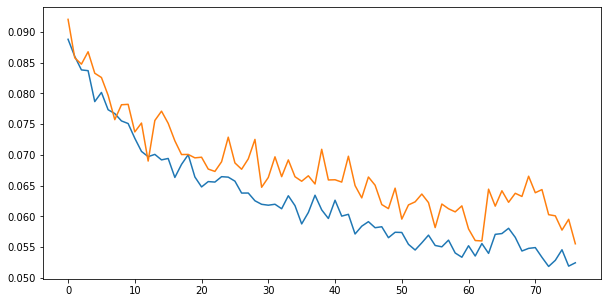

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0490                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

86 of 128
TRAIN LOSS: 0.05400907703571849
VAL LOSS: 0.06144013338618808


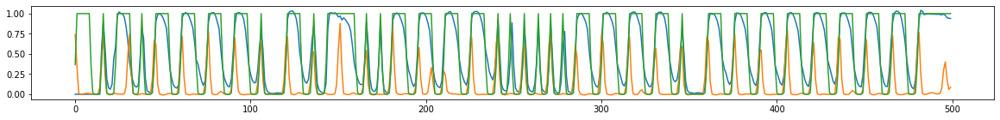

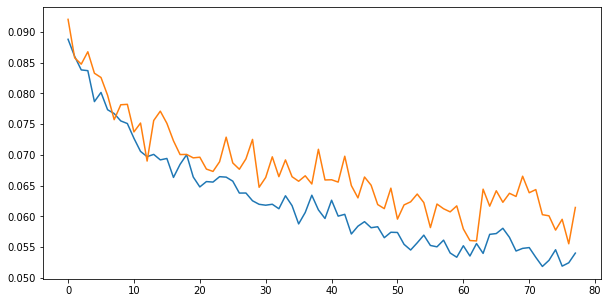

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0529                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

87 of 128
TRAIN LOSS: 0.05137278398291932
VAL LOSS: 0.056913224773274526


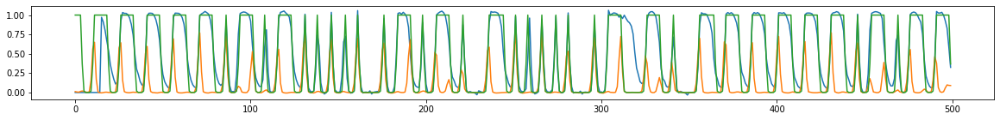

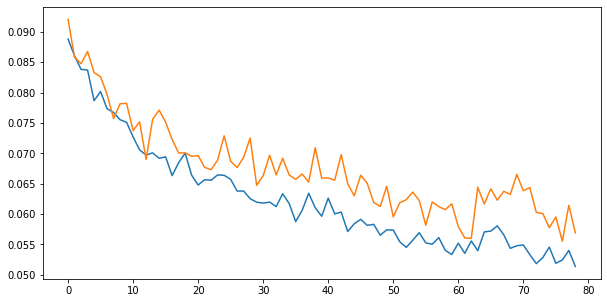

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0420                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

88 of 128
TRAIN LOSS: 0.051781527491079435
VAL LOSS: 0.05768177451358901


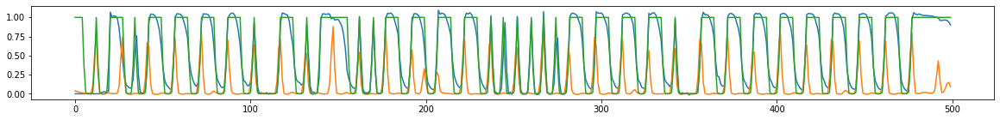

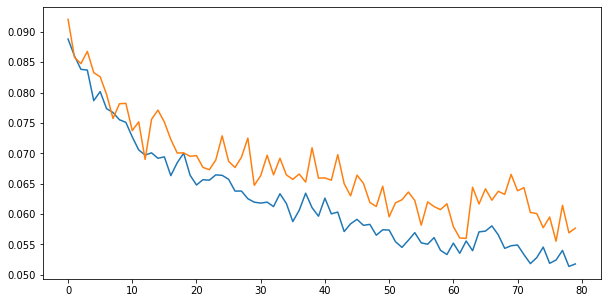

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0407                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

89 of 128
TRAIN LOSS: 0.05153427831828594
VAL LOSS: 0.05694627182351218


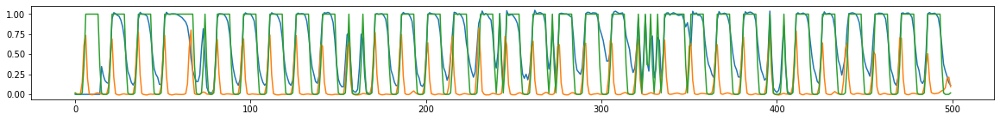

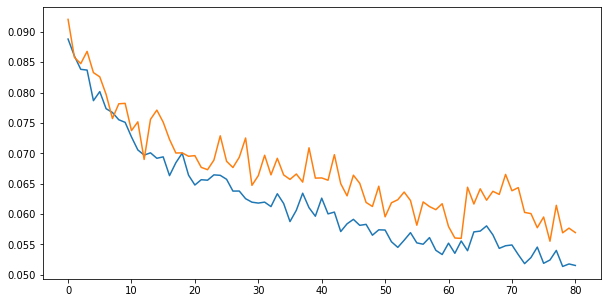

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0489                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

90 of 128
TRAIN LOSS: 0.04994573795961009
VAL LOSS: 0.05876050889492035


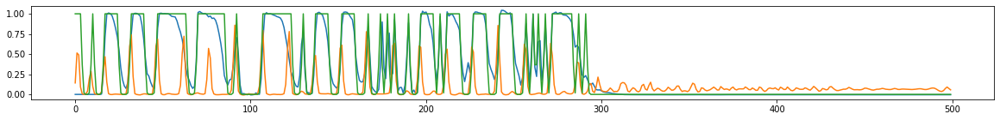

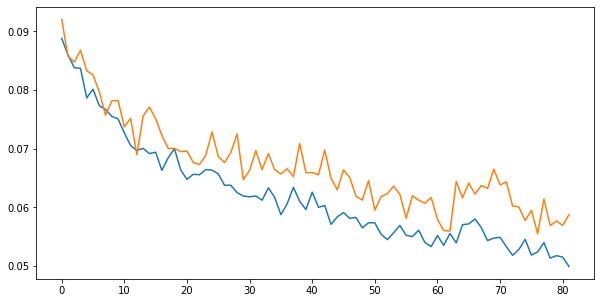

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0585                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

91 of 128
TRAIN LOSS: 0.05309604749911361
VAL LOSS: 0.05757361609074804


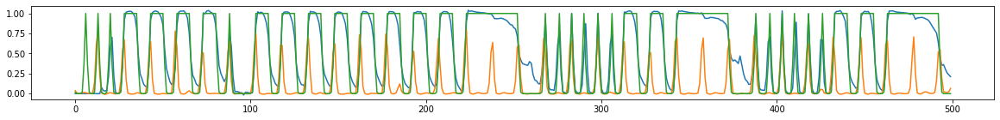

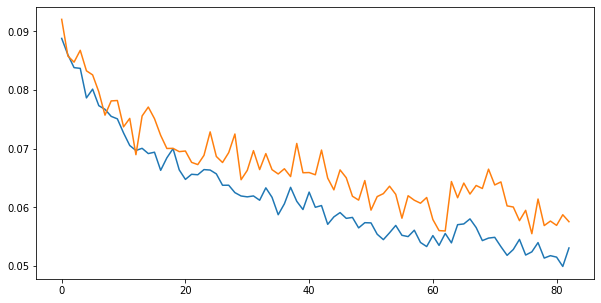

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0503                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

92 of 128
TRAIN LOSS: 0.050537333409819335
VAL LOSS: 0.059906068775388926


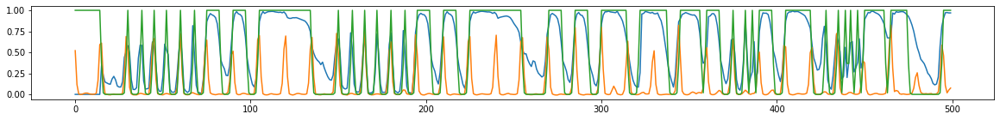

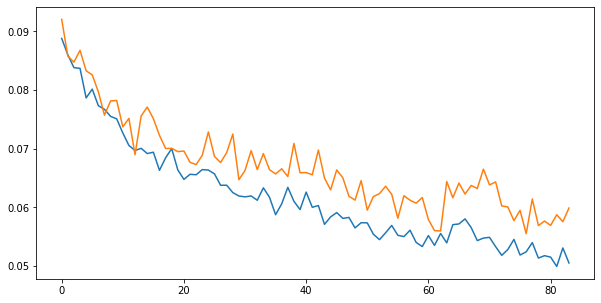

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0569                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

93 of 128
TRAIN LOSS: 0.052765045728948384
VAL LOSS: 0.05690742408235868


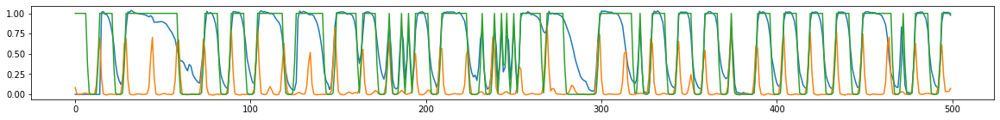

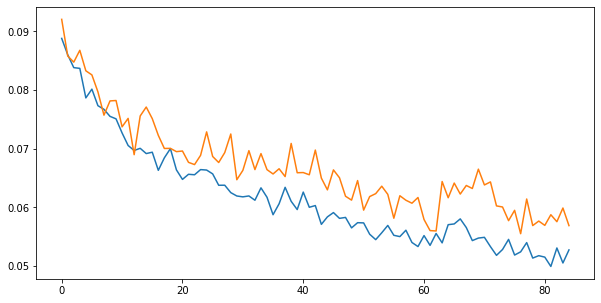

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0598                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

94 of 128
TRAIN LOSS: 0.05155559235976802
VAL LOSS: 0.05487826011247105


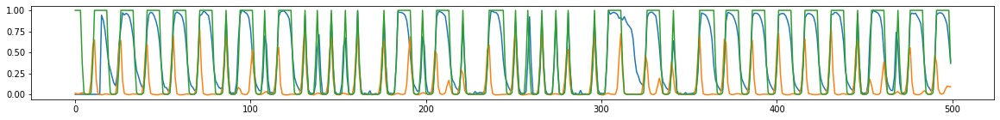

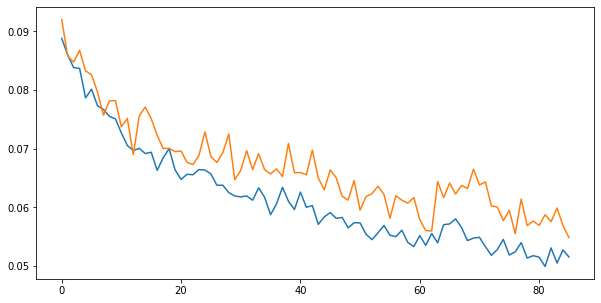

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0454                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

95 of 128
TRAIN LOSS: 0.04870752307275931
VAL LOSS: 0.055161350303226046


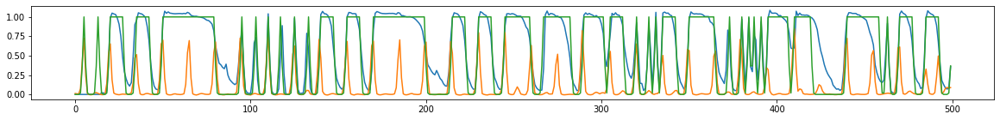

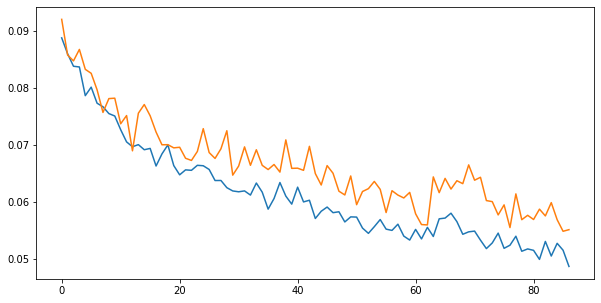

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0484                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

96 of 128
TRAIN LOSS: 0.05072316630846924
VAL LOSS: 0.05299028547273742


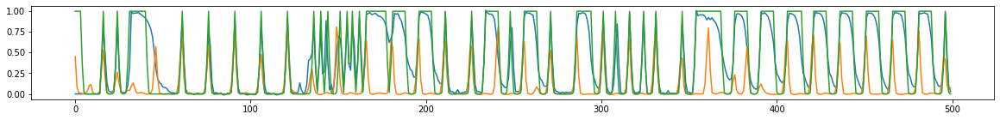

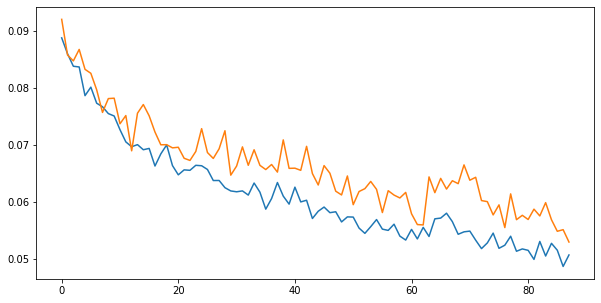

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0453                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

97 of 128
TRAIN LOSS: 0.04987432611071401
VAL LOSS: 0.05796364073952039


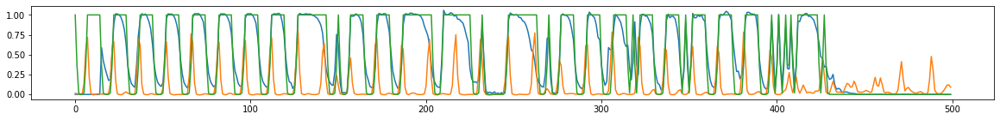

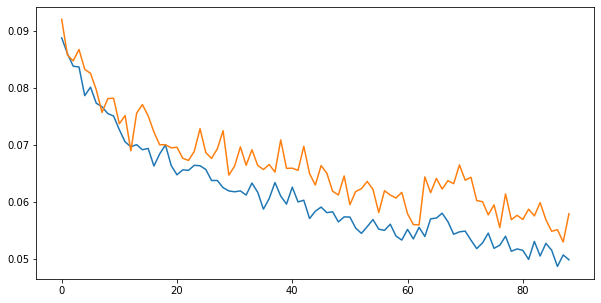

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0391                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

98 of 128
TRAIN LOSS: 0.052021812544100814
VAL LOSS: 0.05919161521726184


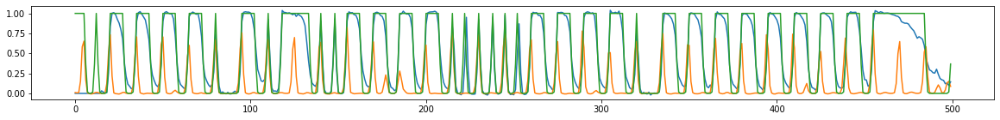

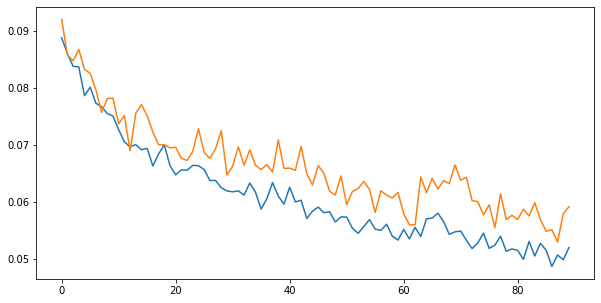

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0405                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

99 of 128
TRAIN LOSS: 0.050236089879439935
VAL LOSS: 0.058852076116535396


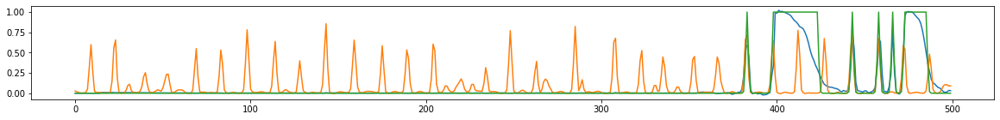

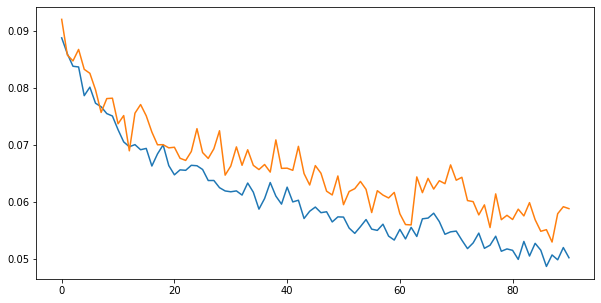

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0524                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

100 of 128
TRAIN LOSS: 0.05101678354872598
VAL LOSS: 0.05835718992683622


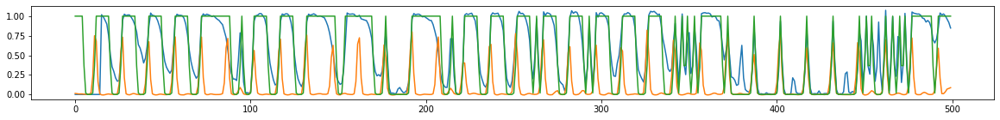

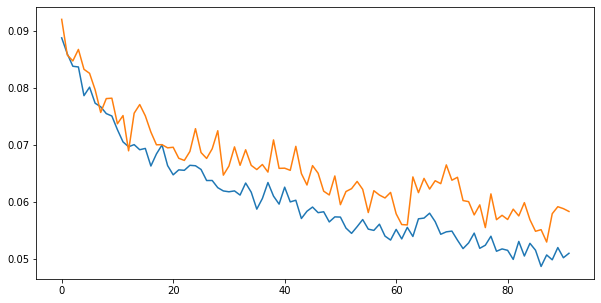

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0451                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

101 of 128
TRAIN LOSS: 0.060091047237316765
VAL LOSS: 0.06487441642416848


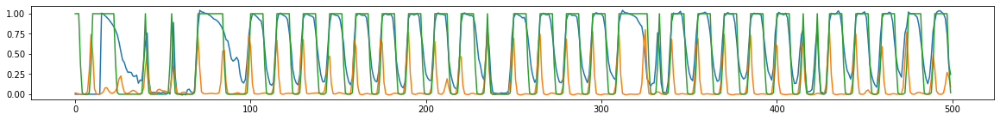

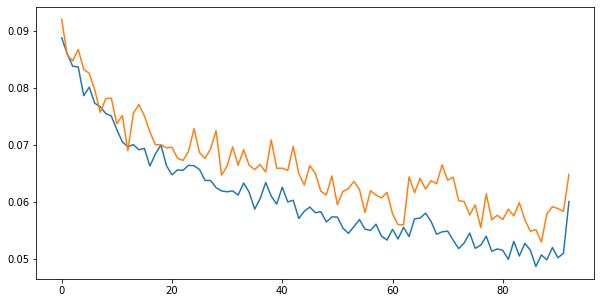

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.1727                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

102 of 128
TRAIN LOSS: 0.07946869047979514
VAL LOSS: 0.17003869679239061


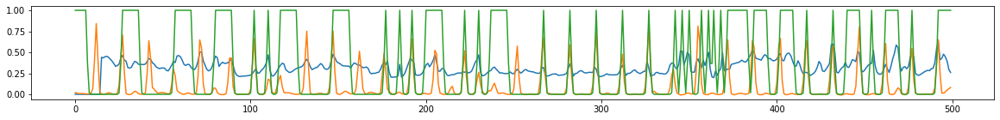

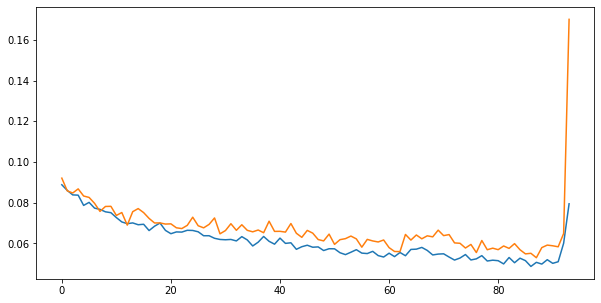

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.1038                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

103 of 128
TRAIN LOSS: 0.13999269323216545
VAL LOSS: 0.11425076590643989


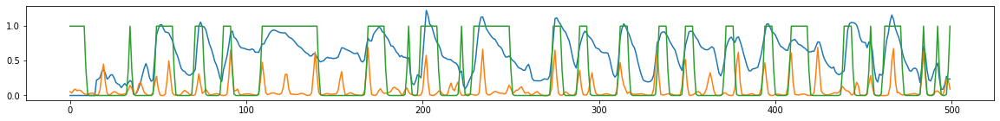

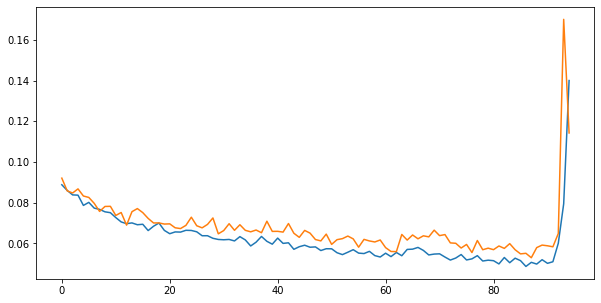

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0863                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

104 of 128
TRAIN LOSS: 0.1008610220419036
VAL LOSS: 0.09752967788113488


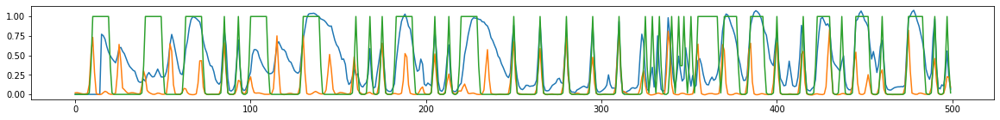

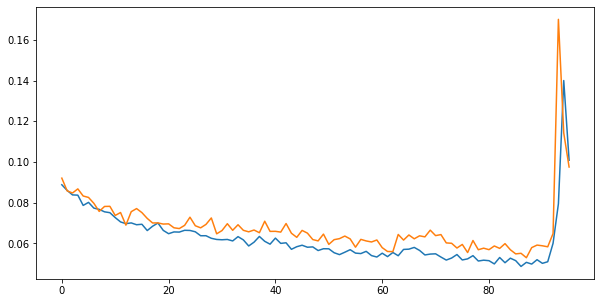

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0921                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

105 of 128
TRAIN LOSS: 0.08811568862034215
VAL LOSS: 0.09093250003125933


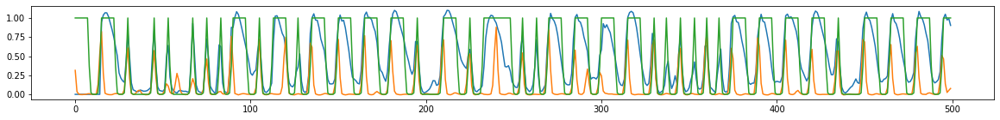

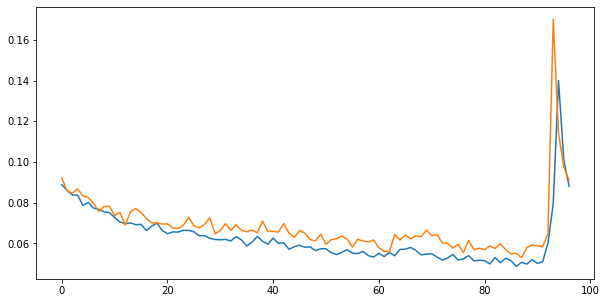

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0907                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

106 of 128
TRAIN LOSS: 0.08321089297533035
VAL LOSS: 0.09005523886945513


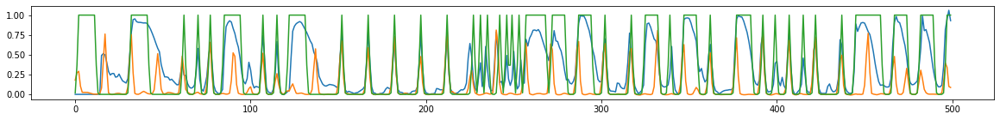

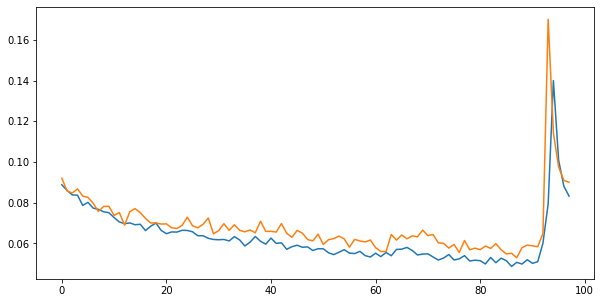

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0911                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

107 of 128
TRAIN LOSS: 0.08258885434932178
VAL LOSS: 0.08168461008204354


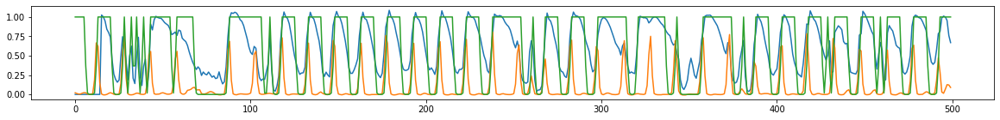

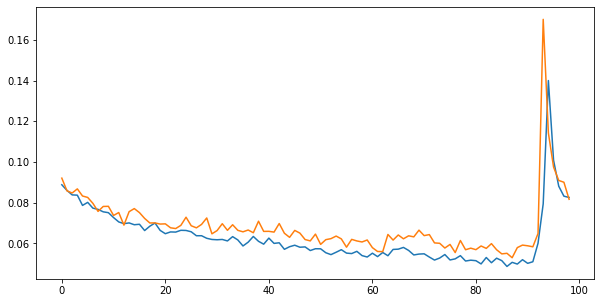

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0846                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

108 of 128
TRAIN LOSS: 0.0792657295241952
VAL LOSS: 0.08270762612422307


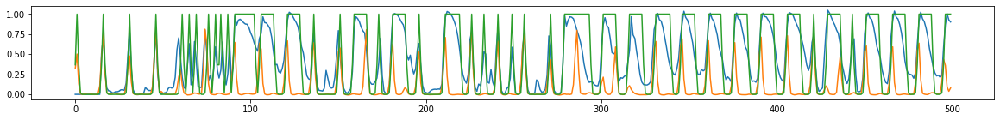

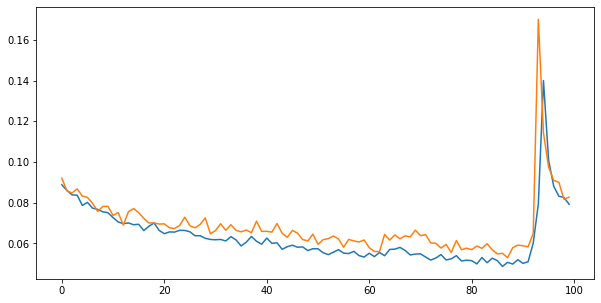

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0732                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

109 of 128
TRAIN LOSS: 0.08008988036049737
VAL LOSS: 0.0808778843945927


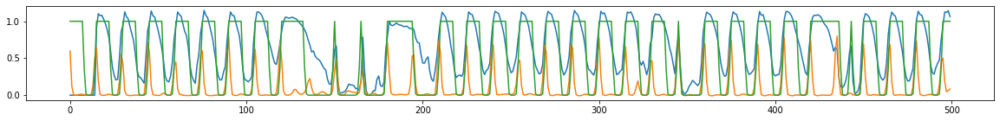

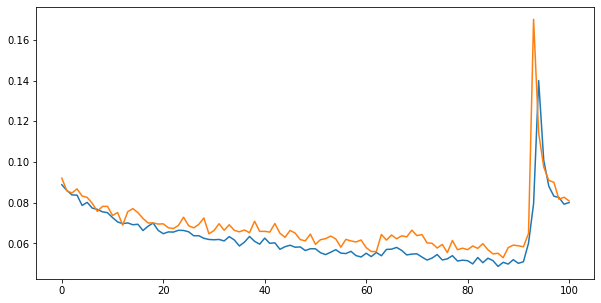

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0763                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

110 of 128
TRAIN LOSS: 0.07520798800720109
VAL LOSS: 0.0802803784608841


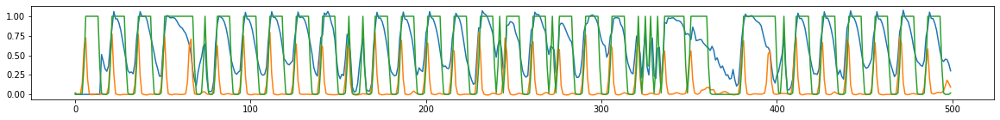

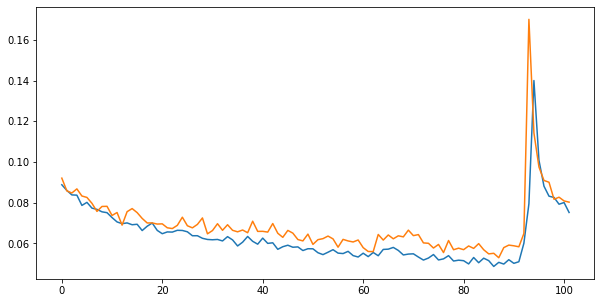

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0626                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

111 of 128
TRAIN LOSS: 0.07311457519729932
VAL LOSS: 0.07577723181909984


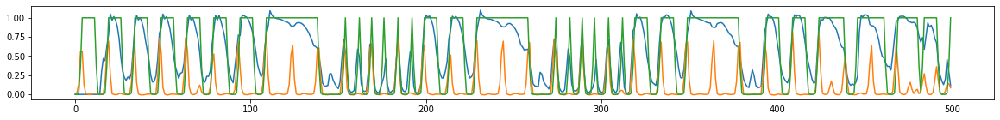

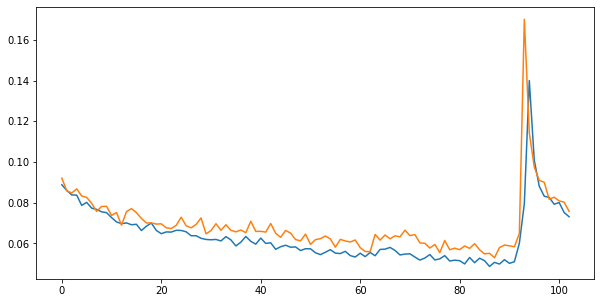

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0837                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

112 of 128
TRAIN LOSS: 0.07526098398698701
VAL LOSS: 0.07609758774439494


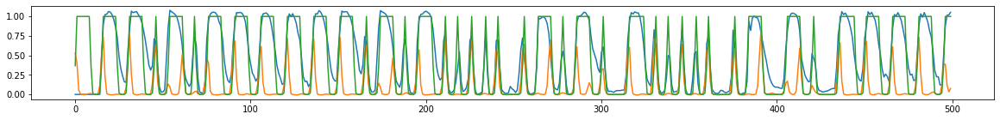

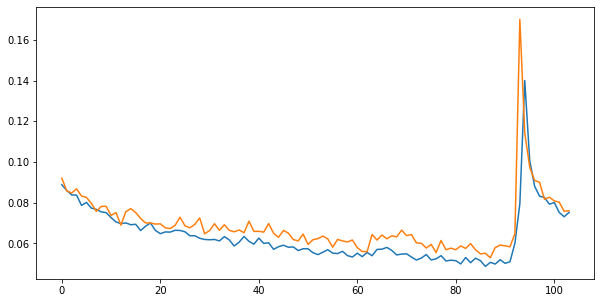

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0766                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

113 of 128
TRAIN LOSS: 0.07253176698254214
VAL LOSS: 0.07521513766712612


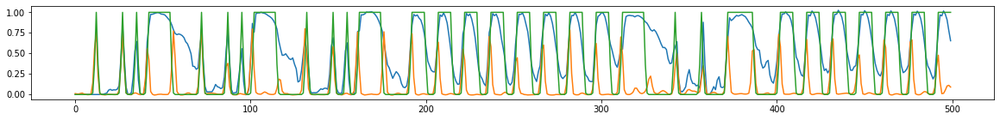

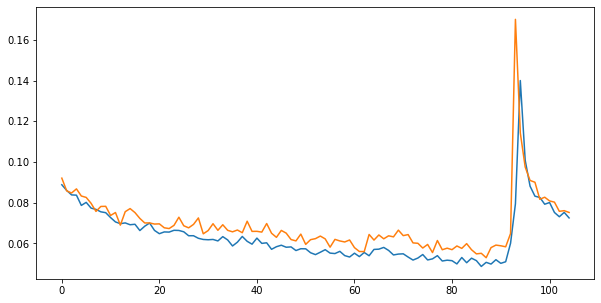

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0648                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

114 of 128
TRAIN LOSS: 0.07254612404439184
VAL LOSS: 0.07487245317962435


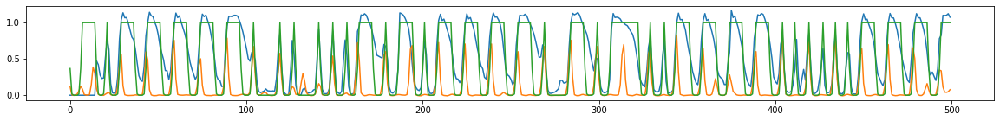

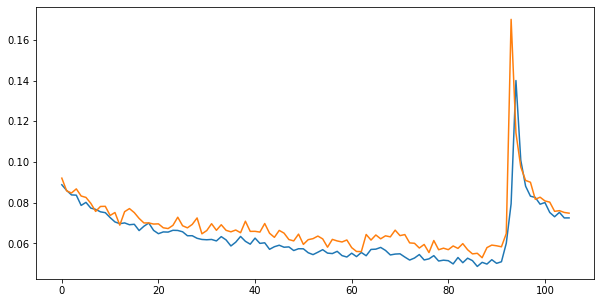

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0700                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

115 of 128
TRAIN LOSS: 0.07202630769461393
VAL LOSS: 0.07196713611483574


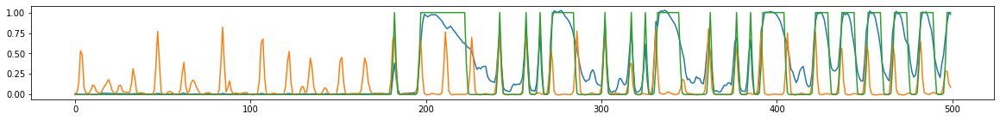

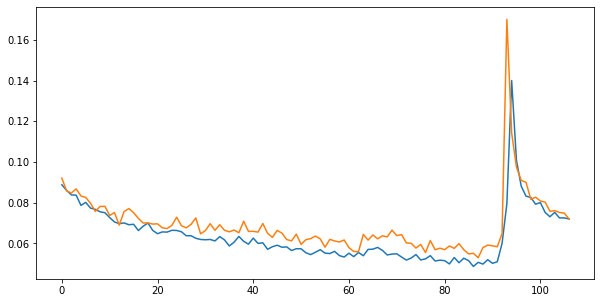

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0771                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

116 of 128
TRAIN LOSS: 0.07029212866392401
VAL LOSS: 0.0727931335568428


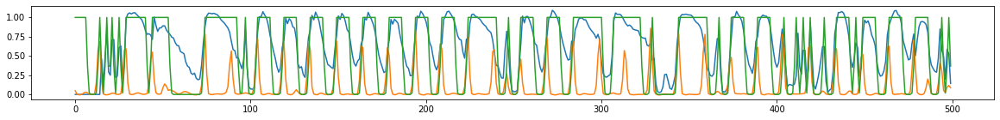

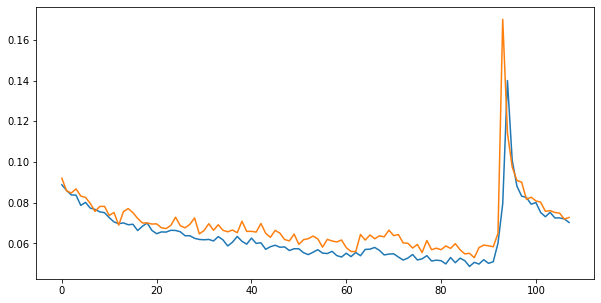

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0842                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

117 of 128
TRAIN LOSS: 0.07199624687847164
VAL LOSS: 0.07558641665511662


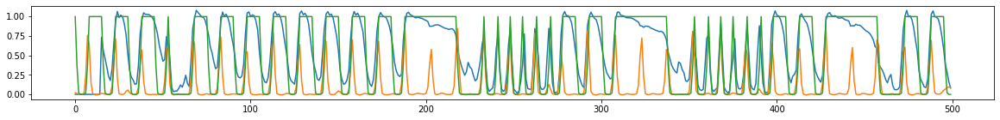

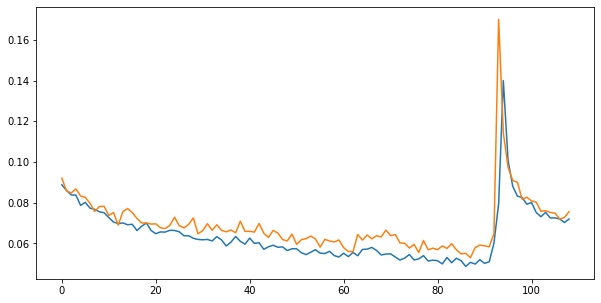

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0689                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

118 of 128
TRAIN LOSS: 0.07102931487477487
VAL LOSS: 0.07506359865268071


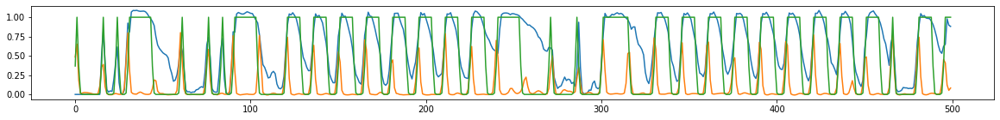

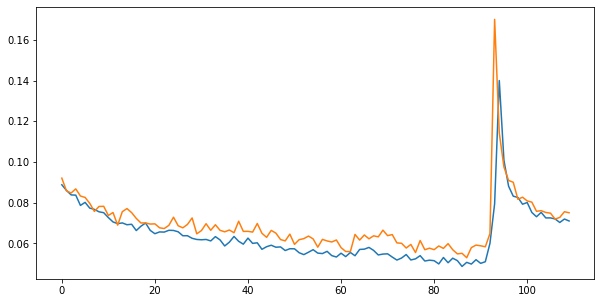

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0641                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

119 of 128
TRAIN LOSS: 0.06939827899138133
VAL LOSS: 0.07068292134337956


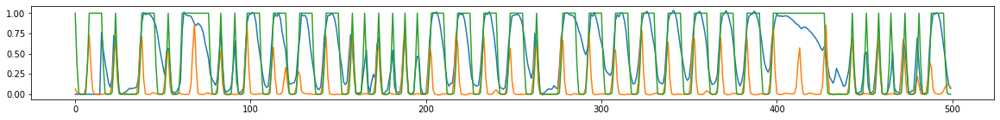

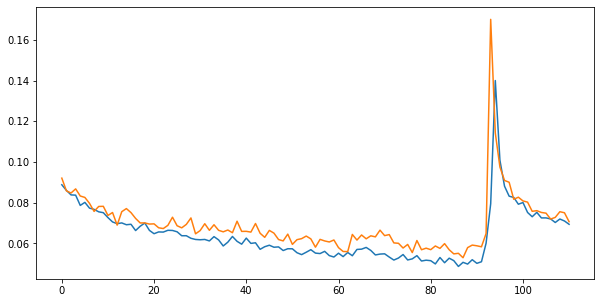

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0697                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

120 of 128
TRAIN LOSS: 0.06835570434729259
VAL LOSS: 0.08206498043404685


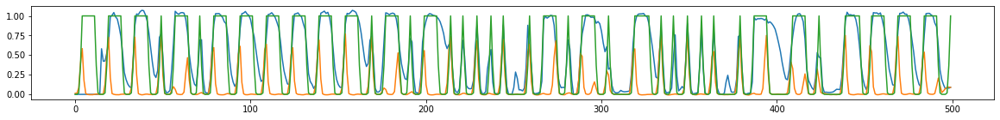

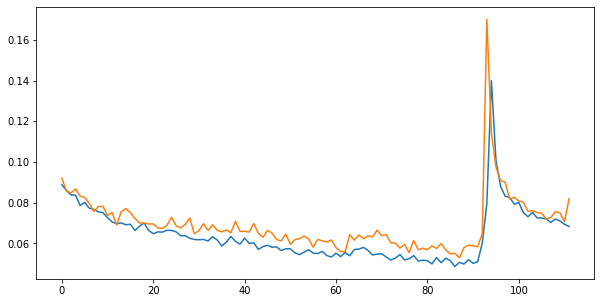

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0843                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

121 of 128
TRAIN LOSS: 0.06841369211259815
VAL LOSS: 0.06715806366668807


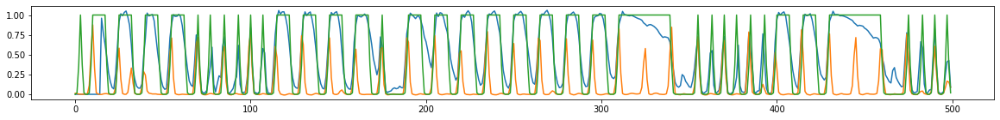

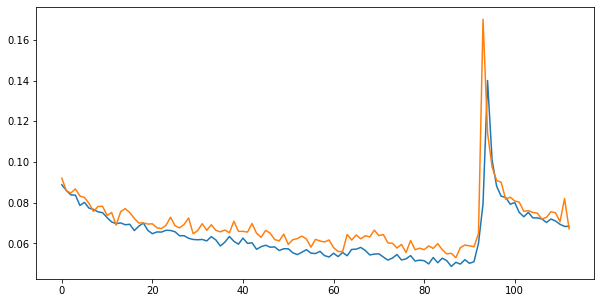

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0785                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

122 of 128
TRAIN LOSS: 0.06789161906474167
VAL LOSS: 0.07045601308345795


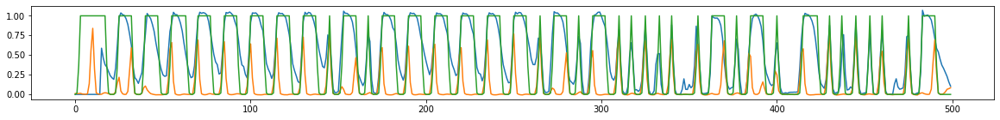

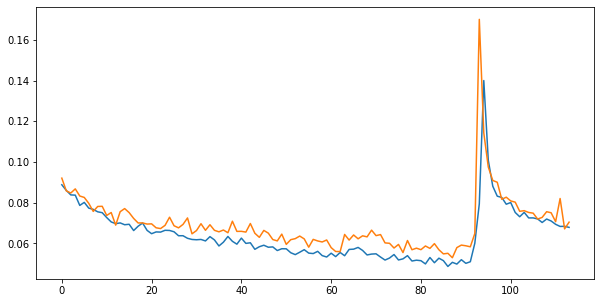

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0705                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

123 of 128
TRAIN LOSS: 0.0673489004580511
VAL LOSS: 0.0703327287402418


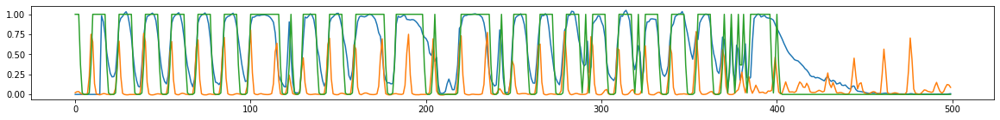

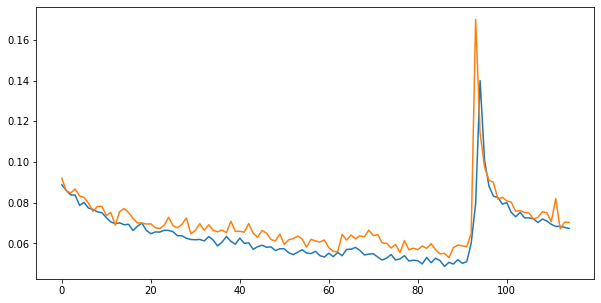

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0663                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

124 of 128
TRAIN LOSS: 0.06554206440018283
VAL LOSS: 0.06841962701744503


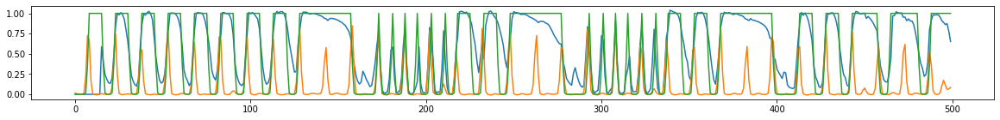

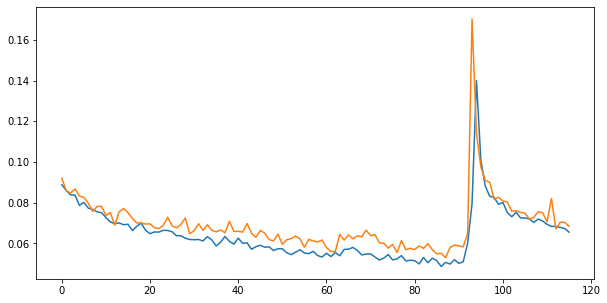

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0796                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

125 of 128
TRAIN LOSS: 0.06684808370967706
VAL LOSS: 0.07419046759605408


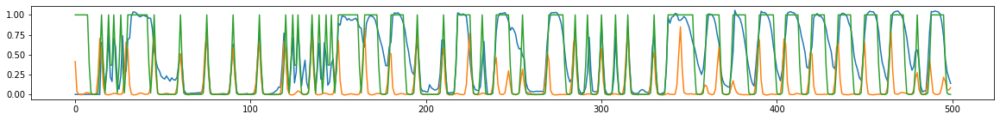

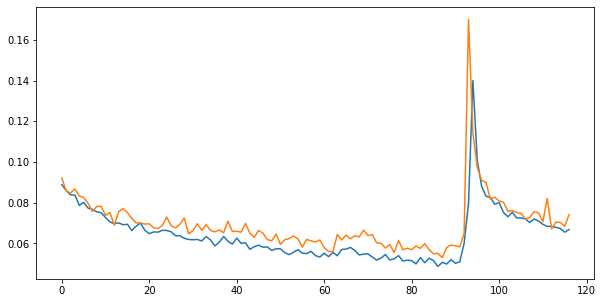

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0482                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

126 of 128
TRAIN LOSS: 0.06534634623676538
VAL LOSS: 0.07198286470439699


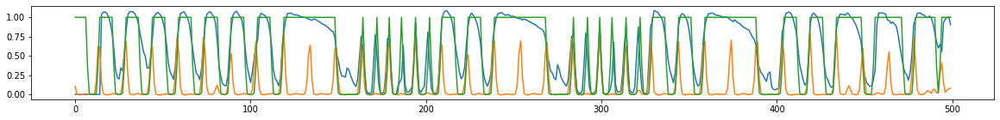

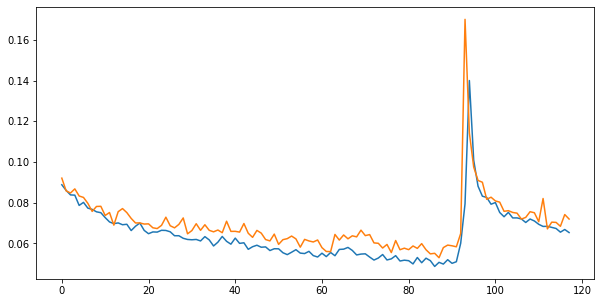

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0668                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

127 of 128
TRAIN LOSS: 0.06312568640957276
VAL LOSS: 0.0697123081319862


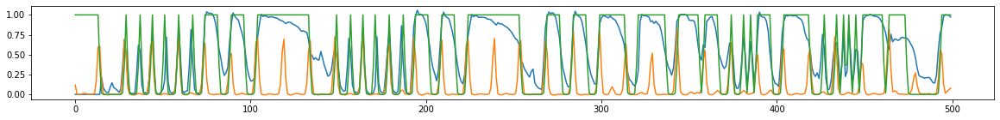

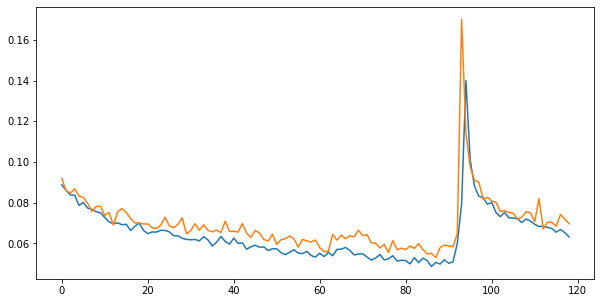

515.1243588924408 secs


In [79]:
start = time.time()

epochs = 64
trainHN()

end = time.time()
print(end - start, 'secs')

In [80]:
print(best_loss)
torch.save(best_weights, hn_model_path + str(epoch_cum) + '.pt')

0.05299028547273742


 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.93it/s  0.0581                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

128 of 192
TRAIN LOSS: 0.06551085743639204
VAL LOSS: 0.0710335878862275


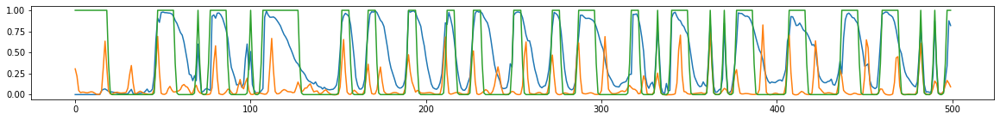

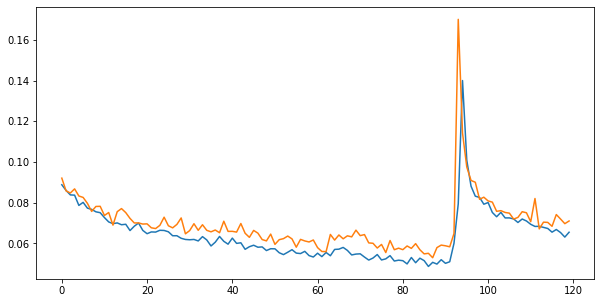

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.95it/s  0.0876                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

129 of 192
TRAIN LOSS: 0.06518021018968688
VAL LOSS: 0.07091575033134884


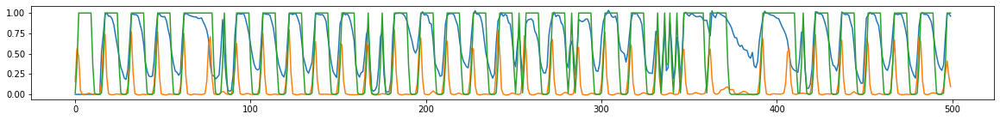

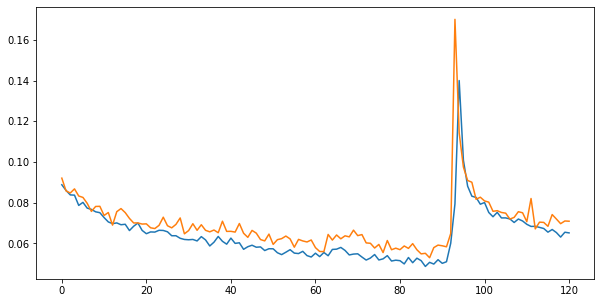

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.93it/s  0.0680                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

130 of 192
TRAIN LOSS: 0.06751462734407848
VAL LOSS: 0.0685290354821417


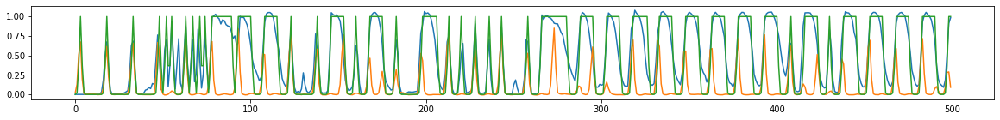

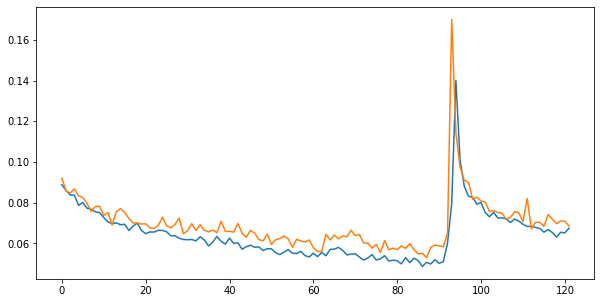

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.95it/s  0.0698                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

131 of 192
TRAIN LOSS: 0.06594702073683341
VAL LOSS: 0.07775337166256374


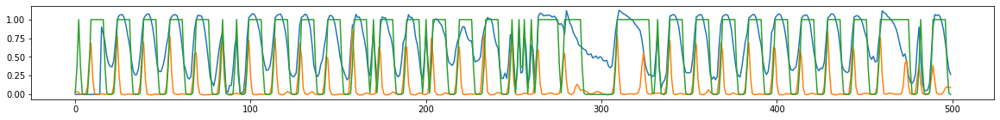

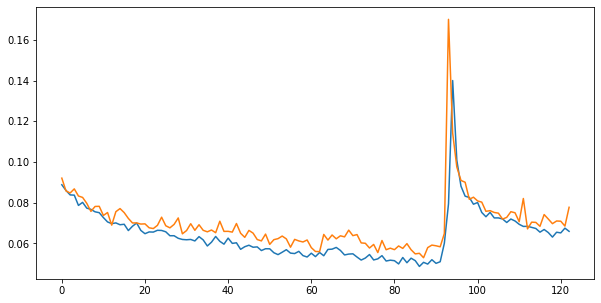

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.93it/s  0.0666                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

132 of 192
TRAIN LOSS: 0.06850322729183568
VAL LOSS: 0.06895756307575437


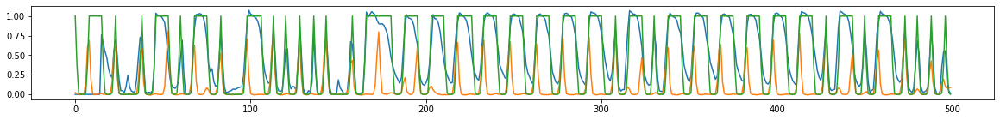

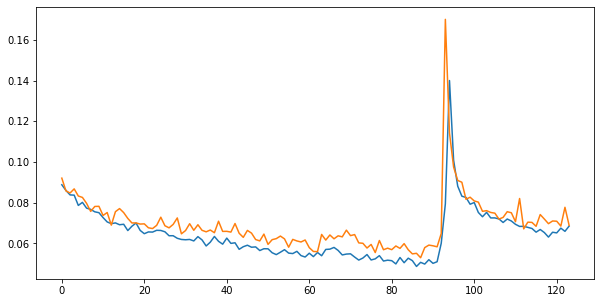

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.92it/s  0.0652                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

133 of 192
TRAIN LOSS: 0.0644069155678153
VAL LOSS: 0.07243319104115169


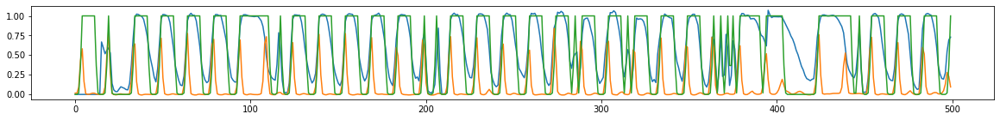

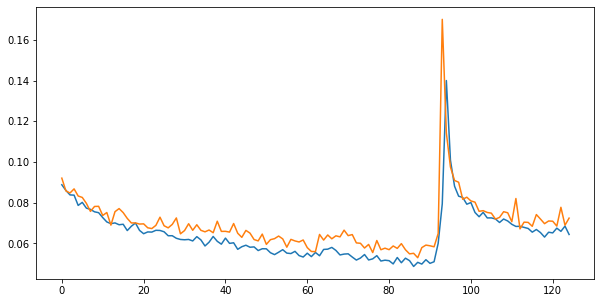

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.92it/s  0.0624                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

134 of 192
TRAIN LOSS: 0.0650359315590726
VAL LOSS: 0.06611104143990411


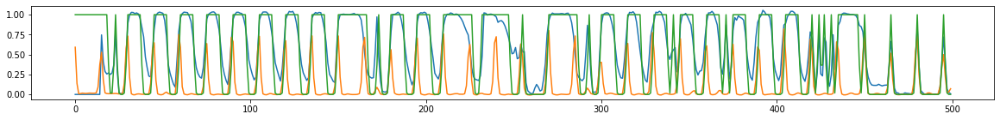

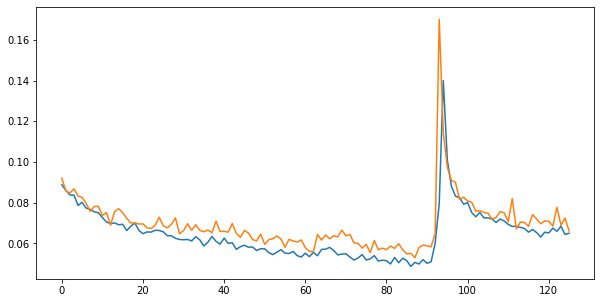

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.91it/s  0.0594                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

135 of 192
TRAIN LOSS: 0.06288451784186894
VAL LOSS: 0.06790170239077674


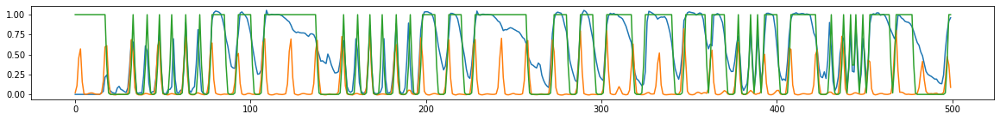

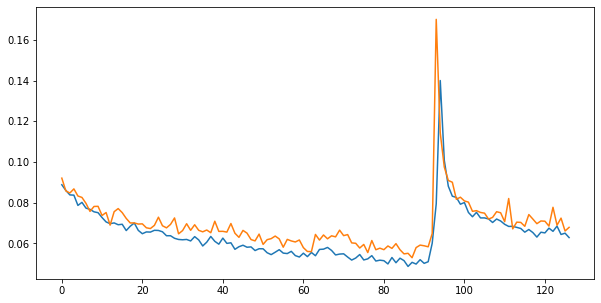

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.93it/s  0.0671                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

136 of 192
TRAIN LOSS: 0.06350783755381902
VAL LOSS: 0.06805264825622241


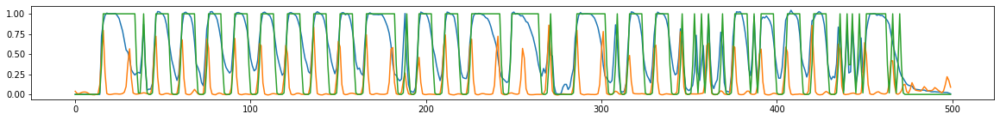

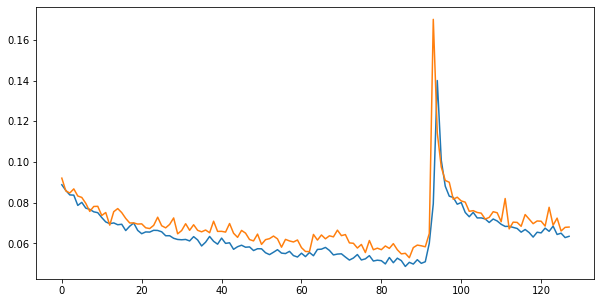

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.91it/s  0.0519                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

137 of 192
TRAIN LOSS: 0.061504758790963225
VAL LOSS: 0.0710864630010393


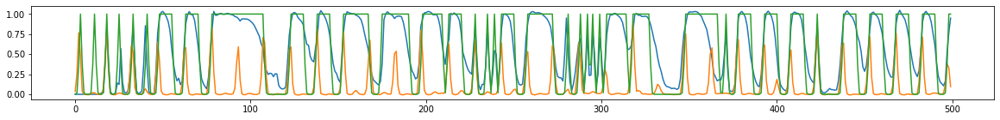

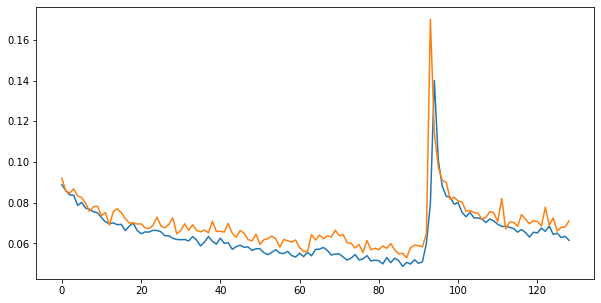

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.91it/s  0.0660                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

138 of 192
TRAIN LOSS: 0.06446202161411445
VAL LOSS: 0.06293767028384739


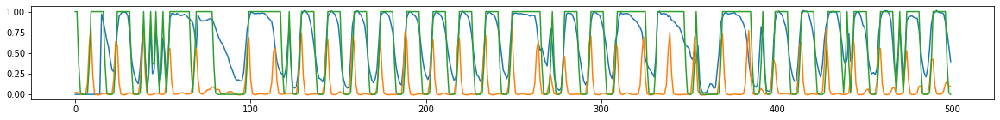

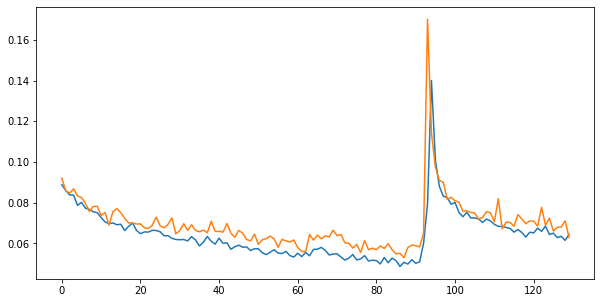

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0768                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

139 of 192
TRAIN LOSS: 0.06233772625111871
VAL LOSS: 0.06498787386549844


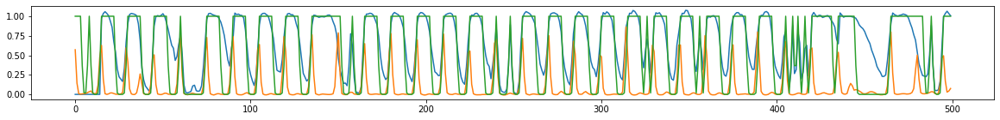

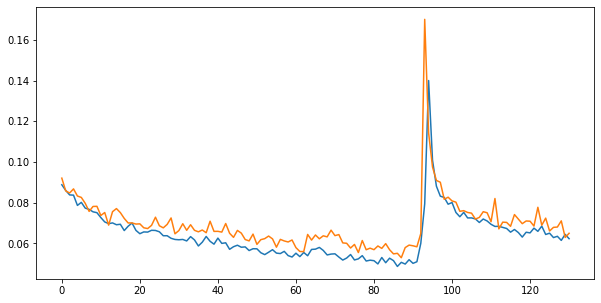

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0671                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

140 of 192
TRAIN LOSS: 0.06193682747996516
VAL LOSS: 0.0638881300886472


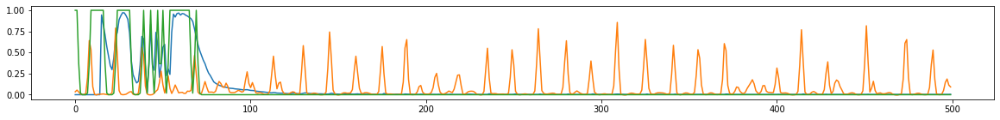

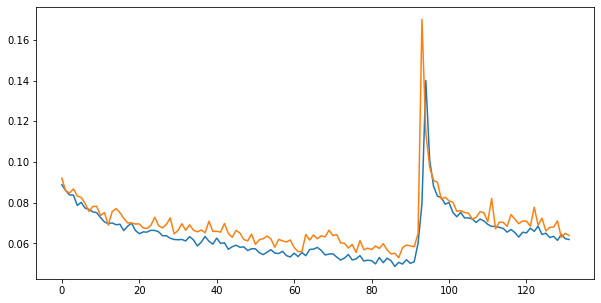

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0462                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

141 of 192
TRAIN LOSS: 0.06299534377952416
VAL LOSS: 0.0639091179602676


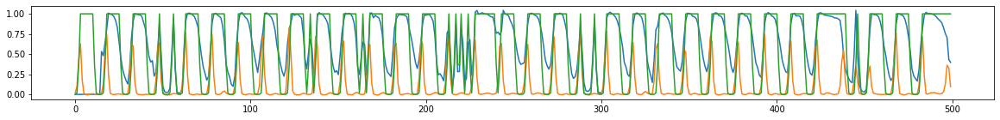

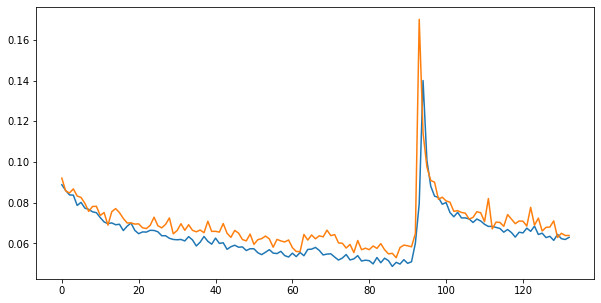

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0578                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

142 of 192
TRAIN LOSS: 0.06238248758018017
VAL LOSS: 0.06476007319158977


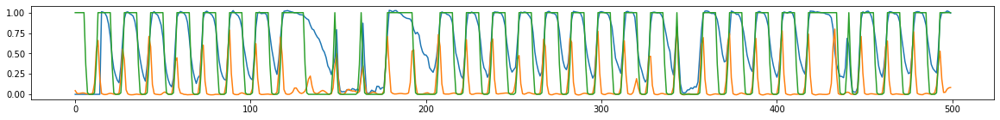

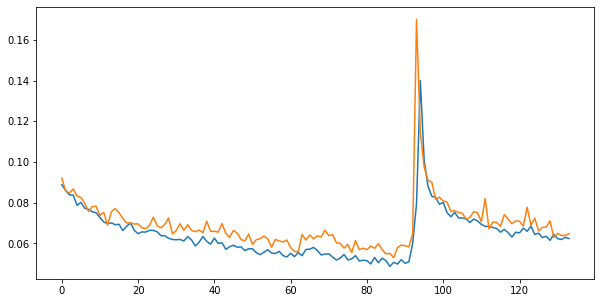

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0534                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

143 of 192
TRAIN LOSS: 0.06033872368021144
VAL LOSS: 0.06784173970421155


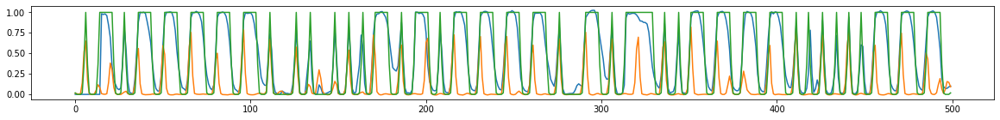

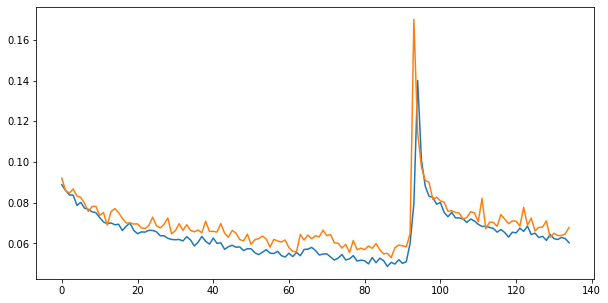

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0561                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

144 of 192
TRAIN LOSS: 0.06147207464608881
VAL LOSS: 0.06377397022313541


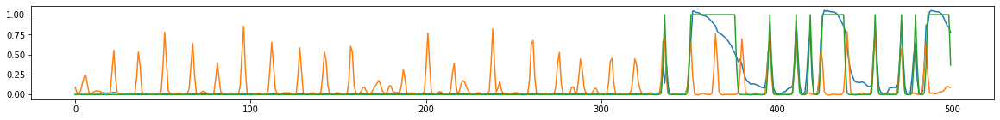

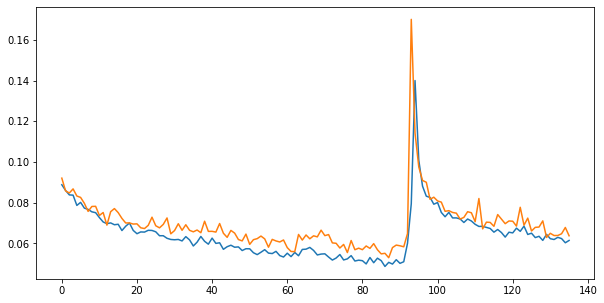

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0636                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

145 of 192
TRAIN LOSS: 0.05950580444186926
VAL LOSS: 0.06347238976094458


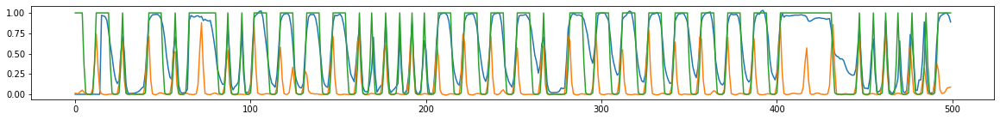

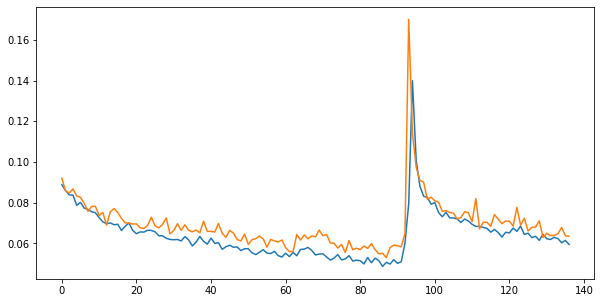

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0501                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

146 of 192
TRAIN LOSS: 0.06146579473796818
VAL LOSS: 0.064320743497875


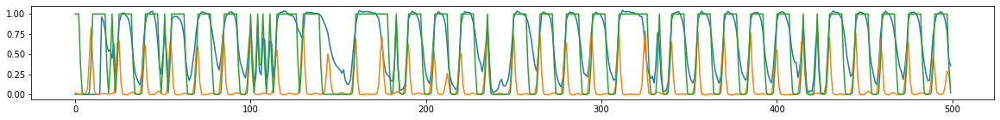

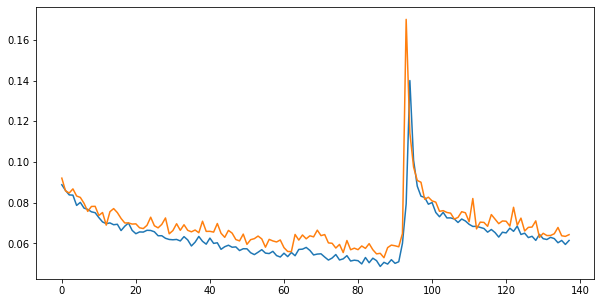

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0534                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

147 of 192
TRAIN LOSS: 0.06368620321154594
VAL LOSS: 0.0657480615708563


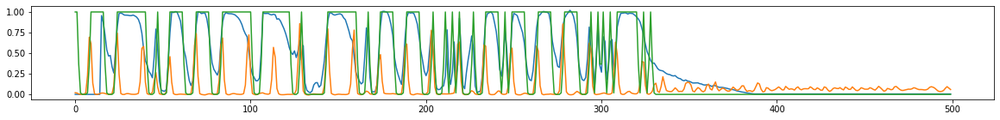

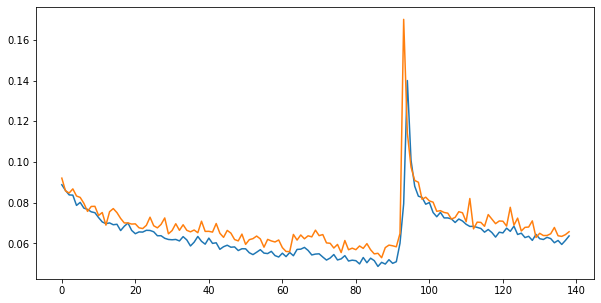

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0699                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

148 of 192
TRAIN LOSS: 0.06104329300837384
VAL LOSS: 0.06117578057779206


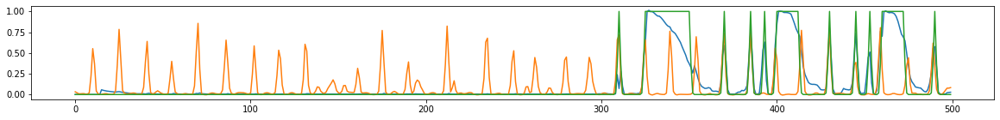

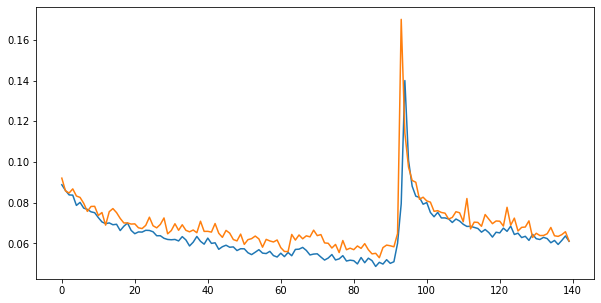

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0827                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

149 of 192
TRAIN LOSS: 0.061051633312470384
VAL LOSS: 0.067400806893905


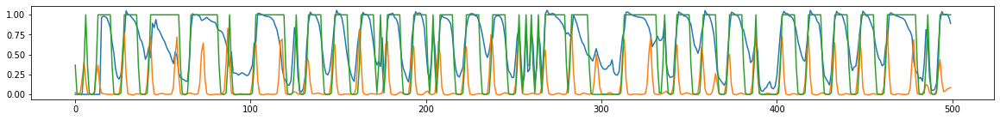

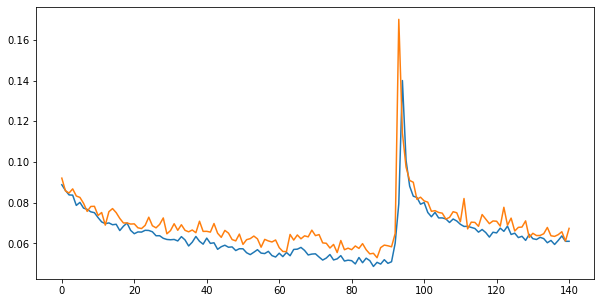

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0563                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

150 of 192
TRAIN LOSS: 0.06267865322944191
VAL LOSS: 0.06270762905478477


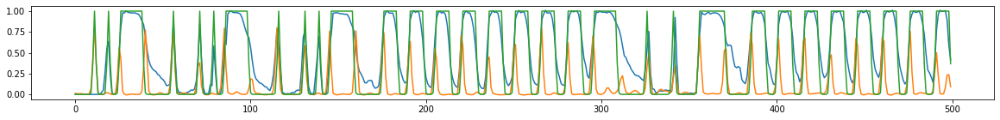

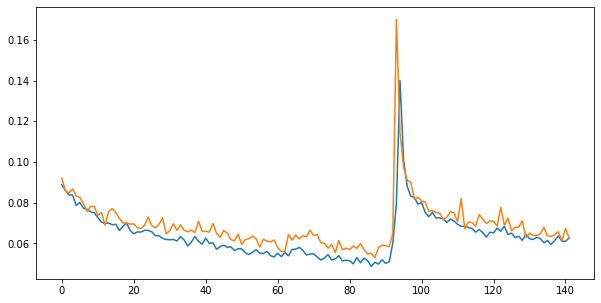

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0621                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

151 of 192
TRAIN LOSS: 0.05946520467599233
VAL LOSS: 0.06350208404991362


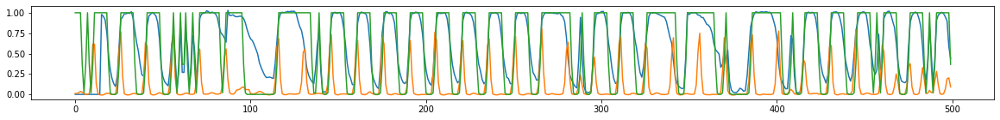

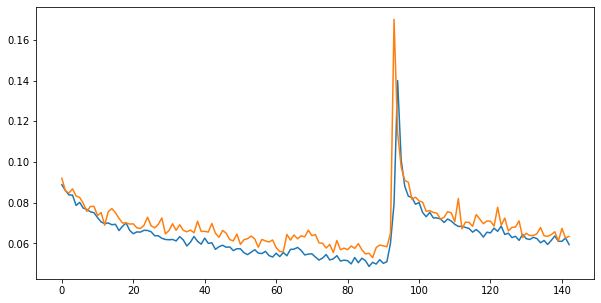

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0567                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

152 of 192
TRAIN LOSS: 0.06024765016304122
VAL LOSS: 0.06387233113249143


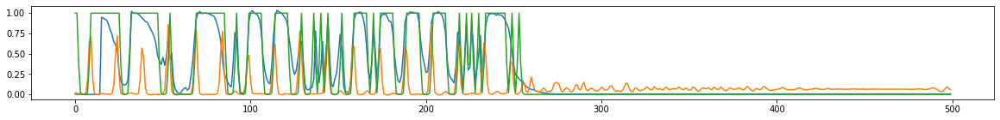

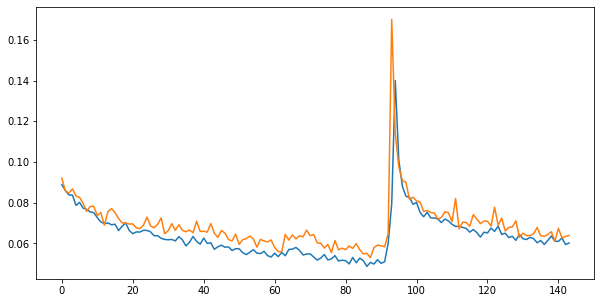

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0588                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

153 of 192
TRAIN LOSS: 0.0586180134365956
VAL LOSS: 0.06442989119225079


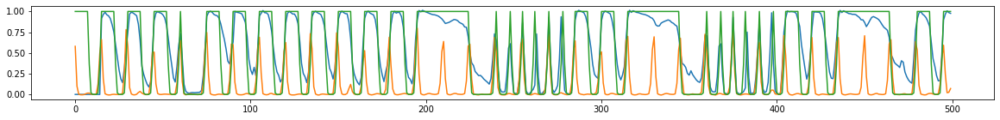

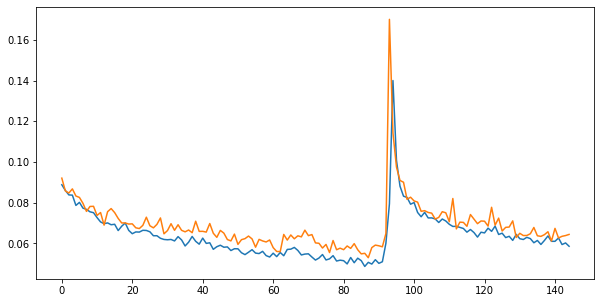

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0509                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

154 of 192
TRAIN LOSS: 0.05866166380130582
VAL LOSS: 0.06237348624401622


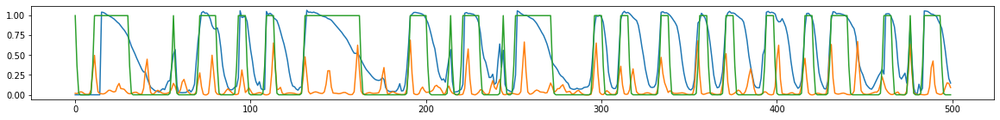

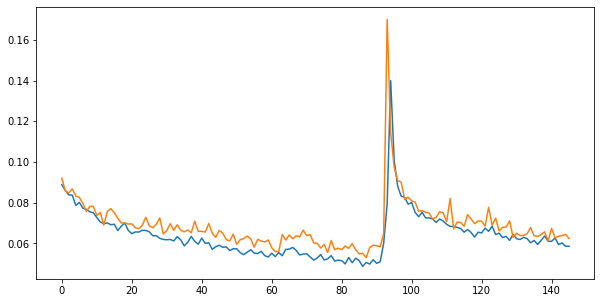

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0546                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

155 of 192
TRAIN LOSS: 0.05947011740257343
VAL LOSS: 0.06388364649481243


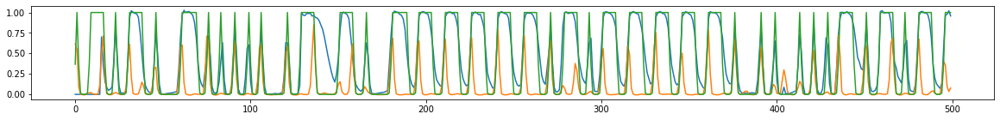

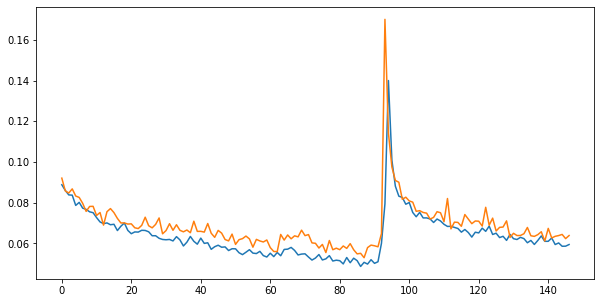

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0588                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

156 of 192
TRAIN LOSS: 0.05831856746226549
VAL LOSS: 0.0638253428041935


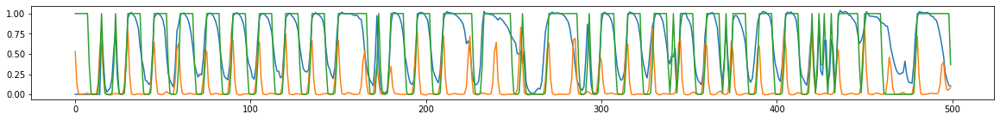

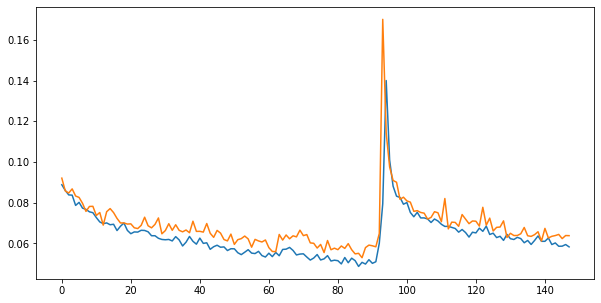

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0436                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

157 of 192
TRAIN LOSS: 0.05891222475717465
VAL LOSS: 0.06767613523536259


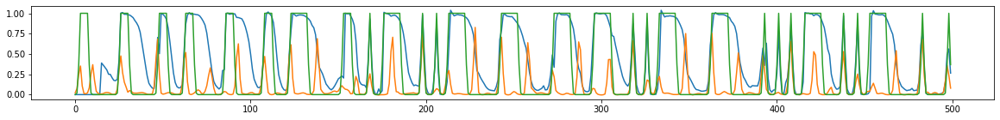

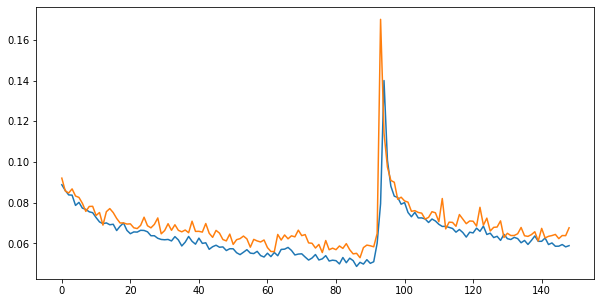

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0620                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

158 of 192
TRAIN LOSS: 0.05892567181338867
VAL LOSS: 0.06566231325268745


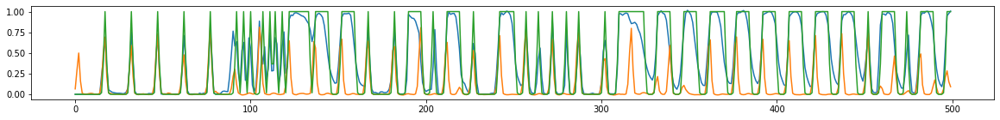

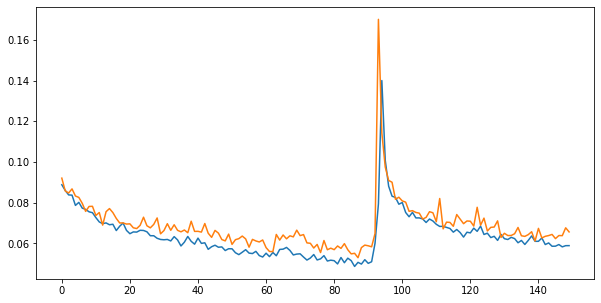

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0590                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

159 of 192
TRAIN LOSS: 0.056119925135539636
VAL LOSS: 0.05978237547808223


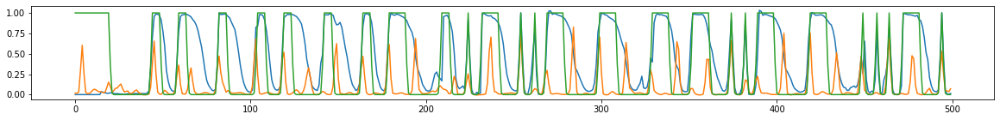

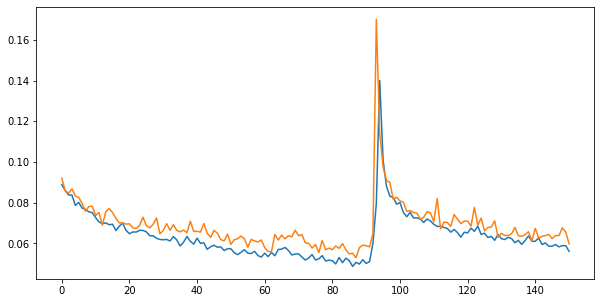

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0426                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

160 of 192
TRAIN LOSS: 0.05812263343897131
VAL LOSS: 0.06126662053995662


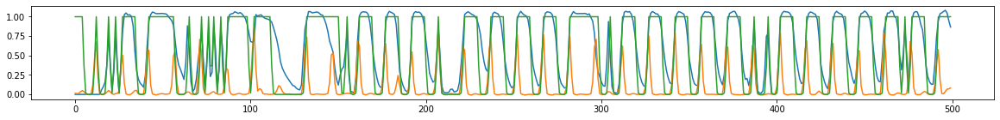

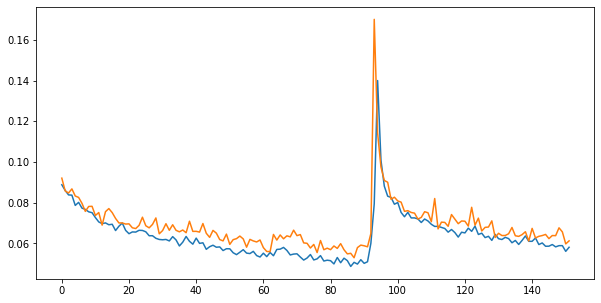

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0478                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

161 of 192
TRAIN LOSS: 0.05683985217991802
VAL LOSS: 0.06154724624421862


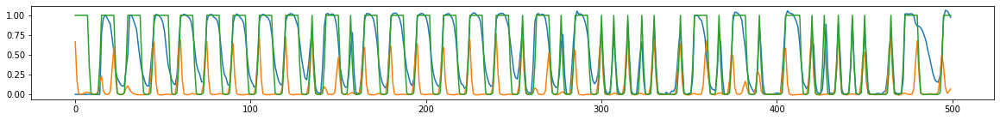

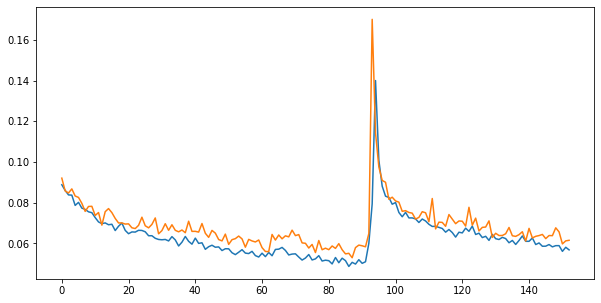

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0712                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

162 of 192
TRAIN LOSS: 0.05802025066481696
VAL LOSS: 0.06337616385685073


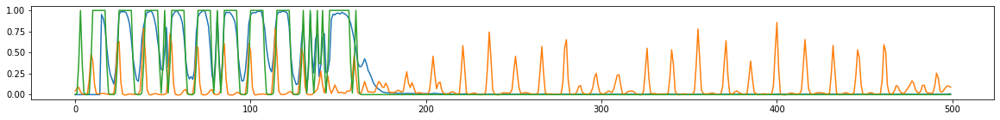

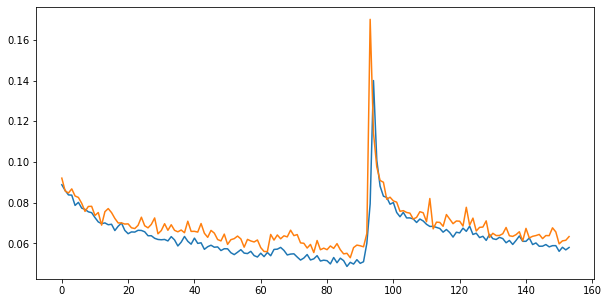

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0694                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

163 of 192
TRAIN LOSS: 0.057175253621406026
VAL LOSS: 0.06507319253351954


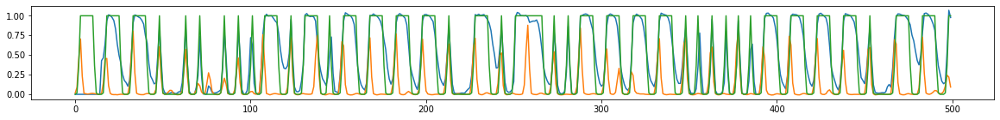

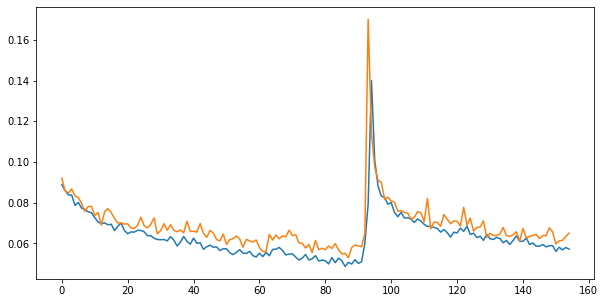

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0530                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

164 of 192
TRAIN LOSS: 0.05712596016625563
VAL LOSS: 0.0690619515048133


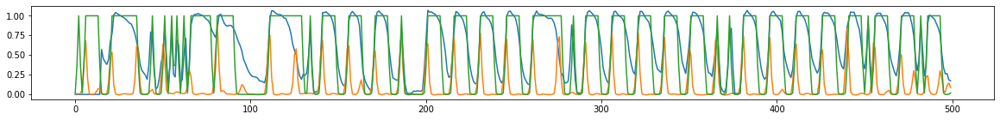

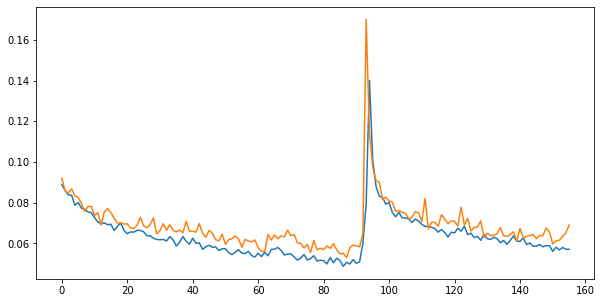

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0610                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

165 of 192
TRAIN LOSS: 0.05835292177895705
VAL LOSS: 0.06272783337367906


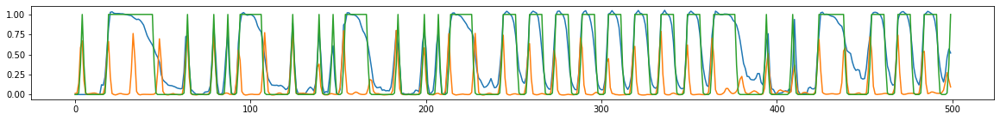

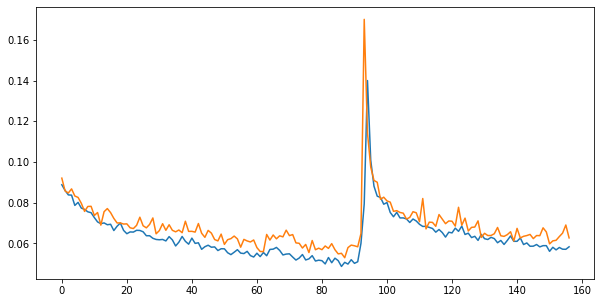

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0625                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

166 of 192
TRAIN LOSS: 0.056354585828052625
VAL LOSS: 0.06470883927411503


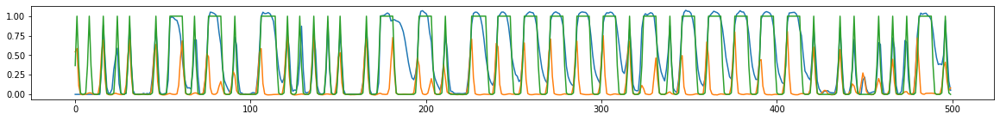

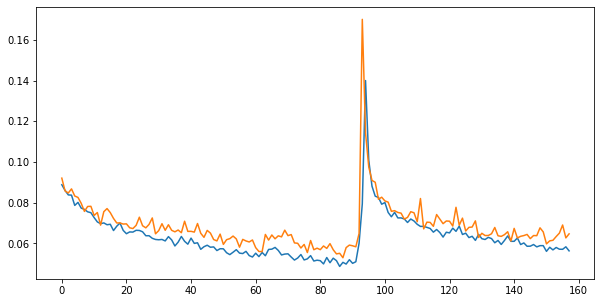

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0572                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

167 of 192
TRAIN LOSS: 0.05692456062469217
VAL LOSS: 0.061339936736557216


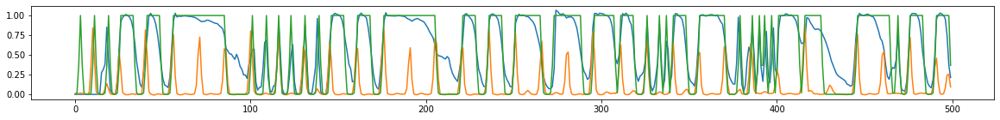

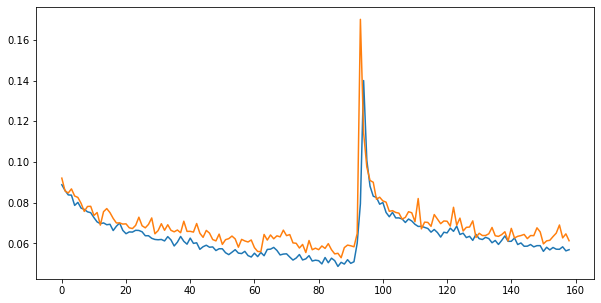

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0646                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

168 of 192
TRAIN LOSS: 0.05540890267325772
VAL LOSS: 0.05936278899510702


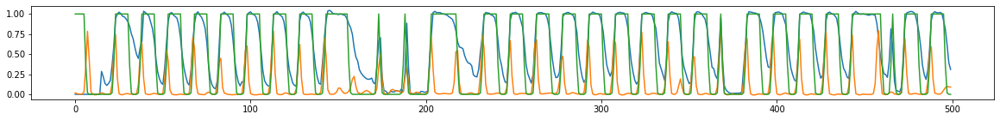

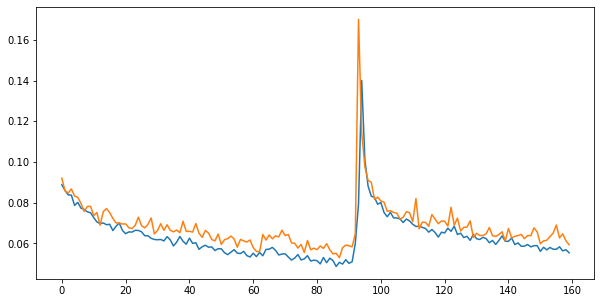

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0568                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

169 of 192
TRAIN LOSS: 0.05533363297581673
VAL LOSS: 0.0646828520629141


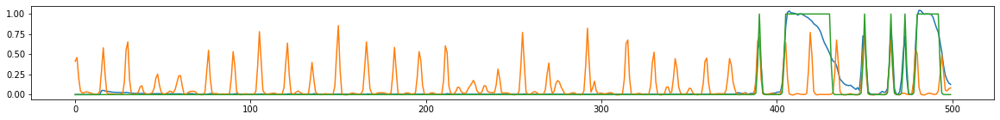

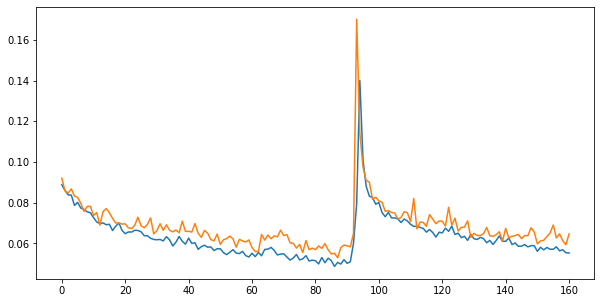

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0723                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

170 of 192
TRAIN LOSS: 0.054757383134629994
VAL LOSS: 0.0708201564848423


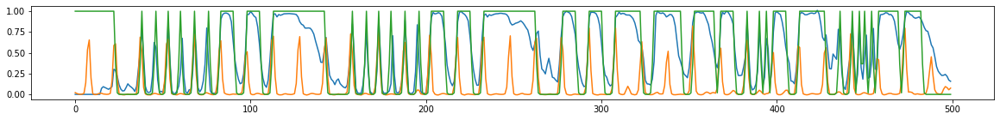

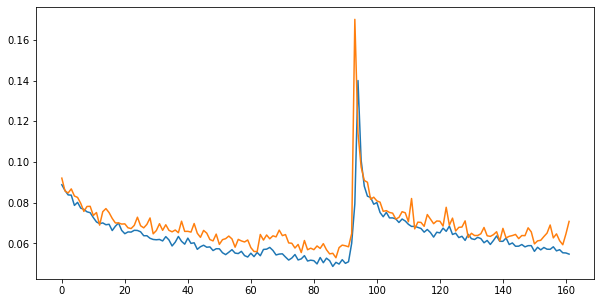

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0413                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

171 of 192
TRAIN LOSS: 0.06301888678636816
VAL LOSS: 0.06471983715891838


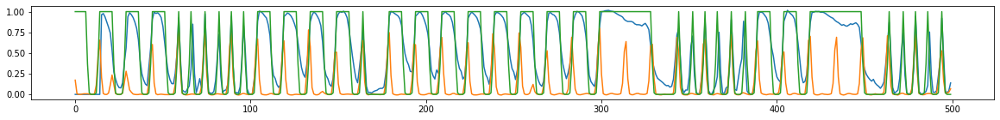

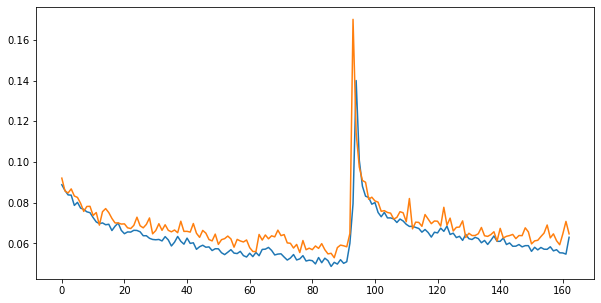

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0594                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

172 of 192
TRAIN LOSS: 0.05734250425464577
VAL LOSS: 0.06261044947637452


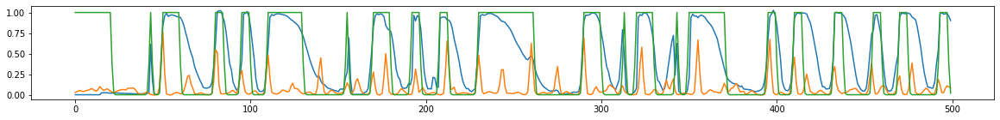

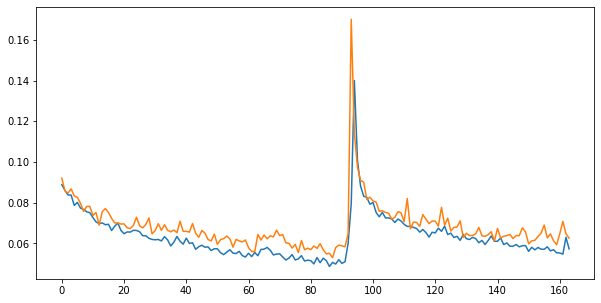

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0507                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

173 of 192
TRAIN LOSS: 0.0551745074076785
VAL LOSS: 0.05955155028237237


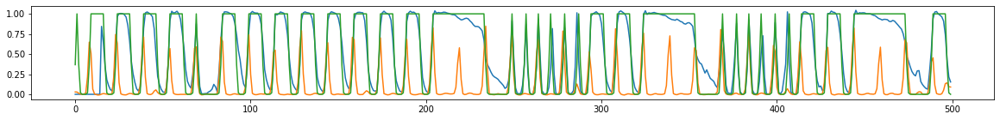

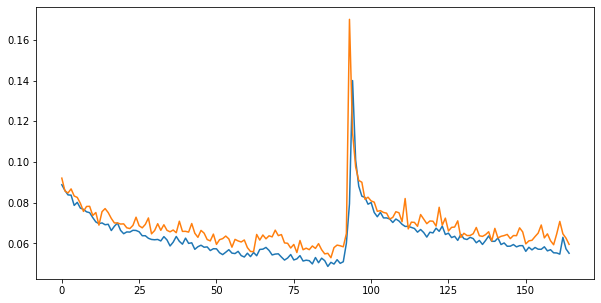

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0610                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

174 of 192
TRAIN LOSS: 0.05666923905826277
VAL LOSS: 0.058698229077789515


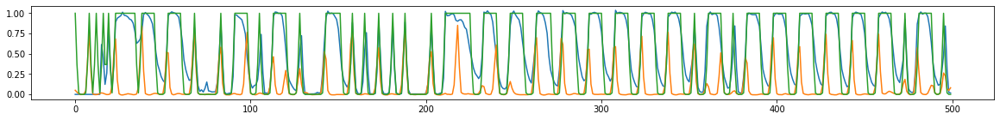

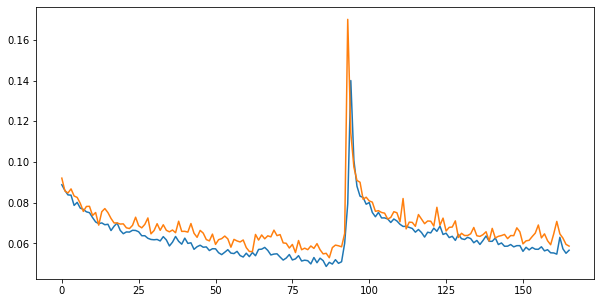

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0582                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

175 of 192
TRAIN LOSS: 0.054781778508590326
VAL LOSS: 0.061997420257992215


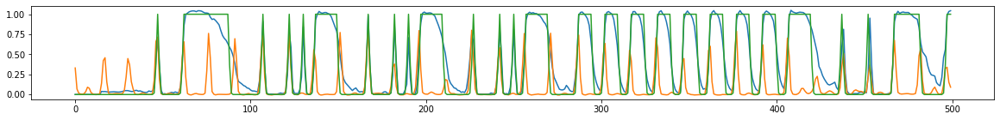

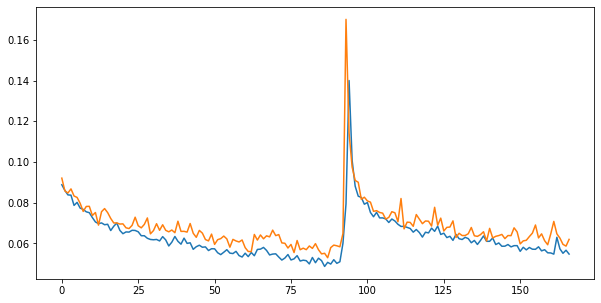

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0565                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

176 of 192
TRAIN LOSS: 0.054305358996821776
VAL LOSS: 0.05677458643913269


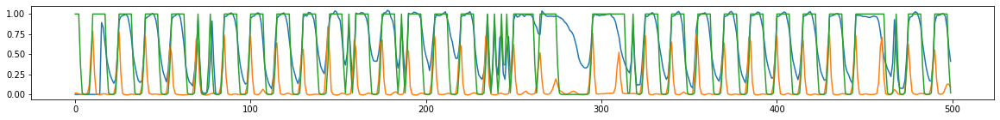

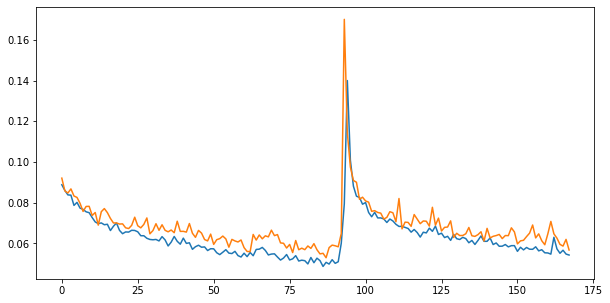

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0475                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

177 of 192
TRAIN LOSS: 0.05543351100964679
VAL LOSS: 0.05988686283429464


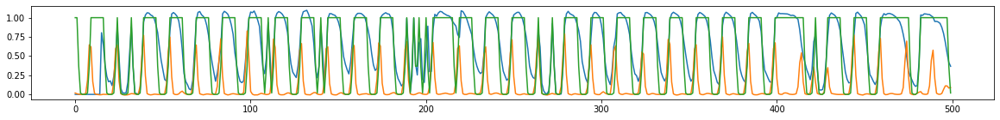

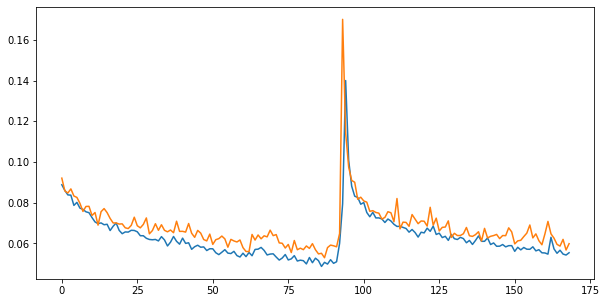

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0381                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

178 of 192
TRAIN LOSS: 0.055508057586848736
VAL LOSS: 0.0575501566959752


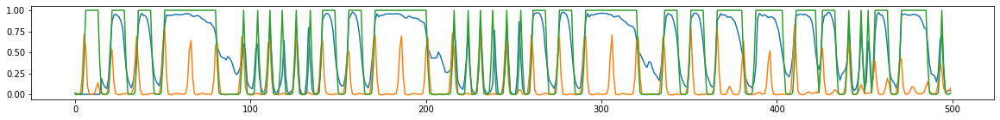

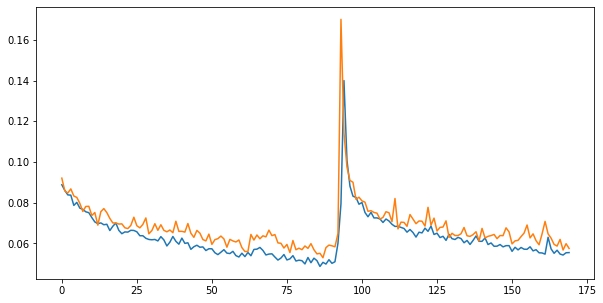

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0629                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

179 of 192
TRAIN LOSS: 0.05567884621106916
VAL LOSS: 0.05943552487426334


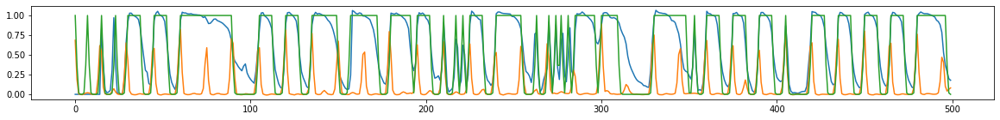

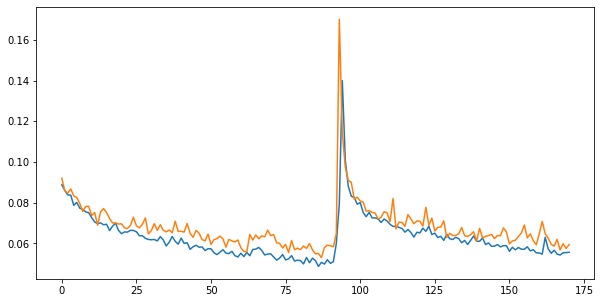

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0544                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

180 of 192
TRAIN LOSS: 0.053636409238808684
VAL LOSS: 0.062144080797831215


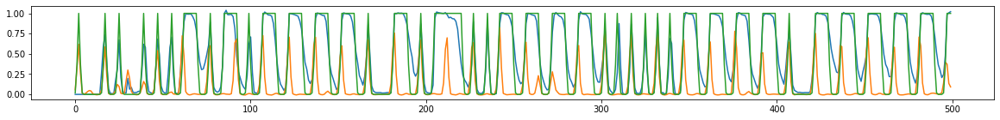

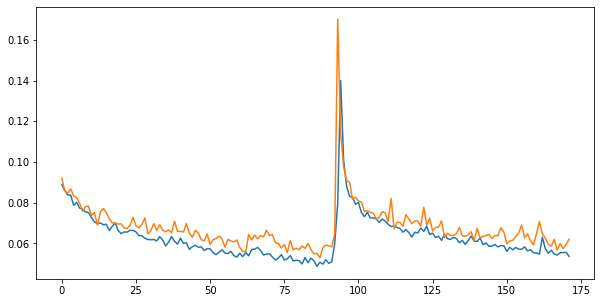

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0458                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

181 of 192
TRAIN LOSS: 0.05417366005066368
VAL LOSS: 0.056882946441570915


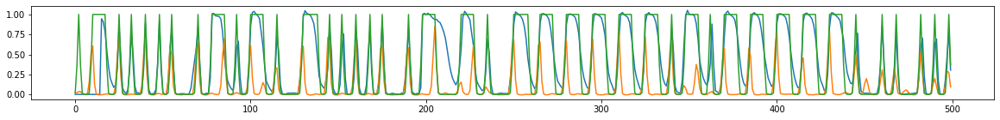

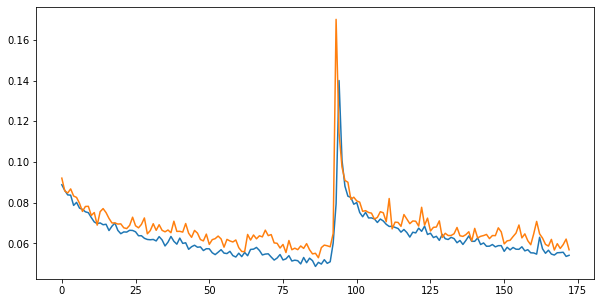

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0530                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

182 of 192
TRAIN LOSS: 0.0550603401950664
VAL LOSS: 0.0645004076262315


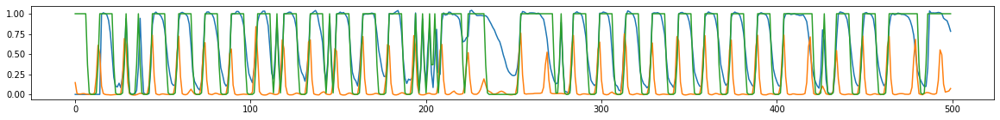

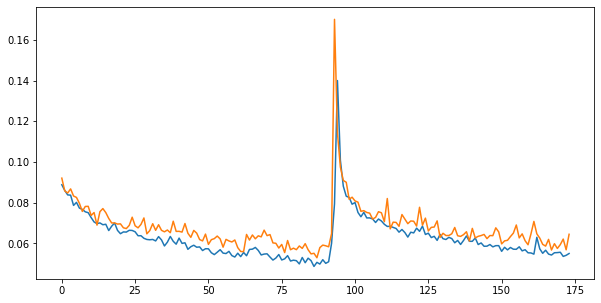

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0617                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

183 of 192
TRAIN LOSS: 0.05473080173962646
VAL LOSS: 0.05956323320666949


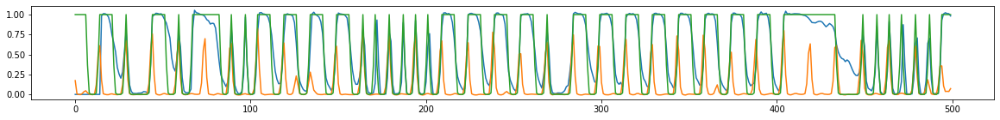

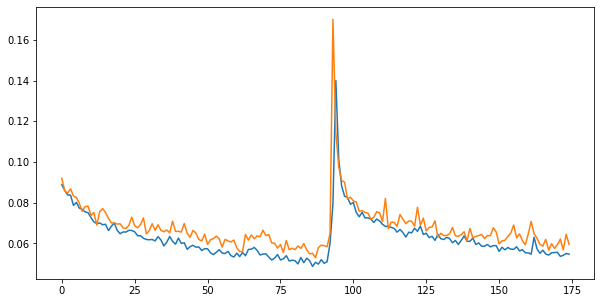

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0679                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

184 of 192
TRAIN LOSS: 0.05665730684995651
VAL LOSS: 0.057000628776020475


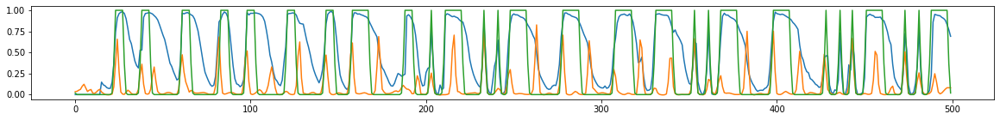

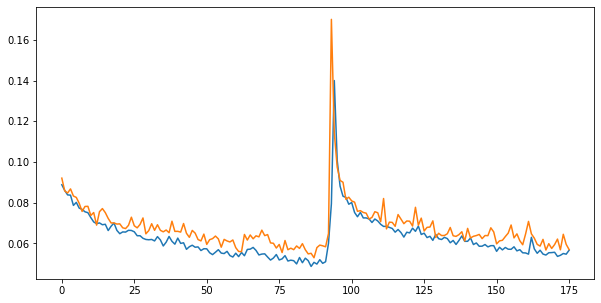

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0547                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

185 of 192
TRAIN LOSS: 0.05266533916195234
VAL LOSS: 0.05683379371960958


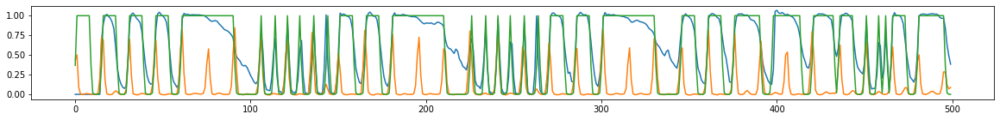

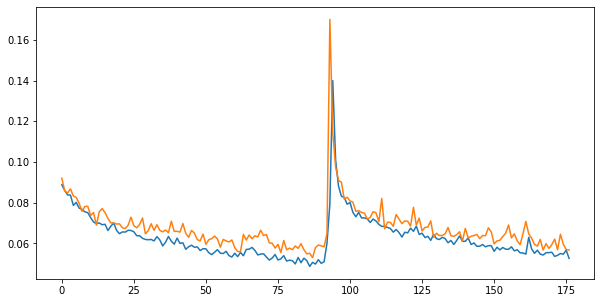

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0738                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

186 of 192
TRAIN LOSS: 0.05361857751591338
VAL LOSS: 0.05900164362457064


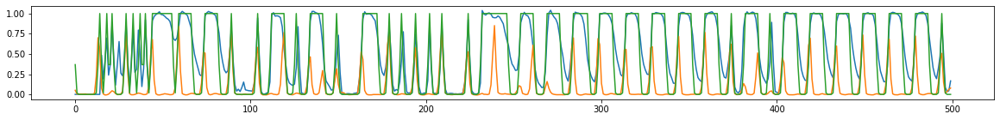

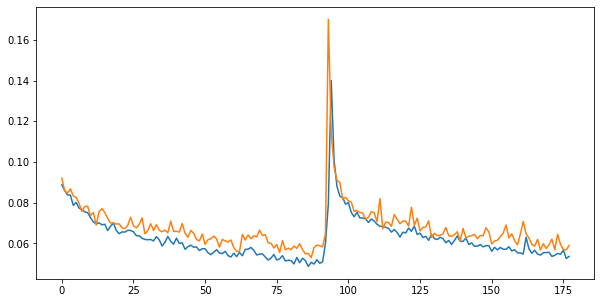

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0586                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

187 of 192
TRAIN LOSS: 0.053004791028797626
VAL LOSS: 0.0567372085319625


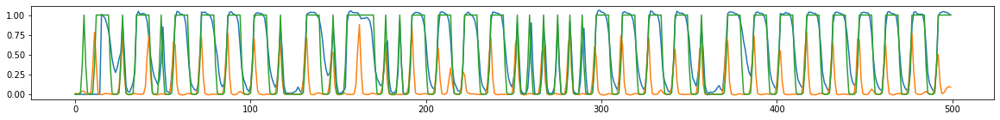

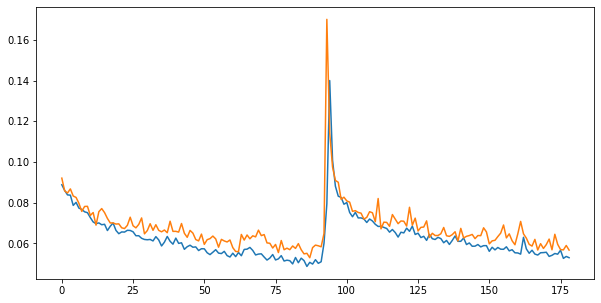

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0585                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

188 of 192
TRAIN LOSS: 0.05307125155296591
VAL LOSS: 0.05906073210967912


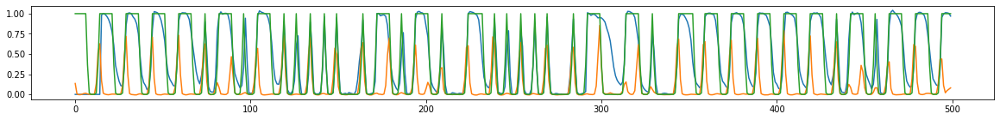

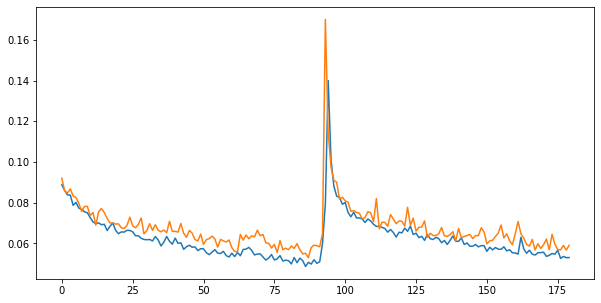

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0394                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

189 of 192
TRAIN LOSS: 0.05299085865004195
VAL LOSS: 0.0558760269648499


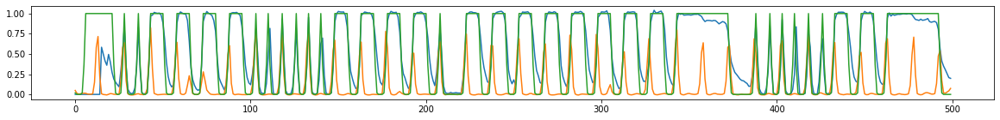

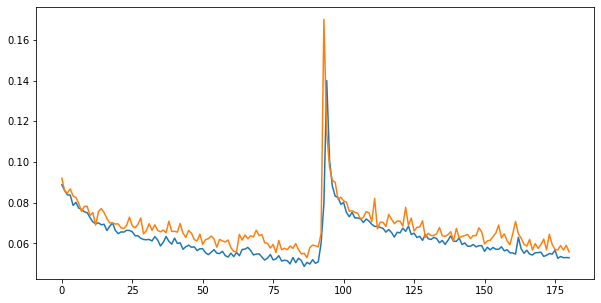

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0562                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

190 of 192
TRAIN LOSS: 0.05033986104859246
VAL LOSS: 0.05925609336958991


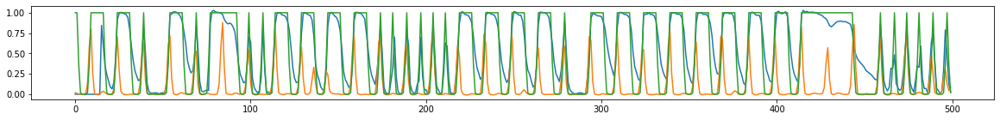

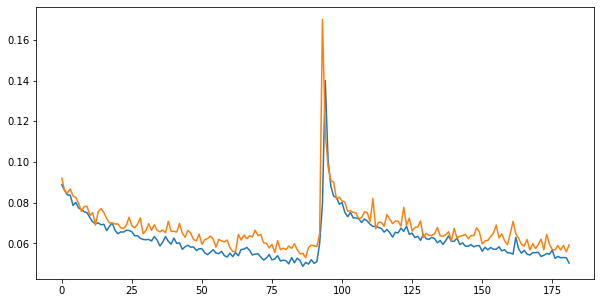

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0500                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

191 of 192
TRAIN LOSS: 0.05262765381485224
VAL LOSS: 0.059986437360445656


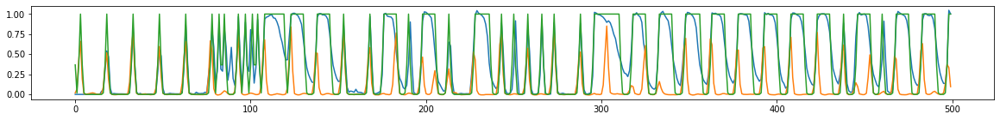

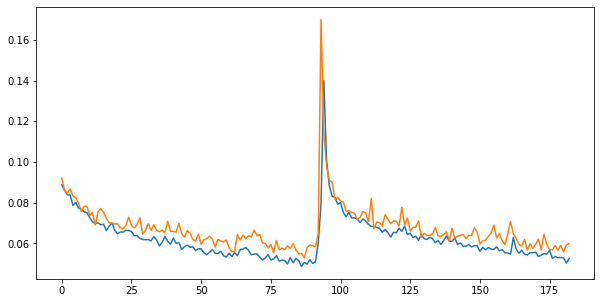

514.2688601016998 secs


In [81]:
start = time.time()

epochs = 64
trainHN()

end = time.time()
print(end - start, 'secs')

In [82]:
print(best_loss)
torch.save(best_weights, hn_model_path + str(epoch_cum) + '.pt')

0.05299028547273742


 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.92it/s  0.0580                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

192 of 256
TRAIN LOSS: 0.052820592704746455
VAL LOSS: 0.05656498587793774


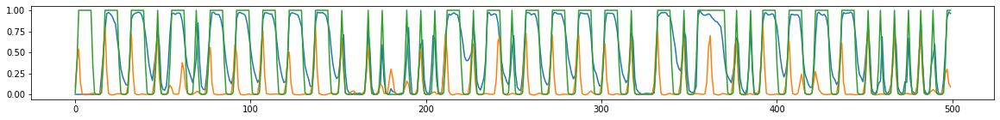

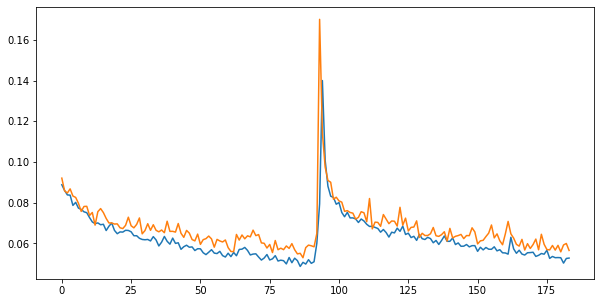

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.95it/s  0.0369                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

193 of 256
TRAIN LOSS: 0.053576517229278885
VAL LOSS: 0.06368336164289051


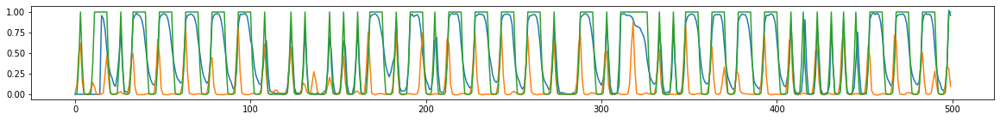

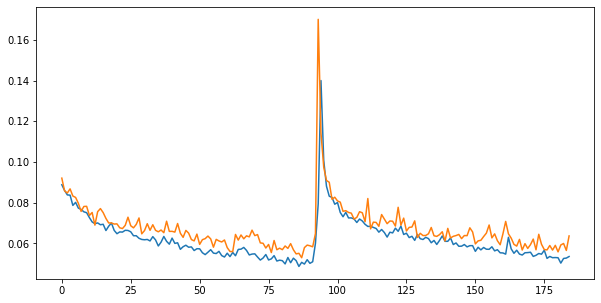

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.94it/s  0.0472                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

194 of 256
TRAIN LOSS: 0.054184315622680716
VAL LOSS: 0.06098971226149135


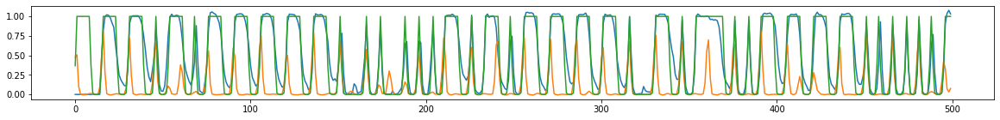

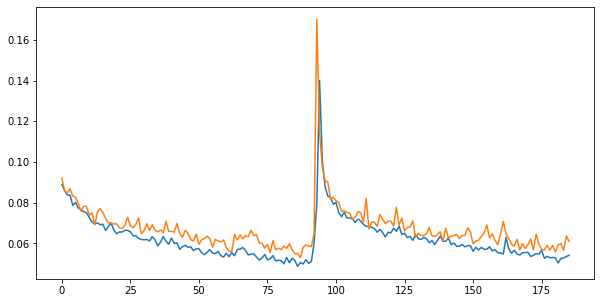

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.93it/s  0.0377                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

195 of 256
TRAIN LOSS: 0.051159333955082625
VAL LOSS: 0.05698075518012047


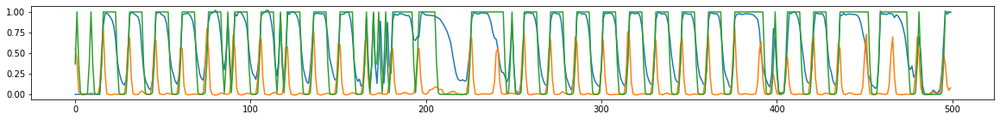

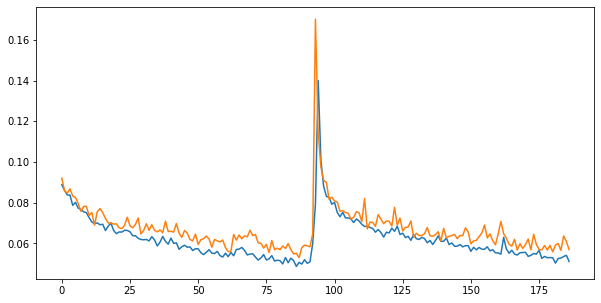

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.92it/s  0.0453                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

196 of 256
TRAIN LOSS: 0.05218318115091986
VAL LOSS: 0.05764026567339897


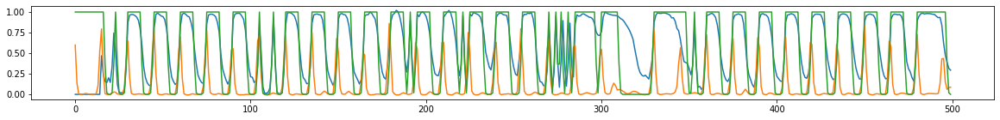

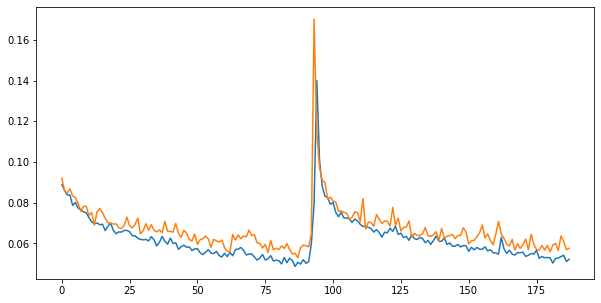

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.91it/s  0.0541                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

197 of 256
TRAIN LOSS: 0.052442155985368624
VAL LOSS: 0.05635360214445326


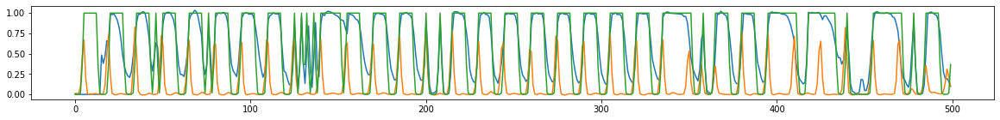

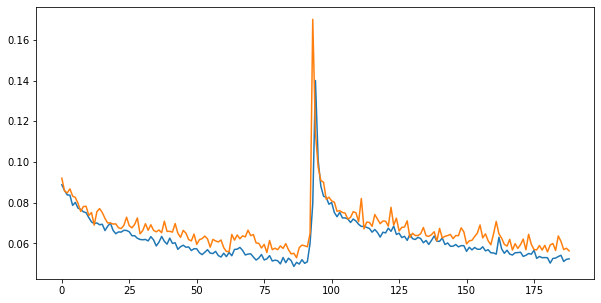

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.92it/s  0.0509                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

198 of 256
TRAIN LOSS: 0.05021234301643239
VAL LOSS: 0.060614256395234004


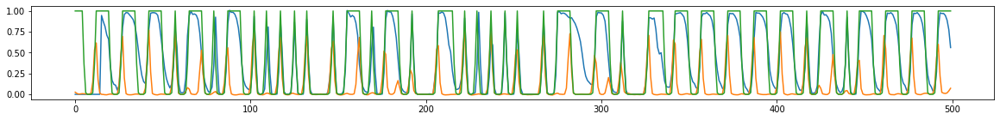

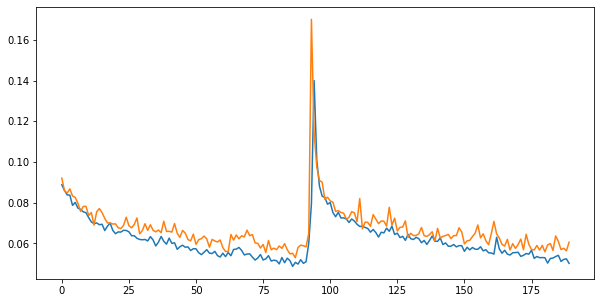

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.91it/s  0.0507                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

199 of 256
TRAIN LOSS: 0.05227187420758936
VAL LOSS: 0.05762873341639837


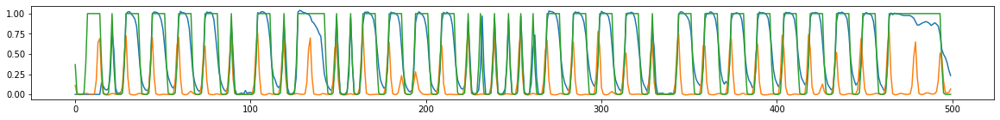

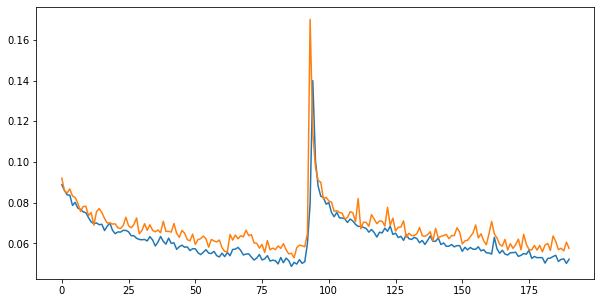

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.91it/s  0.0462                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

200 of 256
TRAIN LOSS: 0.049078775155875415
VAL LOSS: 0.05808856048517757


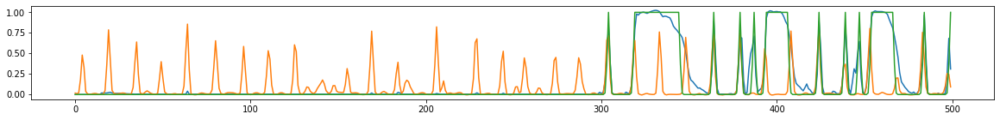

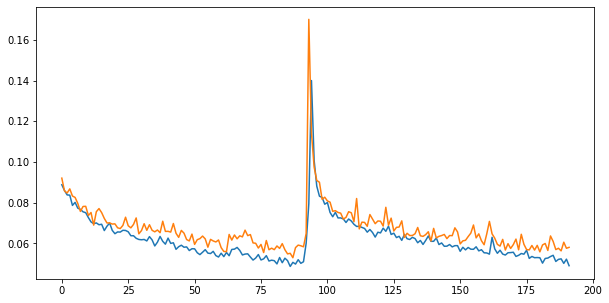

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.92it/s  0.0440                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

201 of 256
TRAIN LOSS: 0.05095845522979895
VAL LOSS: 0.05747656441397137


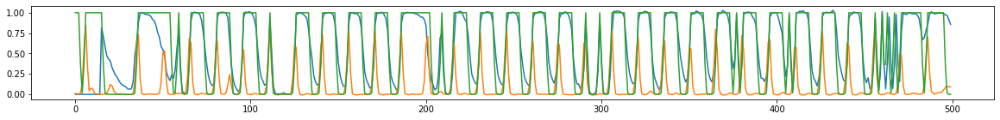

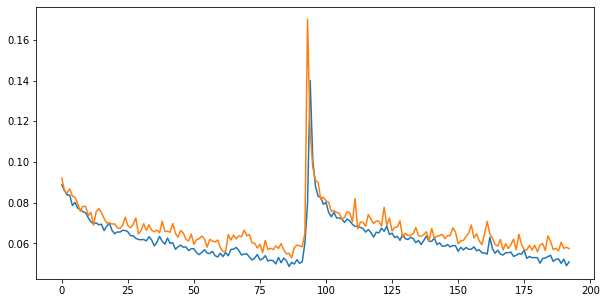

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0512                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

202 of 256
TRAIN LOSS: 0.05189747456461191
VAL LOSS: 0.05743727087974548


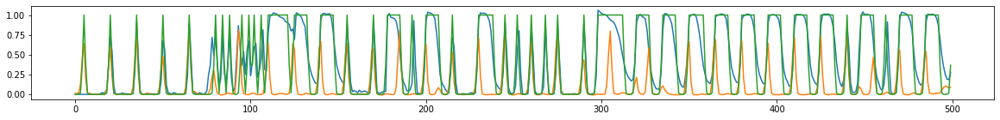

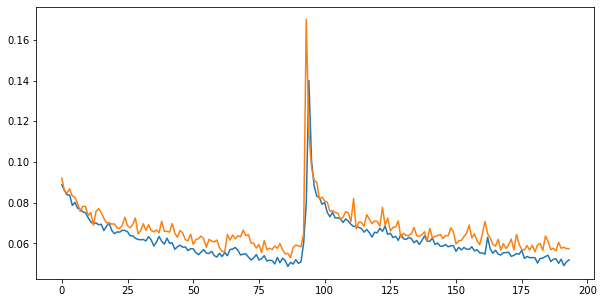

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0381                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

203 of 256
TRAIN LOSS: 0.05093423608276579
VAL LOSS: 0.056867015858491264


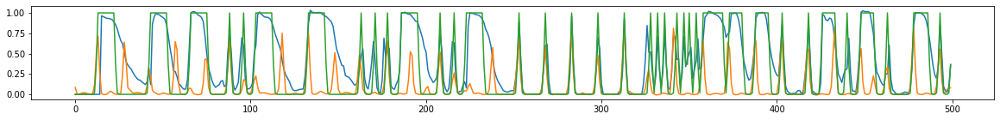

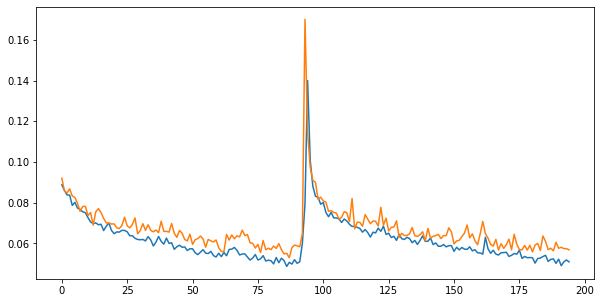

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0508                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

204 of 256
TRAIN LOSS: 0.05058796165717973
VAL LOSS: 0.06087743201189571


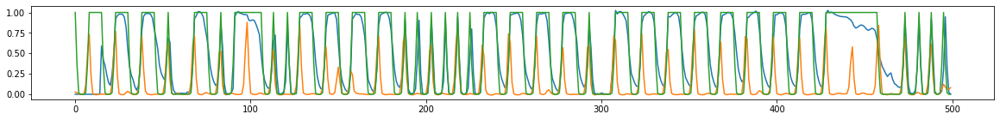

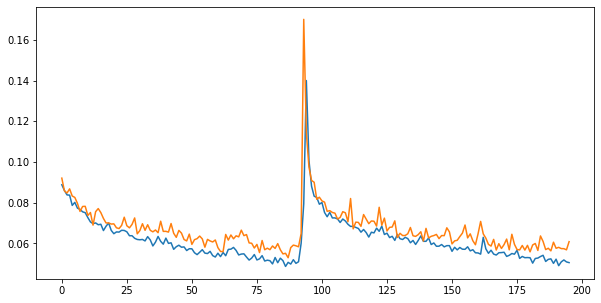

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0662                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

205 of 256
TRAIN LOSS: 0.05101827314744393
VAL LOSS: 0.05665105664067798


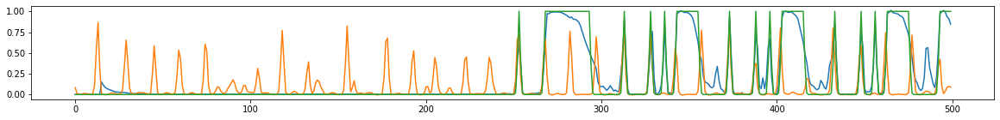

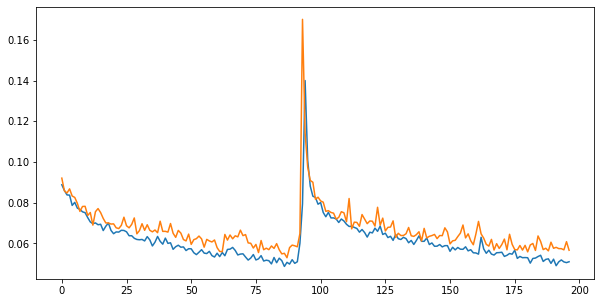

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0601                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

206 of 256
TRAIN LOSS: 0.053789079706701964
VAL LOSS: 0.0556528406838576


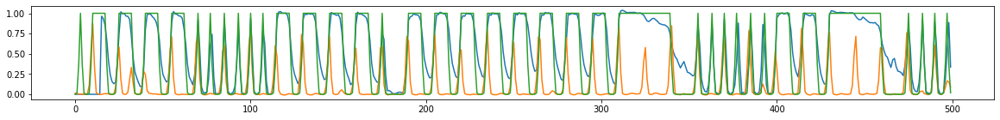

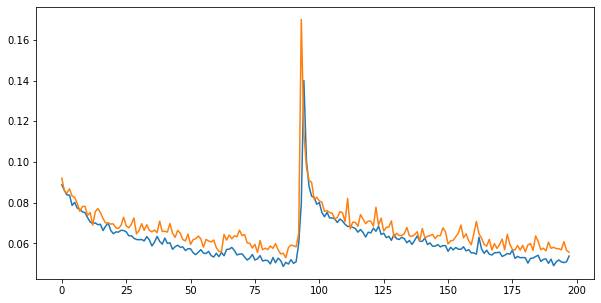

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0394                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

207 of 256
TRAIN LOSS: 0.052181424986985
VAL LOSS: 0.0589306615293026


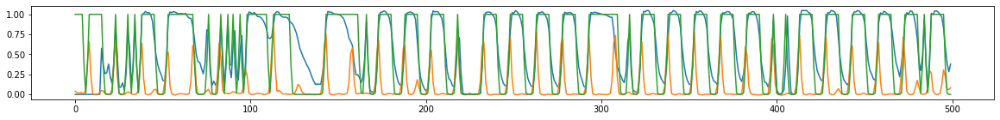

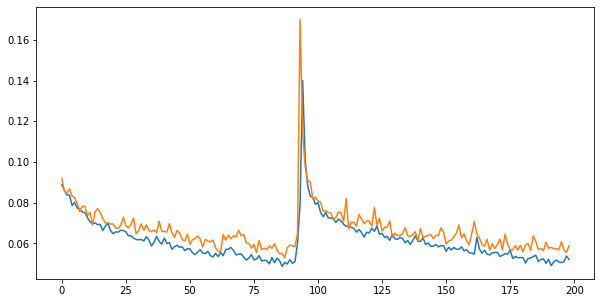

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0424                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

208 of 256
TRAIN LOSS: 0.05019499206294616
VAL LOSS: 0.058113613062434726


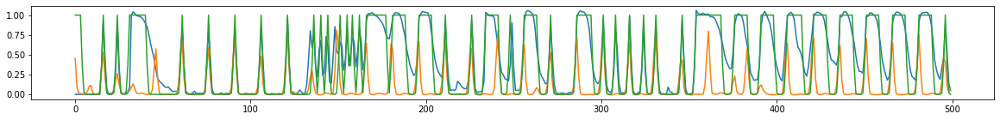

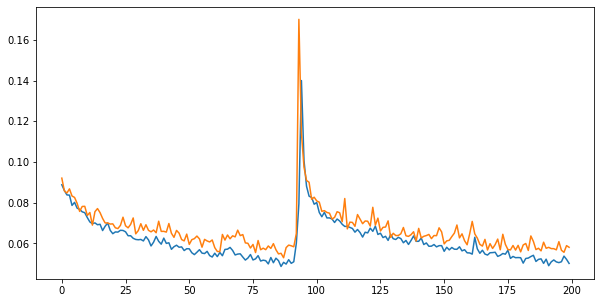

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0407                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

209 of 256
TRAIN LOSS: 0.052148646778530545
VAL LOSS: 0.05619816482067108


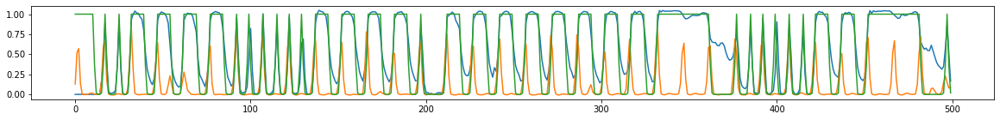

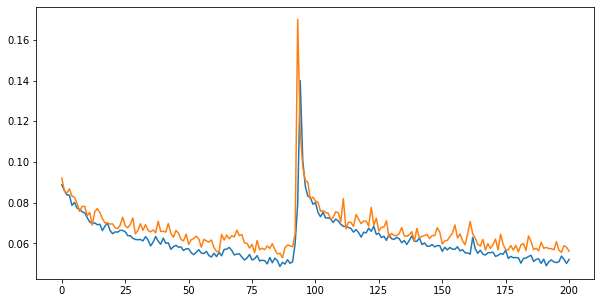

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0625                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

210 of 256
TRAIN LOSS: 0.05074298640506135
VAL LOSS: 0.05757967920766936


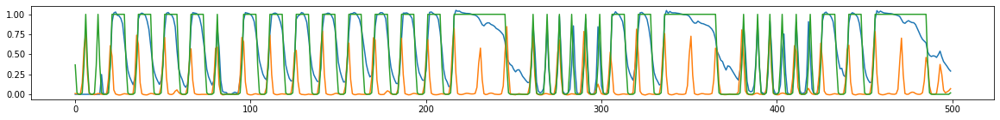

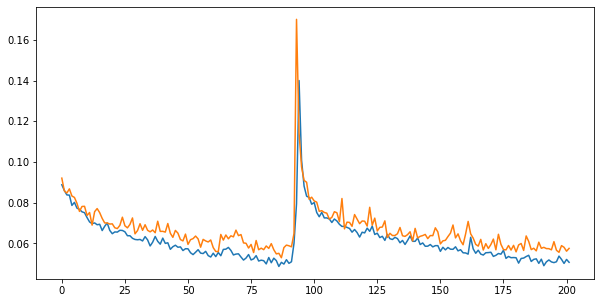

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0352                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

211 of 256
TRAIN LOSS: 0.04914408384097947
VAL LOSS: 0.05870314397745662


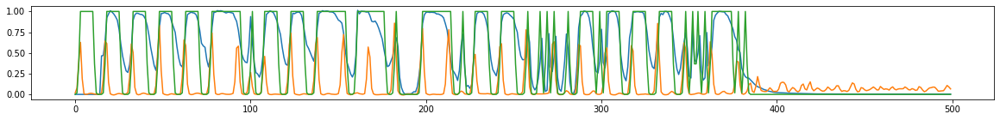

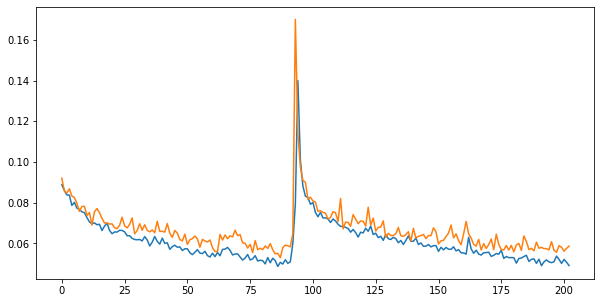

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0499                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

212 of 256
TRAIN LOSS: 0.04918873651574055
VAL LOSS: 0.05924296172128783


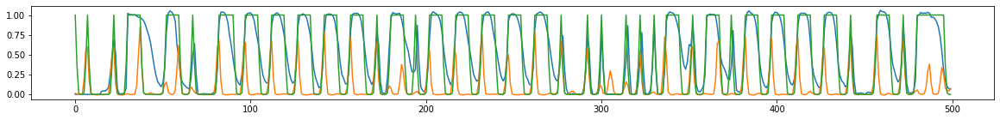

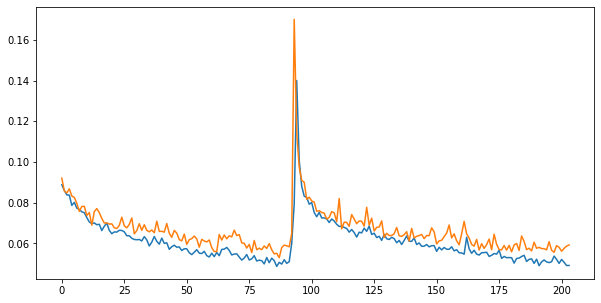

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0622                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

213 of 256
TRAIN LOSS: 0.051537853562169604
VAL LOSS: 0.05581020563840866


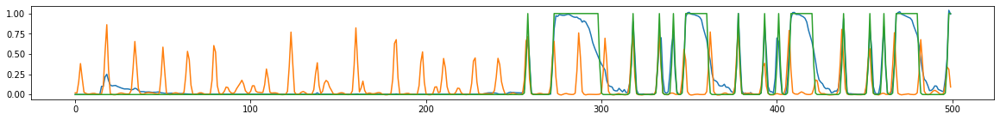

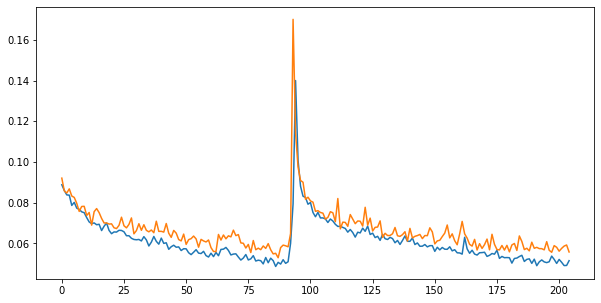

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0621                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

214 of 256
TRAIN LOSS: 0.05025165528059006
VAL LOSS: 0.052707688675986394


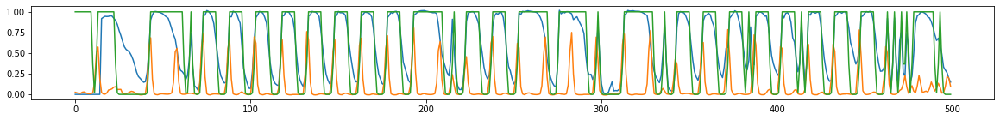

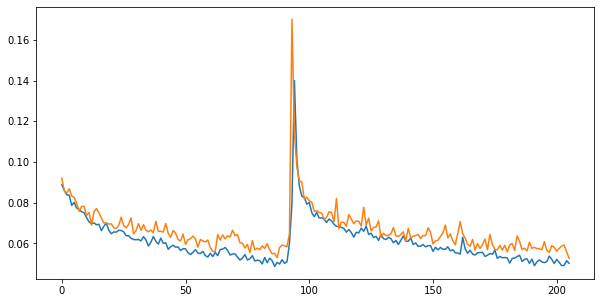

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0571                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

215 of 256
TRAIN LOSS: 0.05294963520848089
VAL LOSS: 0.05742156753937403


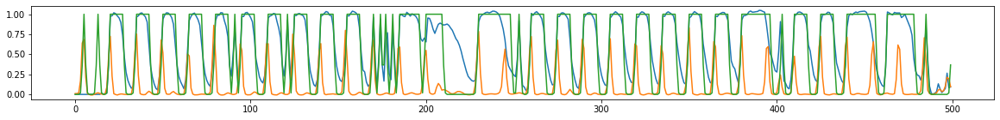

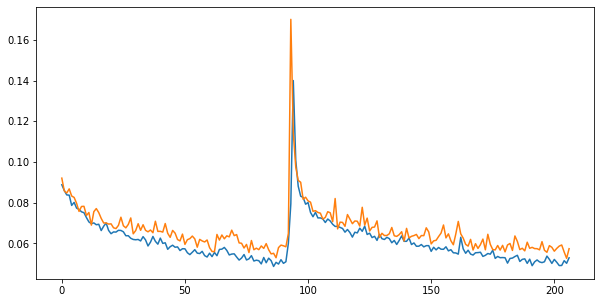

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0645                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

216 of 256
TRAIN LOSS: 0.05012328984836737
VAL LOSS: 0.054169654846191406


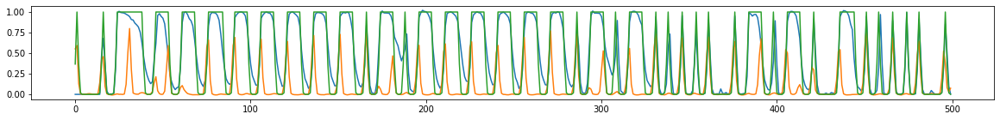

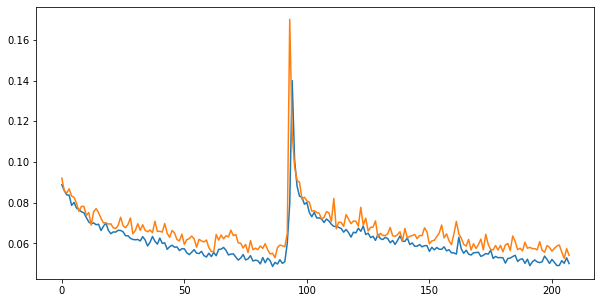

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0456                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

217 of 256
TRAIN LOSS: 0.04839038817832867
VAL LOSS: 0.056702394866281085


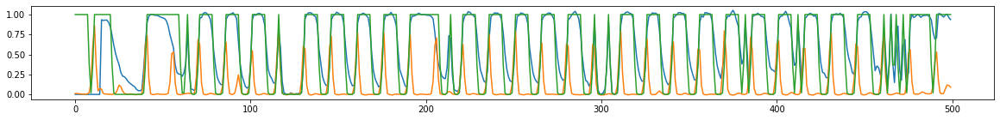

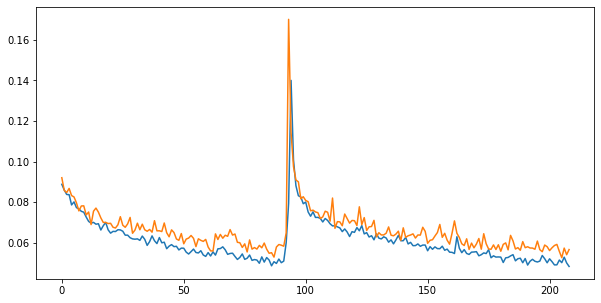

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0491                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

218 of 256
TRAIN LOSS: 0.04813991776771016
VAL LOSS: 0.05666701702608003


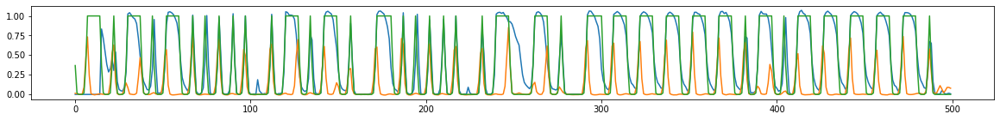

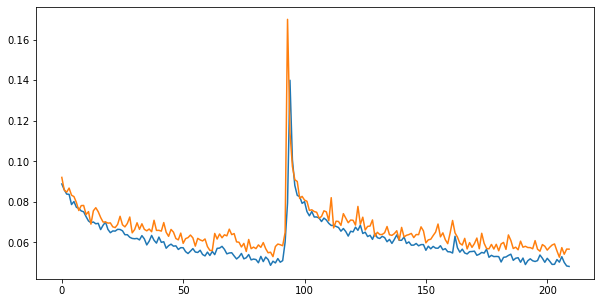

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0496                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

219 of 256
TRAIN LOSS: 0.06602961766637033
VAL LOSS: 0.0660258216990365


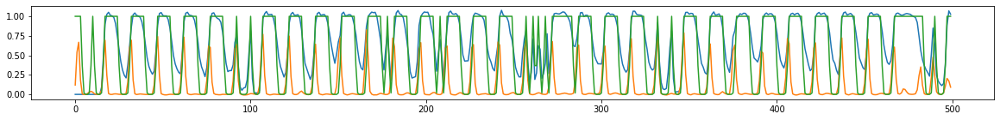

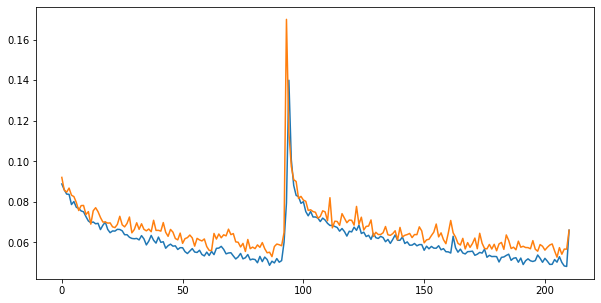

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0623                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

220 of 256
TRAIN LOSS: 0.05981921715041002
VAL LOSS: 0.062182566357983485


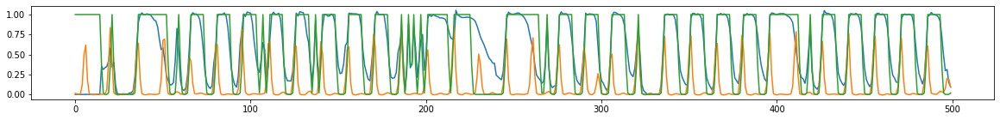

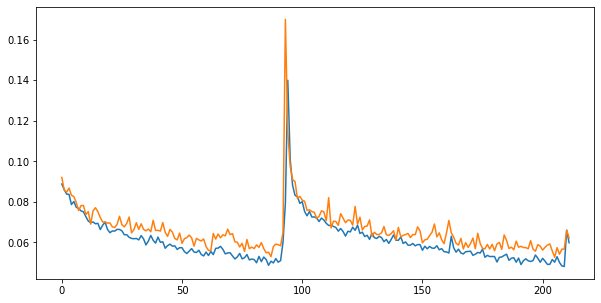

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0647                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

221 of 256
TRAIN LOSS: 0.059256389633648925
VAL LOSS: 0.06249171950750881


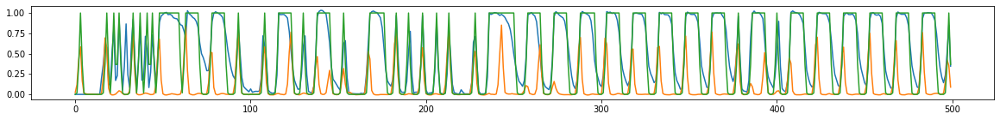

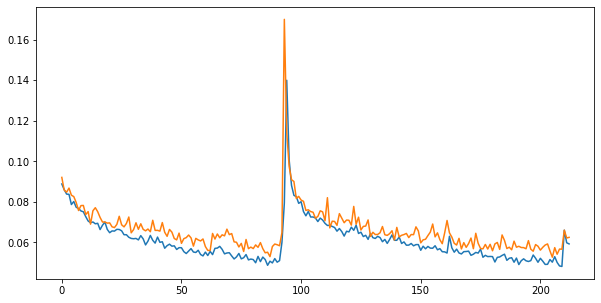

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0595                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

222 of 256
TRAIN LOSS: 0.054407506042884454
VAL LOSS: 0.06256707716319296


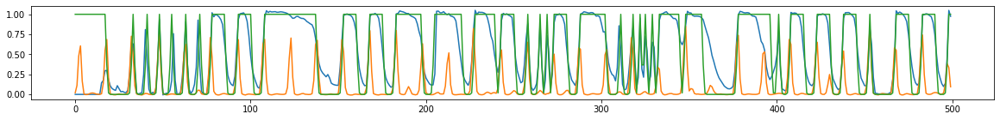

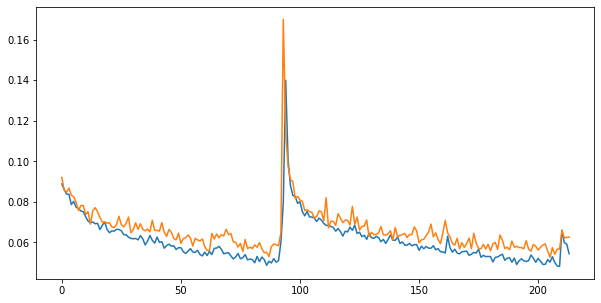

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0529                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

223 of 256
TRAIN LOSS: 0.05430720870693525
VAL LOSS: 0.05769666615459654


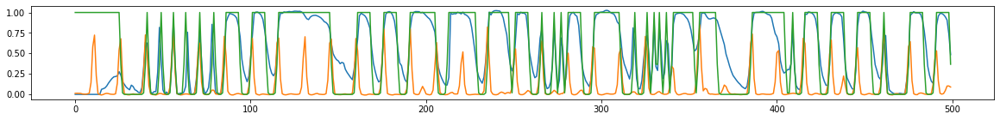

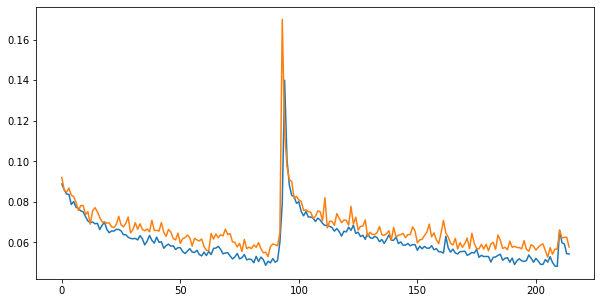

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0523                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

224 of 256
TRAIN LOSS: 0.05443842005398539
VAL LOSS: 0.05927711518274413


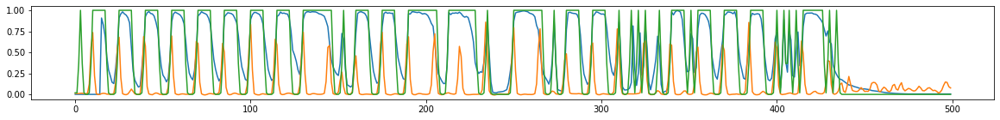

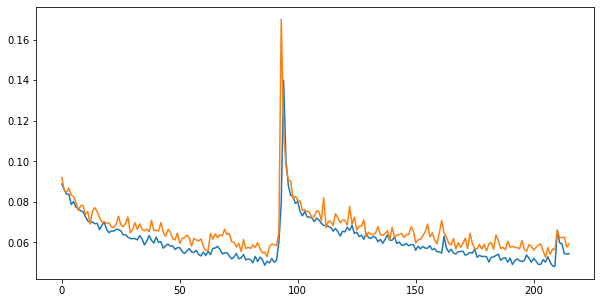

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0490                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

225 of 256
TRAIN LOSS: 0.05409219591981835
VAL LOSS: 0.06069654060734643


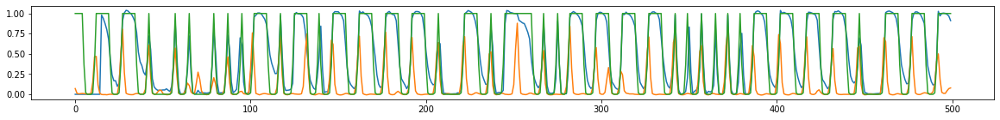

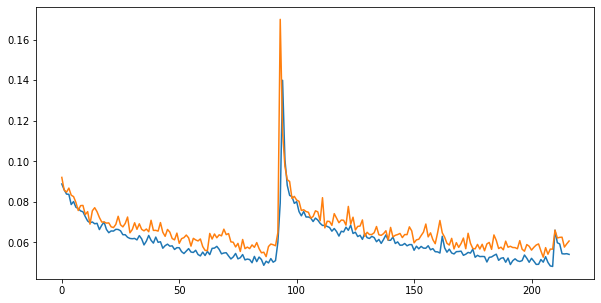

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0508                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

226 of 256
TRAIN LOSS: 0.05277440013984839
VAL LOSS: 0.05788067355751991


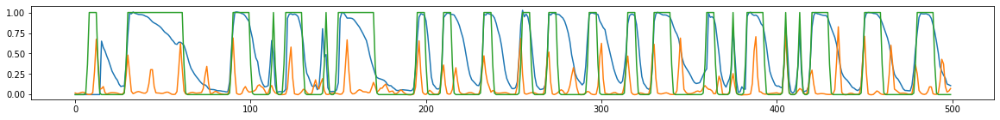

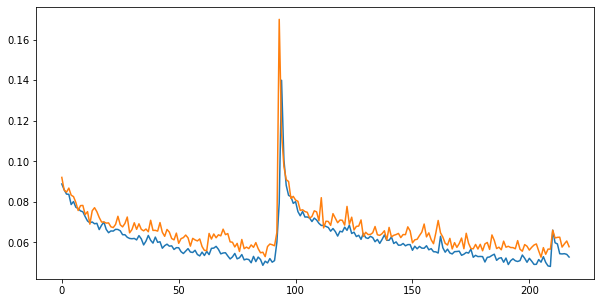

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0438                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

227 of 256
TRAIN LOSS: 0.05131620986180173
VAL LOSS: 0.06268204086356693


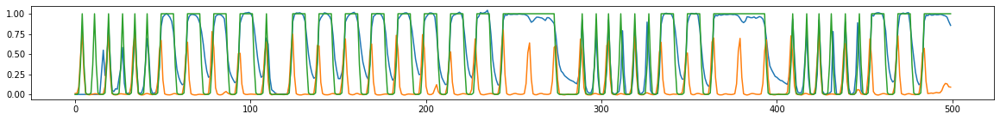

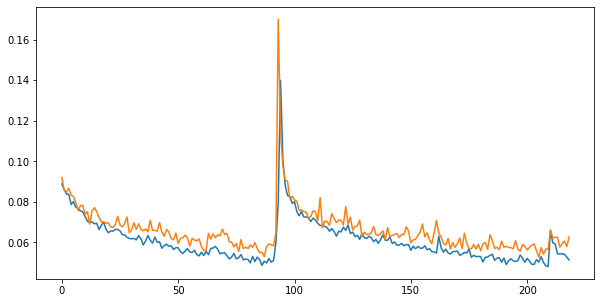

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0624                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

228 of 256
TRAIN LOSS: 0.052369658214350544
VAL LOSS: 0.05846567783090803


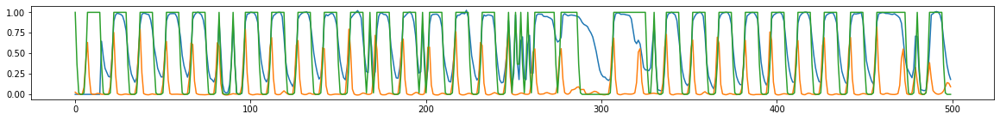

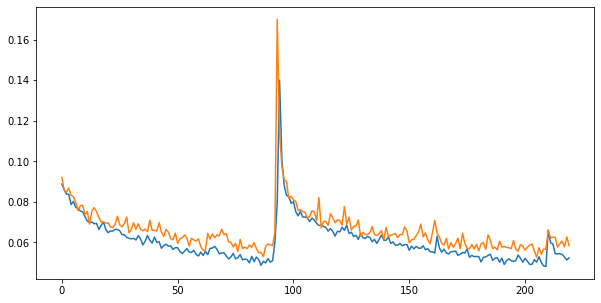

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0482                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

229 of 256
TRAIN LOSS: 0.05303661214808623
VAL LOSS: 0.05824648299150997


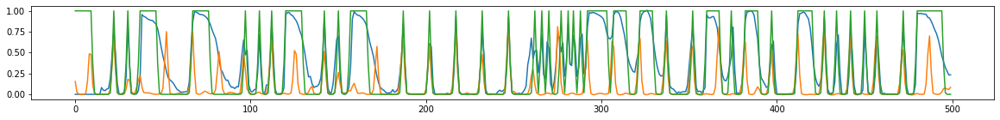

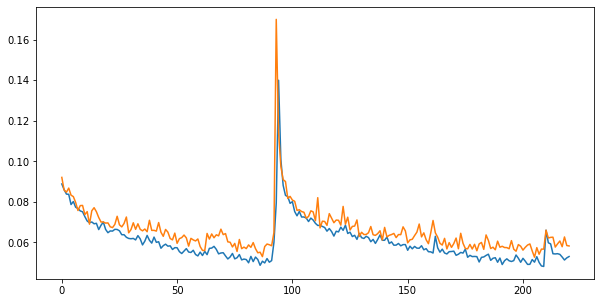

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0754                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

230 of 256
TRAIN LOSS: 0.05147111084726122
VAL LOSS: 0.06090722936722967


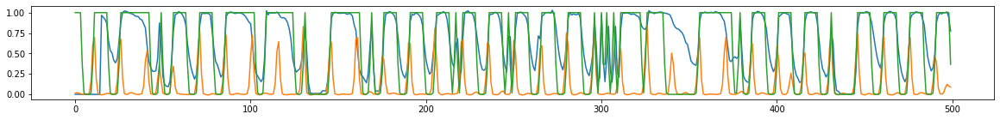

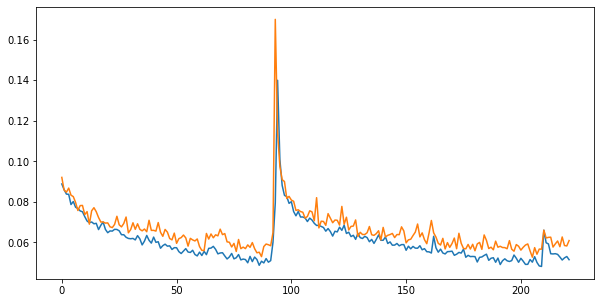

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0597                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

231 of 256
TRAIN LOSS: 0.050768155604600906
VAL LOSS: 0.05781630674997965


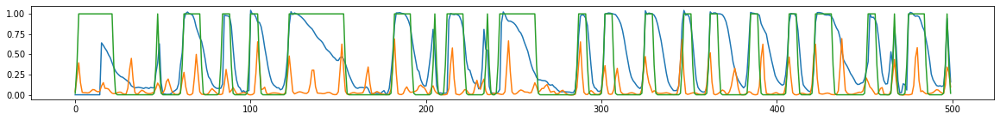

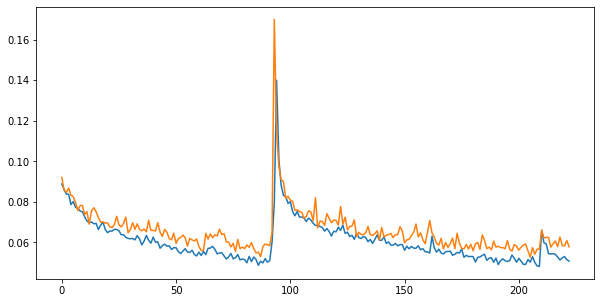

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0391                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

232 of 256
TRAIN LOSS: 0.05013551883813408
VAL LOSS: 0.05535900510019726


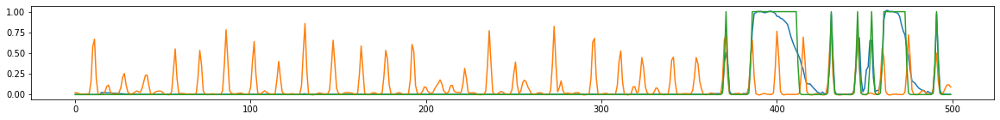

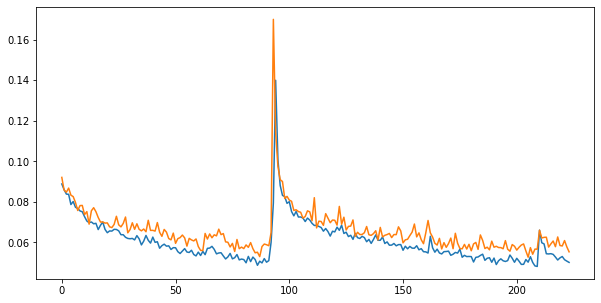

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0493                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

233 of 256
TRAIN LOSS: 0.051776634943154126
VAL LOSS: 0.05811892615424262


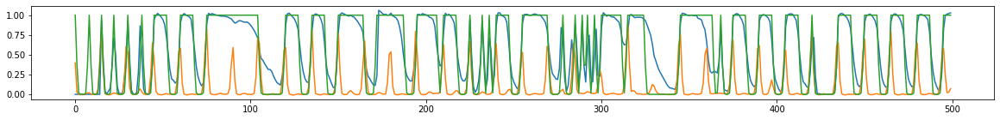

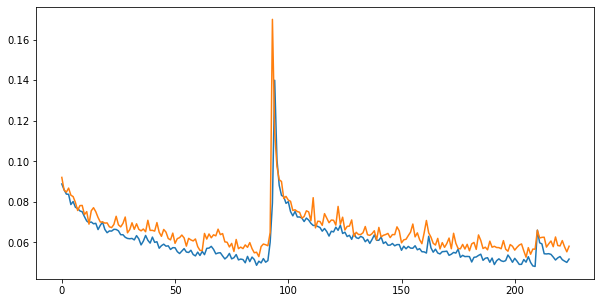

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0465                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

234 of 256
TRAIN LOSS: 0.05049476451757881
VAL LOSS: 0.05934534677200847


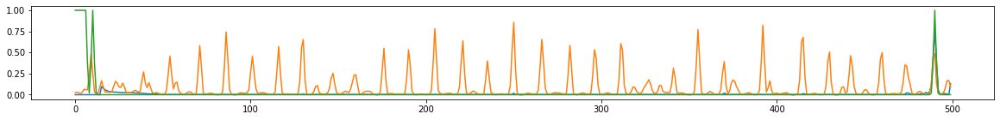

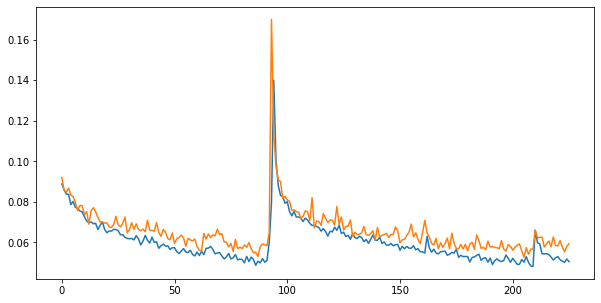

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0584                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

235 of 256
TRAIN LOSS: 0.05033249107913838
VAL LOSS: 0.06400080232156648


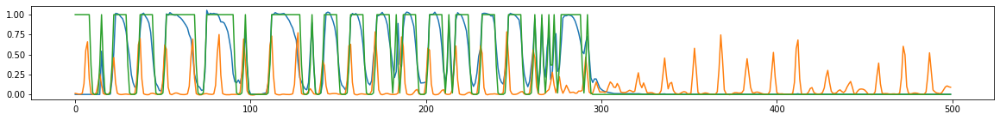

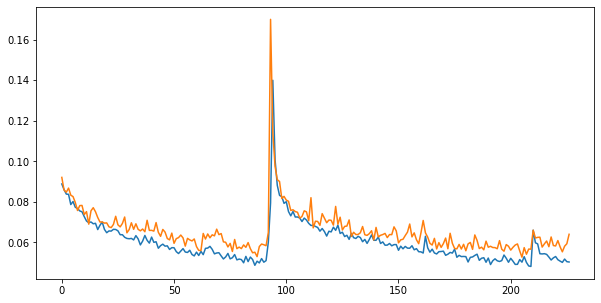

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0423                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

236 of 256
TRAIN LOSS: 0.05034896627896362
VAL LOSS: 0.05624037774072753


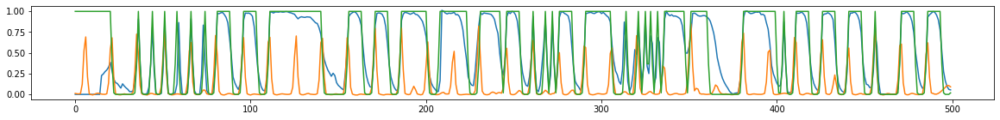

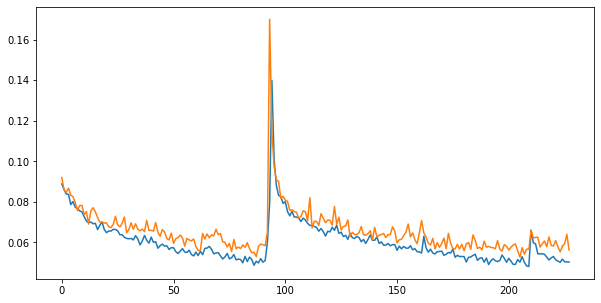

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0534                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

237 of 256
TRAIN LOSS: 0.05104614080240329
VAL LOSS: 0.06240949241651429


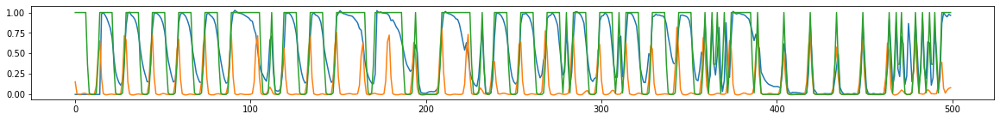

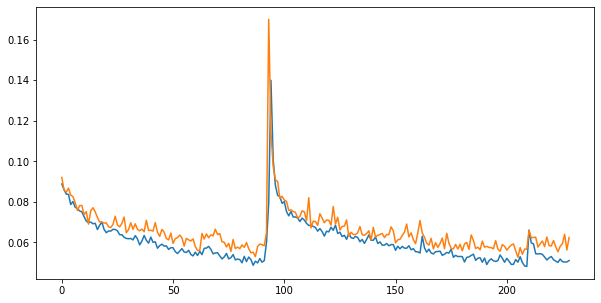

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0516                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

238 of 256
TRAIN LOSS: 0.05502193462517527
VAL LOSS: 0.05847213251723184


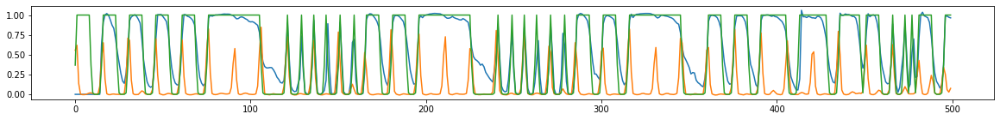

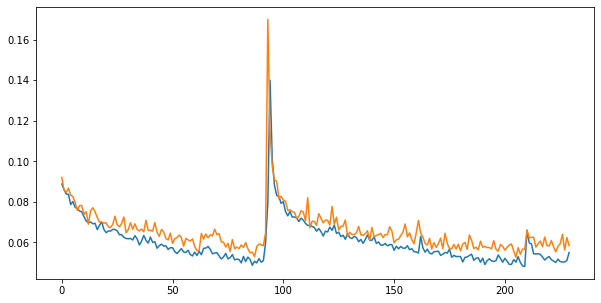

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0541                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

239 of 256
TRAIN LOSS: 0.05032590486937099
VAL LOSS: 0.056175237314568624


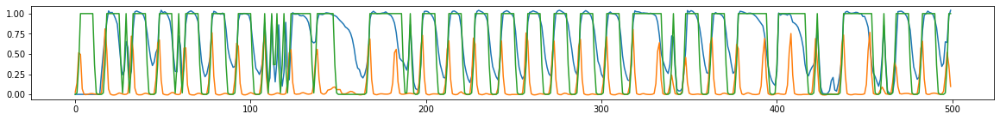

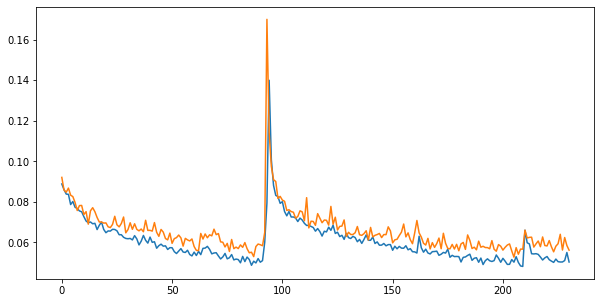

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0544                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

240 of 256
TRAIN LOSS: 0.050820713552335896
VAL LOSS: 0.061449201156695686


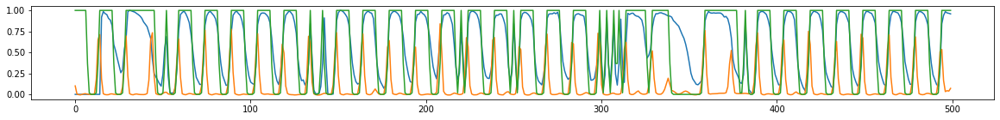

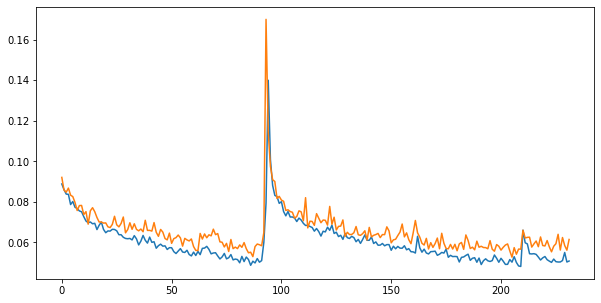

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0413                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

241 of 256
TRAIN LOSS: 0.04906939963499705
VAL LOSS: 0.05509003003438314


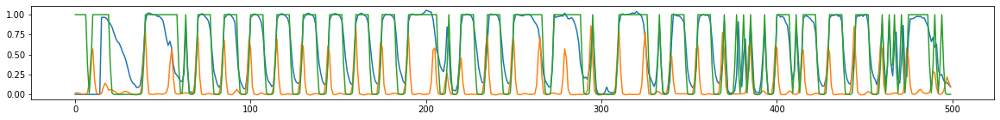

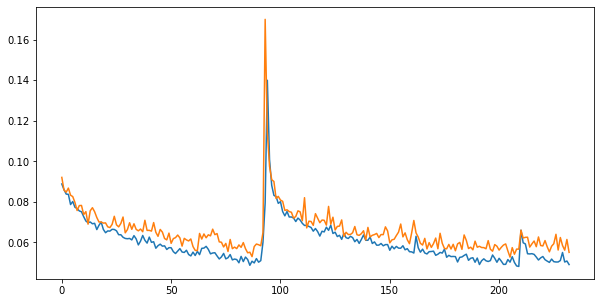

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0545                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

242 of 256
TRAIN LOSS: 0.04842601354337401
VAL LOSS: 0.0590889271762636


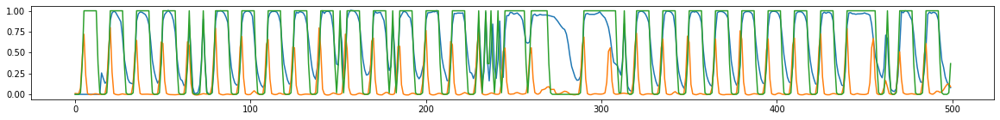

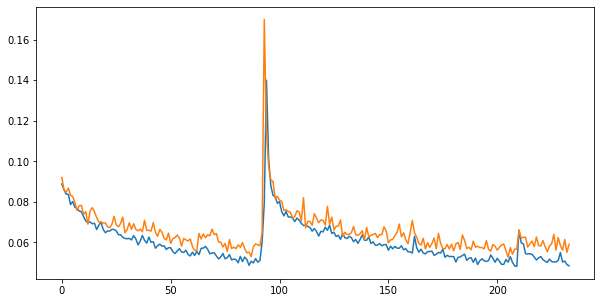

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0553                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

243 of 256
TRAIN LOSS: 0.0511018769401643
VAL LOSS: 0.05856742999619908


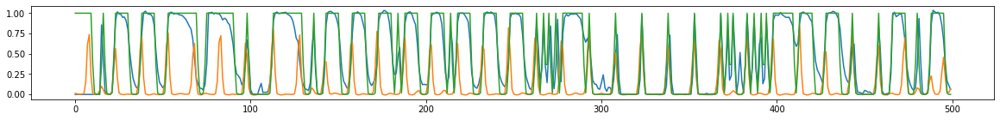

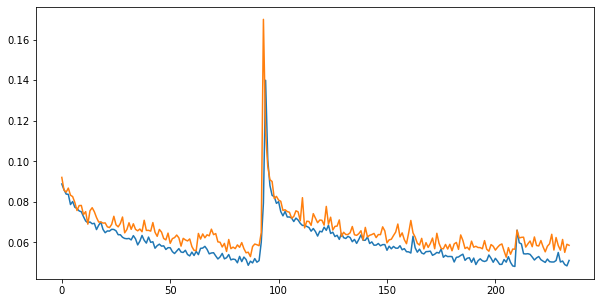

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0522                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

244 of 256
TRAIN LOSS: 0.04954036480436722
VAL LOSS: 0.053257007979684405


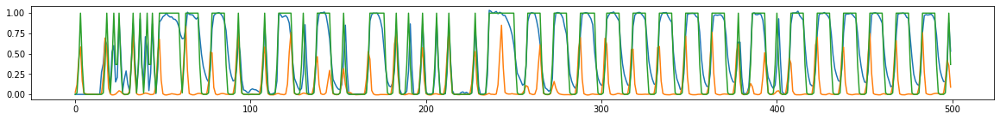

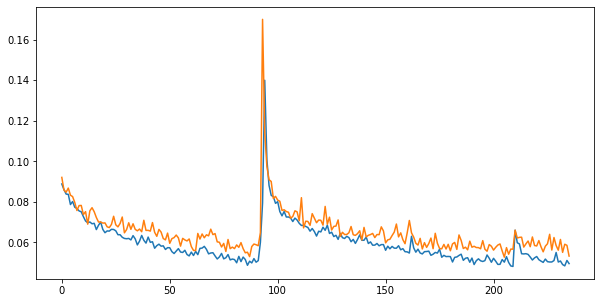

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0512                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

245 of 256
TRAIN LOSS: 0.04896549404495292
VAL LOSS: 0.053443974918789335


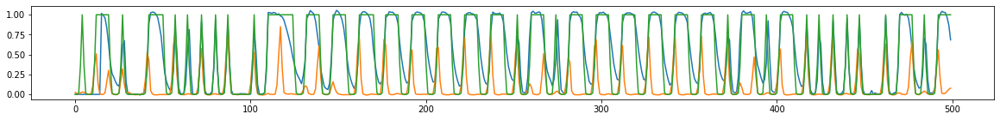

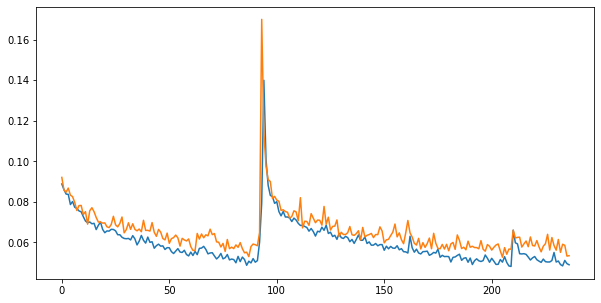

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0367                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

246 of 256
TRAIN LOSS: 0.049393660906288356
VAL LOSS: 0.055550617476304374


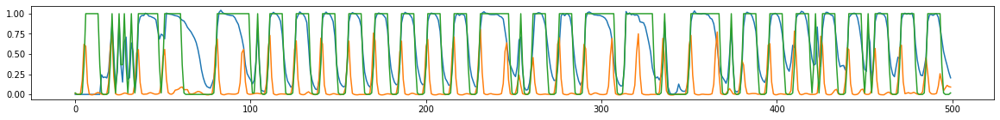

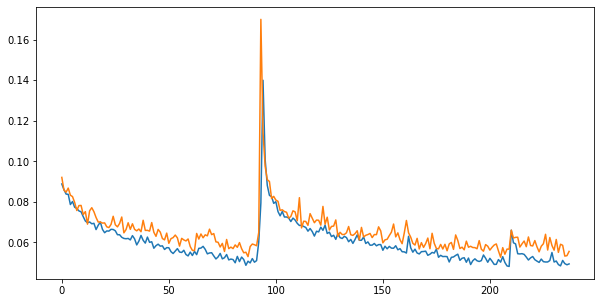

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0570                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

247 of 256
TRAIN LOSS: 0.050254916668766074
VAL LOSS: 0.05660211253497335


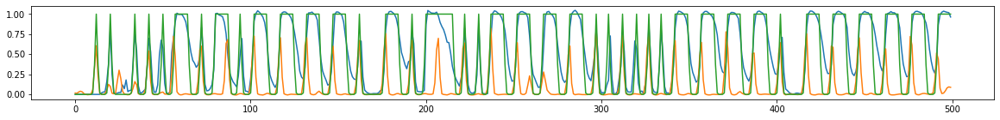

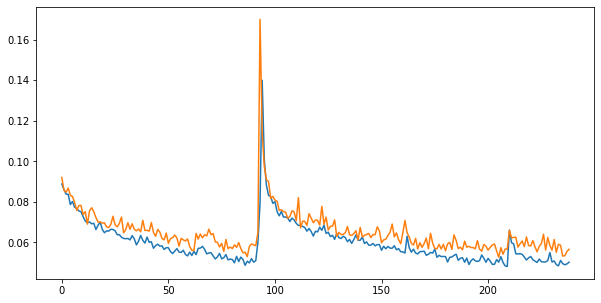

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0663                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

248 of 256
TRAIN LOSS: 0.049299612951775394
VAL LOSS: 0.055218478871716395


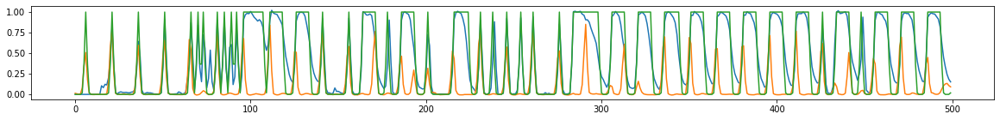

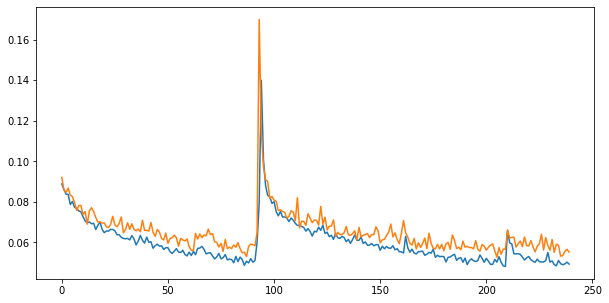

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0439                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

249 of 256
TRAIN LOSS: 0.04810029920190573
VAL LOSS: 0.0497356073723899


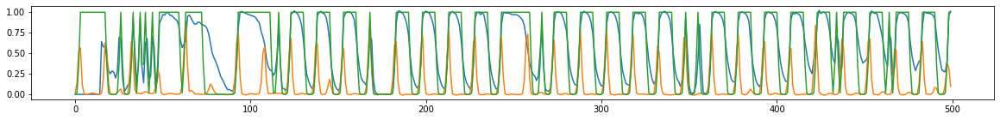

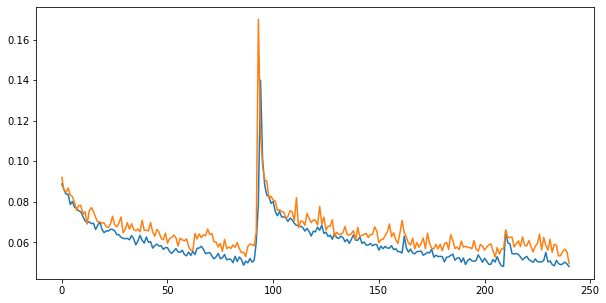

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.90it/s  0.0708                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

250 of 256
TRAIN LOSS: 0.050169773399829865
VAL LOSS: 0.05783326137397024


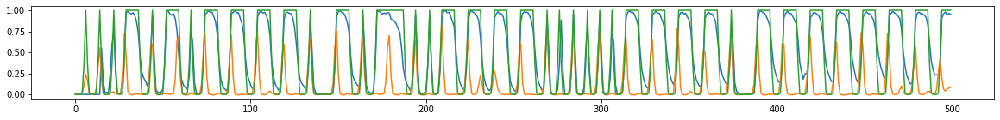

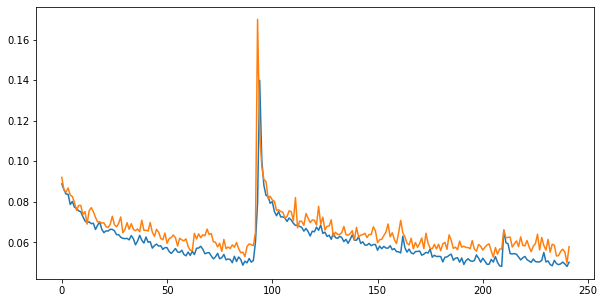

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.87it/s  0.0470                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

251 of 256
TRAIN LOSS: 0.049166855609251395
VAL LOSS: 0.054682455129093595


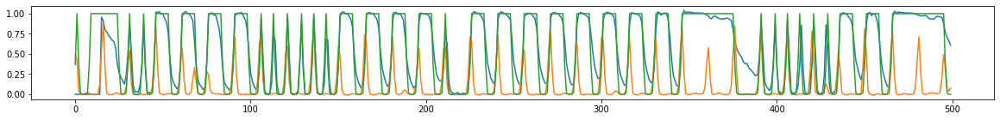

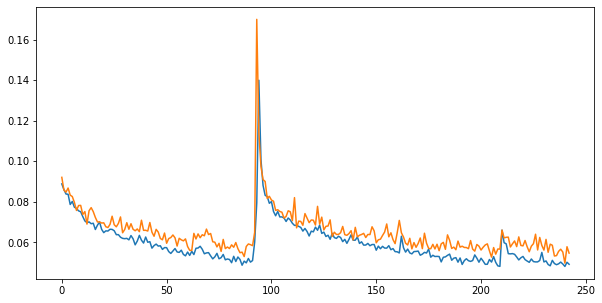

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0351                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

252 of 256
TRAIN LOSS: 0.04825895786699322
VAL LOSS: 0.0582734996245967


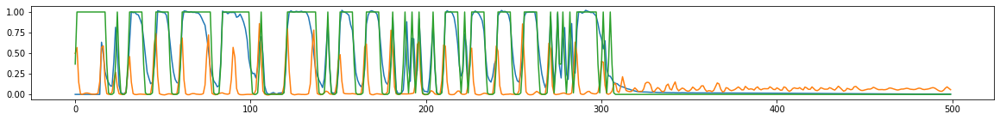

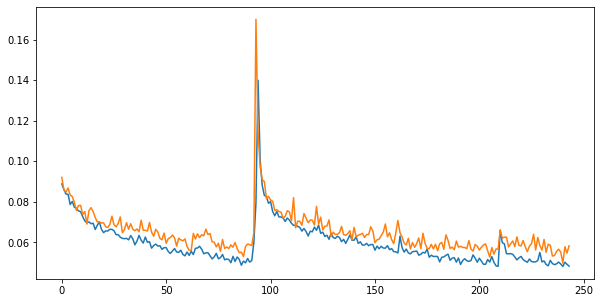

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0420                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

253 of 256
TRAIN LOSS: 0.04714768545495139
VAL LOSS: 0.05307694524526596


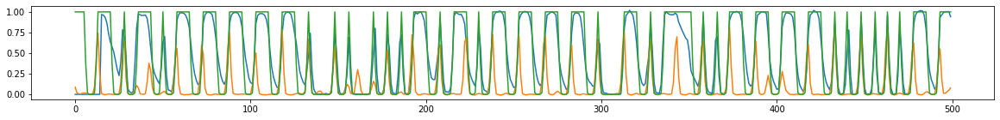

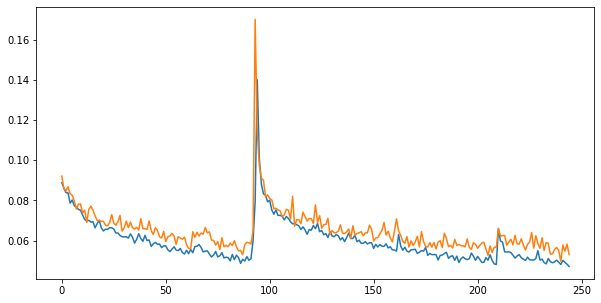

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.88it/s  0.0828                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

254 of 256
TRAIN LOSS: 0.049015846103429794
VAL LOSS: 0.05525668462117513


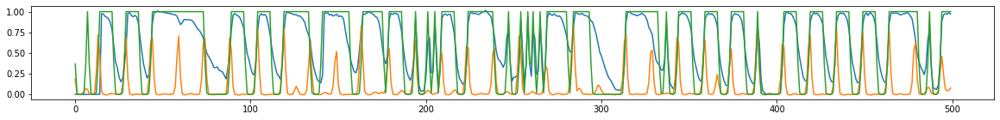

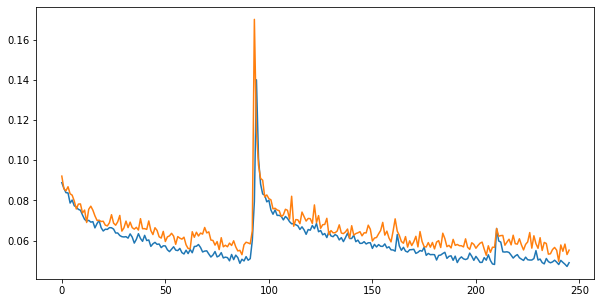

 Iters    Elapsed Time      Speed     loss                                      
 36/36  00:00:07<00:00:00  4.89it/s  0.0497                                     

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

255 of 256
TRAIN LOSS: 0.0482109013117022
VAL LOSS: 0.0547147827843825


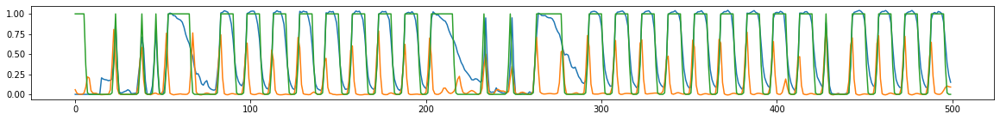

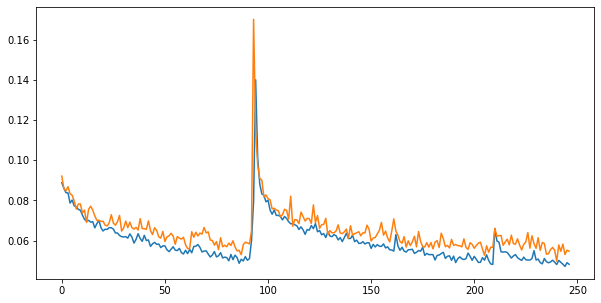

514.5770580768585 secs


In [83]:
start = time.time()

epochs = 64
trainHN()

end = time.time()
print(end - start, 'secs')

In [84]:
print(best_loss)
torch.save(best_weights, hn_model_path + str(epoch_cum) + '.pt')

0.0497356073723899


# Test model

In [26]:
import torch

In [27]:
hn.load_state_dict(torch.load(hn_model_path + str(256) + '.pt'))
bn.load_state_dict(torch.load(bn_model_path + str(128) + '.pt'))

<All keys matched successfully>

In [28]:
#osud = '../demo/beatmaps/567301 LamazeP - Spam Jack'
#osuf = 'LamazeP - Spam Jack (OsuToothbrush) [SPAM].osu'
#osud = '../ex/beatmaps/252981 DJ Okawari - Flower Dance (Short Ver)'
#osuf = 'DJ Okawari - Flower Dance (Short Ver.) (-Hanayuki-) [Relax].osu'
#osud = '../demo/beatmaps/348381 sasakureUK - Spider Thread Monopoly feat Hatsune Miku'
#osuf = 'sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-\'s Hard].osu'
#osud = '../demo/beatmaps/835194 Mili - Vulnerability'
#osuf = 'Mili_-_Vulnerability_IceKalt_Saturnalizes_Insane.osu'
#osud = '../demo/beatmaps/653534 Panda Eyes - ILY'
#osuf = 'Panda Eyes - ILY (M a r v o l l o) [Light Insane].osu'
osud = '../demo/beatmaps/388036 Akiyama Uni - Kanpan Tasogare Shinbun'
osuf = 'Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu'
#osud = '../demo/beatmaps/962088 MIMI feat Hatsune Miku - Marshmary'
#osuf = 'MIMI feat. Hatsune Miku - Marshmary (Log Off Now) [Horizon].osu'
#osud = '../demo/beatmaps/1314370 GYARI, Nekomiya Hinata - Nekomiya Days'
#osuf = 'GYARI, Nekomiya Hinata - Nekomiya Days (Thanres) [Neko-days].osu'

In [29]:
log_spect = LOG_SPECT(sample_rate=sample_rate, hop_size=hop_size, n_bands=[24], mode='offline')
osubeatmap = Beatmap(osud, osuf, log_spect, sample_rate=sample_rate, hop_size=hop_size, width=width, peak_type=peak_type, tmp='./wav/')

In [30]:
a, b, o, h = osubeatmap.get_audio(), osubeatmap.get_beats(), osubeatmap.get_hitobjects(), osubeatmap.get_hits()
A, B, O = a.to(device).unsqueeze(0), b.to(device).unsqueeze(0), o.to(device).unsqueeze(0)

In [31]:
hn.to(device)
bn.to(device)
hn.init_hidden(1)
bn.init_hidden(1)
bn.eval()
hn.eval()

HN(
  (convA1): Conv2d(1, 1, kernel_size=(3, 5), stride=(1, 1), padding=(1, 1))
  (convA2): Conv2d(1, 1, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (lstmX1): LSTM(343, 343, num_layers=2, batch_first=True)
  (linearX1): Linear(in_features=343, out_features=64, bias=True)
  (linear1): Linear(in_features=64, out_features=1, bias=True)
)

In [32]:
BP = bn(A)
HP = hn(A, BP.squeeze(2), O)

In [33]:
hp = HP.cpu().detach().numpy().squeeze(0)
bp = BP.cpu().detach().numpy().squeeze(0)
#acc = hit_precentage(p, h, 0.4)

#print(acc)

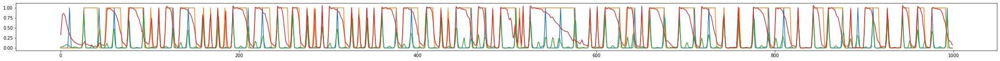

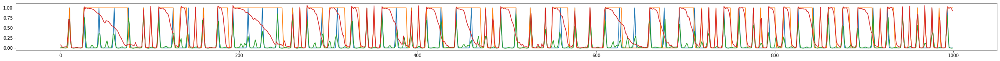

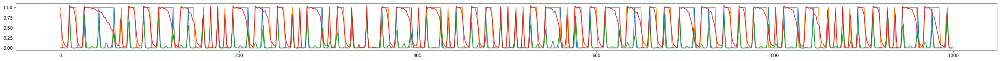

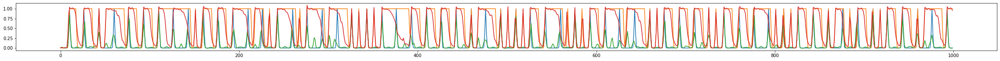

In [34]:
plt.rcParams["figure.figsize"] = (40,2)
for i in range(int(len(hp)/1000) - 1):
    plt.plot(b[1000*i:1000*(i+1)])
    plt.plot(h[1000*i:1000*(i+1)])
    plt.plot(bp[1000*i:1000*(i+1)])
    plt.plot(hp[1000*i:1000*(i+1)])
    plt.show()

# Create Replay Video

In [35]:
from IPython.display import Video

In [36]:
np.save('predASU.npy', hp)

In [72]:
eosud = osud.replace('/', '\/')

In [73]:
!sed -i "s/Beatmap path.*/Beatmap path\": \"$eosud\/$osuf\",/" data.json
!sed -i "s/Output path.*/Output path\": \"videoASU.mp4\",/" data.json

In [74]:
!python create_replayHN.py predASU.npy 50 0.5

2022-04-20 08:17:29,157:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-20 08:17:29,157:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': '../demo/beatmaps/835194 Mili - Vulnerability/Mili_-_Vulnerability_IceKalt_Saturnalizes_Insane.osu', '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'videoASU.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7f08d0340430>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'text_y': 748, 'Font Size': 20, 'Size': 10, 'Rgb': [200, 214, 229], 'Alp

In [75]:
Video("videoASU.mp4")